In [ ]:
pip install aeon

In [ ]:
from aeon.datasets import load_classification

In [1]:
pip install umap-learn

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [2]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

In [3]:
import matplotlib.pyplot as plt

In [4]:
from torch.utils.data import Dataset, DataLoader
from collections import defaultdict

# **Model Architecture**

In [5]:
# utils
import torch
import numpy as np
from scipy.special import comb
from sklearn import metrics
from sklearn.metrics.cluster import normalized_mutual_info_score
from sklearn.cluster import KMeans
from scipy.optimize import linear_sum_assignment

device = 'cuda' if torch.cuda.is_available() else 'cpu'

def ri_score(y_true, y_pred):
    y_true = np.asarray(y_true)
    y_pred = np.asarray(y_pred)
    tp_plus_fp = comb(np.bincount(y_true), 2).sum()
    tp_plus_fn = comb(np.bincount(y_pred), 2).sum()
    A = np.c_[(y_true, y_pred)]
    tp = sum(comb(np.bincount(A[A[:, 0] == i, 1]), 2).sum()
             for i in set(y_true))
    fp = tp_plus_fp - tp
    fn = tp_plus_fn - tp
    tn = comb(len(A), 2) - tp - fp - fn
    return (tp + tn) / (tp + fp + fn + tn)

def nmi_score(y_true, y_pred):
    y_true = np.asarray(y_true)
    y_pred = np.asarray(y_pred)
    return normalized_mutual_info_score(y_true, y_pred)

def cluster_using_kmeans(embeddings, K):
    if isinstance(embeddings, torch.Tensor):
        embeddings = embeddings.cpu().numpy()
    return KMeans(n_clusters=K, random_state=0, n_init='auto').fit_predict(embeddings)

def transfer_labels(labels):
    labels_np = np.asarray(labels)
    unique_original_labels = np.unique(labels_np)
    label_mapping = {original_label: i for i, original_label in enumerate(unique_original_labels)}
    new_integer_labels = np.zeros(labels_np.shape[0], dtype=np.int64) 
    
    for i in range(labels_np.shape[0]):
        new_integer_labels[i] = label_mapping[labels_np[i]]
        
    num_classes = len(unique_original_labels)
    return new_integer_labels, num_classes

def rnn_reformat(x, input_dims, n_steps):
    """
    Reformats input to a list of tensors for RNN processing.
    Inputs:
        x -- a tensor of shape (batch_size, n_steps, input_dims).
    Outputs:
        x_reformat -- a list of 'n_steps' tensors, each has shape (batch_size, input_dims).
    """
    # x: (batch_size, n_steps, input_dims)
    x_ = x.permute(1, 0, 2)  # (n_steps, batch_size, input_dims)
    # x_reformat = torch.split(x_, batch_size, dim=0) # Splits into n_steps chunks
    x_reformat = [x_s.squeeze(0) for x_s in torch.split(x_, 1, dim=0)] # list of (batch_size, input_dims)
    return x_reformat


def load_data(filename):
    data_label = np.loadtxt(filename, delimiter='\t')
    data_label = np.array(data_label)
    data = data_label[:, 1:]
    label = data_label[:, 0].astype(np.int32)
    return data, label

def evaluation(prediction, label):
    prediction = np.asarray(prediction)
    label = np.asarray(label)

    acc = cluster_acc(label, prediction)
    nmi = metrics.normalized_mutual_info_score(label, prediction)
    ari = metrics.adjusted_rand_score(label, prediction)
    ri_val = ri_score(label, prediction)
    return ri_val, nmi, ari, acc


def cluster_acc(y_true, y_pred):
    """
    Calculate clustering accuracy.
    # Arguments
        y_true: true labels, numpy.array with shape (n_samples,)
        y_pred: predicted labels, numpy.array with shape (n_samples,)
    # Return
        accuracy, in [0,1]
    """
    y_true = y_true.astype(np.int64)
    y_pred = np.asarray(y_pred).astype(np.int64)
    assert y_pred.size == y_true.size
    D = max(y_pred.max(), y_true.max()) + 1
    w = np.zeros((D, D), dtype=np.int64)
    for i in range(y_pred.size):
        w[y_pred[i], y_true[i]] += 1
    
    row_ind, col_ind = linear_sum_assignment(w.max() - w)
    return w[row_ind, col_ind].sum() * 1.0 / y_pred.size


In [6]:
# augmentation
import numpy as np

def jitter(x, sigma=0.03):
    return x + np.random.normal(loc=0., scale=sigma, size=x.shape)

def scaling(x, sigma=0.1):
    factor = np.random.normal(loc=1., scale=sigma, size=(x.shape[0], x.shape[2]))
    return np.multiply(x, factor[:, np.newaxis, :])

def rotation(x):
    flip = np.random.choice([-1, 1], size=(x.shape[0], x.shape[2]))
    rotate_axis = np.arange(x.shape[2])
    np.random.shuffle(rotate_axis)    
    return flip[:, np.newaxis, :] * x[:, :, rotate_axis]

def permutation(x, max_segments=5, seg_mode="equal"):
    orig_steps = np.arange(x.shape[1])
    num_segs = np.random.randint(1, max_segments + 1, size=(x.shape[0])) # +1 to include max_segments
    
    ret = np.zeros_like(x)
    for i, pat in enumerate(x):
        if num_segs[i] > 1:
            if seg_mode == "random":
                if x.shape[1] <= num_segs[i] -1 : # handle case where series is too short for splits
                    splits = np.array_split(orig_steps, num_segs[i])
                else:
                    split_points = np.random.choice(x.shape[1] - 2, num_segs[i] - 1, replace=False)
                    split_points.sort()
                    splits = np.split(orig_steps, split_points)
            else: # "equal"
                splits = np.array_split(orig_steps, num_segs[i])
            
            permuted_splits = np.random.permutation(splits)
            # Check if permuted_splits is a list of arrays or a 2D array before ravel
            if isinstance(permuted_splits, list): # np.permutation on list of arrays returns a list
                 warp = np.concatenate(permuted_splits).ravel()
            else: # if splits were all same size, permutation might return 2D array
                 warp = permuted_splits.ravel()
            ret[i] = pat[warp]
        else:
            ret[i] = pat
    return ret

def magnitude_warp(x, sigma=0.2, knot=4):
    from scipy.interpolate import CubicSpline
    orig_steps = np.arange(x.shape[1])
    
    random_warps = np.random.normal(loc=1.0, scale=sigma, size=(x.shape[0], knot + 2, x.shape[2]))
    warp_steps = (np.ones((x.shape[2], 1)) * (np.linspace(0, x.shape[1] - 1., num=knot + 2))).T
    
    ret = np.zeros_like(x)
    for i, pat in enumerate(x):
        warper = np.array([CubicSpline(warp_steps[:, dim], random_warps[i, :, dim])(orig_steps) for dim in range(x.shape[2])]).T
        ret[i] = pat * warper
    return ret

def time_warp(x, sigma=0.2, knot=4):
    from scipy.interpolate import CubicSpline
    orig_steps = np.arange(x.shape[1])
    
    random_warps = np.random.normal(loc=1.0, scale=sigma, size=(x.shape[0], knot + 2, x.shape[2]))
    warp_steps = (np.ones((x.shape[2], 1)) * (np.linspace(0, x.shape[1] - 1., num=knot + 2))).T
    
    ret = np.zeros_like(x)
    for i, pat in enumerate(x):
        for dim in range(x.shape[2]):
            time_warp_interp = CubicSpline(warp_steps[:, dim], warp_steps[:, dim] * random_warps[i, :, dim])(orig_steps)
            scale = (x.shape[1] - 1) / time_warp_interp[-1] if time_warp_interp[-1] !=0 else 1
            ret[i, :, dim] = np.interp(orig_steps, np.clip(scale * time_warp_interp, 0, x.shape[1] - 1), pat[:, dim]).T
    return ret

def window_slice(x, reduce_ratio=0.9):
    target_len = np.ceil(reduce_ratio * x.shape[1]).astype(int)
    if target_len >= x.shape[1]:
        return x
    
    starts = np.random.randint(low=0, high=x.shape[1] - target_len + 1, size=(x.shape[0])).astype(int) # +1 for high
    ends = (target_len + starts).astype(int)
    
    ret = np.zeros_like(x)
    for i, pat in enumerate(x):
        for dim in range(x.shape[2]):
            ret[i, :, dim] = np.interp(np.linspace(0, target_len -1, num=x.shape[1]), np.arange(target_len), pat[starts[i]:ends[i], dim]).T
    return ret

def window_warp(x, window_ratio=0.1, scales=[0.5, 2.]):
    warp_scales = np.random.choice(scales, x.shape[0])
    warp_size = np.ceil(window_ratio * x.shape[1]).astype(int)
    if warp_size == 0: return x # Avoid issues with zero warp size
    window_steps = np.arange(warp_size)
        
    # Ensure window_starts allows for full window_size
    max_start = x.shape[1] - warp_size -1
    if max_start < 1 : max_start = 1 # if series too short, pick start as 1

    window_starts = np.random.randint(low=1, high=max_start + 1, size=(x.shape[0])).astype(int) # +1 for high
    window_ends = (window_starts + warp_size).astype(int)
            
    ret = np.zeros_like(x)
    for i, pat in enumerate(x):
        for dim in range(x.shape[2]):
            start_seg = pat[:window_starts[i], dim]
            scaled_warp_size = int(warp_size * warp_scales[i])
            if scaled_warp_size == 0: # handle if scaled size becomes 0
                window_seg = np.array([])
            else:
                window_seg = np.interp(np.linspace(0, warp_size - 1, num=scaled_warp_size), window_steps, pat[window_starts[i]:window_ends[i], dim])
            end_seg = pat[window_ends[i]:, dim]
            
            warped = np.concatenate((start_seg, window_seg, end_seg))
            if warped.size == 0: # If everything became empty
                 ret[i,:,dim] = np.zeros(x.shape[1])
                 continue

            ret[i, :, dim] = np.interp(np.arange(x.shape[1]), np.linspace(0, x.shape[1] - 1., num=warped.size), warped).T
    return ret

In [7]:

# class TimeSeriesWindowDataset(Dataset):
#     def __init__(self, data_windows, labels):

#         if not isinstance(data_windows, torch.Tensor):
#             self.data_windows = torch.from_numpy(data_windows).float()
#         else:
#             self.data_windows = data_windows.float()
            
#         if not isinstance(labels, torch.Tensor):
#             self.labels = torch.from_numpy(labels).long()
#         else:
#             self.labels = labels.long()
            
#         if self.data_windows.ndim == 2:
#             self.data_windows = self.data_windows.unsqueeze(1) # (N, 1, T)
    

#     def __len__(self):
#         return len(self.labels)

#     def __getitem__(self, idx):
#         window_data = self.data_windows[idx] # (1, T)
#         label = self.labels[idx]
#         return window_data, label
        
class TimeSeriesDataset(Dataset):
    def __init__(self, original_data, augmented_data, labels):
        if not isinstance(original_data, torch.Tensor):
            self.original_data = torch.from_numpy(original_data).float()
        else:
            self.original_data = original_data.float()

        if not isinstance(augmented_data, torch.Tensor):
            self.augmented_data = torch.from_numpy(augmented_data).float()
        else:
            self.augmented_data = augmented_data.float()
            
        if not isinstance(labels, torch.Tensor):
            self.labels = torch.from_numpy(labels).long()
        else:
            self.labels = labels.long()
        
        if self.original_data.ndim == 2: # (N, T) -> (N, 1, T)
            self.original_data = self.original_data.unsqueeze(1)
            
        if self.augmented_data.ndim == 2: # (N, T) -> (N, 1, T)
            self.augmented_data = self.augmented_data.unsqueeze(1)
            
    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        return self.original_data[idx], self.augmented_data[idx], self.labels[idx]

In [8]:
from torch.utils.data.sampler import Sampler
import numpy as np

class StratifiedBatchSampler(Sampler):
    def __init__(self, labels, batch_size, shuffle=True):
        self.labels = np.asarray(labels)
        self.batch_size = batch_size
        self.shuffle = shuffle
        
        # 1. Вычисляем пропорции и группируем индексы
        # Подсчитываем количество примеров в каждом классе
        unique_labels, class_counts = np.unique(self.labels, return_counts=True)
        print(f"unique_labels, class_counts : {unique_labels, class_counts}")
        self.n_classes = len(unique_labels)
        
        self.indices_by_class = defaultdict(list)
        for idx, label in enumerate(self.labels):
            self.indices_by_class[label].append(idx)

        # 2. Определяем количество примеров каждого класса на батч
        # Вычисляем долю каждого класса в общем датасете
        class_proportions = class_counts / len(self.labels)
        
        self.samples_per_class_in_batch = np.round(class_proportions * self.batch_size).astype(int)

        current_sum = self.samples_per_class_in_batch.sum()
        diff = self.batch_size - current_sum
        
        if diff != 0:
            class_order_for_correction = np.argsort(self.samples_per_class_in_batch)
            if diff > 0:
                for i in range(diff):
                    self.samples_per_class_in_batch[class_order_for_correction[-(i+1)]] += 1
            else:
                for i in range(abs(diff)):
                    class_idx_to_correct = class_order_for_correction[i]
                    if self.samples_per_class_in_batch[class_idx_to_correct] > 0:
                         self.samples_per_class_in_batch[class_idx_to_correct] -= 1
        
        for i, cls in enumerate(unique_labels):
            if self.samples_per_class_in_batch[i] > 0 and self.samples_per_class_in_batch[i] > len(self.indices_by_class[cls]):
                 print(f"Предупреждение: Класс {cls} имеет только {len(self.indices_by_class[cls])} сэмплов, но в батч требуется {self.samples_per_class_in_batch[i]}. "
                       f"Возможны повторения внутри эпохи.")

        # 3. Рассчитываем количество батчей
        non_zero_samples_mask = self.samples_per_class_in_batch > 0
        ratios = class_counts[non_zero_samples_mask] / self.samples_per_class_in_batch[non_zero_samples_mask]
        self.num_batches = int(np.floor(ratios.min()))

    def __iter__(self):
        indices_by_class_shuffled = {
            cls: np.random.permutation(indices).tolist() if self.shuffle else indices.copy()
            for cls, indices in self.indices_by_class.items()
        }
        
        for _ in range(self.num_batches):
            batch_indices = []
            for class_idx, num_samples in enumerate(self.samples_per_class_in_batch):
                if num_samples > 0:
                    try:
                        class_batch = [indices_by_class_shuffled[class_idx].pop() for _ in range(num_samples)]
                    except IndexError:
                        indices_by_class_shuffled[class_idx] = np.random.permutation(self.indices_by_class[class_idx]).tolist()
                        class_batch = [indices_by_class_shuffled[class_idx].pop() for _ in range(num_samples)]
                    
                    batch_indices.extend(class_batch)
            
            if self.shuffle:
                np.random.shuffle(batch_indices)
            
            yield batch_indices

    def __len__(self):
        return self.num_batches



In [9]:
# rnn_cell_extensions
import torch
import torch.nn as nn
import torch.nn.functional as F

class LinearSpaceDecoderWrapper(nn.Module):
    """
    Wrapper adding a linear output layer to an RNN cell.
    The wrapped cell should be a PyTorch RNNCell (e.g., nn.GRUCell, nn.LSTMCell).
    """
    def __init__(self, cell, output_size):
        super(LinearSpaceDecoderWrapper, self).__init__()
        if not isinstance(cell, (nn.GRUCell, nn.LSTMCell, nn.RNNCell)):
            raise TypeError("The parameter cell is not a standard PyTorch RNNCell.")
        
        self._cell = cell
        self.linear_output_size = output_size

        # Determine the input size for the linear layer from the cell's hidden_size
        # For LSTMCell, state_size is a tuple (h, c), output is h.
        # For GRUCell, state_size is h, output is h.
        insize = self._cell.hidden_size 
        
        # print(f'Wrapped cell: {type(self._cell)}')
        # print(f'Wrapped cell hidden_size: {insize}')
        # print(f'Linear output_size = {output_size}')

        self.w_out = nn.Parameter(torch.empty(insize, output_size))
        self.b_out = nn.Parameter(torch.empty(output_size))
        
        nn.init.uniform_(self.w_out, -0.01, 0.01)
        nn.init.uniform_(self.b_out, -0.01, 0.01)

    @property
    def state_size(self):
        return self._cell.hidden_size

    @property
    def hidden_size(self):
        return self._cell.hidden_size

    @property
    def output_size(self):
        return self.linear_output_size

    def forward(self, inputs, state):
        """
        Args:
            inputs: Tensor of shape (batch, input_size_for_cell)
            state: Tensor or tuple of tensors for the state of self._cell
        Returns:
            output: Tensor of shape (batch, self.linear_output_size)
            new_state: Updated state from self._cell
        """
        # Run the rnn cell as usual
        # For GRUCell/RNNCell: new_state is the new hidden state (which is also the output before projection)
        # For LSTMCell: new_state is (h_new, c_new), and the 'output' before projection is h_new
        
        if isinstance(self._cell, nn.LSTMCell):
            h_new, c_new = self._cell(inputs, state)
            rnn_output = h_new
            new_state = (h_new, c_new)
        else: # GRUCell or RNNCell
            h_new = self._cell(inputs, state)
            rnn_output = h_new
            new_state = h_new
            
        # Apply the linear projection
        output = torch.matmul(rnn_output, self.w_out) + self.b_out
        return output, new_state

In [10]:
# drnn
import torch
import torch.nn as nn

def rnn_reformat_for_drnn(x_batch_first, input_dims, n_steps):
    """
    Reformats input from (batch_size, n_steps, input_dims) to a list of 
    'n_steps' tensors, each of shape (batch_size, input_dims).
    This is specifically for the dRNN input format expectation.
    Args:
        x_batch_first: tensor of shape (batch_size, n_steps, input_dims)
    """
    # x_batch_first: (batch_size, n_steps, input_dims)
    x_time_first = x_batch_first.permute(1, 0, 2)  # (n_steps, batch_size, input_dims)
    # Split along the time dimension (dim=0)
    # Each element will be (1, batch_size, input_dims), so squeeze dim 0
    x_reformatted_list = [tensor.squeeze(0) for tensor in torch.split(x_time_first, 1, dim=0)]
    return x_reformatted_list


class DRNNLayer(nn.Module):
    """
    A single layer of Dilated RNN.
    """
    def __init__(self, rnn_cell, rate):
        super(DRNNLayer, self).__init__()
        self.cell = rnn_cell
        self.rate = rate
        if not hasattr(self.cell, 'hidden_size'):
             raise ValueError("RNN cell must have a hidden_size attribute.")

    def forward(self, inputs_list, initial_state=None):
        """
        Args:
            inputs_list: A list of 'n_steps' tensors, each of shape (batch_size, input_dims).
            initial_state: Initial hidden state for the RNN cell. (Optional)
        Outputs:
            outputs_list: A list of 'n_steps' tensors from the RNN.
            final_state: The final hidden state.
        """
        n_steps = len(inputs_list)
        if self.rate < 0 or self.rate > n_steps :
            raise ValueError("The 'rate' variable needs to be adjusted.")

        batch_size = inputs_list[0].size(0)
        input_dims = inputs_list[0].size(1)
        device = inputs_list[0].device

        # print(f"Building DRNNLayer: input length: {n_steps}, dilation rate: {self.rate}, input dim: {input_dims}")

        current_inputs = list(inputs_list) # Make a mutable copy

        # Zero-padding if necessary
        even_length = (n_steps % self.rate) == 0
        if not even_length:
            zero_tensor = torch.zeros(batch_size, input_dims, device=device)
            dilated_n_steps = n_steps // self.rate + 1
            # print(f"=====> {dilated_n_steps * self.rate - n_steps} time points need to be padded.")
            # print(f"=====> Input length for sub-RNN: {dilated_n_steps}")
            for _ in range(dilated_n_steps * self.rate - n_steps):
                current_inputs.append(zero_tensor)
        else:
            dilated_n_steps = n_steps // self.rate
        
      
        
        dilated_inputs_for_rnn = []
        for i in range(dilated_n_steps):
            chunk_to_concat = current_inputs[i * self.rate : (i + 1) * self.rate]
            # Each tensor in chunk_to_concat is (batch_size, input_dims)
            # We need to make them (batch_size, rate * input_dims) or (batch_size, input_dims * rate)
            # or (batch_size * rate, input_dims) if the cell handles a larger batch.

            # Input: [x1, x2, x3, x4, x5], rate=2. Padded: [x1,x2,x3,x4,x5,0]
            # dilated_inputs: [cat(x1,x2), cat(x3,x4), cat(x5,0)] where cat is along batch dim.
            # So, cell input becomes (batch_size*rate, features)
            
            concatenated_chunk = torch.cat(chunk_to_concat, dim=0) # Shape: (batch_size * rate, input_dims)
            dilated_inputs_for_rnn.append(concatenated_chunk)


        # Initialize hidden state if not provided
        if initial_state is None:
            if isinstance(self.cell, nn.LSTMCell):
                initial_state = (torch.zeros(batch_size * self.rate, self.cell.hidden_size, device=device),
                                 torch.zeros(batch_size * self.rate, self.cell.hidden_size, device=device))
            else: # GRUCell, RNNCell
                initial_state = torch.zeros(batch_size * self.rate, self.cell.hidden_size, device=device)
        
        h_state = initial_state
        dilated_outputs_from_rnn = []

        for rnn_input_step in dilated_inputs_for_rnn:
            # rnn_input_step shape: (batch_size * rate, input_dims)
            if isinstance(self.cell, nn.LSTMCell):
                h_out, c_out = self.cell(rnn_input_step, h_state)
                h_state = (h_out, c_out)
                dilated_outputs_from_rnn.append(h_out) # Store only the hidden state output part
            else: # GRUCell or RNNCell
                h_out = self.cell(rnn_input_step, h_state)
                h_state = h_out
                dilated_outputs_from_rnn.append(h_out)
        
        # Reshape output back
        # Each output in dilated_outputs_from_rnn is (batch_size * rate, hidden_size)
        
        unrolled_outputs_list = []
        for dilated_out_step in dilated_outputs_from_rnn:
            # dilated_out_step: (batch_size * rate, hidden_size)
            # torch.split needs split_size_or_sections. If rate is an int, it's number of chunks.
            # We need to split into `rate` chunks, each of size `batch_size`.
            split_tensors = torch.split(dilated_out_step, batch_size, dim=0) # list of `rate` tensors, each (batch_size, hidden_size)
            unrolled_outputs_list.extend(list(split_tensors))
            
        # Remove padded zeros from the *original* time sequence length
        final_outputs_list = unrolled_outputs_list[:n_steps]
        
        # The final_state needs to be reshaped/handled if its batch dim is batch_size * rate.
        # For simplicity, this example returns the state from the last dilated step.
        # A more complex handling might be needed depending on how state is propagated across layers.
        return final_outputs_list, h_state


class MultiDRNNWithDilations(nn.Module):
    def __init__(self, rnn_cells, dilations):
        super(MultiDRNNWithDilations, self).__init__()
        assert len(rnn_cells) == len(dilations)
        self.layers = nn.ModuleList()
        for cell, dilation_rate in zip(rnn_cells, dilations):
            self.layers.append(DRNNLayer(cell, dilation_rate))

    def forward(self, inputs_list, initial_states=None):
        """
        Args:
            inputs_list: A list of 'n_steps' tensors, each (batch_size, input_dims_for_first_layer).
            initial_states: A list of initial states for each layer (optional).
        Outputs:
            layer_outputs_list: A list where each element is the output list from a dRNN layer.
                                  The last element is the output of the final dRNN layer.
            layer_final_states_list: A list of final states from each dRNN layer.
            
            Alternative (matching original):
            outputs_all_layers_unpacked: list of lists. outer list = layers, inner list = timesteps
            outputs_all_layers_packed: list of tensors. outer list = layers, tensor = (batch, steps, hidden)
        """
        current_inputs_list = inputs_list
        outputs_all_layers_unpacked = [] # To store list of outputs from each layer
        outputs_all_layers_packed = [] # To store (batch, steps, hidden) for each layer

        for i, layer in enumerate(self.layers):
            layer_initial_state = initial_states[i] if initial_states and i < len(initial_states) else None
            
            # The DRNNLayer expects input features to match its cell's input_size.
            # This is implicitly handled if the cell's input_size matches the previous layer's hidden_size.
            current_outputs_list, _ = layer(current_inputs_list, layer_initial_state)
            # current_outputs_list is a list of tensors: (batch_size, hidden_size_of_this_layer)
            
            outputs_all_layers_unpacked.append(current_outputs_list)
            
            # To match original 'output' which is tf.stack(x, axis=0) then transpose [1,0,2]
            # This makes it (batch_size, n_steps, hidden_size)
            if current_outputs_list: # if list is not empty
                stacked_output = torch.stack(current_outputs_list, dim=0) # (n_steps, batch_size, hidden_size)
                packed_output = stacked_output.permute(1, 0, 2) # (batch_size, n_steps, hidden_size)
                outputs_all_layers_packed.append(packed_output)

            current_inputs_list = current_outputs_list # Output of this layer is input to the next

        return outputs_all_layers_unpacked, outputs_all_layers_packed

class LayerNormGRUCell(nn.Module):
    """
    Обертка над GRUCell, которая добавляет LayerNorm к вычислениям.
    """
    def __init__(self, input_size, hidden_size):
        super(LayerNormGRUCell, self).__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size
        
        self.gru_cell = nn.GRUCell(input_size, hidden_size)
        
        self.layer_norm_ih = nn.LayerNorm(3 * hidden_size)
        self.layer_norm_hh = nn.LayerNorm(3 * hidden_size)

    def forward(self, input, hx=None):
        if hx is None:
            hx = torch.zeros(input.size(0), self.hidden_size, dtype=input.dtype, device=input.device)


        gi = F.linear(input, self.gru_cell.weight_ih, self.gru_cell.bias_ih)
        gi = self.layer_norm_ih(gi)
        
        gh = F.linear(hx, self.gru_cell.weight_hh, self.gru_cell.bias_hh)
        gh = self.layer_norm_hh(gh)


        r_i, z_i, n_i = gi.chunk(3, 1)
        r_h, z_h, n_h = gh.chunk(3, 1)
        
        resetgate = torch.sigmoid(r_i + r_h)
        inputgate = torch.sigmoid(z_i + z_h)
        newgate = torch.tanh(n_i + resetgate * n_h)
        
        hy = (1 - inputgate) * newgate + inputgate * hx
        
        return hy

def construct_pytorch_cells(hidden_structs, cell_type, input_size_for_first_cell):
    """
    Constructs a list of PyTorch RNN cells.
    Args:
        hidden_structs: List of hidden dimensions for each layer.
        cell_type: "RNN", "LSTM", or "GRU".
        input_size_for_first_cell: The feature dimension of the input to the first RNN cell.
    """
    cells = []
    current_input_size = input_size_for_first_cell
    for i, hidden_dims in enumerate(hidden_structs):
        if cell_type == "RNN":
            cell = nn.RNNCell(current_input_size, hidden_dims)
        elif cell_type == "LSTM":
            cell = nn.LSTMCell(current_input_size, hidden_dims)
        elif cell_type == "GRU":
            # cell = LayerNormGRUCell(current_input_size, hidden_dims)
            cell = nn.GRUCell(current_input_size, hidden_dims)
        else:
            raise ValueError("The cell type is not currently supported.")
        cells.append(cell)
        current_input_size = hidden_dims # Input size for next cell is hidden_size of current
    return cells


class DRNNModel(nn.Module):
    """
    Main model class for DRNN, similar to drnn_layer_final.
    Takes batch-first tensor input (batch, steps, features).
    """
    def __init__(self, input_dims, hidden_structs, dilations, cell_type):
        super(DRNNModel, self).__init__()
        assert len(hidden_structs) == len(dilations)
        
        self.input_dims = input_dims
        self.hidden_structs = hidden_structs
        self.dilations = dilations
        self.cell_type = cell_type

        pytorch_cells = construct_pytorch_cells(hidden_structs, cell_type, input_dims)
        self.multi_drnn_layer = MultiDRNNWithDilations(pytorch_cells, dilations)

    def forward(self, x_batch_first, initial_states_per_layer=None):
        """
        Args:
            x_batch_first: Tensor of shape (batch_size, n_steps, input_dims).
            initial_states_per_layer: Optional list of initial states for each DRNN layer.
        Outputs:
            Same as MultiDRNNWithDilations:
            outputs_all_layers_unpacked: list of lists. outer list=layers, inner list=timesteps outputs.
            outputs_all_layers_packed: list of tensors. outer list=layers, tensor=(batch, steps, hidden).
                                       The last element is the final layer's output tensor.
        """
        n_steps = x_batch_first.size(1)
        
        # Reformat input from (batch, steps, features) to list of (batch, features)
        x_reformatted_list = rnn_reformat_for_drnn(x_batch_first, self.input_dims, n_steps)
        
        # Pass through MultiDRNN
        # The initial_states handling in MultiDRNNWithDilations needs to be compatible with DRNNLayer's expectation.
        # DRNNLayer expects a single state for its cell, which might be a tuple for LSTM.
        # MultiDRNNWithDilations would then need a list of these states.
        unpacked_outputs, packed_outputs = self.multi_drnn_layer(x_reformatted_list, initial_states_per_layer)
        
        return unpacked_outputs, packed_outputs


In [11]:
def cluster_alignment_loss(F_orig, F_aug):
    """
    Minimizes the discrepancy between cluster probability distributions
    for original and augmented representations.

    Args:
        F_orig (torch.Tensor): A matrix from SVD for the original data (batch_size, K).
        F_aug (torch.Tensor): A matrix from SVD for augmented data (batch_size, K).
    """
    P_orig = F.softmax(F_orig, dim=1)
    P_aug = F.softmax(F_aug, dim=1)
    
    loss1 = - (P_orig * torch.log(P_aug + 1e-9)).sum(dim=1).mean()
    loss2 = - (P_aug * torch.log(P_orig + 1e-9)).sum(dim=1).mean()
    
    return (loss1 + loss2) / 2

def supervised_contrastive_loss(h1, h2, labels, temperature):
    device = h1.device
    batch_size = h1.shape[0]

    h1 = F.normalize(h1, p=2, dim=1)
    h2 = F.normalize(h2, p=2, dim=1)
    
    features = torch.cat([h1, h2], dim=0) # (2 * batch_size, feature_dim)
    
    similarity_matrix = torch.matmul(features, features.T) / temperature # (2B, 2B)

    # labels_expanded: [y_1, y_2, ..., y_B, y_1, y_2, ..., y_B]
    labels_expanded = labels.contiguous().view(-1, 1) # (B, 1)
    # (i, j) == 1, if y_i == y_j
    mask = torch.eq(labels_expanded, labels_expanded.T).float().to(device) # (B, B)
    mask = mask.repeat(2, 2) # (2B, 2B)

    logits_mask = torch.ones_like(mask)
    logits_mask.fill_diagonal_(0)
    
    mask = mask * logits_mask
    
    
    exp_logits = torch.exp(similarity_matrix) * logits_mask
    log_prob = similarity_matrix - torch.log(exp_logits.sum(1, keepdim=True) + 1e-9)

  
    mean_log_prob_pos = (mask * log_prob).sum(1) / (mask.sum(1) + 1e-9)
    
    loss = -mean_log_prob_pos.mean()
    
    return loss

In [12]:
# dtcc
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import numpy as np
import math
import os
from sklearn.cluster import KMeans

def contrastive_loss_pytorch(h1, h2, temperature, hidden_norm):
    """
    Instance-level contrastive loss (e.g., SimCLR style)
    Args:
        h1: tensor of shape (batch_size, feature_dim)
        h2: tensor of shape (batch_size, feature_dim) - augmented views of the same instances
        temperature: scalar temperature parameter
        hidden_norm: boolean, whether to L2 normalize features
    """
    batch_size = h1.shape[0]
    device = h1.device

    if hidden_norm:
        h1 = F.normalize(h1, p=2, dim=1)
        h2 = F.normalize(h2, p=2, dim=1)

    # Concatenate features from two views for calculating similarity matrix
    features = torch.cat([h1, h2], dim=0) # (2 * batch_size, feature_dim)
    
    # Calculate cosine similarity
    # sim_matrix[i, j] is the similarity between features[i] and features[j]
    sim_matrix = torch.matmul(features, features.T) / temperature # (2*B, 2*B)
    
    # Mask to remove diagonal elements (self-similarity)
    # For SimCLR, labels are such that instance i and instance i+B are positive pairs
    labels = torch.arange(batch_size, device=device) # [0, 1, ..., B-1]
    
    # Positive pairs are (h1_i, h2_i) which are at indices (i, i+B) and (i+B, i) in sim_matrix
    # Create labels for softmax cross entropy:
    # For row i (from h1), positive is at column i+B.
    # For row i+B (from h2), positive is at column i.
    
    # Create a mask for positive pairs.
    #logits_mask helps remove self-comparisons
    logits_mask = torch.scatter(
        torch.ones_like(sim_matrix),
        1,
        torch.arange(2 * batch_size, device=device).view(-1, 1),
        0
    ) # Mask out diagonal (self-similarity)

    # For each row i (0 to B-1), its positive pair is at i+B
    # For each row i+B (B to 2B-1), its positive pair is at i
    # We need labels that point to the positive pair for each anchor.
    
    # Positive pairs: (i, i+B) and (i+B, i)
    # sim_matrix is (2B, 2B).
    # Anchor h1_i (row i), positive h2_i (col i+B)
    # Anchor h2_i (row i+B), positive h1_i (col i)
    
    # Simpler way: treat it as InfoNCE
    # For each feature h1_i, its positive key is h2_i.
    # For each feature h2_i, its positive key is h1_i.
    
    # sim_matrix already has all pairwise similarities.
    # We need to select the correct positive pair for each anchor.
    
    # Positive similarity for h1_i is sim(h1_i, h2_i)
    # Positive similarity for h2_i is sim(h2_i, h1_i)
    
    # Extract positive similarities (diagonal of the h1-h2 block and h2-h1 block)
    sim_i_j = torch.diag(sim_matrix, batch_size) # Similarities between h1_i and h2_i
    sim_j_i = torch.diag(sim_matrix, -batch_size) # Similarities between h2_i and h1_i
    
    positive_sim = torch.cat([sim_i_j, sim_j_i], dim=0) # Shape (2*B)
    
    # Numerator for InfoNCE: exp(positive_sim / temp)
    # Denominator: sum over exp(sim(anchor, other_k) / temp) for all other_k != anchor
    
    # We can use CrossEntropyLoss if we arrange logits and labels correctly.
    # The labels for CrossEntropyLoss should be the index of the positive sample.
    
    # For anchors 0 to B-1 (from h1), positive sample is at index anchor_idx + B
    # For anchors B to 2B-1 (from h2), positive sample is at index anchor_idx - B
    
    positive_indices = torch.zeros(2 * batch_size, dtype=torch.long, device=device)
    positive_indices[:batch_size] = torch.arange(batch_size, 2 * batch_size) # h1_i's positive is h2_i
    positive_indices[batch_size:] = torch.arange(batch_size)             # h2_i's positive is h1_i

    # We want to mask out the anchor itself from the denominator sums.
    # sim_matrix already has sim(all, all).
    # The loss for anchor `k` is -log( exp(sim(k, k_pos)) / sum_{j!=k} exp(sim(k,j)) )
    # This is equivalent to CrossEntropyLoss(logits_for_k, label_k_pos)
    # where logits_for_k are [sim(k,0), sim(k,1), ..., sim(k, 2B-1)]
    # *excluding* sim(k,k)
    
    # Mask out self-similarity from the logits used in CE denominator
    exp_sim_matrix = torch.exp(sim_matrix) * logits_mask # Zero out diagonal contributions for denominator

    log_prob = sim_matrix - torch.log(exp_sim_matrix.sum(dim=1, keepdim=True) + 1e-9) # log(exp(sim)/sum(exp(others)))
    
    # Compute mean of -log(p) for positive pairs
    # For anchor i (from h1, original index i_orig), positive is h2_i_orig (index i_orig + B)
    # For anchor i (from h2, original index i_orig), positive is h1_i_orig (index i_orig - B)
    loss = -log_prob.gather(dim=1, index=positive_indices.view(-1,1)).mean()

    return loss


def cluster_contrastive_loss_pytorch(q1, q2, temperature_cluster, hidden_norm_cluster):
    """
    Cluster-level contrastive loss.
    Args:
        q1: tensor of shape (num_clusters, batch_size_for_F_matrix_dim) or (num_clusters, feature_dim) if cluster prototypes
            In the paper, Q is (N, K) from SVD of Z (N, D_hidden). So qi is (N,).
            Then similarity is between q_i and q_j. If Q is (K,N) (transposed from paper), then qi is a row vector.
            The code transposes Q to (K,N) before this loss. So input q1, q2 are (K, N_samples_in_batch)
        q2: tensor of shape (num_clusters, N_samples_in_batch)
        temperature_cluster: scalar temperature
        hidden_norm_cluster: boolean for L2 normalization
    """

    num_clusters = q1.shape[0] # K
    device = q1.device

    if hidden_norm_cluster:
        q1 = F.normalize(q1, p=2, dim=1) # Normalize along the feature dimension
        q2 = F.normalize(q2, p=2, dim=1)

    # Features are cluster representations from two views (original, augmented)
    # q1 are clusters from view 1, q2 are clusters from view 2.
    # Positive pair: (cluster_k_view1, cluster_k_view2)
    
    # Concatenate features (cluster representations)
    features = torch.cat([q1, q2], dim=0) # (2 * num_clusters, feature_dim)
    
    # Cosine similarity between all pairs of cluster representations
    # sim_matrix[i,j] is sim(features[i], features[j])
    sim_matrix = torch.matmul(features, features.T) / temperature_cluster # (2K, 2K)

    # Mask for diagonal elements (self-similarity of a cluster representation with itself)
    logits_mask = torch.scatter(
        torch.ones_like(sim_matrix),
        1,
        torch.arange(2 * num_clusters, device=device).view(-1, 1),
        0
    )

    # Positive pairs are (q1_k, q2_k), which are at (k, k + num_clusters) and (k + num_clusters, k)
    positive_indices = torch.zeros(2 * num_clusters, dtype=torch.long, device=device)
    positive_indices[:num_clusters] = torch.arange(num_clusters, 2 * num_clusters) # q1_k's positive is q2_k
    positive_indices[num_clusters:] = torch.arange(num_clusters)                # q2_k's positive is q1_k

    exp_sim_matrix = torch.exp(sim_matrix) * logits_mask
    log_prob = sim_matrix - torch.log(exp_sim_matrix.sum(dim=1, keepdim=True) + 1e-9)
    
    loss_cl = -log_prob.gather(dim=1, index=positive_indices.view(-1,1)).mean()

    # F_view1 = q1.T 
    # F_view2 = q2.T
    # F_view1_softmax = F.softmax(F_view1, dim=1) # (batch_size, K)
    # F_view2_softmax = F.softmax(F_view2, dim=1) # (batch_size, K)

    # # marginal distribution by clusters for F_view1
    # p_dist_view1 = F_view1_softmax.sum(dim=0) # summ the probabilities for all instances for each cluster (K,)
    # if p_dist_view1.sum().item() < 1e-9:
    #     ne_view1 = torch.tensor(0.0, device=device)
    # else:
    #     p_dist_view1 = p_dist_view1 / p_dist_view1.sum() # Normalize it to get the distribution (K,)
    #     ne_view1 = torch.log(torch.tensor(num_clusters, dtype=torch.float, device=device)) + \
    #                (p_dist_view1 * torch.log(p_dist_view1 + 1e-9)).sum()

    # # marginal distribution by clusters for F_view2
    # p_dist_view2 = F_view2_softmax.sum(dim=0) # (K,)
    # if p_dist_view2.sum().item() < 1e-9:
    #     ne_view2 = torch.tensor(0.0, device=device)
    # else:
    #     p_dist_view2 = p_dist_view2 / p_dist_view2.sum() # (K,)
    #     ne_view2 = torch.log(torch.tensor(num_clusters, dtype=torch.float, device=device)) + \
    #                (p_dist_view2 * torch.log(p_dist_view2 + 1e-9)).sum()
    
    # total_ne_loss = ne_view1 + ne_view2

    return loss_cl # + total_ne_loss

class RNNClusteringModel(nn.Module):
    def __init__(self, config):
        super(RNNClusteringModel, self).__init__()
        self.config = config
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

        # Encoder (Dilated RNN)
        # Input to DRNNModel is (batch, steps, features)
        # features = config.embedding_size
        self.encoder_fw = DRNNModel(config.embedding_size, config.hidden_size, config.dilations, config.cell_type)
        self.encoder_bw = DRNNModel(config.embedding_size, config.hidden_size, config.dilations, config.cell_type)
        
        # Decoder
        decoder_input_dim_from_encoder = sum(config.hidden_size) * 2 # fw_concat + bw_concat
        
        if config.decoder_cell_type == 'GRU':
            decoder_hidden_dim = decoder_input_dim_from_encoder
            plain_decoder_cell = nn.GRUCell(input_size=config.embedding_size, hidden_size=decoder_hidden_dim)
            self.decoder_cell = LinearSpaceDecoderWrapper(plain_decoder_cell, output_size=config.embedding_size)
        else:
            raise ValueError(f"Decoder cell type {config.decoder_cell_type} not supported yet.")
            



    def encode(self, x_batch_first, x_batch_first_reversed):
        """ Encodes the input sequence. x shape: (batch, steps, features) """
        # Forward pass
        _, packed_outputs_fw_layers = self.encoder_fw(x_batch_first)
        # packed_outputs_fw_layers is a list of tensors (batch, steps, hidden_i) for each layer
        
        # Backward pass
        _, packed_outputs_bw_layers = self.encoder_bw(x_batch_first_reversed)
        
        # Concatenate final hidden states from all layers of FW and BW encoders
        
        final_fw_states_cat = []
        for layer_output_fw in packed_outputs_fw_layers:
            # layer_output_fw is (batch, steps, hidden_dim_of_this_layer)
            final_fw_states_cat.append(layer_output_fw[:, -1, :]) # Last time step
        encoder_state_fw = torch.cat(final_fw_states_cat, dim=1) # (batch, sum(hidden_size))

        final_bw_states_cat = []
        for layer_output_bw in packed_outputs_bw_layers:
            final_bw_states_cat.append(layer_output_bw[:, -1, :]) # Last time step (of reversed seq)
        encoder_state_bw = torch.cat(final_bw_states_cat, dim=1) # (batch, sum(hidden_size))
        
        # Concatenate FW and BW states
        encoder_state_final = torch.cat([encoder_state_fw, encoder_state_bw], dim=1) # (batch, sum(hidden_size)*2)
        return encoder_state_final

    def decode(self, initial_decoder_state, target_sequence_for_input_list):
        """
        Decodes step-by-step, using previous output as next input.
        Args:
            initial_decoder_state: Tensor (batch, decoder_cell_hidden_size)
            target_sequence_for_input_list: List of tensors (batch, embedding_size), one for each step.
        """
        num_decode_steps = len(target_sequence_for_input_list)
        batch_size = initial_decoder_state.size(0)
        
        # First input to the decoder is often a start token, or the first element of decoder_inputs
        # Let's assume target_sequence_for_input_list[0] is that first input.
        current_input_to_decoder_cell = target_sequence_for_input_list[0] # (batch, embedding_size)
        
        current_decoder_hidden_state = initial_decoder_state # (batch, decoder_cell_hidden_size)
        
        decoded_outputs_list = []

        for _ in range(num_decode_steps):
            # decoder_cell is LinearSpaceDecoderWrapper
            # Output is (batch, embedding_size), state is (batch, decoder_cell_hidden_size)
            output_projected, current_decoder_hidden_state = self.decoder_cell(
                current_input_to_decoder_cell, 
                current_decoder_hidden_state
            )
            decoded_outputs_list.append(output_projected)
            current_input_to_decoder_cell = output_projected # Use projected output as next input

        return decoded_outputs_list # List of (batch, embedding_size)

    def forward(self, inputs_orig, inputs_aug, noise_for_inputs):
        """
        Args:
            inputs_orig (Tensor): (batch, steps, features) - original data
            inputs_aug (Tensor): (batch, steps, features) - augmented data
            noise_for_inputs (Tensor): (batch, steps, features) - noise
        """
        # Apply noise if denoising is enabled
        if self.config.denoising:
            noisy_inputs_orig = inputs_orig + noise_for_inputs
            noisy_inputs_aug = inputs_aug + noise_for_inputs # Same noise for both views
        else:
            noisy_inputs_orig = inputs_orig
            noisy_inputs_aug = inputs_aug

        # Prepare reversed inputs for bidirectional encoding
        noisy_inputs_orig_rev = torch.flip(noisy_inputs_orig, dims=[1])
        noisy_inputs_aug_rev = torch.flip(noisy_inputs_aug, dims=[1])

        # Encode both original and augmented views
        hidden_abstract_orig = self.encode(noisy_inputs_orig, noisy_inputs_orig_rev) # (batch, sum_hidden*2)
        hidden_abstract_aug = self.encode(noisy_inputs_aug, noisy_inputs_aug_rev)   # (batch, sum_hidden*2)
        
        targets_orig_list = rnn_reformat(inputs_orig, self.config.embedding_size, self.config.num_steps)
        targets_aug_list = rnn_reformat(inputs_aug, self.config.embedding_size, self.config.num_steps)

        decoder_input_list_orig = rnn_reformat(noisy_inputs_orig, self.config.embedding_size, self.config.num_steps)
        decoder_input_list_aug = rnn_reformat(noisy_inputs_aug, self.config.embedding_size, self.config.num_steps)

        reconstructed_outputs_orig_list = self.decode(hidden_abstract_orig, decoder_input_list_orig)
        reconstructed_outputs_aug_list = self.decode(hidden_abstract_aug, decoder_input_list_aug)
        
        # Convert lists of outputs/targets to tensors for loss
        reconstructed_orig_tensor = torch.stack(reconstructed_outputs_orig_list, dim=1) # (batch, steps, emb_size)
        reconstructed_aug_tensor = torch.stack(reconstructed_outputs_aug_list, dim=1)   # (batch, steps, emb_size)
        targets_orig_tensor = torch.stack(targets_orig_list, dim=1)
        targets_aug_tensor = torch.stack(targets_aug_list, dim=1)

        return (hidden_abstract_orig, hidden_abstract_aug, 
                reconstructed_orig_tensor, reconstructed_aug_tensor,
                targets_orig_tensor, targets_aug_tensor)


    @torch.no_grad()
    def get_hidden_representation(self, inputs_orig):
        self.eval()

        if inputs_orig.ndim == 2: # (N, T) -> (N, T, 1)
            inputs_orig = inputs_orig.unsqueeze(-1)
        # Suppose, inputs_orig has shape (N, T, C)

        if self.config.denoising:
            noisy_inputs_orig = inputs_orig # TODO
        else:
            noisy_inputs_orig = inputs_orig
        
        noisy_inputs_orig_rev = torch.flip(noisy_inputs_orig, dims=[1])
        
        hidden_abstract_orig = self.encode(noisy_inputs_orig, noisy_inputs_orig_rev)
        hidden_abstract_orig = F.normalize(hidden_abstract_orig, p=2, dim=1)
        return hidden_abstract_orig    

        
#     train_data_np, train_label_np = load_classification(dataset_name, split="train")
#     test_data_np, test_label_np = load_classification(dataset_name, split="test")
#     train_data_np = train_data_np.reshape(train_data_np.shape[0], train_data_np.shape[2])
#     test_data_np = test_data_np.reshape(test_data_np.shape[0], test_data_np.shape[2])
#     data_np = np.concatenate([train_data_np, test_data_np], axis=0)
#     label_np = np.concatenate([train_label_np, test_label_np], axis=0)

In [13]:
def run_model(
    dataset_name, 
    train_data_orig, 
    train_data_aug, 
    train_labels,
    test_data_orig,
    test_data_aug,
    test_labels,
    config
):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")

    train_dataset = TimeSeriesDataset(train_data_orig, train_data_aug, train_labels)
    val_dataset = TimeSeriesDataset(test_data_orig, test_data_aug, test_labels)
    
    n_classes = len(np.unique(train_labels))
    batch_size = config.batch_size
    n_samples_per_class = batch_size // n_classes

    # train_sampler = StratifiedBatchSampler(train_labels, n_classes, n_samples_per_class)
    # train_loader = DataLoader(train_dataset, batch_sampler=train_sampler, num_workers=2, pin_memory=True)

    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2, pin_memory=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=2, pin_memory=True)

    config.num_steps = train_data_orig.shape[1]
    config.embedding_size = 1
    num_epochs = config.num_epochs

    train_label_np_transf, num_classes_check = transfer_labels(train_labels)
    config.class_num = num_classes_check

    loss_logs = {
        'train_total': [], 'val_total': [],
        'train_recon': [], 'val_recon': [],
        'train_km': [], 'val_km': [],
        'train_instance_contrastive': [], 'val_instance_contrastive': [],
        'train_cluster_component': [], 'val_cluster_component': [],
        
        'train_weighted_recon': [], 'val_weighted_recon': [],
        'train_weighted_km': [], 'val_weighted_km': [],
        'train_weighted_instance_contrastive': [], 'val_weighted_instance_contrastive': [],
        'train_weighted_cluster_component': [], 'val_weighted_cluster_component': [],
    }

    
    print(f'Dataset: {dataset_name}')
    print(f'Train windows: {len(train_dataset)}, Validation windows: {len(val_dataset)}')
    print(f'Batch size: {config.batch_size} ({n_classes} classes * {n_samples_per_class} samples/class)')
    print(f'Window length (num_steps): {config.num_steps}, Classes: {config.class_num}')

    model = RNNClusteringModel(config).to(device)
    optimizer = optim.AdamW(model.parameters(), lr=config.learning_rate)

    best_nmi, best_ri, best_acc, best_ari = 0, 0, 0, 0
    best_epoch_nmi, best_epoch_ri, best_epoch_acc, best_epoch_ari = -1, -1, -1, -1
    best_val_loss = float('inf')
    best_epoch_loss = -1
    
    os.makedirs(f'./NMI_model/{dataset_name}/', exist_ok=True)
    os.makedirs(f'./RI_model/{dataset_name}/', exist_ok=True)
    os.makedirs(f'./ACC_model/{dataset_name}/', exist_ok=True)
    os.makedirs(f'./ARI_model/{dataset_name}/', exist_ok=True)
    os.makedirs(f'./BEST_LOSS_model/{dataset_name}/', exist_ok=True)

    for epoch in range(num_epochs):
        model.train()
        total_epoch_loss = 0
        total_epoch_recon_loss = 0
        total_epoch_loss_instance_contrastive = 0
        total_epoch_final_cluster_loss_component = 0
        total_epoch_total_km_loss = 0
        epoch_losses = defaultdict(float)
        for i, (batch_orig, batch_aug, batch_labels) in enumerate(train_loader):
            if epoch == 0 and i == 0:
                print("\n--- Actual composition of the first training batch ---")
                unique_labels, counts = np.unique(batch_labels.numpy(), return_counts=True)
                for label, count in zip(unique_labels, counts):
                    print(f"  - Class {label}: {count}")
                print("-----------------------------------------------------\n")
            
            inputs_orig_torch = batch_orig.permute(0, 2, 1).to(device)
            # augmented_data_np = jitter(inputs_orig_torch.squeeze(2).cpu().numpy(), sigma=0.03)
            # inputs_aug_torch = torch.from_numpy(augmented_data_np).float().unsqueeze(-1).to(device)
            inputs_aug_torch = batch_aug.permute(0, 2, 1).to(device)

            noise_np = np.random.normal(loc=0, scale=0.1, size=inputs_orig_torch.shape)
            noise_torch = torch.from_numpy(noise_np).float().to(device)
            optimizer.zero_grad()
            (h_orig, h_aug,
             recon_orig, recon_aug,
             target_orig, target_aug) = model(inputs_orig_torch, inputs_aug_torch, noise_torch)

            h_orig = F.normalize(h_orig, p=2, dim=1)
            h_aug = F.normalize(h_aug, p=2, dim=1)

            # --- Loss Calculation ---
            # 1. Reconstruction Loss
            loss_recon_orig = F.mse_loss(recon_orig, target_orig)
            loss_recon_aug = F.mse_loss(recon_aug, target_aug)
            total_recon_loss = loss_recon_orig + loss_recon_aug
    
            # 2. K-Means style Loss (Spectral Clustering term)
            # Requires F and F_aug matrices, obtained from SVD of h_orig, h_aug
            # Perform SVD
            
            _, _, Vh_orig = torch.linalg.svd(h_orig.detach()) # Vh is (batch, hidden_features) if hidden_features < batch
            
            U_h_orig, S_h_orig, _ = torch.linalg.svd(h_orig.detach())
            F_orig = U_h_orig[:, :config.class_num] # (batch_size, K)
            
            U_h_aug, S_h_aug, _ = torch.linalg.svd(h_aug.detach())
            F_aug = U_h_aug[:, :config.class_num]   # (batch_size, K)
    
            # K-Means Loss calculation
            h_orig_detach = h_orig.detach() # (batch, features)
            h_aug_detach = h_aug.detach()   # (batch, features)
            
            loss_km_orig = torch.trace(h_orig_detach @ h_orig_detach.T) - \
                           torch.trace(F_orig.T @ h_orig_detach @ h_orig_detach.T @ F_orig)
            loss_km_aug = torch.trace(h_aug_detach @ h_aug_detach.T) - \
                          torch.trace(F_aug.T @ h_aug_detach @ h_aug_detach.T @ F_aug)
            total_km_loss = loss_km_orig + loss_km_aug
    
            # 3. Instance-level Contrastive Loss
            loss_instance_contrastive = contrastive_loss_pytorch(
                h_orig, h_aug, 
                config.temperature_contrastive, config.hidden_norm_contrastive
            )
    
            # 4. Cluster-level Contrastive Loss
            # Here, F_orig and F_aug are already derived.
            # The cluster_contrastive_loss_pytorch expects (K, batch_size_dim)
            
            F_orig_softmax = F.softmax(F_orig.detach(), dim=1) # (batch, K)
            p_i_orig = F_orig_softmax.sum(dim=0) / (F_orig_softmax.sum() + 1e-9) # Normalize sum over clusters
            ne_i_orig = torch.log(torch.tensor(config.class_num, device=device).float()) + \
                        (p_i_orig * torch.log(p_i_orig + 1e-9)).sum()
    
            F_aug_softmax = F.softmax(F_aug.detach(), dim=1) # (batch, K)
            p_i_aug = F_aug_softmax.sum(dim=0) / (F_aug_softmax.sum() + 1e-9)
            ne_i_aug = torch.log(torch.tensor(config.class_num, device=device).float()) + \
                       (p_i_aug * torch.log(p_i_aug + 1e-9)).sum()
            total_ne_loss = ne_i_orig + ne_i_aug
            
            # The cosine similarity part of cluster_loss uses transposed F.
            # F_orig.T is (K, batch_size)
            loss_cluster_contrastive = cluster_contrastive_loss_pytorch(
                F_orig.detach().T, F_aug.detach().T,
                config.temperature_cluster, config.hidden_norm_cluster
            )
            
            final_cluster_loss_component = loss_cluster_contrastive + total_ne_loss
            
            weighted_recon_loss = config.weight_recon * total_recon_loss
            weighted_instance_contrastive_loss = config.weight_instance_contrastive * loss_instance_contrastive
            weighted_cluster_loss = config.weight_cluster_component * final_cluster_loss_component
            weighted_km_loss = config.weight_km * total_km_loss

            total_loss = (weighted_recon_loss + 
                          weighted_instance_contrastive_loss + 
                          weighted_cluster_loss + 
                          weighted_km_loss)
            
            l2_reg = torch.tensor(0., device=device)
            for param in model.parameters():
                l2_reg += torch.norm(param, p=2)**2
            total_loss += config.l2_reg_weight * l2_reg

            total_loss.backward()
            optimizer.step()
            
            total_epoch_loss += total_loss.item()
            total_epoch_recon_loss += total_recon_loss.item()
            total_epoch_loss_instance_contrastive += loss_instance_contrastive.item()
            total_epoch_final_cluster_loss_component += final_cluster_loss_component.item()
            total_epoch_total_km_loss += total_km_loss.item()

            epoch_losses['train_total'] += total_loss.item()
            epoch_losses['train_recon'] += total_recon_loss.item()
            epoch_losses['train_km'] += total_km_loss.item()
            epoch_losses['train_instance_contrastive'] += loss_instance_contrastive.item()
            epoch_losses['train_cluster_component'] += final_cluster_loss_component.item()
            epoch_losses['train_weighted_recon'] += weighted_recon_loss.item()
            epoch_losses['train_weighted_km'] += weighted_km_loss.item()
            epoch_losses['train_weighted_instance_contrastive'] += weighted_instance_contrastive_loss.item()
            epoch_losses['train_weighted_cluster_component'] += weighted_cluster_loss.item()
            
        print(f"\n Epoch {epoch+1}/{num_epochs} | Train Loss: {total_epoch_loss / len(train_loader):.4f} | "
              f"Recon: {total_epoch_recon_loss / len(train_loader):.4f} | KM: {total_epoch_total_km_loss / len(train_loader):.4f} | "
              f"InstCont: {total_epoch_loss_instance_contrastive / len(train_loader):.4f} | ClusCont+Entropy: {total_epoch_final_cluster_loss_component / len(train_loader):.4f}\n")

        loss_logs['train_total'].append(epoch_losses['train_total'] / len(train_loader))
        loss_logs['train_recon'].append(epoch_losses['train_recon'] / len(train_loader))
        loss_logs['train_km'].append(epoch_losses['train_km'] / len(train_loader))
        loss_logs['train_instance_contrastive'].append(epoch_losses['train_instance_contrastive'] / len(train_loader))
        loss_logs['train_cluster_component'].append(epoch_losses['train_cluster_component'] / len(train_loader))
        loss_logs['train_weighted_recon'].append(epoch_losses['train_weighted_recon'] / len(train_loader))
        loss_logs['train_weighted_km'].append(epoch_losses['train_weighted_km'] / len(train_loader))
        loss_logs['train_weighted_instance_contrastive'].append(epoch_losses['train_weighted_instance_contrastive'] / len(train_loader))
        loss_logs['train_weighted_cluster_component'].append(epoch_losses['train_weighted_cluster_component'] / len(train_loader))

        if (epoch + 1) % config.eval_frequency == 0 or epoch == num_epochs - 1:
            model.eval()
            train_metrics_agg = defaultdict(list)
            with torch.no_grad():
                for batch_orig, batch_aug, batch_labels in train_loader:
                    inputs_orig_torch = batch_orig.permute(0, 2, 1).to(device)
                    h_orig = model.get_hidden_representation(inputs_orig_torch)

                    h_orig = F.normalize(h_orig, p=2, dim=1)

                    km_idx = cluster_using_kmeans(h_orig.cpu().numpy(), config.class_num)
                    ri, nmi, ari, acc = evaluation(km_idx, batch_labels.numpy())
                    
                    train_metrics_agg['ri'].append(ri)
                    train_metrics_agg['nmi'].append(nmi)
                    train_metrics_agg['ari'].append(ari)
                    train_metrics_agg['acc'].append(acc)

            print(f"Epoch {epoch+1} Train Metrics (avg over batches): "
                  f"NMI: {np.mean(train_metrics_agg['nmi']):.4f}, "
                  f"RI: {np.mean(train_metrics_agg['ri']):.4f}, "
                  f"ACC: {np.mean(train_metrics_agg['acc']):.4f}, "
                  f"ARI: {np.mean(train_metrics_agg['ari']):.4f}")

            total_val_loss = 0
            all_val_embeddings = []
            all_val_labels = []
            
            total_epoch_recon_loss = 0
            total_epoch_loss_instance_contrastive = 0
            total_epoch_final_cluster_loss_component = 0
            total_epoch_total_km_loss = 0

            val_epoch_losses = defaultdict(float)
            with torch.no_grad():
                for i, (batch_orig, batch_aug, batch_labels) in enumerate(val_loader):
                    if epoch == 0 and i == 0:
                        print("\n--- Actual composition of the first validation batch ---")
                        unique_labels, counts = np.unique(batch_labels.numpy(), return_counts=True)
                        for label, count in zip(unique_labels, counts):
                            print(f"  - Class {label}: {count}")
                        print("------------------------------------------------------\n")
                    inputs_orig_torch = batch_orig.permute(0, 2, 1).to(device)
                    inputs_aug_torch = inputs_orig_torch.clone()
                    noise_torch = torch.zeros_like(inputs_orig_torch)

                    (h_orig, h_aug,
                     recon_orig, recon_aug,
                     target_orig, target_aug) = model(inputs_orig_torch, inputs_aug_torch, noise_torch)

                    h_orig = F.normalize(h_orig, p=2, dim=1)
                    h_aug = F.normalize(h_aug, p=2, dim=1)
                    
                    # --- Loss Calculation ---
                    # 1. Reconstruction Loss
                    loss_recon_orig = F.mse_loss(recon_orig, target_orig)
                    loss_recon_aug = F.mse_loss(recon_aug, target_aug)
                    total_recon_loss = loss_recon_orig + loss_recon_aug
            
                    # 2. K-Means style Loss (Spectral Clustering term)
                    # Requires F and F_aug matrices, obtained from SVD of h_orig, h_aug
                    # Perform SVD
                    
                    _, _, Vh_orig = torch.linalg.svd(h_orig.detach()) # Vh is (batch, hidden_features) if hidden_features < batch
                    
                    U_h_orig, S_h_orig, _ = torch.linalg.svd(h_orig.detach())
                    F_orig = U_h_orig[:, :config.class_num] # (batch_size, K)
                    
                    U_h_aug, S_h_aug, _ = torch.linalg.svd(h_aug.detach())
                    F_aug = U_h_aug[:, :config.class_num]   # (batch_size, K)
            
                    # K-Means Loss calculation
                    h_orig_detach = h_orig.detach() # (batch, features)
                    h_aug_detach = h_aug.detach()   # (batch, features)
                    
                    loss_km_orig = torch.trace(h_orig_detach @ h_orig_detach.T) - \
                                   torch.trace(F_orig.T @ h_orig_detach @ h_orig_detach.T @ F_orig)
                    loss_km_aug = torch.trace(h_aug_detach @ h_aug_detach.T) - \
                                  torch.trace(F_aug.T @ h_aug_detach @ h_aug_detach.T @ F_aug)
                    total_km_loss = loss_km_orig + loss_km_aug
            
                    # 3. Instance-level Contrastive Loss
                    loss_instance_contrastive = contrastive_loss_pytorch(
                        h_orig, h_aug, 
                        config.temperature_contrastive, config.hidden_norm_contrastive
                    )
            
                    # 4. Cluster-level Contrastive Loss
                    # Here, F_orig and F_aug are already derived.
                    # The cluster_contrastive_loss_pytorch expects (K, batch_size_dim)
                    
                    F_orig_softmax = F.softmax(F_orig.detach(), dim=1) # (batch, K)
                    p_i_orig = F_orig_softmax.sum(dim=0) / (F_orig_softmax.sum() + 1e-9) # Normalize sum over clusters
                    ne_i_orig = torch.log(torch.tensor(config.class_num, device=device).float()) + \
                                (p_i_orig * torch.log(p_i_orig + 1e-9)).sum()
            
                    F_aug_softmax = F.softmax(F_aug.detach(), dim=1) # (batch, K)
                    p_i_aug = F_aug_softmax.sum(dim=0) / (F_aug_softmax.sum() + 1e-9)
                    ne_i_aug = torch.log(torch.tensor(config.class_num, device=device).float()) + \
                               (p_i_aug * torch.log(p_i_aug + 1e-9)).sum()
                    total_ne_loss = ne_i_orig + ne_i_aug
                    
                    # The cosine similarity part of cluster_loss uses transposed F.
                    # F_orig.T is (K, batch_size)
                    loss_cluster_contrastive = cluster_contrastive_loss_pytorch(
                        F_orig.detach().T, F_aug.detach().T,
                        config.temperature_cluster, config.hidden_norm_cluster
                    )

                    final_cluster_loss_component = loss_cluster_contrastive + total_ne_loss
            
                    weighted_recon_loss = config.weight_recon * total_recon_loss
                    weighted_instance_contrastive_loss = config.weight_instance_contrastive * loss_instance_contrastive
                    weighted_cluster_loss = config.weight_cluster_component * final_cluster_loss_component
                    weighted_km_loss = config.weight_km * total_km_loss

                    total_loss = (weighted_recon_loss + 
                          weighted_instance_contrastive_loss + 
                          weighted_cluster_loss + 
                          weighted_km_loss)
                    
                    l2_reg = torch.tensor(0., device=device)
                    for param in model.parameters():
                        l2_reg += torch.norm(param, p=2)**2
                    total_loss += config.l2_reg_weight * l2_reg
            
                    all_val_embeddings.append(h_orig.cpu().numpy())
                    all_val_labels.append(batch_labels.numpy())

                    total_val_loss += total_loss.item()
                    total_epoch_recon_loss += total_recon_loss.item()
                    total_epoch_loss_instance_contrastive += loss_instance_contrastive.item()
                    total_epoch_final_cluster_loss_component += final_cluster_loss_component.item()
                    total_epoch_total_km_loss += total_km_loss.item()

                    val_epoch_losses['val_total'] += total_loss.item()
                    val_epoch_losses['val_recon'] += total_recon_loss.item()
                    val_epoch_losses['val_km'] += total_km_loss.item()
                    val_epoch_losses['val_instance_contrastive'] += loss_instance_contrastive.item()
                    val_epoch_losses['val_cluster_component'] += final_cluster_loss_component.item()
                    val_epoch_losses['val_weighted_recon'] += weighted_recon_loss.item()
                    val_epoch_losses['val_weighted_km'] += weighted_km_loss.item()
                    val_epoch_losses['val_weighted_instance_contrastive'] += weighted_instance_contrastive_loss.item()
                    val_epoch_losses['val_weighted_cluster_component'] += weighted_cluster_loss.item()

            avg_val_loss = total_val_loss / len(val_loader)
            print(f"\n Epoch {epoch+1}/{num_epochs} | Validation Loss: {avg_val_loss:.4f} | "
                  f"Recon: {total_epoch_recon_loss / len(val_loader):.4f} | KM: {total_epoch_total_km_loss / len(val_loader):.4f} | "
                  f"InstCont: {total_epoch_loss_instance_contrastive / len(val_loader):.4f} | ClusCont+Entropy: {total_epoch_final_cluster_loss_component / len(val_loader):.4f}\n")

            loss_logs['val_total'].append(val_epoch_losses['val_total'] / len(val_loader))
            loss_logs['val_recon'].append(val_epoch_losses['val_recon'] / len(val_loader))
            loss_logs['val_km'].append(val_epoch_losses['val_km'] / len(val_loader))
            loss_logs['val_instance_contrastive'].append(val_epoch_losses['val_instance_contrastive'] / len(val_loader))
            loss_logs['val_cluster_component'].append(val_epoch_losses['val_cluster_component'] / len(val_loader))
            loss_logs['val_weighted_recon'].append(val_epoch_losses['val_weighted_recon'] / len(val_loader))
            loss_logs['val_weighted_km'].append(val_epoch_losses['val_weighted_km'] / len(val_loader))
            loss_logs['val_weighted_instance_contrastive'].append(val_epoch_losses['val_weighted_instance_contrastive'] / len(val_loader))
            loss_logs['val_weighted_cluster_component'].append(val_epoch_losses['val_weighted_cluster_component'] / len(val_loader))
        
            final_val_embeddings = np.concatenate(all_val_embeddings, axis=0)
            final_val_labels = np.concatenate(all_val_labels, axis=0)

            km_idx = cluster_using_kmeans(final_val_embeddings, config.class_num)
            ri, nmi, ari, acc = evaluation(km_idx, final_val_labels)
            print(f"Epoch {epoch+1} Validation Metrics: NMI: {nmi:.4f}, RI: {ri:.4f}, ACC: {acc:.4f}, ARI: {ari:.4f}")

            if avg_val_loss < best_val_loss:
                best_val_loss = avg_val_loss
                best_epoch_loss = epoch + 1
                torch.save(model.state_dict(), f'./BEST_LOSS_model/{dataset_name}/best_val_loss_model.pth')
                print(f"New best validation loss model saved at epoch {epoch + 1}")
            if nmi > best_nmi:
                best_nmi = nmi
                best_epoch_nmi = epoch + 1
                torch.save(model.state_dict(), f'./NMI_model/{dataset_name}/best_nmi_model.pth')
                print(f"New best NMI model saved at epoch {epoch + 1}")
            if ri > best_ri:
                best_ri = ri
                best_epoch_ri = epoch + 1
                torch.save(model.state_dict(), f'./RI_model/{dataset_name}/best_ri_model.pth')
                print(f"New best RI model saved at epoch {epoch + 1}")
            if acc > best_acc:
                best_acc = acc
                best_epoch_acc = epoch + 1
                torch.save(model.state_dict(), f'./ACC_model/{dataset_name}/best_acc_model.pth')
                print(f"New best ACC model saved at epoch {epoch + 1}")
            if ari > best_ari:
                best_ari = ari
                best_epoch_ari = epoch + 1
                torch.save(model.state_dict(), f'./ARI_model/{dataset_name}/best_ari_model.pth')
                print(f"New best ARI model saved at epoch {epoch + 1}")
            model.train()

    print(f"Best NMI: {best_nmi:.4f} at epoch {best_epoch_nmi}")
    print(f"Best RI: {best_ri:.4f} at epoch {best_epoch_ri}")
    print(f"Best ACC: {best_acc:.4f} at epoch {best_epoch_acc}")
    print(f"Best ARI: {best_ari:.4f} at epoch {best_epoch_ari}")
    print(f"Best LOSS: {best_val_loss:.4f} at epoch {best_epoch_loss}")

    class Metrics():
        def __init__(self, best_nmi, best_epoch_nmi, best_ri, best_epoch_ri, best_acc, best_epoch_acc, best_ari, best_epoch_ari, best_loss, best_epoch_loss):
            self.best_nmi = best_nmi
            self.best_epoch_nmi = best_epoch_nmi
            self.best_ri = best_ri
            self.best_epoch_ri = best_epoch_ri
            self.best_acc = best_acc
            self.best_epoch_acc = best_epoch_acc
            self.best_ari = best_ari
            self.best_epoch_ari = best_epoch_ari
            self.best_loss = best_loss
            self.best_epoch_loss = best_epoch_loss
        
    print("\nLoading model with best validation loss for returning...")
    model.load_state_dict(torch.load(f'./BEST_LOSS_model/{dataset_name}/best_val_loss_model.pth'))
    
    return model, Metrics(best_nmi, best_epoch_nmi, best_ri, best_epoch_ri, best_acc, best_epoch_acc, best_ari, best_epoch_ari, best_val_loss, best_epoch_loss), loss_logs


In [14]:
import seaborn as sns
import umap

@torch.no_grad()
def get_embeddings_for_visualization(model, input_data_np, device):
    """
    Извлекает эмбеддинги

    Args:
        model (RNNClusteringModel): Обученная модель DTCC.
        input_data_np (numpy.ndarray): Входные данные формы (N, C, T) или (N, T),
                                     где N - количество примеров,
                                     C - количество каналов/признаков (если есть),
                                     T - длина временного ряда.
        config (Config): Объект конфигурации модели

    Returns:
        numpy.ndarray: Эмбеддинги формы (N, embedding_dim).
                       Возвращает None, если произошла ошибка.
    """
    model.eval()

    current_data_np = input_data_np
    if current_data_np.ndim == 2: # (N, T)
        current_data_np = np.expand_dims(current_data_np, axis=1) # (N, 1, T)

    # Транспонируем в (N, T, C) для модели, если исходный формат (N, C, T)
    # config.embedding_size здесь соответствует C, config.num_steps - T
    inputs_orig_torch = torch.from_numpy(current_data_np).float().permute(0, 2, 1).to(device)
    # inputs_orig_torch теперь (N, T, C), где C - это config.embedding_size

    # inputs_aug_torch = inputs_orig_torch.clone() 
    # noise_torch = torch.zeros_like(inputs_orig_torch)

    try:
        # Получаем h_orig (скрытое представление оригинальных данных)
        # h_orig, _, _, _, _, _ = model(inputs_orig_torch, inputs_aug_torch, noise_torch)
        h_orig = model.get_hidden_representation(inputs_orig_torch)
        
        embeddings_np = h_orig.detach().cpu().numpy()
        print(f"Извлечено {embeddings_np.shape[0]} эмбеддингов размерности {embeddings_np.shape[1]}.")
        return embeddings_np
    except Exception as e:
        print(f"Ошибка при получении эмбеддингов из модели: {e}")
        return None

def plot_embeddings_2d_umap(embeddings, labels, title_suffix="", distribution_names=None, filename_prefix="umap_viz"):
    """
    Строит 2D scatter plot для эмбеддингов после снижения размерности UMAP.

    Args:
        embeddings (numpy.ndarray): 2D массив эмбеддингов (N_samples, 2).
        labels (numpy.ndarray): Массив меток классов (N_samples,). Метки должны быть целочисленными.
        title_suffix (str): Суффикс для заголовка графика.
        distribution_names (list/dict, optional): Имена классов для легенды.
        filename_prefix (str): Префикс для имени сохраняемого файла.
    """
    unique_labels = np.unique(labels)
    n_classes = len(unique_labels)
    
    if n_classes <= 10:
        palette = sns.color_palette("Paired", n_classes)
    else:
        palette = sns.color_palette("hsv", n_classes)

    plt.figure(figsize=(14, 10))
    ax = plt.subplot(111)

    for i, label_val in enumerate(unique_labels):
        indices = np.where(labels == label_val)[0]
        
        label_name_for_legend = f"Class {label_val}"
        if distribution_names:
            if isinstance(distribution_names, dict):
                label_name_for_legend = distribution_names.get(label_val, f"Class {label_val}")
            elif isinstance(distribution_names, list) and int(label_val) < len(distribution_names):
                 label_name_for_legend = distribution_names[int(label_val)]
        
        ax.scatter(
            embeddings[indices, 0],
            embeddings[indices, 1],
            color=palette[i % len(palette)],
            label=label_name_for_legend,
            alpha=0.7,
            s=20 # Немного увеличим размер точек
        )
    
    plt.title(f"Визуализация эмбеддингов (UMAP {title_suffix}, 2D)", fontsize=16)
    plt.xlabel("UMAP Компонента 1", fontsize=12)
    plt.ylabel("UMAP Компонента 2", fontsize=12)
    
    box = ax.get_position()
    ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])
    ax.legend(title="Класс/Распределение", loc='center left', bbox_to_anchor=(1, 0.5), borderaxespad=0.)
    
    plt.grid(True, linestyle='--', alpha=0.5)
    
    figure_dir = "./Figure/"
    os.makedirs(figure_dir, exist_ok=True)
    filename = os.path.join(figure_dir, f"{filename_prefix}_{title_suffix.replace(' ', '_').replace('(', '').replace(')', '').replace('&', 'and')}.png")
    plt.savefig(filename)
    print(f"График сохранен: {filename}")
    plt.show()
    plt.close()


def visualize_embeddings_with_umap(model, input_data_np, labels_np, config_name, device, distribution_names=None):
    print("Получение эмбеддингов для визуализации...")
    labels_np_int, _ = transfer_labels(labels_np)

    embeddings_np = get_embeddings_for_visualization(model, input_data_np, device)

    if embeddings_np is None or embeddings_np.size == 0:
        print("Не удалось получить эмбеддинги. Визуализация невозможна.")
        return

    print("\nСнижение размерности с помощью UMAP...")
    try:
        n_neighbors = min(15, embeddings_np.shape[0] - 1) # UMAP требует n_neighbors < n_samples
        if n_neighbors < 2:
            print(f"Предупреждение: Слишком мало сэмплов ({embeddings_np.shape[0]}) для UMAP с n_neighbors={15}. Устанавливаю n_neighbors={max(2, embeddings_np.shape[0] - 1)}.")
            n_neighbors = max(2, embeddings_np.shape[0] - 1)
            if embeddings_np.shape[0] <=1:
                 print("Ошибка: Недостаточно данных для UMAP.")
                 return

        min_dist = 0.1
        random_state = 42


        target_n_components_intermediate = min(4, embeddings_np.shape[1]) # Не больше, чем исходная размерность
        if embeddings_np.shape[1] < 2 :
            print(f"Исходная размерность эмбеддингов ({embeddings_np.shape[1]}) слишком мала для снижения до 2D/4D.")
            return

        if target_n_components_intermediate >= 2:
            print(f"Снижение до {target_n_components_intermediate}D UMAP компонент...")
            reducer_umap_intermediate = umap.UMAP(
                n_components=target_n_components_intermediate, 
                random_state=random_state, 
                n_neighbors=n_neighbors, 
                min_dist=min_dist,
                n_jobs=1
            )
            embeddings_umap_intermediate = reducer_umap_intermediate.fit_transform(embeddings_np)

            if target_n_components_intermediate >= 2:
                print("Построение графика UMAP (Компоненты 1 и 2)...")
                plot_embeddings_2d_umap(embeddings_umap_intermediate[:, [0, 1]], labels_np_int, 
                                     title_suffix="(Components 1 & 2)", 
                                     distribution_names=distribution_names,
                                     filename_prefix=f"{config_name}_emb_c1c2")
            
            if target_n_components_intermediate >= 3:
                print("Построение графика UMAP (Компоненты 1 и 3)...")
                plot_embeddings_2d_umap(embeddings_umap_intermediate[:, [0, 2]], labels_np_int, 
                                     title_suffix="(Components 1 & 3)", 
                                     distribution_names=distribution_names,
                                     filename_prefix=f"{config_name}_emb_c1c3")

            if target_n_components_intermediate >= 4:
                print("Построение графика UMAP (Компоненты 2 и 4)...")
                idx_c2 = 1
                idx_c4 = 3 
                if embeddings_umap_intermediate.shape[1] > idx_c4 :
                    plot_embeddings_2d_umap(embeddings_umap_intermediate[:, [idx_c2, idx_c4]], labels_np_int, 
                                        title_suffix="(Components 2 & 4)", 
                                        distribution_names=distribution_names,
                                        filename_prefix=f"{config_name}_emb_c2c4")
                elif embeddings_umap_intermediate.shape[1] > idx_c2+1: # Если есть хотя бы 3 компоненты
                     plot_embeddings_2d_umap(embeddings_umap_intermediate[:, [idx_c2, idx_c2+1]], labels_np_int, 
                                        title_suffix=f"(Components {idx_c2+1} & {idx_c2+1+1})", 
                                        distribution_names=distribution_names,
                                        filename_prefix=f"{config_name}_emb_c{idx_c2+1}c{idx_c2+1+1}")


        elif embeddings_np.shape[1] >= 2:
            print("Снижение до 2D UMAP компонент (исходная размерность мала)...")
            reducer_umap_2d = umap.UMAP(
                n_components=2, 
                random_state=random_state, 
                n_neighbors=n_neighbors, 
                min_dist=min_dist,
                n_jobs=1
            )
            embeddings_umap_2d = reducer_umap_2d.fit_transform(embeddings_np)
            plot_embeddings_2d_umap(embeddings_umap_2d, labels_np_int, 
                                 title_suffix="", 
                                 distribution_names=distribution_names,
                                 filename_prefix=f"{config_name}_emb_2D")
        else:
            print(f"Невозможно снизить размерность до 2D, так как исходная размерность эмбеддингов равна {embeddings_np.shape[1]}.")


    except Exception as e:
        print(f"Ошибка при выполнении UMAP или построении графика: {e}")
        import traceback
        traceback.print_exc()

2025-07-01 10:43:26.217203: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1751366606.405564      31 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1751366606.462658      31 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


# **Dataset**

In [10]:
class StochasticProcessGenerators:
    @staticmethod
    def geometric_brownian_motion(n_steps, mu=0.3, sigma=0.3, S0=1, dt=0.01):
        """
        Generates a Geometric Brownian Motion process
        """
        W = np.random.standard_normal(size=n_steps)
        t = np.arange(0, n_steps*dt, dt)
        W = np.cumsum(W) * np.sqrt(dt)
        S = S0 * np.exp((mu - 0.5 * sigma**2) * t + sigma * W)
        return S

    @staticmethod
    def ornstein_uhlenbeck(n_steps, theta=0.1, mu=0.0, sigma=0.2, x0=0.0, dt=0.01):
        """
        Generates an Ornstein-Uhlenbeck process
        """
        x = np.zeros(n_steps)
        x[0] = x0
        for i in range(1, n_steps):
            dx = theta * (mu - x[i-1]) * dt + sigma * np.sqrt(dt) * np.random.normal()
            x[i] = x[i-1] + dx
        return x

    @staticmethod
    def vasicek(n_steps, a=0.1, b=0.0, sigma=0.2, r0=0.05, dt=0.01):
        """
        Generates a Vasicek process
        """
        r = np.zeros(n_steps)
        r[0] = r0
        for i in range(1, n_steps):
            dr = a * (b - r[i-1]) * dt + sigma * np.sqrt(dt) * np.random.normal()
            r[i] = r[i-1] + dr
        return r

    @staticmethod
    def heston_model(n_steps, mu=0.1, kappa=2, theta=0.04, sigma=0.3, rho=-0.7, s0=100, v0=0.04, dt=0.01):
        """
        Generates a Heston model process
        """
        s = np.zeros(n_steps)
        v = np.zeros(n_steps)
        s[0] = s0
        v[0] = v0

        for i in range(1, n_steps):
            z1 = np.random.normal()
            z2 = rho * z1 + np.sqrt(1 - rho**2) * np.random.normal()

            v[i] = np.maximum(v[i-1] + kappa * (theta - v[i-1]) * dt + sigma * np.sqrt(v[i-1] * dt) * z1, 0)
            s[i] = s[i-1] * np.exp((mu - 0.5 * v[i-1]) * dt + np.sqrt(v[i-1] * dt) * z2)

        return s

    @staticmethod
    def inject_anomaly(time_series, window_start=None, window_size=50, anomaly_type="point",
                      magnitude=5.0, freq=0.2):
        """
        Injects an anomaly into a time series
        """
        ts_copy = time_series.copy()
        n = len(ts_copy)

        if window_start is None:
            # Случайное начало окна, но не в самом начале или конце
            window_start = random.randint(n//10, n - window_size - n//10)

        if anomaly_type == "point":
            # Точечная аномалия
            anomaly_point = window_start + window_size // 2
            ts_copy[anomaly_point] = ts_copy[anomaly_point] + magnitude * np.std(ts_copy)

        elif anomaly_type == "window_shift":
            # Смещение значений в окне
            ts_copy[window_start:window_start+window_size] += magnitude * np.std(ts_copy)

        elif anomaly_type == "sine":
            t = np.arange(window_size)
            sine_wave = magnitude * np.std(ts_copy) * np.sin(2 * np.pi * freq * t / window_size)
            ts_copy[window_start:window_start+window_size] += sine_wave

        return ts_copy, (window_start, window_start+window_size)

    @staticmethod
    def inject_sin(base, start, end, periods=np.random.randint(-4,4) / 2, noise_rate=np.random.uniform(0,1), sin_ampl=0.5):
        dt = periods * 2 * np.pi / (end - start + 1)
        arr = base.copy()
        for t in range(start, end + 1):
            noise = np.random.normal(0, 1)
            # if noise < -1:
            #     noise = -1
            # if noise > 1:
            #     noise = 1
            arr[t] = sin_ampl * np.sin((t - start + 1) * dt) + noise * noise_rate  + base[t]
        return arr, (start, end)

In [11]:
def normalize_arr(arr):
    mean = np.mean(arr)
    std = np.std(arr)
    if std < 1e-7:
        return arr - mean
    return (arr - mean) / std

In [12]:
np.random.seed(42)
torch.manual_seed(42)

#### VERSION1

# n_steps = 144
# n_processes_per_dist = 200

# processes_by_distribution = []
# distribution_names = []
# # 1. Geometric Brownian Motion
# gbm_processes1 = [StochasticProcessGenerators.geometric_brownian_motion(n_steps, mu=0.0, sigma=0.3, S0=10, dt=0.01) for _ in range(n_processes_per_dist)]
# processes_by_distribution.append(gbm_processes1)
# distribution_names.append("GBM_1")
# gbm_processes2 = [StochasticProcessGenerators.geometric_brownian_motion(n_steps, mu=1, sigma=0.1, S0=10, dt=0.01) for _ in range(n_processes_per_dist)]
# processes_by_distribution.append(gbm_processes2)
# distribution_names.append("GBM_2")
# # 2. Ornstein-Uhlenbeck
# ou_processes1 = [StochasticProcessGenerators.ornstein_uhlenbeck(n_steps, theta=0.15, mu=0.0, sigma=0.9, x0=0.0, dt=0.01) for _ in range(n_processes_per_dist)]
# processes_by_distribution.append(ou_processes1)
# distribution_names.append("OU_1")
# ou_processes2 = [StochasticProcessGenerators.ornstein_uhlenbeck(n_steps, theta=0.15, mu=5.0, sigma=0.1, x0=0.0, dt=0.01) for _ in range(n_processes_per_dist)]
# processes_by_distribution.append(ou_processes2)
# distribution_names.append("OU_2")
# # 3. Vasicek
# vas_processes = [StochasticProcessGenerators.vasicek(n_steps, a=0.9, b=0.9, sigma=0.3, r0=0.05, dt=0.01) for _ in range(n_processes_per_dist)]
# processes_by_distribution.append(vas_processes)
# distribution_names.append("Vasicek")
# # 4. Heston
# heston_processes = [StochasticProcessGenerators.heston_model(n_steps, mu=1, kappa=2, theta=0.04, sigma=0.1, rho=-0.7, s0=10, v0=0.04, dt=0.01) for _ in range(n_processes_per_dist)]
# processes_by_distribution.append(heston_processes)
# distribution_names.append("Heston")

# processes_by_distribution = np.array(processes_by_distribution)
# distributions_dataset = processes_by_distribution.reshape(processes_by_distribution.shape[0] * processes_by_distribution.shape[1], processes_by_distribution.shape[2])
# labels = np.repeat(np.arange(len(distribution_names)), n_processes_per_dist)


#### VERSION2
# n_steps = 144
# n_processes_per_dist = 200

# processes_by_distribution = []
# distribution_names = []
# gbm1_mu = numpy.random.uniform(0.1, 1)
# 1. Geometric Brownian Motion
# gbm_processes1 = [StochasticProcessGenerators.geometric_brownian_motion(n_steps, mu=0.0, sigma=0.2, S0=10, dt=0.01) for _ in range(n_processes_per_dist)]
# processes_by_distribution.append(gbm_processes1)
# distribution_names.append("GBM_1")
# gbm_processes2 = [StochasticProcessGenerators.geometric_brownian_motion(n_steps, mu=1, sigma=0.1, S0=10, dt=0.01) for _ in range(n_processes_per_dist)]
# processes_by_distribution.append(gbm_processes2)
# distribution_names.append("GBM_2")
# # 2. Ornstein-Uhlenbeck
# ou_processes1 = [StochasticProcessGenerators.ornstein_uhlenbeck(n_steps, theta=0.15, mu=2.0, sigma=0.9, x0=0.0, dt=0.01) for _ in range(n_processes_per_dist)]
# processes_by_distribution.append(ou_processes1)
# distribution_names.append("OU_1")
# ou_processes2 = [StochasticProcessGenerators.ornstein_uhlenbeck(n_steps, theta=0.15, mu=5.0, sigma=0.2, x0=0.0, dt=0.01) for _ in range(n_processes_per_dist)]
# processes_by_distribution.append(ou_processes2)
# distribution_names.append("OU_2")
# # 3. Vasicek
# vas_processes = [StochasticProcessGenerators.vasicek(n_steps, a=2.9, b=0.9, sigma=0.4, r0=0.05, dt=0.01) for _ in range(n_processes_per_dist)]
# processes_by_distribution.append(vas_processes)
# distribution_names.append("Vasicek")
# # 4. Heston
# heston_processes = [StochasticProcessGenerators.heston_model(n_steps, mu=0.0, kappa=2, theta=0.04, sigma=0.5, rho=-0.7, s0=10, v0=0.04, dt=0.01) for _ in range(n_processes_per_dist)]
# processes_by_distribution.append(heston_processes)
# distribution_names.append("Heston")

# processes_by_distribution = np.array(processes_by_distribution)
# distributions_dataset = processes_by_distribution.reshape(processes_by_distribution.shape[0] * processes_by_distribution.shape[1], processes_by_distribution.shape[2])
# labels = np.repeat(np.arange(len(distribution_names)), n_processes_per_dist)

#### VERSION3

n_steps = 144
n_processes_per_dist = 200

processes_by_distribution = []
distribution_names = []

gbm_processes1 = [StochasticProcessGenerators.geometric_brownian_motion(n_steps, mu=0.0, sigma=1, S0=10, dt=0.01) for _ in range(n_processes_per_dist)]
processes_by_distribution.append(gbm_processes1)
distribution_names.append("GBM_1")
gbm_processes2 = [StochasticProcessGenerators.geometric_brownian_motion(n_steps, mu=1.0, sigma=5, S0=10, dt=0.01) for _ in range(n_processes_per_dist)]
processes_by_distribution.append(gbm_processes2)
distribution_names.append("GBM_2")
# 2. Ornstein-Uhlenbeck
ou_processes1 = [StochasticProcessGenerators.ornstein_uhlenbeck(n_steps, theta=0.15, mu=10.0, sigma=1, x0=0.0, dt=0.01) + 10 for _ in range(n_processes_per_dist)]
processes_by_distribution.append(ou_processes1)
distribution_names.append("OU_1")
ou_processes2 = [StochasticProcessGenerators.ornstein_uhlenbeck(n_steps, theta=0.15, mu=20.0, sigma=5, x0=0.0, dt=0.01) + 10 for _ in range(n_processes_per_dist)]
processes_by_distribution.append(ou_processes2)
distribution_names.append("OU_2")
# 3. Vasicek
vas_processes = [StochasticProcessGenerators.vasicek(n_steps, a=10.0, b=0.9, sigma=1, r0=0.05, dt=0.01) + 10 for _ in range(n_processes_per_dist)]
processes_by_distribution.append(vas_processes)
distribution_names.append("Vasicek")
# 4. Heston
heston_processes = [StochasticProcessGenerators.heston_model(n_steps, mu=0.0, kappa=2, theta=0.04, sigma=5, rho=-0.7, s0=10, v0=0.04, dt=0.01) for _ in range(n_processes_per_dist)]
processes_by_distribution.append(heston_processes)
distribution_names.append("Heston")

processes_by_distribution = np.array(processes_by_distribution)
distributions_dataset = processes_by_distribution.reshape(processes_by_distribution.shape[0] * processes_by_distribution.shape[1], processes_by_distribution.shape[2])
labels = np.repeat(np.arange(len(distribution_names)), n_processes_per_dist)


In [13]:
distributions_dataset_normilized = [normalize_arr(p) for p in distributions_dataset]

# distributions_dataset = np.array(distributions_dataset_normilized)

In [ ]:
plt.figure(figsize=(12, 6))
for i, process in enumerate(gbm_processes1[:5]): #[normalize_arr(p) for p in gbm_processes1[:5]]
    plt.plot(process, color="red", label="gbm_processes1")
for i, process in enumerate(gbm_processes2[:5]): #[normalize_arr(p) for p in gbm_processes2[:5]]
    plt.plot(process, color="orange", label="gbm_processes2")
plt.title("geometric_brownian_motion")
plt.xlabel("Время")
plt.ylabel("Значение")
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
plt.figure(figsize=(12, 6))
for i, process in enumerate(ou_processes1[:5]): #[normalize_arr(p) for p in ou_processes1[:5]]
    plt.plot(process, color="red", label="ou_processes1")
for i, process in enumerate(ou_processes2[:5]): #[normalize_arr(p) for p in ou_processes2[:5]]
    plt.plot(process, color="orange", label="ou_processes2")
plt.title("Ornstein-Uhlenbeck")
plt.xlabel("Время")
plt.ylabel("Значение")
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
plt.figure(figsize=(12, 6))
for i, process in enumerate(vas_processes[:5]): #[normalize_arr(p) for p in vas_processes[:5]]
    plt.plot(process, color="red", label="vas_processes")
for i, process in enumerate(heston_processes[:5]): #[normalize_arr(p) for p in heston_processes[:5]]
    plt.plot(process, color="orange", label="heston_processes")
plt.title("vas_processes + heston_processes")
plt.xlabel("Время")
plt.ylabel("Значение")
plt.legend()
plt.grid(True)
plt.show()

In [15]:
distributions_dataset.shape, labels.shape

((1200, 144), (1200,))

In [14]:
def get_data_permutation(distributions_dataset, train_ration=0.5):
    indices = np.random.permutation(len(distributions_dataset))

    shuffled_dataset = distributions_dataset[indices]
    shuffled_labels = labels[indices]
    
    split_idx = int(len(shuffled_dataset) * train_ration)
    
    train_data, test_data = shuffled_dataset[:split_idx], shuffled_dataset[split_idx:]
    train_labels, test_labels = shuffled_labels[:split_idx], shuffled_labels[split_idx:]
    return train_data, test_data, train_labels, test_labels

In [15]:
def create_sliding_windows(distributions_dataset, labels, window_size, shift):
    if not isinstance(distributions_dataset, torch.Tensor):
        distributions_dataset = torch.tensor(distributions_dataset, dtype=torch.float32)
    if not isinstance(labels, torch.Tensor):
        labels = torch.tensor(labels)
        
    n_series, series_length = distributions_dataset.shape
    
    stride = shift if shift > 0 else window_size

    n_windows_per_series = (series_length - window_size) // stride + 1
    print(f"Each fragment is divided into {n_windows_per_series} parts")
    
    total_windows = n_series * n_windows_per_series
    
    windows = torch.empty((total_windows, window_size), 
                          dtype=distributions_dataset.dtype)
    window_labels = torch.empty(total_windows, 
                               dtype=labels.dtype)

    window_idx = 0
    for i in range(n_series):
        for j in range(n_windows_per_series):
            start = j * stride
            end = start + window_size
            windows[window_idx] = distributions_dataset[i, start:end]
            window_labels[window_idx] = labels[i]
            window_idx += 1

    return windows, window_labels

In [ ]:
def plot_loss_histories(loss_logs, config):
    num_epochs = len(loss_logs['train_total'])
    epochs = range(1, num_epochs + 1)

    fig, axes = plt.subplots(6, 2, figsize=(20, 24))
    fig.suptitle(f'Train and val losses: {config.config_name}', fontsize=16)
    
    plot_info = {
        'total': {'title': 'Train Total Loss', 'ax': axes[0, 0]},
        'recon': {'title': 'Train Reconstruction Loss', 'ax': axes[1, 0]},
        'instance_contrastive': {'title': 'Train Instance Contrastive)', 'ax': axes[2, 0]},
        'cluster_component': {'title': 'Train Cluster Loss + Entropy', 'ax': axes[3, 0]},
        'km': {'title': 'Train K-Means Loss', 'ax': axes[4, 0]}
    }
    
    for key, info in plot_info.items():
        ax = info['ax']
        ax.plot(epochs, loss_logs[f'train_{key}'], 'b-o', label=f'Train {key} Loss', markersize=4, alpha=0.8)
        m, c = np.polyfit(epochs, loss_logs[f'train_{key}'], 1)
        ax.plot(epochs, m*epochs + c, 'c--', label='Trend Line', linewidth=2)
        ax.set_title(info['title'])
        ax.set_xlabel('Эпоха')
        ax.set_ylabel('Значение потери')
        ax.legend()
        ax.grid(True, linestyle='--', alpha=0.5)
        
    ax6 = axes[5, 0]
    ax6.plot(epochs, loss_logs['train_total'], 'k-o', label='Total Train Loss (Weighted Sum)', linewidth=2.5)
    ax6.plot(epochs, loss_logs['train_weighted_recon'], '--', label=f'Recon (w={config.weight_recon})')
    ax6.plot(epochs, loss_logs['train_weighted_instance_contrastive'], '--', label=f'InstCont (w={config.weight_instance_contrastive})')
    ax6.plot(epochs, loss_logs['train_weighted_cluster_component'], '--', label=f'ClusCont (w={config.weight_cluster_component})')
    ax6.plot(epochs, loss_logs['train_weighted_km'], '--', label=f'KM (w={config.weight_km})')

    ax6.set_xlabel('epoch')
    ax6.set_ylabel('weighted loss')
    ax6.legend()
    ax6.grid(True, linestyle='--', alpha=0.5)
    # ax6.set_yscale('log')

    num_val_epochs = len(loss_logs['val_total'])
    val_epochs = np.arange(1, num_val_epochs + 1) * config.eval_frequency
    plot_info = {
        'total': {'title': 'Validation Total Loss', 'ax': axes[0, 1]},
        'recon': {'title': 'Validation Reconstruction Loss', 'ax': axes[1,1]},
        'instance_contrastive': {'title': 'Validation Instance Contrastive', 'ax': axes[2, 1]},
        'cluster_component': {'title': 'Validation Cluster Loss + Entropy', 'ax': axes[3, 1]},
        'km': {'title': 'Validation K-Means Loss', 'ax': axes[4, 1]}
    }
    
    for key, info in plot_info.items():
        ax = info['ax']
        ax.plot(val_epochs, loss_logs[f'val_{key}'], 'r-s', label=f'Validation {key} Loss', markersize=4, alpha=0.8)
        m, c = np.polyfit(val_epochs, loss_logs[f'val_{key}'], 1)
        ax.plot(val_epochs, m*val_epochs + c, 'c--', label='Trend Line', linewidth=2)
        ax.set_title(info['title'])
        ax.set_xlabel('epoch')
        ax.set_ylabel('loss')
        ax.legend()
        ax.grid(True, linestyle='--', alpha=0.5)
        
    ax6 = axes[5, 1]
    ax6.plot(val_epochs, loss_logs['val_total'], 'k-o', label='Total Validation Loss (Weighted Sum)', linewidth=2.5)
    ax6.plot(val_epochs, loss_logs['val_weighted_recon'], '--', label=f'Recon (w={config.weight_recon})')
    ax6.plot(val_epochs, loss_logs['val_weighted_instance_contrastive'], '--', label=f'InstCont (w={config.weight_instance_contrastive})')
    ax6.plot(val_epochs, loss_logs['val_weighted_cluster_component'], '--', label=f'ClusCont (w={config.weight_cluster_component})')
    ax6.plot(val_epochs, loss_logs['val_weighted_km'], '--', label=f'KM (w={config.weight_km})')
    
    ax6.set_xlabel('epoch')
    ax6.set_ylabel('weighted loss')
    ax6.legend()
    ax6.grid(True, linestyle='--', alpha=0.5)
    # ax6.set_yscale('log')

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    figure_dir = "./Figure/"
    os.makedirs(figure_dir, exist_ok=True)
    filename = os.path.join(figure_dir, f"loss_dynamics_{config.config_name}.png")
    plt.savefig(filename)
    print(f"plots saved: {filename}")
    plt.show()
    plt.close()

# **Training**

In [ ]:
class Config(object):
    batch_size = 1200
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = None # Input feature dimension (usually 1 for univariate time series)
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_config1'
    weight_recon = 1e-4
    weight_instance_contrastive = 1
    weight_cluster_component = 1
    weight_km = 1e-4
    window_size = 32
    stride = 16
    num_epochs = 200
    train_ratio = 6/8

In [ ]:
config = Config()

In [ ]:
model, loss_logs, train_windows_np, train_window_labels_np, test_windows_np, test_window_labels_np = run_pipeline_windows(distributions_dataset, labels, config.config_name, config)

In [ ]:
plot_loss_histories(loss_logs, config)

In [ ]:
data_np = np.concatenate([train_windows_np, test_windows_np], axis=0)
label_np = np.concatenate([train_window_labels_np, test_window_labels_np], axis=0)

In [ ]:
model.load_state_dict(torch.load('./ACC_model/distributions_dataset_v3_config1/best_acc_model.pth'))
visualize_embeddings_with_umap(
    model,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
model.load_state_dict(torch.load('./BEST_LOSS_model/distributions_dataset_v3_config1/best_val_loss_model.pth'))
visualize_embeddings_with_umap(
    model,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
model.load_state_dict(torch.load('./NMI_model/distributions_dataset_v3_config1/best_nmi_model.pth'))
visualize_embeddings_with_umap(
    model,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
model.load_state_dict(torch.load('./ARI_model/distributions_dataset_v3_config1/best_ari_model.pth'))
visualize_embeddings_with_umap(
    model,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
class Config(object):
    batch_size = 1200
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = None # Input feature dimension (usually 1 for univariate time series)
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_normilized_config1'
    weight_recon = 1e-4
    weight_instance_contrastive = 1
    weight_cluster_component = 1
    weight_km = 1e-4
    window_size = 32
    stride = 16
    num_epochs = 200
    train_ratio = 6/8

In [ ]:
config = Config()

In [ ]:
model, loss_logs, train_windows_np, train_window_labels_np, test_windows_np, test_window_labels_np = run_pipeline_windows(distributions_dataset_normilized, labels, config.config_name, config)

In [ ]:
model.load_state_dict(torch.load('./ACC_model/distributions_dataset_v3/best_acc_model.pth'))

In [ ]:
visualize_embeddings_with_umap(
    model,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
# Best NMI: 0.4631 at epoch 149
# Best RI: 0.8224 at epoch 199
# Best ACC: 0.5767 at epoch 163
# Best ARI: 0.3716 at epoch 185
# Best LOSS: 9.1289 at epochz 31

In [ ]:
model.load_state_dict(torch.load('./NMI_model/distributions_dataset_config1/best_nmi_model.pth'))

In [ ]:
visualize_embeddings_with_umap(
    model,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
model.load_state_dict(torch.load('./ACC_model/distributions_dataset_config1/best_acc_model.pth'))

In [ ]:
visualize_embeddings_with_umap(
    model,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
model.load_state_dict(torch.load('./BEST_LOSS_model/distributions_dataset_config1/best_loss_model.pth'))

In [ ]:
visualize_embeddings_with_umap(
    model,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
model.load_state_dict(torch.load('./ARI_model/distributions_dataset_config1/best_ari_model.pth'))
visualize_embeddings_with_umap(
    model,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
model.load_state_dict(torch.load('./RI_model/distributions_dataset_config1/best_ri_model.pth'))
visualize_embeddings_with_umap(
    model,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
class Config(object):
    batch_size = None
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [4, 16, 24]
    num_steps = None # Sequence length
    embedding_size = None # Input feature dimension (usually 1 for univariate time series)
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    lamda = 1e-3 # Weight for k-means loss component
    class_num = None # Number of clusters
    denoising = True

    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_config2'

In [ ]:
congig = Config()

In [ ]:
model = run_pipeline_advance(train_data, test_data, train_labels, test_labels, congig.config_name, Config())

In [ ]:
class Config(object):
    batch_size = None
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [32, 32, 32]
    num_steps = None # Sequence length
    embedding_size = None # Input feature dimension (usually 1 for univariate time series)
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    lamda = 1e-3 # Weight for k-means loss component
    class_num = None # Number of clusters
    denoising = True
    # If it refers to a different concept (like per-sample weighting), clarify.
    # For now, assume the decoder uses standard MSE.
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight

In [ ]:
run_pipeline_advance(train_data, test_data, train_labels, test_labels, 'distributions_dataset', Config())

In [ ]:
visualize_embeddings_with_umap(
    model,
    data_np,        # NumPy массив данных (N, C, T) или (N, T)
    label_np,       # NumPy массив истинных меток (для цвета точек)
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
model.load_state_dict(torch.load('./NMI_model/distributions_dataset/best_nmi_model.pth'))

In [ ]:
visualize_embeddings_with_umap(
    model,
    data_np,        # NumPy массив данных (N, C, T) или (N, T)
    label_np,       # NumPy массив истинных меток (для цвета точек)
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
model.load_state_dict(torch.load('./RI_model/distributions_dataset/best_ri_model.pth'))

In [ ]:
visualize_embeddings_with_umap(
    model,
    data_np,        # NumPy массив данных (N, C, T) или (N, T)
    label_np,       # NumPy массив истинных меток (для цвета точек)
    config,
    'cuda',
    distribution_names=distribution_names
)

# **Signatures**

In [14]:
def AddTimeline(X):
    samples, steps, features = X.shape
    timeline = np.linspace(0, 1, steps)  # shape: (steps,)
    timeline = np.tile(timeline, (samples, 1))  # shape: (samples, steps)
    timeline = timeline[:, :, np.newaxis]  # shape: (samples, steps, 1)

    X_new = np.concatenate((timeline, X), axis=2)
    return X_new

In [15]:
pip install iisignature

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [16]:
import iisignature

In [17]:
def full_signature(X, sig_level):
    '''
    X : (samples, steps, features) including time feature
    '''
    n_samples, n_steps, n_features = X.shape
    sig_length = iisignature.siglength(n_features, sig_level)

    Y = np.zeros((n_samples, n_steps, sig_length), dtype=np.float32)
    for i in range(n_samples):
        for j in range(n_steps):
            Y[i, j] = iisignature.sig(X[i, : j+1], sig_level)
    return Y

In [18]:
def full_logsignature(X, sig_level):
    '''
    X : (samples, steps, features) including time feature
    '''
    n_samples, n_steps, n_features = X.shape
    s = iisignature.prepare(n_features, sig_level)
    sig_length = iisignature.logsiglength(n_features, sig_level)

    Y = np.zeros((n_samples, n_steps, sig_length), dtype=np.float32)
    for i in range(n_samples):
        for j in range(n_steps):
            Y[i, j] = iisignature.logsig(X[i, : j+1], s)
    return Y

In [19]:
def RandomizedSignatureBatch(X_batch, k, activation='tanh', seed=None):
    """
    Compute the Randomized Signature (R-Sig) for a batch of paths X_batch. (full r-signature)

    Parameters
    ----------
    X_batch : array-like, shape (samples, steps, features)
        Batch of discrete samples of d-dimensional paths.
    k : int
        Dimension of the randomized signature.
    activation : {'linear', 'tanh', 'relu'} or callable
        Activation function.
    seed : int or None
        Random seed for reproducibility.

    Returns
    -------
    Z_batch : ndarray, shape (samples, steps, k)
        The k-dimensional randomized signature at each time step for each sample.
    """
    X_batch = np.asarray(X_batch)
    samples, n, d = X_batch.shape
    rng = np.random.default_rng(seed)

    # Initialize random weights/matrices A_i and biases b_i (shared across samples)
    A = rng.standard_normal(size=(d, k, k))
    b = rng.standard_normal(size=(d, k))

    Z_batch = np.zeros((samples, n, k))
    Z_batch[:, 0, :] = rng.standard_normal(size=(samples, k))

    # Select activation
    if activation == 'linear':
        def sigma(x): return x / np.sqrt(k)
    elif activation == 'tanh':
        sigma = np.tanh
    elif activation == 'relu':
        sigma = lambda x: np.maximum(x, 0)
    elif callable(activation):
        sigma = activation
    else:
        raise ValueError("Unsupported activation")

    dX_batch = np.diff(X_batch, axis=1)

    # Main evolution loop
    for j in range(1, n):
        z_prev = Z_batch[:, j-1, :]  # shape (samples, k)
        increment = np.zeros_like(z_prev)
        for i in range(d):
            projected = (z_prev @ A[i].T) + b[i]  # (samples, k)
            increment += sigma(projected) * dX_batch[:, j-1, i:i+1]  # broadcasting
        Z_batch[:, j, :] = z_prev + increment

    return Z_batch

In [21]:
def preprocess_signature(windows_np, sig_level, normalize_timeline=False):
    """
    Args:
        windows_np (numpy.ndarray):  (N_windows, window_size, N_features).
        sig_level (int)

    Returns:
        numpy.ndarray: (N_windows, signature_length).
    """
    
    if windows_np.ndim == 2:
        windows_np = np.expand_dims(windows_np, axis=2)
    
    windows_with_time = AddTimeline(windows_np)
    
    if normalize_timeline:
        windows_with_time[:, :, 0] = normalize_arr(windows_with_time[:, :, 0])
    
    full_sigs = full_signature(windows_with_time, sig_level)
    
    final_signatures = full_sigs[:, -1, :]
    
    print(f"Signature's shape: {final_signatures.shape}")
    return final_signatures

def preprocess_log_signature(windows_np, sig_level, normalize_timeline=False):
    """
    Args:
        windows_np (numpy.ndarray):  (N_windows, window_size, N_features).
        sig_level (int)

    Returns:
        numpy.ndarray: (N_windows, log_signature_length).
    """
    
    if windows_np.ndim == 2:
        windows_np = np.expand_dims(windows_np, axis=2)
        
    windows_with_time = AddTimeline(windows_np)

    if normalize_timeline:
        windows_with_time[:, :, 0] = normalize_arr(windows_with_time[:, :, 0])
    
    full_log_sigs = full_logsignature(windows_with_time, sig_level)
    
    final_log_signatures = full_log_sigs[:, -1, :]
    
    print(f"Log signature's shape: {final_log_signatures.shape}")
    return final_log_signatures
    
def preprocess_randomized_signature(windows_np, sig_dim_k, normalize_timeline=False, activation='tanh', seed=42):
    """
    Args:
        windows_np (numpy.ndarray): (N_windows, window_size, N_features).
        sig_dim_k (int): dimension of randomized_signature
        activation (str): 
        seed (int):

    Returns:
        numpy.ndarray:(N_windows, sig_dim_k).
    """    
    if windows_np.ndim == 2:
        windows_np = np.expand_dims(windows_np, axis=2)
        
    windows_with_time = AddTimeline(windows_np)

    if normalize_timeline:
        windows_with_time[:, :, 0] = normalize_arr(windows_with_time[:, :, 0])
    
    full_r_sigs = RandomizedSignatureBatch(windows_with_time, k=sig_dim_k, activation=activation, seed=seed)
    
    final_r_signatures = full_r_sigs[:, -1, :]
    
    print(f"Randomized signature's shape: {final_r_signatures.shape}")
    return final_r_signatures

In [ ]:
def run_pipeline(
    distributions_dataset_orig,
    labels_orig,
    dataset_name,
    config,
    signature_params=None,      # {'type': 'r-sig', 'k': 200, 'normalize_timeline': False}
    augmentation_func=jitter,
    **params
):

    print("augmentation...")
    # augmentation_func needs (N, T, C), distributions_dataset_orig - (N, T)
    data_to_augment = np.expand_dims(distributions_dataset_orig, axis=-1)
    augmented_dataset = augmentation_func(data_to_augment, **params).squeeze(-1)

    print("creating windows...")
    
    distributions_dataset_with_augs = distributions_dataset_orig.reshape(distributions_dataset_orig.shape[0], distributions_dataset_orig.shape[1], 1)
    augmented_dataset = augmented_dataset.reshape(augmented_dataset.shape[0], augmented_dataset.shape[1], 1)
    distributions_dataset_with_augs = np.concatenate((distributions_dataset_with_augs, augmented_dataset), axis=2)
    
    train_full, test_full, train_labels, test_labels = train_test_split(
            distributions_dataset_with_augs, labels_orig, stratify=labels_orig, train_size=config.train_ratio
        )
    
    train_windows_orig, train_window_labels_orig = create_sliding_windows(train_full[:, :, 0], train_labels, config.window_size, config.stride)
    train_windows_aug, train_window_labels_aug = create_sliding_windows(train_full[:, :, 1], train_labels, config.window_size, config.stride)

    test_windows_orig, test_window_labels_orig = create_sliding_windows(test_full[:, :, 0], test_labels, config.window_size, config.stride)
    test_windows_aug, test_window_labels_aug = create_sliding_windows(test_full[:, :, 1], test_labels, config.window_size, config.stride)

    if signature_params:
        sig_type = signature_params.sig_type
        print(f"Signature's type: {sig_type}")
        if sig_type == 'rand-sig':
            k = signature_params.sig_dim_k
            
            train_features_orig = preprocess_randomized_signature(train_windows_orig, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)
            train_features_aug = preprocess_randomized_signature(train_windows_aug, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)
            test_features_orig = preprocess_randomized_signature(test_windows_orig, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)
            test_features_aug = preprocess_randomized_signature(test_windows_aug, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)
        
        elif sig_type == 'sig':
            train_features_orig = preprocess_signature(train_windows_orig, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            train_features_aug = preprocess_signature(train_windows_aug, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            test_features_orig = preprocess_signature(test_windows_orig, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            test_features_aug = preprocess_signature(test_windows_aug, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
      
        elif sig_type == 'log-sig':
            train_features_orig = preprocess_log_signature(train_windows_orig, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            train_features_aug = preprocess_log_signature(train_windows_aug, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            test_features_orig = preprocess_log_signature(test_windows_orig, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            test_features_aug = preprocess_log_signature(test_windows_aug, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
  
        else:
            raise ValueError(f"Unknown signature_type: {sig_type}")

        train_data_orig_final, train_data_aug_final = train_features_orig, train_features_aug
        test_data_orig_final, test_data_aug_final = test_features_orig, test_features_aug
        train_labels_final, test_labels_final = train_window_labels_orig, test_window_labels_orig

    else:
        print("without signatures...")
        
        train_data_orig_final, train_data_aug_final = train_windows_orig, train_windows_aug
        test_data_orig_final, test_data_aug_final = test_windows_orig, test_windows_aug
        train_labels_final, test_labels_final = train_window_labels_orig, test_window_labels_orig

    if (config.standard_scaler) :
        print("standard scaler")
        scaler = StandardScaler().fit(np.concatenate((train_data_orig_final, train_data_aug_final), axis=0))
            
        train_data_orig_final = scaler.transform(train_data_orig_final)
        train_data_aug_final = scaler.transform(train_data_aug_final)
        test_data_orig_final = scaler.transform(test_data_orig_final)
        test_data_aug_final = scaler.transform(test_data_aug_final)

    model, metrics, loss_logs = run_model(
        dataset_name, 
        train_data_orig_final, 
        train_data_aug_final, 
        train_labels_final,
        test_data_orig_final,
        test_data_aug_final,
        test_labels_final,
        config
    )
    
    log_dir = 'Logs'
    os.makedirs(log_dir, exist_ok=True)
    log_file = os.path.join(log_dir, f'{dataset_name}_log.txt')
    with open(log_file, 'a') as f:
        f.write(f'Dataset: {dataset_name}\n')
        f.write(f'PyTorch Model Config:\n'
                f'Encoder Hidden: {config.hidden_size}, weight_recon, weight_instance_contrastive , weight_cluster_component , weight_km : {config.weight_recon, config.weight_instance_contrastive , config.weight_cluster_component , config.weight_km}, Batch Size: {config.batch_size}\n'
                f'Learning Rate: {config.learning_rate}, Dilations: {config.dilations}\n')
        f.write(f'Best NMI = {metrics.best_nmi:.4f} at epoch {metrics.best_epoch_nmi}\n'
                f'Best RI  = {metrics.best_ri:.4f} at epoch {metrics.best_epoch_ri}\n\n')
        f.write(f'Best ACC = {metrics.best_acc:.4f} at epoch {metrics.best_epoch_acc}\n'
                f'Best ARI  = {metrics.best_ari:.4f} at epoch {metrics.best_epoch_ari}\n\n')
        f.write(f'Best loss = {metrics.best_loss:.4f} at epoch {metrics.best_epoch_loss}\n\n')
    print(f"Logging complete to {log_file}")

    return model, loss_logs, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final

In [ ]:
class Config(object):
    batch_size = 1200
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = None # Input feature dimension (usually 1 for univariate time series)
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_config1'
    weight_recon = 1e-4
    weight_instance_contrastive = 1
    weight_cluster_component = 1
    weight_km = 1e-4
    window_size = 32
    stride = 16
    num_epochs = 30
    train_ratio = 6/8

In [ ]:
config = Config()

In [ ]:
model, loss_logs, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(distributions_dataset, labels, config.config_name, config, None, jitter, sigma=0.03)

In [ ]:
plot_loss_histories(loss_logs, config)

In [ ]:
data_np = np.concatenate([train_windows_np, test_windows_np], axis=0)
label_np = np.concatenate([train_window_labels_np, test_window_labels_np], axis=0)
model.load_state_dict(torch.load('./ACC_model/distributions_dataset_v3_config1/best_acc_model.pth'))
visualize_embeddings_with_umap(
    model,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
class Config(object):
    batch_size = 2400
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = None # Input feature dimension (usually 1 for univariate time series)
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    standard_scaler = True
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_config3'
    # weight_recon = 1/ 9650
    # weight_instance_contrastive = 1 / 4.1 / 2
    # weight_cluster_component = 1 / 1.25 / 2
    # weight_km = 1e-2 * 2
    # try 2
    # weight_recon = 1
    # weight_instance_contrastive = 1 / 3
    # weight_cluster_component = 1 
    # weight_km = 2
    # try 3
    weight_recon = 1
    weight_instance_contrastive = 1 / 3
    weight_cluster_component = 1 
    weight_km = 1.5
    window_size = 32
    stride = 16
    num_epochs = 30
    train_ratio = 6/8
config = Config()
model, loss_logs, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(distributions_dataset, labels, config.config_name, config, None, jitter, sigma=0.03)

In [ ]:
plot_loss_histories(loss_logs, config)

In [ ]:
#try 1 with batch 600
# Best NMI: 0.4106 at epoch 15
# Best RI: 0.7993 at epoch 5
# Best ACC: 0.5517 at epoch 11
# Best ARI: 0.3140 at epoch 11
# Best LOSS: 5.4695 at epoch 3

#unknown 
# Best NMI: 0.3956 at epoch 27
# Best RI: 0.8123 at epoch 13
# Best ACC: 0.5763 at epoch 13
# Best ARI: 0.3428 at epoch 13
# Best LOSS: 24.1120 at epoch 4

In [ ]:
#try 2 with batch 2400
# Best NMI: 0.3549 at epoch 7
# Best RI: 0.7912 at epoch 10
# Best ACC: 0.5183 at epoch 30
# Best ARI: 0.2964 at epoch 10
# Best LOSS: 28.6343 at epoch 4

In [ ]:
plot_loss_histories(loss_logs, config) # try 1

In [ ]:
plot_loss_histories(loss_logs, config) # try 2 with batch 2400

In [ ]:
class SigParams(object):
    sig_type = 'sig'
    normalize_timeline = True
    activation = 'tanh'
    seed = 42
    sig_level = 7
    
class Config(object):
    batch_size = 600
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = None # Input feature dimension (usually 1 for univariate time series)
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    standard_scaler = True
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_with_signatures_config3'
    # weight_recon = 1/ 9650
    # weight_instance_contrastive = 1 / 4.1 / 2
    # weight_cluster_component = 1 / 1.25 / 2
    # weight_km = 1e-2 * 2
    # weight_recon = 4
    # weight_instance_contrastive = 1 / 14
    # weight_cluster_component = 10
    # weight_km = 2
    # weight_recon = 4
    # weight_instance_contrastive = 1 / 14
    # weight_cluster_component = 10
    # weight_km = 1 / 10
    weight_recon = 1 / 2
    weight_instance_contrastive = 1 / 14
    weight_cluster_component = 1
    weight_km = 1
    window_size = 32
    stride = 16
    num_epochs = 30
    train_ratio = 6/8
config = Config()
model_sigs, loss_logs_sigs, train_data_orig_final_sigs, train_data_aug_final_sigs, test_data_orig_final_sigs, test_data_aug_final_sigs, train_labels_final_sigs, test_labels_final_sigs = run_pipeline(distributions_dataset, labels, config.config_name, config, SigParams(), jitter, sigma=0.03)

In [ ]:
# try 2
Best NMI: 0.1981 at epoch 18
Best RI: 0.7321 at epoch 30
Best ACC: 0.3554 at epoch 6
Best ARI: 0.1190 at epoch 30
Best LOSS: 9.3354 at epoch 6

In [ ]:
# try 1
Best NMI: 0.2032 at epoch 23
Best RI: 0.7367 at epoch 29
Best ACC: 0.3679 at epoch 23
Best ARI: 0.1220 at epoch 29
Best LOSS: 10.9281 at epoch 4

In [ ]:
plot_loss_histories(loss_logs_sigs, config) # try 2

In [ ]:
plot_loss_histories(loss_logs_sigs, config) # try 1

In [ ]:

# model_sigs, loss_logs_sigs, train_data_orig_final_sigs, train_data_aug_final_sigs, test_data_orig_final_sigs, test_data_aug_final_sigs, train_labels_final_sigs, test_labels_final_sigs
data_np = np.concatenate([train_data_orig_final_sigs, test_data_orig_final_sigs], axis=0)
label_np = np.concatenate([train_labels_final_sigs, test_labels_final_sigs], axis=0)
model.load_state_dict(torch.load('./ACC_model/distributions_dataset_v3_with_signatures_config3/best_acc_model.pth'))
visualize_embeddings_with_umap(
    model_sigs,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
class SigParams(object):
    sig_type = 'rand-sig'
    sig_dim_k = 200
    normalize_timeline = True
    activation = 'tanh'
    seed = 42
    sig_level = 7
class Config(object):
    batch_size = 300
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = None # Input feature dimension (usually 1 for univariate time series)
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    standard_scaler = True
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_with_signatures_config3'
    # weight_recon = 1/ 9650
    # weight_instance_contrastive = 1 / 4.1 / 2
    # weight_cluster_component = 1 / 1.25 / 2
    # weight_km = 1e-2 * 2
    weight_recon = 1
    weight_instance_contrastive = 0
    weight_cluster_component = 0
    weight_km = 1
    window_size = 144
    stride = 0
    num_epochs = 30
    train_ratio = 6/8
config = Config()
model_rand_sig, loss_logs_rand_sig, train_data_orig_final_rand_sig, train_data_aug_final_rand_sig, test_data_orig_final_rand_sig, test_data_aug_final_rand_sig, train_labels_final_rand_sig, test_labels_final_rand_sig = run_pipeline(distributions_dataset, labels, config.config_name, config, SigParams(), jitter, sigma=0.03)

In [ ]:
plot_loss_histories(loss_logs_rand_sig, config)

In [ ]:
# model_sigs, loss_logs_sigs, train_data_orig_final_sigs, train_data_aug_final_sigs, test_data_orig_final_sigs, test_data_aug_final_sigs, train_labels_final_sigs, test_labels_final_sigs
data_np = np.concatenate([train_data_orig_final_sigs, test_data_orig_final_sigs], axis=0)
label_np = np.concatenate([train_labels_final_sigs, test_labels_final_sigs], axis=0)
model.load_state_dict(torch.load('./ACC_model/distributions_dataset_v3_with_signatures_config3/best_acc_model.pth'))
visualize_embeddings_with_umap(
    model_sigs,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
class Config(object):
    batch_size = 600
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = None # Input feature dimension (usually 1 for univariate time series)
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_config2'
    weight_recon = 1/ 9650
    weight_instance_contrastive = 1 / 4.1
    weight_cluster_component = 1 / 1.25
    weight_km = 1e-3
    window_size = 32
    stride = 16
    num_epochs = 30
    train_ratio = 6/8
config = Config()
model, loss_logs, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(distributions_dataset, labels, config.config_name, config, None, jitter, sigma=0.03)

In [ ]:
plot_loss_histories(loss_logs, config)

In [ ]:
class SigParams(object):
    sig_type = 'sig'
    normalize_timeline = True
    activation = 'tanh'
    seed = 42
    sig_level = 5

In [ ]:
class Config(object):
    batch_size = 600
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = None # Input feature dimension (usually 1 for univariate time series)
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_with_signatures_config2'
    weight_recon = 1/ 9650
    weight_instance_contrastive = 1 / 4.1
    weight_cluster_component = 1 / 1.25
    weight_km = 1e-3
    window_size = 32
    stride = 16
    num_epochs = 30
    train_ratio = 6/8
config = Config()
model, loss_logs, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(distributions_dataset, labels, config.config_name, config, SigParams(), jitter, sigma=0.03)

In [ ]:
plot_loss_histories(loss_logs, config)

In [ ]:
train_data_orig_final.shape

In [ ]:
plt.figure(figsize=(12, 6))

plt.plot(test_data_aug_final[0, :])
plt.xlabel("Индекс")
plt.ylabel("Значение")
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
plt.figure(figsize=(12, 6))

plt.plot(train_data_aug_final[0, :])
plt.xlabel("Индекс")
plt.ylabel("Значение")
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
train_data_orig_final[0, :].shape[0]

In [ ]:
(h_orig, h_aug,
 recon_orig, recon_aug,
 target_orig, target_aug) = model(torch.from_numpy(train_data_orig_final[0, :]).float(),torch.from_numpy(train_data_aug_final[0, :]).float(), torch.zeros(train_data_orig_final[0, :].shape[0]))

In [ ]:
X_new = train_data_orig_final.reshape(train_data_orig_final.shape[0], train_data_orig_final.shape[1], 1)

In [ ]:
X_new.shape

In [ ]:
X_new_new = X_new.reshape(-1, 1)

In [ ]:
X_new_new.shape

In [ ]:
class Config(object):
    batch_size = 1200
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = None # Input feature dimension (usually 1 for univariate time series)
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_config3'
    weight_recon = 1/ 9650
    weight_instance_contrastive = 1 / 4.1
    weight_cluster_component = 1 / 1.25
    weight_km = 1e-1
    window_size = 32
    stride = 16
    num_epochs = 30
    train_ratio = 6/8
config = Config()
model, loss_logs, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(distributions_dataset, labels, config.config_name, config, None, jitter, sigma=0.03)

In [ ]:
plot_loss_histories(loss_logs, config)

In [ ]:
class Config(object):
    batch_size = 600
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = None # Input feature dimension (usually 1 for univariate time series)
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    standard_scaler = True
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_recon_loss_config3'
    weight_recon = 1
    weight_instance_contrastive = 0
    weight_cluster_component = 0
    weight_km = 0
    window_size = 32
    stride = 16
    num_epochs = 30
    train_ratio = 6/8
config = Config()
model, loss_logs, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(distributions_dataset, labels, config.config_name, config, None, jitter, sigma=0.03)


In [ ]:
plot_loss_histories(loss_logs, config)

In [ ]:
data_np = np.concatenate([train_data_orig_final, test_data_orig_final], axis=0)
label_np = np.concatenate([train_labels_final, test_labels_final], axis=0)
model.load_state_dict(torch.load('./ACC_model/distributions_dataset_v3_recon_loss_config3/best_acc_model.pth'))
visualize_embeddings_with_umap(
    model,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
class SigParams(object):
    sig_type = 'sig'
    normalize_timeline = True
    activation = 'tanh'
    seed = 42
    sig_level = 7
    
class Config(object):
    batch_size = 600
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = None # Input feature dimension (usually 1 for univariate time series)
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    standard_scaler = True
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_with_signatures_recon_loss_only_config3'
    weight_recon = 1
    weight_instance_contrastive = 0
    weight_cluster_component = 0
    weight_km = 0
    window_size = 32
    stride = 16
    num_epochs = 30
    train_ratio = 6/8
config = Config()
model_sigs, loss_logs_sigs, train_data_orig_final_sigs, train_data_aug_final_sigs, test_data_orig_final_sigs, test_data_aug_final_sigs, train_labels_final_sigs, test_labels_final_sigs = run_pipeline(distributions_dataset, labels, config.config_name, config, SigParams(), jitter, sigma=0.03)

In [ ]:
plot_loss_histories(loss_logs_sigs, config)

In [ ]:
data_np = np.concatenate([train_data_orig_final_sigs, test_data_orig_final_sigs], axis=0)
label_np = np.concatenate([train_labels_final_sigs, test_labels_final_sigs], axis=0)
model.load_state_dict(torch.load('./ACC_model/distributions_dataset_v3_with_signatures_recon_loss_only_config3/best_acc_model.pth'))
visualize_embeddings_with_umap(
    model_sigs,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
class Config(object):
    batch_size = 600
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = None # Input feature dimension (usually 1 for univariate time series)
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    standard_scaler = True
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_recon_and_instance_contrastive_loss_config3'
    weight_recon = 3
    weight_instance_contrastive = 1
    weight_cluster_component = 0
    weight_km = 0
    window_size = 32
    stride = 16
    num_epochs = 30
    train_ratio = 6/8
config = Config()
model, loss_logs, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(distributions_dataset, labels, config.config_name, config, None, jitter, sigma=0.03)


In [ ]:
plot_loss_histories(loss_logs, config)

In [ ]:
data_np = np.concatenate([train_data_orig_final, test_data_orig_final], axis=0)
label_np = np.concatenate([train_labels_final, test_labels_final], axis=0)
model.load_state_dict(torch.load('./ACC_model/distributions_dataset_v3_recon_and_instance_contrastive_loss_config3/best_acc_model.pth'))
visualize_embeddings_with_umap(
    model,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
class SigParams(object):
    sig_type = 'sig'
    normalize_timeline = True
    activation = 'tanh'
    seed = 42
    sig_level = 7
    
class Config(object):
    batch_size = 600
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = None # Input feature dimension (usually 1 for univariate time series)
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    standard_scaler = True
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_with_signatures_recon_loss_only_config3'
    weight_recon = 3
    weight_instance_contrastive = 1
    weight_cluster_component = 0
    weight_km = 0
    window_size = 32
    stride = 16
    num_epochs = 30
    train_ratio = 6/8
config = Config()
model_sigs, loss_logs_sigs, train_data_orig_final_sigs, train_data_aug_final_sigs, test_data_orig_final_sigs, test_data_aug_final_sigs, train_labels_final_sigs, test_labels_final_sigs = run_pipeline(distributions_dataset, labels, config.config_name, config, SigParams(), jitter, sigma=0.03)

In [ ]:
plot_loss_histories(loss_logs_sigs, config)

In [ ]:
data_np = np.concatenate([train_data_orig_final_sigs, test_data_orig_final_sigs], axis=0)
label_np = np.concatenate([train_labels_final_sigs, test_labels_final_sigs], axis=0)
model_sigs.load_state_dict(torch.load('./ACC_model/distributions_dataset_v3_with_signatures_recon_loss_only_config3/best_acc_model.pth'))
visualize_embeddings_with_umap(
    model_sigs,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
class Config(object):
    batch_size = 600
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = None # Input feature dimension (usually 1 for univariate time series)
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    standard_scaler = True
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_instance_contrastive_loss_config3'
    weight_recon = 0
    weight_instance_contrastive = 1
    weight_cluster_component = 0
    weight_km = 0
    window_size = 32
    stride = 16
    num_epochs = 30
    train_ratio = 6/8
config = Config()
model, loss_logs, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(distributions_dataset, labels, config.config_name, config, None, jitter, sigma=0.03)

plot_loss_histories(loss_logs, config)

data_np = np.concatenate([train_data_orig_final, test_data_orig_final], axis=0)
label_np = np.concatenate([train_labels_final, test_labels_final], axis=0)
model.load_state_dict(torch.load('./ACC_model/distributions_dataset_v3_instance_contrastive_loss_config3/best_acc_model.pth'))
visualize_embeddings_with_umap(
    model,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
class SigParams(object):
    sig_type = 'sig'
    normalize_timeline = True
    activation = 'tanh'
    seed = 42
    sig_level = 7
    
class Config(object):
    batch_size = 600
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = None # Input feature dimension (usually 1 for univariate time series)
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    standard_scaler = True
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_with_signatures_recon_loss_only_config3'
    weight_recon = 0
    weight_instance_contrastive = 1
    weight_cluster_component = 0
    weight_km = 0
    window_size = 32
    stride = 16
    num_epochs = 30
    train_ratio = 6/8
config = Config()
model_sigs, loss_logs_sigs, train_data_orig_final_sigs, train_data_aug_final_sigs, test_data_orig_final_sigs, test_data_aug_final_sigs, train_labels_final_sigs, test_labels_final_sigs = run_pipeline(distributions_dataset, labels, config.config_name, config, SigParams(), jitter, sigma=0.03)
plot_loss_histories(loss_logs_sigs, config)
data_np = np.concatenate([train_data_orig_final_sigs, test_data_orig_final_sigs], axis=0)
label_np = np.concatenate([train_labels_final_sigs, test_labels_final_sigs], axis=0)
model_sigs.load_state_dict(torch.load('./ACC_model/distributions_dataset_v3_with_signatures_recon_loss_only_config3/best_acc_model.pth'))
visualize_embeddings_with_umap(
    model_sigs,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
class Config(object):
    batch_size = 600
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = None # Input feature dimension (usually 1 for univariate time series)
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    standard_scaler = True
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_cluster_contrastive_loss_config3'
    weight_recon = 0
    weight_instance_contrastive = 0
    weight_cluster_component = 1
    weight_km = 0
    window_size = 32
    stride = 16
    num_epochs = 30
    train_ratio = 6/8
config = Config()
model, loss_logs, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(distributions_dataset, labels, config.config_name, config, None, jitter, sigma=0.03)

plot_loss_histories(loss_logs, config)

data_np = np.concatenate([train_data_orig_final, test_data_orig_final], axis=0)
label_np = np.concatenate([train_labels_final, test_labels_final], axis=0)
model.load_state_dict(torch.load('./ACC_model/distributions_dataset_v3_cluster_contrastive_loss_config3/best_acc_model.pth'))
visualize_embeddings_with_umap(
    model,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
class SigParams(object):
    sig_type = 'sig'
    normalize_timeline = True
    activation = 'tanh'
    seed = 42
    sig_level = 7
    
class Config(object):
    batch_size = 600
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = None # Input feature dimension (usually 1 for univariate time series)
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    standard_scaler = True
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_with_signatures_cluster_loss_only_config3'
    weight_recon = 0
    weight_instance_contrastive = 0
    weight_cluster_component = 1
    weight_km = 0
    window_size = 32
    stride = 16
    num_epochs = 30
    train_ratio = 6/8
config = Config()
model_sigs, loss_logs_sigs, train_data_orig_final_sigs, train_data_aug_final_sigs, test_data_orig_final_sigs, test_data_aug_final_sigs, train_labels_final_sigs, test_labels_final_sigs = run_pipeline(distributions_dataset, labels, config.config_name, config, SigParams(), jitter, sigma=0.03)
plot_loss_histories(loss_logs_sigs, config)
data_np = np.concatenate([train_data_orig_final_sigs, test_data_orig_final_sigs], axis=0)
label_np = np.concatenate([train_labels_final_sigs, test_labels_final_sigs], axis=0)
model_sigs.load_state_dict(torch.load('./ACC_model/distributions_dataset_v3_with_signatures_cluster_loss_only_config3/best_acc_model.pth'))
visualize_embeddings_with_umap(
    model_sigs,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
class Config(object):
    batch_size = 600
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = None # Input feature dimension (usually 1 for univariate time series)
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    standard_scaler = True
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_kmeans_loss_config3'
    weight_recon = 0
    weight_instance_contrastive = 0
    weight_cluster_component = 0
    weight_km = 1
    window_size = 32
    stride = 16
    num_epochs = 30
    train_ratio = 6/8
config = Config()
model, loss_logs, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(distributions_dataset, labels, config.config_name, config, None, jitter, sigma=0.03)

plot_loss_histories(loss_logs, config)

data_np = np.concatenate([train_data_orig_final, test_data_orig_final], axis=0)
label_np = np.concatenate([train_labels_final, test_labels_final], axis=0)
model.load_state_dict(torch.load('./ACC_model/distributions_dataset_v3_kmeans_loss_config3/best_acc_model.pth'))
visualize_embeddings_with_umap(
    model,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

In [ ]:
class SigParams(object):
    sig_type = 'sig'
    normalize_timeline = True
    activation = 'tanh'
    seed = 42
    sig_level = 7
    
class Config(object):
    batch_size = 600
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = None # Input feature dimension (usually 1 for univariate time series)
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    standard_scaler = True
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_with_signatures_kmeans_loss_only_config3'
    weight_recon = 0
    weight_instance_contrastive = 0
    weight_cluster_component = 0
    weight_km = 1
    window_size = 32
    stride = 16
    num_epochs = 30
    train_ratio = 6/8
config = Config()
model_sigs, loss_logs_sigs, train_data_orig_final_sigs, train_data_aug_final_sigs, test_data_orig_final_sigs, test_data_aug_final_sigs, train_labels_final_sigs, test_labels_final_sigs = run_pipeline(distributions_dataset, labels, config.config_name, config, SigParams(), jitter, sigma=0.03)
plot_loss_histories(loss_logs_sigs, config)
data_np = np.concatenate([train_data_orig_final_sigs, test_data_orig_final_sigs], axis=0)
label_np = np.concatenate([train_labels_final_sigs, test_labels_final_sigs], axis=0)
model_sigs.load_state_dict(torch.load('./ACC_model/distributions_dataset_v3_with_signatures_kmeans_loss_only_config3/best_acc_model.pth'))
visualize_embeddings_with_umap(
    model_sigs,
    data_np,
    label_np,
    config,
    'cuda',
    distribution_names=distribution_names
)

# **Multi Stage Train**

In [ ]:
def run_model(
    dataset_name, 
    train_data_orig, 
    train_data_aug, 
    train_labels,
    test_data_orig,
    test_data_aug,
    test_labels,
    model,
    config
):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")

    model.to(device)

    train_dataset = TimeSeriesDataset(train_data_orig, train_data_aug, train_labels)
    val_dataset = TimeSeriesDataset(test_data_orig, test_data_aug, test_labels)
    
    n_classes = len(np.unique(train_labels))
    batch_size = config.batch_size
    n_samples_per_class = batch_size // n_classes

    # train_sampler = StratifiedBatchSampler(train_labels, n_classes, n_samples_per_class)
    # train_loader = DataLoader(train_dataset, batch_sampler=train_sampler, num_workers=2, pin_memory=True)

    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2, pin_memory=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=2, pin_memory=True)

    config.num_steps = train_data_orig.shape[1]
    num_epochs = config.num_epochs

    train_label_np_transf, num_classes_check = transfer_labels(train_labels)
    config.class_num = num_classes_check

    loss_logs = {
        'train_total': [], 'val_total': [],
        'train_recon': [], 'val_recon': [],
        'train_km': [], 'val_km': [],
        'train_instance_contrastive': [], 'val_instance_contrastive': [],
        'train_cluster_component': [], 'val_cluster_component': [],
        
        'train_weighted_recon': [], 'val_weighted_recon': [],
        'train_weighted_km': [], 'val_weighted_km': [],
        'train_weighted_instance_contrastive': [], 'val_weighted_instance_contrastive': [],
        'train_weighted_cluster_component': [], 'val_weighted_cluster_component': [],
    }
    
    print(f'Dataset: {dataset_name}')
    print(f'Train windows: {len(train_dataset)}, Validation windows: {len(val_dataset)}')
    print(f'Batch size: {config.batch_size} ({n_classes} classes * {n_samples_per_class} samples/class)')
    print(f'Window length (num_steps): {config.num_steps}, Classes: {config.class_num}')

    optimizer = optim.AdamW(model.parameters(), lr=config.learning_rate)

    best_nmi, best_ri, best_acc, best_ari = 0, 0, 0, 0
    best_epoch_nmi, best_epoch_ri, best_epoch_acc, best_epoch_ari = -1, -1, -1, -1
    best_val_loss = float('inf')
    best_epoch_loss = -1
    
    os.makedirs(f'./NMI_model/{dataset_name}/', exist_ok=True)
    os.makedirs(f'./RI_model/{dataset_name}/', exist_ok=True)
    os.makedirs(f'./ACC_model/{dataset_name}/', exist_ok=True)
    os.makedirs(f'./ARI_model/{dataset_name}/', exist_ok=True)
    os.makedirs(f'./BEST_LOSS_model/{dataset_name}/', exist_ok=True)

    for epoch in range(num_epochs):
        model.train()
        total_epoch_loss = 0
        total_epoch_recon_loss = 0
        total_epoch_loss_instance_contrastive = 0
        total_epoch_final_cluster_loss_component = 0
        total_epoch_loss_cluster = 0
        total_epoch_entropy_loss = 0
        total_epoch_total_km_loss = 0
        epoch_losses = defaultdict(float)
        for i, (batch_orig, batch_aug, batch_labels) in enumerate(train_loader):
            if epoch == 0 and i == 0:
                print("\n--- Actual composition of the first training batch ---")
                unique_labels, counts = np.unique(batch_labels.numpy(), return_counts=True)
                for label, count in zip(unique_labels, counts):
                    print(f"  - Class {label}: {count}")
                print("-----------------------------------------------------\n")
            
            inputs_orig_torch = batch_orig.permute(0, 2, 1).to(device)
            # augmented_data_np = jitter(inputs_orig_torch.squeeze(2).cpu().numpy(), sigma=0.03)
            # inputs_aug_torch = torch.from_numpy(augmented_data_np).float().unsqueeze(-1).to(device)
            inputs_aug_torch = batch_aug.permute(0, 2, 1).to(device)

            noise_np = np.random.normal(loc=0, scale=0.1, size=inputs_orig_torch.shape)
            noise_torch = torch.from_numpy(noise_np).float().to(device)
            optimizer.zero_grad()
            (h_orig, h_aug,
             recon_orig, recon_aug,
             target_orig, target_aug) = model(inputs_orig_torch, inputs_aug_torch, noise_torch)

            h_orig = F.normalize(h_orig, p=2, dim=1)
            h_aug = F.normalize(h_aug, p=2, dim=1)

            # --- Loss Calculation ---
            # 1. Reconstruction Loss
            loss_recon_orig = F.mse_loss(recon_orig, target_orig)
            loss_recon_aug = F.mse_loss(recon_aug, target_aug)
            total_recon_loss = loss_recon_orig + loss_recon_aug
    
            # 2. K-Means style Loss (Spectral Clustering term)
            # Requires F and F_aug matrices, obtained from SVD of h_orig, h_aug
            # Perform SVD
            
            _, _, Vh_orig = torch.linalg.svd(h_orig.detach()) # Vh is (batch, hidden_features) if hidden_features < batch
            
            U_h_orig, S_h_orig, _ = torch.linalg.svd(h_orig.detach())
            F_orig = U_h_orig[:, :config.class_num] # (batch_size, K)
            
            U_h_aug, S_h_aug, _ = torch.linalg.svd(h_aug.detach())
            F_aug = U_h_aug[:, :config.class_num]   # (batch_size, K)
    
            # K-Means Loss calculation
            h_orig_detach = h_orig.detach() # (batch, features)
            h_aug_detach = h_aug.detach()   # (batch, features)
            
            loss_km_orig = torch.trace(h_orig_detach @ h_orig_detach.T) - \
                           torch.trace(F_orig.T @ h_orig_detach @ h_orig_detach.T @ F_orig)
            loss_km_aug = torch.trace(h_aug_detach @ h_aug_detach.T) - \
                          torch.trace(F_aug.T @ h_aug_detach @ h_aug_detach.T @ F_aug)
            total_km_loss = loss_km_orig + loss_km_aug
    
            # 3. Instance-level Contrastive Loss
            loss_instance_contrastive = contrastive_loss_pytorch(
                h_orig, h_aug, 
                config.temperature_contrastive, config.hidden_norm_contrastive
            )
    
            # 4. Cluster-level Contrastive Loss
            # Here, F_orig and F_aug are already derived.
            # The cluster_contrastive_loss_pytorch expects (K, batch_size_dim)
            
            F_orig_softmax = F.softmax(F_orig.detach(), dim=1) # (batch, K)
            p_i_orig = F_orig_softmax.sum(dim=0) / (F_orig_softmax.sum() + 1e-9) # Normalize sum over clusters
            ne_i_orig = torch.log(torch.tensor(config.class_num, device=device).float()) + \
                        (p_i_orig * torch.log(p_i_orig + 1e-9)).sum()
    
            F_aug_softmax = F.softmax(F_aug.detach(), dim=1) # (batch, K)
            p_i_aug = F_aug_softmax.sum(dim=0) / (F_aug_softmax.sum() + 1e-9)
            ne_i_aug = torch.log(torch.tensor(config.class_num, device=device).float()) + \
                       (p_i_aug * torch.log(p_i_aug + 1e-9)).sum()
            total_ne_loss = ne_i_orig + ne_i_aug
            
            # The cosine similarity part of cluster_loss uses transposed F.
            # F_orig.T is (K, batch_size)
            loss_cluster_contrastive = cluster_contrastive_loss_pytorch(
                F_orig.detach().T, F_aug.detach().T,
                config.temperature_cluster, config.hidden_norm_cluster
            )
            # loss_cluster_alignment = cluster_alignment_loss(F_orig.detach(), F_aug.detach())
            final_cluster_loss_component = loss_cluster_contrastive + total_ne_loss
            
            weighted_recon_loss = config.weight_recon * total_recon_loss
            weighted_instance_contrastive_loss = config.weight_instance_contrastive * loss_instance_contrastive
            weighted_cluster_loss = config.weight_cluster_component * final_cluster_loss_component
            weighted_km_loss = config.weight_km * total_km_loss

            total_loss = (weighted_recon_loss + 
                          weighted_instance_contrastive_loss + 
                          weighted_cluster_loss + 
                          weighted_km_loss)
            
            l2_reg = torch.tensor(0., device=device)
            for param in model.parameters():
                l2_reg += torch.norm(param, p=2)**2
            total_loss += config.l2_reg_weight * l2_reg

            total_loss.backward()
            optimizer.step()
            
            total_epoch_loss += total_loss.item()
            total_epoch_recon_loss += total_recon_loss.item()
            total_epoch_loss_instance_contrastive += loss_instance_contrastive.item()
            total_epoch_loss_cluster += loss_cluster_alignment.item()
            total_epoch_entropy_loss += total_ne_loss.item()
            total_epoch_total_km_loss += total_km_loss.item()

            epoch_losses['train_total'] += total_loss.item()
            epoch_losses['train_recon'] += total_recon_loss.item()
            epoch_losses['train_km'] += total_km_loss.item()
            epoch_losses['train_instance_contrastive'] += loss_instance_contrastive.item()
            epoch_losses['train_cluster_component'] += final_cluster_loss_component.item()
            epoch_losses['train_weighted_recon'] += weighted_recon_loss.item()
            epoch_losses['train_weighted_km'] += weighted_km_loss.item()
            epoch_losses['train_weighted_instance_contrastive'] += weighted_instance_contrastive_loss.item()
            epoch_losses['train_weighted_cluster_component'] += weighted_cluster_loss.item()
            
        print(f"\n Epoch {epoch+1}/{num_epochs} | Train Loss: {total_epoch_loss / len(train_loader):.4f} | "
              f"Recon: {total_epoch_recon_loss / len(train_loader):.4f} | KM: {total_epoch_total_km_loss / len(train_loader):.4f} | "
              f"InstCont: {total_epoch_loss_instance_contrastive / len(train_loader):.4f} | Cluster: {total_epoch_loss_cluster / len(train_loader):.6f} | Entropy: {total_epoch_entropy_loss / len(train_loader):.6f}\n")

        loss_logs['train_total'].append(epoch_losses['train_total'] / len(train_loader))
        loss_logs['train_recon'].append(epoch_losses['train_recon'] / len(train_loader))
        loss_logs['train_km'].append(epoch_losses['train_km'] / len(train_loader))
        loss_logs['train_instance_contrastive'].append(epoch_losses['train_instance_contrastive'] / len(train_loader))
        loss_logs['train_cluster_component'].append(epoch_losses['train_cluster_component'] / len(train_loader))
        loss_logs['train_weighted_recon'].append(epoch_losses['train_weighted_recon'] / len(train_loader))
        loss_logs['train_weighted_km'].append(epoch_losses['train_weighted_km'] / len(train_loader))
        loss_logs['train_weighted_instance_contrastive'].append(epoch_losses['train_weighted_instance_contrastive'] / len(train_loader))
        loss_logs['train_weighted_cluster_component'].append(epoch_losses['train_weighted_cluster_component'] / len(train_loader))

        if (epoch + 1) % config.eval_frequency == 0 or epoch == num_epochs - 1:
            model.eval()
            train_metrics_agg = defaultdict(list)
            with torch.no_grad():
                for batch_orig, batch_aug, batch_labels in train_loader:
                    inputs_orig_torch = batch_orig.permute(0, 2, 1).to(device)
                    h_orig = model.get_hidden_representation(inputs_orig_torch)

                    h_orig = F.normalize(h_orig, p=2, dim=1)

                    km_idx = cluster_using_kmeans(h_orig.cpu().numpy(), config.class_num)
                    ri, nmi, ari, acc = evaluation(km_idx, batch_labels.numpy())
                    
                    train_metrics_agg['ri'].append(ri)
                    train_metrics_agg['nmi'].append(nmi)
                    train_metrics_agg['ari'].append(ari)
                    train_metrics_agg['acc'].append(acc)

            print(f"Epoch {epoch+1} Train Metrics (avg over batches): "
                  f"NMI: {np.mean(train_metrics_agg['nmi']):.4f}, "
                  f"RI: {np.mean(train_metrics_agg['ri']):.4f}, "
                  f"ACC: {np.mean(train_metrics_agg['acc']):.4f}, "
                  f"ARI: {np.mean(train_metrics_agg['ari']):.4f}")

            total_val_loss = 0
            all_val_embeddings = []
            all_val_labels = []
            
            total_epoch_recon_loss = 0
            total_epoch_loss_instance_contrastive = 0
            total_epoch_loss_cluster = 0
            total_epoch_entropy_loss = 0
            total_epoch_final_cluster_loss_component = 0
            total_epoch_total_km_loss = 0

            val_epoch_losses = defaultdict(float)
            with torch.no_grad():
                for i, (batch_orig, batch_aug, batch_labels) in enumerate(val_loader):
                    if epoch == 0 and i == 0:
                        print("\n--- Actual composition of the first validation batch ---")
                        unique_labels, counts = np.unique(batch_labels.numpy(), return_counts=True)
                        for label, count in zip(unique_labels, counts):
                            print(f"  - Class {label}: {count}")
                        print("------------------------------------------------------\n")
                    inputs_orig_torch = batch_orig.permute(0, 2, 1).to(device)
                    inputs_aug_torch = inputs_orig_torch.clone()
                    noise_torch = torch.zeros_like(inputs_orig_torch)

                    (h_orig, h_aug,
                     recon_orig, recon_aug,
                     target_orig, target_aug) = model(inputs_orig_torch, inputs_aug_torch, noise_torch)

                    h_orig = F.normalize(h_orig, p=2, dim=1)
                    h_aug = F.normalize(h_aug, p=2, dim=1)
                    
                    # --- Loss Calculation ---
                    # 1. Reconstruction Loss
                    loss_recon_orig = F.mse_loss(recon_orig, target_orig)
                    loss_recon_aug = F.mse_loss(recon_aug, target_aug)
                    total_recon_loss = loss_recon_orig + loss_recon_aug
            
                    # 2. K-Means style Loss (Spectral Clustering term)
                    # Requires F and F_aug matrices, obtained from SVD of h_orig, h_aug
                    # Perform SVD
                    
                    _, _, Vh_orig = torch.linalg.svd(h_orig.detach()) # Vh is (batch, hidden_features) if hidden_features < batch
                    
                    U_h_orig, S_h_orig, _ = torch.linalg.svd(h_orig.detach())
                    F_orig = U_h_orig[:, :config.class_num] # (batch_size, K)
                    
                    U_h_aug, S_h_aug, _ = torch.linalg.svd(h_aug.detach())
                    F_aug = U_h_aug[:, :config.class_num]   # (batch_size, K)
            
                    # K-Means Loss calculation
                    h_orig_detach = h_orig.detach() # (batch, features)
                    h_aug_detach = h_aug.detach()   # (batch, features)
                    
                    loss_km_orig = torch.trace(h_orig_detach @ h_orig_detach.T) - \
                                   torch.trace(F_orig.T @ h_orig_detach @ h_orig_detach.T @ F_orig)
                    loss_km_aug = torch.trace(h_aug_detach @ h_aug_detach.T) - \
                                  torch.trace(F_aug.T @ h_aug_detach @ h_aug_detach.T @ F_aug)
                    total_km_loss = loss_km_orig + loss_km_aug
            
                    # 3. Instance-level Contrastive Loss
                    loss_instance_contrastive = contrastive_loss_pytorch(
                        h_orig, h_aug, 
                        config.temperature_contrastive, config.hidden_norm_contrastive
                    )
            
                    # 4. Cluster-level Contrastive Loss
                    # Here, F_orig and F_aug are already derived.
                    # The cluster_contrastive_loss_pytorch expects (K, batch_size_dim)
                    
                    F_orig_softmax = F.softmax(F_orig.detach(), dim=1) # (batch, K)
                    p_i_orig = F_orig_softmax.sum(dim=0) / (F_orig_softmax.sum() + 1e-9) # Normalize sum over clusters
                    ne_i_orig = torch.log(torch.tensor(config.class_num, device=device).float()) + \
                                (p_i_orig * torch.log(p_i_orig + 1e-9)).sum()
            
                    F_aug_softmax = F.softmax(F_aug.detach(), dim=1) # (batch, K)
                    p_i_aug = F_aug_softmax.sum(dim=0) / (F_aug_softmax.sum() + 1e-9)
                    ne_i_aug = torch.log(torch.tensor(config.class_num, device=device).float()) + \
                               (p_i_aug * torch.log(p_i_aug + 1e-9)).sum()
                    total_ne_loss = ne_i_orig + ne_i_aug
                    
                    # The cosine similarity part of cluster_loss uses transposed F.
                    # F_orig.T is (K, batch_size)
                    loss_cluster_contrastive = cluster_contrastive_loss_pytorch(
                        F_orig.detach().T, F_aug.detach().T,
                        config.temperature_cluster, config.hidden_norm_cluster
                    )
                    # loss_cluster_alignment = cluster_alignment_loss(F_orig.detach(), F_aug.detach())

                    final_cluster_loss_component = loss_cluster_contrastive + total_ne_loss
            
                    weighted_recon_loss = config.weight_recon * total_recon_loss
                    weighted_instance_contrastive_loss = config.weight_instance_contrastive * loss_instance_contrastive
                    weighted_cluster_loss = config.weight_cluster_component * final_cluster_loss_component
                    weighted_km_loss = config.weight_km * total_km_loss

                    total_loss = (weighted_recon_loss + 
                          weighted_instance_contrastive_loss + 
                          weighted_cluster_loss + 
                          weighted_km_loss)
                    
                    l2_reg = torch.tensor(0., device=device)
                    for param in model.parameters():
                        l2_reg += torch.norm(param, p=2)**2
                    total_loss += config.l2_reg_weight * l2_reg
            
                    all_val_embeddings.append(h_orig.cpu().numpy())
                    all_val_labels.append(batch_labels.numpy())

                    total_val_loss += total_loss.item()
                    total_epoch_recon_loss += total_recon_loss.item()
                    total_epoch_loss_instance_contrastive += loss_instance_contrastive.item()
                    total_epoch_loss_cluster += loss_cluster_alignment.item()
                    total_epoch_entropy_loss += total_ne_loss.item()
                    total_epoch_total_km_loss += total_km_loss.item()

                    val_epoch_losses['val_total'] += total_loss.item()
                    val_epoch_losses['val_recon'] += total_recon_loss.item()
                    val_epoch_losses['val_km'] += total_km_loss.item()
                    val_epoch_losses['val_instance_contrastive'] += loss_instance_contrastive.item()
                    val_epoch_losses['val_cluster_component'] += final_cluster_loss_component.item()
                    val_epoch_losses['val_weighted_recon'] += weighted_recon_loss.item()
                    val_epoch_losses['val_weighted_km'] += weighted_km_loss.item()
                    val_epoch_losses['val_weighted_instance_contrastive'] += weighted_instance_contrastive_loss.item()
                    val_epoch_losses['val_weighted_cluster_component'] += weighted_cluster_loss.item()

            avg_val_loss = total_val_loss / len(val_loader)
            print(f"\n Epoch {epoch+1}/{num_epochs} | Validation Loss: {avg_val_loss:.4f} | "
                  f"Recon: {total_epoch_recon_loss / len(val_loader):.4f} | KM: {total_epoch_total_km_loss / len(val_loader):.4f} | "
                  f"InstCont: {total_epoch_loss_instance_contrastive / len(val_loader):.4f} | Cluster: {total_epoch_loss_cluster / len(val_loader):.6f} | Entropy: {total_epoch_entropy_loss / len(val_loader):.6f}\n")

            loss_logs['val_total'].append(val_epoch_losses['val_total'] / len(val_loader))
            loss_logs['val_recon'].append(val_epoch_losses['val_recon'] / len(val_loader))
            loss_logs['val_km'].append(val_epoch_losses['val_km'] / len(val_loader))
            loss_logs['val_instance_contrastive'].append(val_epoch_losses['val_instance_contrastive'] / len(val_loader))
            loss_logs['val_cluster_component'].append(val_epoch_losses['val_cluster_component'] / len(val_loader))
            loss_logs['val_weighted_recon'].append(val_epoch_losses['val_weighted_recon'] / len(val_loader))
            loss_logs['val_weighted_km'].append(val_epoch_losses['val_weighted_km'] / len(val_loader))
            loss_logs['val_weighted_instance_contrastive'].append(val_epoch_losses['val_weighted_instance_contrastive'] / len(val_loader))
            loss_logs['val_weighted_cluster_component'].append(val_epoch_losses['val_weighted_cluster_component'] / len(val_loader))
        
            final_val_embeddings = np.concatenate(all_val_embeddings, axis=0)
            final_val_labels = np.concatenate(all_val_labels, axis=0)

            km_idx = cluster_using_kmeans(final_val_embeddings, config.class_num)
            ri, nmi, ari, acc = evaluation(km_idx, final_val_labels)
            print(f"Epoch {epoch+1} Validation Metrics: NMI: {nmi:.4f}, RI: {ri:.4f}, ACC: {acc:.4f}, ARI: {ari:.4f}")

            if avg_val_loss < best_val_loss:
                best_val_loss = avg_val_loss
                best_epoch_loss = epoch + 1
                torch.save(model.state_dict(), f'./BEST_LOSS_model/{dataset_name}/best_val_loss_model.pth')
                print(f"New best validation loss model saved at epoch {epoch + 1}")
            if nmi > best_nmi:
                best_nmi = nmi
                best_epoch_nmi = epoch + 1
                torch.save(model.state_dict(), f'./NMI_model/{dataset_name}/best_nmi_model.pth')
                print(f"New best NMI model saved at epoch {epoch + 1}")
            if ri > best_ri:
                best_ri = ri
                best_epoch_ri = epoch + 1
                torch.save(model.state_dict(), f'./RI_model/{dataset_name}/best_ri_model.pth')
                print(f"New best RI model saved at epoch {epoch + 1}")
            if acc > best_acc:
                best_acc = acc
                best_epoch_acc = epoch + 1
                torch.save(model.state_dict(), f'./ACC_model/{dataset_name}/best_acc_model.pth')
                print(f"New best ACC model saved at epoch {epoch + 1}")
            if ari > best_ari:
                best_ari = ari
                best_epoch_ari = epoch + 1
                torch.save(model.state_dict(), f'./ARI_model/{dataset_name}/best_ari_model.pth')
                print(f"New best ARI model saved at epoch {epoch + 1}")
            model.train()

    print(f"Best NMI: {best_nmi:.4f} at epoch {best_epoch_nmi}")
    print(f"Best RI: {best_ri:.4f} at epoch {best_epoch_ri}")
    print(f"Best ACC: {best_acc:.4f} at epoch {best_epoch_acc}")
    print(f"Best ARI: {best_ari:.4f} at epoch {best_epoch_ari}")
    print(f"Best LOSS: {best_val_loss:.4f} at epoch {best_epoch_loss}")

    class Metrics():
        def __init__(self, best_nmi, best_epoch_nmi, best_ri, best_epoch_ri, best_acc, best_epoch_acc, best_ari, best_epoch_ari, best_loss, best_epoch_loss):
            self.best_nmi = best_nmi
            self.best_epoch_nmi = best_epoch_nmi
            self.best_ri = best_ri
            self.best_epoch_ri = best_epoch_ri
            self.best_acc = best_acc
            self.best_epoch_acc = best_epoch_acc
            self.best_ari = best_ari
            self.best_epoch_ari = best_epoch_ari
            self.best_loss = best_loss
            self.best_epoch_loss = best_epoch_loss
    
    return model, Metrics(best_nmi, best_epoch_nmi, best_ri, best_epoch_ri, best_acc, best_epoch_acc, best_ari, best_epoch_ari, best_val_loss, best_epoch_loss), loss_logs


In [ ]:
def run_pipeline(
    distributions_dataset_orig,
    labels_orig,
    dataset_name,
    config,
    model=None,
    signature_params=None,      # {'type': 'r-sig', 'k': 200, 'normalize_timeline': False}
    augmentation_func=jitter,
    **params
):

    print("augmentation...")
    # augmentation_func needs (N, T, C), distributions_dataset_orig - (N, T)
    data_to_augment = np.expand_dims(distributions_dataset_orig, axis=-1)
    augmented_dataset = augmentation_func(data_to_augment, **params).squeeze(-1)

    print("creating windows...")
    
    distributions_dataset_with_augs = distributions_dataset_orig.reshape(distributions_dataset_orig.shape[0], distributions_dataset_orig.shape[1], 1)
    augmented_dataset = augmented_dataset.reshape(augmented_dataset.shape[0], augmented_dataset.shape[1], 1)
    distributions_dataset_with_augs = np.concatenate((distributions_dataset_with_augs, augmented_dataset), axis=2)
    
    train_full, test_full, train_labels, test_labels = train_test_split(
            distributions_dataset_with_augs, labels_orig, stratify=labels_orig, train_size=config.train_ratio
        )
    
    train_windows_orig, train_window_labels_orig = create_sliding_windows(train_full[:, :, 0], train_labels, config.window_size, config.stride)
    train_windows_aug, train_window_labels_aug = create_sliding_windows(train_full[:, :, 1], train_labels, config.window_size, config.stride)

    test_windows_orig, test_window_labels_orig = create_sliding_windows(test_full[:, :, 0], test_labels, config.window_size, config.stride)
    test_windows_aug, test_window_labels_aug = create_sliding_windows(test_full[:, :, 1], test_labels, config.window_size, config.stride)

    if signature_params:
        sig_type = signature_params.sig_type
        print(f"Signature's type: {sig_type}")
        if sig_type == 'rand-sig':
            k = signature_params.sig_dim_k
            
            train_features_orig = preprocess_randomized_signature(train_windows_orig, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)
            train_features_aug = preprocess_randomized_signature(train_windows_aug, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)
            test_features_orig = preprocess_randomized_signature(test_windows_orig, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)
            test_features_aug = preprocess_randomized_signature(test_windows_aug, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)
        
        elif sig_type == 'sig':
            train_features_orig = preprocess_signature(train_windows_orig, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            train_features_aug = preprocess_signature(train_windows_aug, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            test_features_orig = preprocess_signature(test_windows_orig, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            test_features_aug = preprocess_signature(test_windows_aug, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
      
        elif sig_type == 'log-sig':
            train_features_orig = preprocess_log_signature(train_windows_orig, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            train_features_aug = preprocess_log_signature(train_windows_aug, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            test_features_orig = preprocess_log_signature(test_windows_orig, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            test_features_aug = preprocess_log_signature(test_windows_aug, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
  
        else:
            raise ValueError(f"Unknown signature_type: {sig_type}")

        train_data_orig_final, train_data_aug_final = train_features_orig, train_features_aug
        test_data_orig_final, test_data_aug_final = test_features_orig, test_features_aug
        train_labels_final, test_labels_final = train_window_labels_orig, test_window_labels_orig

    else:
        print("without signatures...")
        
        train_data_orig_final, train_data_aug_final = train_windows_orig, train_windows_aug
        test_data_orig_final, test_data_aug_final = test_windows_orig, test_windows_aug
        train_labels_final, test_labels_final = train_window_labels_orig, test_window_labels_orig

    if (config.standard_scaler) :
        print("standard scaler")
        scaler = StandardScaler().fit(np.concatenate((train_data_orig_final, train_data_aug_final), axis=0))
            
        train_data_orig_final = scaler.transform(train_data_orig_final)
        train_data_aug_final = scaler.transform(train_data_aug_final)
        test_data_orig_final = scaler.transform(test_data_orig_final)
        test_data_aug_final = scaler.transform(test_data_aug_final)

    model, metrics, loss_logs = run_model(
        dataset_name, 
        train_data_orig_final, 
        train_data_aug_final, 
        train_labels_final,
        test_data_orig_final,
        test_data_aug_final,
        test_labels_final,
        model,
        config
    )
    
    log_dir = 'Logs'
    os.makedirs(log_dir, exist_ok=True)
    log_file = os.path.join(log_dir, f'{dataset_name}_log.txt')
    with open(log_file, 'a') as f:
        f.write(f'Dataset: {dataset_name}\n')
        f.write(f'PyTorch Model Config:\n'
                f'Encoder Hidden: {config.hidden_size}, weight_recon, weight_instance_contrastive , weight_cluster_component , weight_km : {config.weight_recon, config.weight_instance_contrastive , config.weight_cluster_component , config.weight_km}, Batch Size: {config.batch_size}\n'
                f'Learning Rate: {config.learning_rate}, Dilations: {config.dilations}\n')
        f.write(f'Best NMI = {metrics.best_nmi:.4f} at epoch {metrics.best_epoch_nmi}\n'
                f'Best RI  = {metrics.best_ri:.4f} at epoch {metrics.best_epoch_ri}\n\n')
        f.write(f'Best ACC = {metrics.best_acc:.4f} at epoch {metrics.best_epoch_acc}\n'
                f'Best ARI  = {metrics.best_ari:.4f} at epoch {metrics.best_epoch_ari}\n\n')
        f.write(f'Best loss = {metrics.best_loss:.4f} at epoch {metrics.best_epoch_loss}\n\n')
    print(f"Logging complete to {log_file}")

    return model, loss_logs, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final

In [ ]:
def merge_loss_logs(log1, log2):
    merged_log = log1.copy()
    for key, value_list in log2.items():
        if key in merged_log:
            merged_log[key].extend(value_list)
        else:
            merged_log[key] = value_list
    return merged_log

In [ ]:
class Config(object):
    batch_size = 600
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = 1 # Input feature dimension
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    standard_scaler = True
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_recon_instance_contrastive_loss'
    # try1
    # weight_recon = 1
    # weight_instance_contrastive = 1
    # weight_cluster_component = 0
    # weight_km = 0
    weight_recon = 4
    weight_instance_contrastive = 1
    weight_cluster_component = 0
    weight_km = 0
    window_size = 32
    stride = 16
    num_epochs = 100
    train_ratio = 6/8
    
config_stage1 = Config()
model = RNNClusteringModel(config_stage1)
model1, loss_logs1, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(distributions_dataset, labels, config_stage1.config_name, config_stage1, model, None, jitter, sigma=0.03)
plot_loss_histories(loss_logs1, config_stage1)

In [ ]:
# try1
# Best NMI: 0.3770 at epoch 19
# Best RI: 0.7998 at epoch 8
# Best ACC: 0.5346 at epoch 19
# Best ARI: 0.3245 at epoch 19
# Best LOSS: 5.9489 at epoch 27

In [ ]:
# try2
# Best NMI: 0.4213 at epoch 50
# Best RI: 0.8034 at epoch 13
# Best ACC: 0.5600 at epoch 27
# Best ARI: 0.3277 at epoch 27
# Best LOSS: 73.9838 at epoch 43

In [ ]:
config_stage2 = Config()
config_stage2.config_name = 'distributions_dataset_v3_cluster_contrastive_kmeans_loss'
config_stage2.learning_rate = 1e-5
config_stage2.num_epochs = 200
#try1
# config_stage2.weight_recon = 0.5
# config_stage2.weight_instance_contrastive = 0.0
# config_stage2.weight_cluster_component = 1.0
# config_stage2.weight_km = 1.0
#try2
# config_stage2.weight_recon = 10
# config_stage2.weight_instance_contrastive = 0.0
# config_stage2.weight_cluster_component = 90.0
# config_stage2.weight_km = 1.0
#try3
# config_stage2.weight_recon = 0.5
# config_stage2.weight_instance_contrastive = 0.0
# config_stage2.weight_cluster_component = 1.0
# config_stage2.weight_km = 0.5
#try4
# config_stage2.weight_recon = 0.5
# config_stage2.weight_instance_contrastive = 0.0
# config_stage2.weight_cluster_component = 1.0
# config_stage2.weight_km = 0.05
#try5
config_stage2.num_epochs = 50
config_stage2.weight_recon = 0.5
config_stage2.weight_instance_contrastive = 0.0
config_stage2.weight_cluster_component = 1.0
config_stage2.weight_km = 0.0
model = model1
model.load_state_dict(torch.load('./ACC_model/distributions_dataset_v3_recon_instance_contrastive_loss/best_acc_model.pth'))

model2, loss_logs2, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(distributions_dataset, labels, config_stage2.config_name, config_stage2, model, None, jitter, sigma=0.03)

plot_loss_histories(loss_logs2, config_stage2)

In [36]:
labels = np.zeros((30))
prediction = np.zeros((30))
for i, l in enumerate(labels):
    labels[i] = i // (labels.shape[0] // 6)
labels = labels.astype(int)
prediction = prediction.astype(int)

In [37]:
np.unique(labels, return_counts=True)

(array([0, 1, 2, 3, 4, 5]), array([5, 5, 5, 5, 5, 5]))

In [38]:
labels

array([0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 4, 4,
       4, 4, 4, 5, 5, 5, 5, 5])

In [39]:
prediction = np.array([0, 0, 0, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 4, 4, 4, 4,
       4, 5, 5, 5, 5, 5, 0, 0])

In [40]:
#ri_val, nmi, ari, acc
evaluation(prediction, labels)

(0.8344827586206897, 0.6243850368491647, 0.304, 0.6)

In [ ]:
# try1
# Best NMI: 0.3939 at epoch 7
# Best RI: 0.7681 at epoch 17
# Best ACC: 0.5058 at epoch 42
# Best ARI: 0.2838 at epoch 17
# Best LOSS: 6.3128 at epoch 100

In [ ]:
# try2
# Best NMI: 0.4083 at epoch 29
# Best RI: 0.7595 at epoch 10
# Best ACC: 0.4779 at epoch 10
# Best ARI: 0.2765 at epoch 10
# Best LOSS: 98.0751 at epoch 95

In [ ]:
# try3
# Best NMI: 0.3969 at epoch 26
# Best RI: 0.7622 at epoch 17
# Best ACC: 0.4942 at epoch 29
# Best ARI: 0.2820 at epoch 17
# Best LOSS: 2.1018 at epoch 100

In [ ]:
# try4
# Best NMI: 0.4090 at epoch 21
# Best RI: 0.7701 at epoch 20
# Best ACC: 0.5146 at epoch 29
# Best ARI: 0.2967 at epoch 31
# Best LOSS: 1.2318 at epoch 100

In [ ]:
final_logs = merge_loss_logs(loss_logs1, loss_logs2)
plot_loss_histories(final_logs, config_stage2)

In [ ]:
data_np = np.concatenate([train_data_orig_final, test_data_orig_final], axis=0)
label_np = np.concatenate([train_labels_final, test_labels_final], axis=0)
model2.load_state_dict(torch.load('./BEST_LOSS_model/distributions_dataset_v3_cluster_contrastive_kmeans_loss/best_val_loss_model.pth'))
visualize_embeddings_with_umap(
    model2,
    data_np,
    label_np,
    config_stage2,
    'cuda',
    distribution_names=distribution_names
)

# **Supervised Contrastive Loss and Cross Enropy**

In [22]:
def cluster_alignment_loss(F_orig, F_aug):
    """
    Minimizes the discrepancy between cluster probability distributions
    for original and augmented representations.

    Args:
        F_orig (torch.Tensor): A matrix from SVD for the original data (batch_size, K).
        F_aug (torch.Tensor): A matrix from SVD for augmented data (batch_size, K).
    """
    P_orig = F.softmax(F_orig, dim=1)
    P_aug = F.softmax(F_aug, dim=1)
    
    loss1 = - (P_orig * torch.log(P_aug + 1e-9)).sum(dim=1).mean()
    loss2 = - (P_aug * torch.log(P_orig + 1e-9)).sum(dim=1).mean()
    
    return (loss1 + loss2) / 2

def supervised_contrastive_loss(h1, h2, labels, temperature):
    device = h1.device
    batch_size = h1.shape[0]

    h1 = F.normalize(h1, p=2, dim=1)
    h2 = F.normalize(h2, p=2, dim=1)
    
    features = torch.cat([h1, h2], dim=0) # (2 * batch_size, feature_dim)
    
    similarity_matrix = torch.matmul(features, features.T) / temperature # (2B, 2B)

    # labels_expanded: [y_1, y_2, ..., y_B, y_1, y_2, ..., y_B]
    labels_expanded = labels.contiguous().view(-1, 1) # (B, 1)
    # (i, j) == 1, if y_i == y_j
    mask = torch.eq(labels_expanded, labels_expanded.T).float().to(device) # (B, B)
    mask = mask.repeat(2, 2) # (2B, 2B)

    logits_mask = torch.ones_like(mask)
    logits_mask.fill_diagonal_(0)
    
    mask = mask * logits_mask
    
    
    exp_logits = torch.exp(similarity_matrix) * logits_mask
    log_prob = similarity_matrix - torch.log(exp_logits.sum(1, keepdim=True) + 1e-9)

  
    mean_log_prob_pos = (mask * log_prob).sum(1) / (mask.sum(1) + 1e-9)
    
    loss = -mean_log_prob_pos.mean()
    
    return loss

In [23]:
def plot_loss_histories(loss_logs, config):
    num_epochs = len(loss_logs['train_total'])
    epochs = range(1, num_epochs + 1)

    fig, axes = plt.subplots(8, 2, figsize=(20, 32))
    fig.suptitle(f'Train and val losses: {config.config_name}', fontsize=16)
    
    plot_info = {
        'total': {'title': 'Train Total Loss', 'ax': axes[0, 0]},
        'recon': {'title': 'Train Reconstruction Loss', 'ax': axes[1, 0]},
        'instance_contrastive': {'title': 'Train Instance Contrastive Loss', 'ax': axes[2, 0]},
        'cluster_component': {'title': 'Train Cluster Loss', 'ax': axes[3, 0]},
        'cluster_alignment': {'title': 'Train Cluster Alignment Loss', 'ax': axes[4, 0]},
        'entropy_reg': {'title': 'Train Entropy Regularization Loss', 'ax': axes[5, 0]},
        'km': {'title': 'Train K-Means Loss', 'ax': axes[6, 0]}
    }
    
    for key, info in plot_info.items():
        ax = info['ax']
        ax.plot(epochs, loss_logs[f'train_{key}'], 'b-o', label=f'Train {key} Loss', markersize=4, alpha=0.8)
        m, c = np.polyfit(epochs, loss_logs[f'train_{key}'], 1)
        ax.plot(epochs, m*epochs + c, 'c--', label='Trend Line', linewidth=2)
        ax.set_title(info['title'])
        ax.set_xlabel('Эпоха')
        ax.set_ylabel('Значение потери')
        ax.legend()
        ax.grid(True, linestyle='--', alpha=0.5)
        
    ax6 = axes[7, 0]
    ax6.plot(epochs, loss_logs['train_total'], 'k-o', label='Total Train Loss (Weighted Sum)', linewidth=2.5)
    ax6.plot(epochs, loss_logs['train_weighted_recon'], '--', label=f'Recon (w={config.weight_recon})')
    ax6.plot(epochs, loss_logs['train_weighted_instance_contrastive'], '--', label=f'Instance Contrastive (w={config.weight_instance_contrastive})')
    ax6.plot(epochs, loss_logs['train_weighted_cluster_component'], '--', label=f'Cluster Contrastive (w={config.weight_cluster_component})')
    ax6.plot(epochs, loss_logs['train_weighted_cluster_alignment'], '--', label=f'Cluster Alignment (w={config.weight_cluster_alignment})')
    ax6.plot(epochs, loss_logs['train_weighted_entropy_reg'], '--', label=f'Entropy Regularization (w={config.weight_entropy_reg})')
    ax6.plot(epochs, loss_logs['train_weighted_km'], '--', label=f'KM (w={config.weight_km})')

    ax6.set_xlabel('epoch')
    ax6.set_ylabel('weighted loss')
    ax6.legend()
    ax6.grid(True, linestyle='--', alpha=0.5)
    # ax6.set_yscale('log')

    num_val_epochs = len(loss_logs['val_total'])
    val_epochs = np.arange(1, num_val_epochs + 1) * config.eval_frequency
    plot_info = {
        'total': {'title': 'Validation Total Loss', 'ax': axes[0, 1]},
        'recon': {'title': 'Validation Reconstruction Loss', 'ax': axes[1, 1]},
        'instance_contrastive': {'title': 'Validation Instance Contrastive Loss', 'ax': axes[2, 1]},
        'cluster_component': {'title': 'Validation Cluster Loss', 'ax': axes[3, 1]},
        'cluster_alignment': {'title': 'Validation Cluster Alignment Loss', 'ax': axes[4, 1]},
        'entropy_reg': {'title': 'Validation Entropy Regularization Loss', 'ax': axes[5, 1]},
        'km': {'title': 'Validation K-Means Loss', 'ax': axes[6, 1]}
    }
    
    for key, info in plot_info.items():
        ax = info['ax']
        ax.plot(val_epochs, loss_logs[f'val_{key}'], 'r-s', label=f'Validation {key} Loss', markersize=4, alpha=0.8)
        m, c = np.polyfit(val_epochs, loss_logs[f'val_{key}'], 1)
        ax.plot(val_epochs, m*val_epochs + c, 'c--', label='Trend Line', linewidth=2)
        ax.set_title(info['title'])
        ax.set_xlabel('epoch')
        ax.set_ylabel('loss')
        ax.legend()
        ax.grid(True, linestyle='--', alpha=0.5)
        
    ax6 = axes[7, 1]
    ax6.plot(epochs, loss_logs['val_total'], 'k-o', label='Total Train Loss (Weighted Sum)', linewidth=2.5)
    ax6.plot(epochs, loss_logs['val_weighted_recon'], '--', label=f'Recon (w={config.weight_recon})')
    ax6.plot(epochs, loss_logs['val_weighted_instance_contrastive'], '--', label=f'Instance Contrastive (w={config.weight_instance_contrastive})')
    ax6.plot(epochs, loss_logs['val_weighted_cluster_component'], '--', label=f'Cluster Contrastive (w={config.weight_cluster_component})')
    ax6.plot(epochs, loss_logs['val_weighted_cluster_alignment'], '--', label=f'Cluster Alignment (w={config.weight_cluster_alignment})')
    ax6.plot(epochs, loss_logs['val_weighted_entropy_reg'], '--', label=f'Entropy Regularization (w={config.weight_entropy_reg})')
    ax6.plot(epochs, loss_logs['val_weighted_km'], '--', label=f'KM (w={config.weight_km})')
    
    ax6.set_xlabel('epoch')
    ax6.set_ylabel('weighted loss')
    ax6.legend()
    ax6.grid(True, linestyle='--', alpha=0.5)
    # ax6.set_yscale('log')

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    figure_dir = "./Figure/"
    os.makedirs(figure_dir, exist_ok=True)
    filename = os.path.join(figure_dir, f"loss_dynamics_{config.config_name}.png")
    plt.savefig(filename)
    print(f"plots saved: {filename}")
    plt.show()
    plt.close()

# **Full-signature on window**

In [25]:
def run_model(
    dataset_name, 
    train_data_orig, 
    train_data_aug, 
    train_labels,
    test_data_orig,
    test_data_aug,
    test_labels,
    model,
    config
):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")

    model.to(device)

    train_dataset = TimeSeriesDataset(train_data_orig, train_data_aug, train_labels)
    val_dataset = TimeSeriesDataset(test_data_orig, test_data_aug, test_labels)
    
    n_classes = len(np.unique(train_labels))
    batch_size = config.batch_size
    n_samples_per_class = batch_size // n_classes

    # train_sampler = StratifiedBatchSampler(train_labels, n_classes, n_samples_per_class)
    # train_loader = DataLoader(train_dataset, batch_sampler=train_sampler, num_workers=2, pin_memory=True)

    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2, pin_memory=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=2, pin_memory=True)

    # config.num_steps = train_data_orig.shape[1]
    print(f"num_steps={config.num_steps}, embedding_size={config.embedding_size}")

    num_epochs = config.num_epochs

    train_label_np_transf, num_classes_check = transfer_labels(train_labels)
    config.class_num = num_classes_check

    loss_logs = {
        'train_total': [], 'val_total': [],
        'train_recon': [], 'val_recon': [],
        'train_km': [], 'val_km': [],
        'train_instance_contrastive': [], 'val_instance_contrastive': [],
        'train_cluster_component': [], 'val_cluster_component': [],
        'train_entropy_reg': [], 'val_entropy_reg': [],
        'train_cluster_alignment': [], 'val_cluster_alignment': [],
        
        'train_weighted_recon': [], 'val_weighted_recon': [],
        'train_weighted_km': [], 'val_weighted_km': [],
        'train_weighted_instance_contrastive': [], 'val_weighted_instance_contrastive': [],
        'train_weighted_cluster_component': [], 'val_weighted_cluster_component': [],
        'train_weighted_entropy_reg': [], 'val_weighted_entropy_reg': [],
        'train_weighted_cluster_alignment': [], 'val_weighted_cluster_alignment': [],
    }
    
    print(f'Dataset: {dataset_name}')
    print(f'Train windows: {len(train_dataset)}, Validation windows: {len(val_dataset)}')
    print(f'Batch size: {config.batch_size} ({n_classes} classes * {n_samples_per_class} samples/class)')
    print(f'Window length (num_steps): {config.num_steps}, Classes: {config.class_num}')

    optimizer = optim.AdamW(model.parameters(), lr=config.learning_rate)

    best_nmi, best_ri, best_acc, best_ari = 0, 0, 0, 0
    best_epoch_nmi, best_epoch_ri, best_epoch_acc, best_epoch_ari = -1, -1, -1, -1
    best_val_loss = float('inf')
    best_epoch_loss = -1
    
    os.makedirs(f'./NMI_model/{dataset_name}/', exist_ok=True)
    os.makedirs(f'./RI_model/{dataset_name}/', exist_ok=True)
    os.makedirs(f'./ACC_model/{dataset_name}/', exist_ok=True)
    os.makedirs(f'./ARI_model/{dataset_name}/', exist_ok=True)
    os.makedirs(f'./BEST_LOSS_model/{dataset_name}/', exist_ok=True)

    for epoch in range(num_epochs):
        model.train()
        epoch_losses = defaultdict(float)
        for i, (batch_orig, batch_aug, batch_labels) in enumerate(train_loader):
            if epoch == 0 and i == 0:
                print("\n--- Actual composition of the first training batch ---")
                unique_labels, counts = np.unique(batch_labels.numpy(), return_counts=True)
                for label, count in zip(unique_labels, counts):
                    print(f"  - Class {label}: {count}")
                print("-----------------------------------------------------\n")
            
            # augmented_data_np = jitter(inputs_orig_torch.squeeze(2).cpu().numpy(), sigma=0.03)
            # inputs_aug_torch = torch.from_numpy(augmented_data_np).float().unsqueeze(-1).to(device)
            # inputs_orig_torch = batch_orig.permute(0, 2, 1).to(device)
            # inputs_aug_torch = batch_aug.permute(0, 2, 1).to(device)
            
            inputs_orig_torch = batch_orig.to(device)
            inputs_aug_torch = batch_aug.to(device)

            noise_np = np.random.normal(loc=0, scale=0.1, size=inputs_orig_torch.shape)
            noise_torch = torch.from_numpy(noise_np).float().to(device)
            optimizer.zero_grad()
            (h_orig, h_aug,
             recon_orig, recon_aug,
             target_orig, target_aug) = model(inputs_orig_torch, inputs_aug_torch, noise_torch)

            h_orig = F.normalize(h_orig, p=2, dim=1)
            h_aug = F.normalize(h_aug, p=2, dim=1)

            # --- Loss Calculation ---
            # 1. Reconstruction Loss
            loss_recon_orig = F.mse_loss(recon_orig, target_orig)
            loss_recon_aug = F.mse_loss(recon_aug, target_aug)
            total_recon_loss = loss_recon_orig + loss_recon_aug
    
            # 2. K-Means style Loss (Spectral Clustering term)
            # Requires F and F_aug matrices, obtained from SVD of h_orig, h_aug
            # Perform SVD
            
            _, _, Vh_orig = torch.linalg.svd(h_orig.detach()) # Vh is (batch, hidden_features) if hidden_features < batch
            
            U_h_orig, S_h_orig, _ = torch.linalg.svd(h_orig.detach())
            F_orig = U_h_orig[:, :config.class_num] # (batch_size, K)
            
            U_h_aug, S_h_aug, _ = torch.linalg.svd(h_aug.detach())
            F_aug = U_h_aug[:, :config.class_num]   # (batch_size, K)
    
            # K-Means Loss calculation
            h_orig_detach = h_orig.detach() # (batch, features)
            h_aug_detach = h_aug.detach()   # (batch, features)
            
            loss_km_orig = torch.trace(h_orig_detach @ h_orig_detach.T) - \
                           torch.trace(F_orig.T @ h_orig_detach @ h_orig_detach.T @ F_orig)
            loss_km_aug = torch.trace(h_aug_detach @ h_aug_detach.T) - \
                          torch.trace(F_aug.T @ h_aug_detach @ h_aug_detach.T @ F_aug)
            total_km_loss = loss_km_orig + loss_km_aug
    
            # 3. Instance-level Contrastive Loss
            loss_instance_contrastive = contrastive_loss_pytorch(
                h_orig, h_aug, 
                config.temperature_contrastive, config.hidden_norm_contrastive
            )
    
            # 4. Cluster-level Contrastive Loss
            # Here, F_orig and F_aug are already derived.
            # The cluster_contrastive_loss_pytorch expects (K, batch_size_dim)
            
            # Entropy Regularization
            F_orig_softmax = F.softmax(F_orig.detach(), dim=1) # (batch, K)
            p_i_orig = F_orig_softmax.sum(dim=0) / (F_orig_softmax.sum() + 1e-9) # Normalize sum over clusters
            ne_i_orig = torch.log(torch.tensor(config.class_num, device=device).float()) + \
                        (p_i_orig * torch.log(p_i_orig + 1e-9)).sum()
    
            F_aug_softmax = F.softmax(F_aug.detach(), dim=1) # (batch, K)
            p_i_aug = F_aug_softmax.sum(dim=0) / (F_aug_softmax.sum() + 1e-9)
            ne_i_aug = torch.log(torch.tensor(config.class_num, device=device).float()) + \
                       (p_i_aug * torch.log(p_i_aug + 1e-9)).sum()
            total_ne_loss = ne_i_orig + ne_i_aug
            
            # The cosine similarity part of cluster_loss uses transposed F.
            # F_orig.T is (K, batch_size)
            # loss_cluster_contrastive = cluster_contrastive_loss_pytorch(
            #     F_orig.detach().T, F_aug.detach().T,
            #     config.temperature_cluster, config.hidden_norm_cluster
            # )
            
            loss_cluster_contrastive = supervised_contrastive_loss(h_orig, h_aug, batch_labels.to(device), config.temperature_cluster)
            
            loss_cluster_alignment = cluster_alignment_loss(F_orig.detach(), F_aug.detach())
            
            weighted_recon_loss = config.weight_recon * total_recon_loss
            weighted_instance_contrastive_loss = config.weight_instance_contrastive * loss_instance_contrastive
            weighted_cluster_loss = config.weight_cluster_component * loss_cluster_contrastive
            weighted_entropy_reg = config.weight_entropy_reg * total_ne_loss
            weighted_cluster_alignment = config.weight_cluster_alignment * loss_cluster_alignment
            weighted_km_loss = config.weight_km * total_km_loss

            total_loss = (weighted_recon_loss + 
                          weighted_instance_contrastive_loss + 
                          weighted_cluster_loss + 
                          weighted_entropy_reg +
                          weighted_cluster_alignment +
                          weighted_km_loss)
            
            l2_reg = torch.tensor(0., device=device)
            for param in model.parameters():
                l2_reg += torch.norm(param, p=2)**2
            total_loss += config.l2_reg_weight * l2_reg

            total_loss.backward()
            optimizer.step()

            epoch_losses['train_total'] += total_loss.item()
            epoch_losses['train_recon'] += total_recon_loss.item()
            epoch_losses['train_instance_contrastive'] += loss_instance_contrastive.item()
            epoch_losses['train_cluster_component'] += loss_cluster_contrastive.item()
            epoch_losses['train_km'] += total_km_loss.item()
            epoch_losses['train_entropy_reg'] += total_ne_loss.item()
            epoch_losses['train_cluster_alignment'] += loss_cluster_alignment.item()
            
            epoch_losses['train_weighted_recon'] += weighted_recon_loss.item()
            epoch_losses['train_weighted_km'] += weighted_km_loss.item()
            epoch_losses['train_weighted_instance_contrastive'] += weighted_instance_contrastive_loss.item()
            epoch_losses['train_weighted_cluster_component'] += weighted_cluster_loss.item()
            epoch_losses['train_weighted_entropy_reg'] += weighted_entropy_reg.item()
            epoch_losses['train_weighted_cluster_alignment'] += weighted_cluster_alignment.item()
            
        print(f"\n Epoch {epoch+1}/{num_epochs} | Train Loss: {epoch_losses['train_total'] / len(train_loader):.4f} | "
              f"Recon: {epoch_losses['train_recon'] / len(train_loader):.4f} | Instance Contrastive: {epoch_losses['train_instance_contrastive'] / len(train_loader):.4f} "
              f"| Cluster Contrastive: {epoch_losses['train_cluster_component'] / len(train_loader):.4f} | KM: {epoch_losses['train_km'] / len(train_loader):.4f} | Entropy Regularization : {epoch_losses['train_entropy_reg'] / len(train_loader):.4f} | Cluster Alignment : {epoch_losses['train_cluster_alignment'] / len(train_loader):.4f} \n")

        loss_logs['train_total'].append(epoch_losses['train_total'] / len(train_loader))
        loss_logs['train_recon'].append(epoch_losses['train_recon'] / len(train_loader))
        loss_logs['train_km'].append(epoch_losses['train_km'] / len(train_loader))
        loss_logs['train_instance_contrastive'].append(epoch_losses['train_instance_contrastive'] / len(train_loader))
        loss_logs['train_cluster_component'].append(epoch_losses['train_cluster_component'] / len(train_loader))
        loss_logs['train_entropy_reg'].append(epoch_losses['train_entropy_reg'] / len(train_loader))
        loss_logs['train_cluster_alignment'].append(epoch_losses['train_cluster_alignment'] / len(train_loader))
        
        loss_logs['train_weighted_recon'].append(epoch_losses['train_weighted_recon'] / len(train_loader))
        loss_logs['train_weighted_km'].append(epoch_losses['train_weighted_km'] / len(train_loader))
        loss_logs['train_weighted_instance_contrastive'].append(epoch_losses['train_weighted_instance_contrastive'] / len(train_loader))
        loss_logs['train_weighted_cluster_component'].append(epoch_losses['train_weighted_cluster_component'] / len(train_loader))
        loss_logs['train_weighted_entropy_reg'].append(epoch_losses['train_weighted_entropy_reg'] / len(train_loader))
        loss_logs['train_weighted_cluster_alignment'].append(epoch_losses['train_weighted_cluster_alignment'] / len(train_loader))

        if (epoch + 1) % config.eval_frequency == 0 or epoch == num_epochs - 1:
            model.eval()
            train_metrics_agg = defaultdict(list)
            with torch.no_grad():
                for batch_orig, batch_aug, batch_labels in train_loader:
                    inputs_orig_torch = batch_orig.permute(0, 2, 1).to(device)
                    h_orig = model.get_hidden_representation(inputs_orig_torch)

                    h_orig = F.normalize(h_orig, p=2, dim=1)

                    km_idx = cluster_using_kmeans(h_orig.cpu().numpy(), config.class_num)
                    ri, nmi, ari, acc = evaluation(km_idx, batch_labels.numpy())
                    
                    train_metrics_agg['ri'].append(ri)
                    train_metrics_agg['nmi'].append(nmi)
                    train_metrics_agg['ari'].append(ari)
                    train_metrics_agg['acc'].append(acc)

            print(f"Epoch {epoch+1} Train Metrics (avg over batches): "
                  f"NMI: {np.mean(train_metrics_agg['nmi']):.4f}, "
                  f"RI: {np.mean(train_metrics_agg['ri']):.4f}, "
                  f"ACC: {np.mean(train_metrics_agg['acc']):.4f}, "
                  f"ARI: {np.mean(train_metrics_agg['ari']):.4f}")

            total_val_loss = 0
            all_val_embeddings = []
            all_val_labels = []
            
            total_epoch_recon_loss = 0
            total_epoch_loss_instance_contrastive = 0
            total_epoch_loss_cluster = 0
            total_epoch_entropy_loss = 0
            total_epoch_final_cluster_loss_component = 0
            total_epoch_total_km_loss = 0

            val_epoch_losses = defaultdict(float)
            with torch.no_grad():
                for i, (batch_orig, batch_aug, batch_labels) in enumerate(val_loader):
                    if epoch == 0 and i == 0:
                        print("\n--- Actual composition of the first validation batch ---")
                        unique_labels, counts = np.unique(batch_labels.numpy(), return_counts=True)
                        for label, count in zip(unique_labels, counts):
                            print(f"  - Class {label}: {count}")
                        print("------------------------------------------------------\n")
                    # inputs_orig_torch = batch_orig.permute(0, 2, 1).to(device)
                    # inputs_aug_torch = batch_aug.permute(0, 2, 1).to(device)
                    
                    inputs_orig_torch = batch_orig.to(device)
                    # inputs_aug_torch = batch_aug.to(device)
                    inputs_aug_torch = inputs_orig_torch.clone()
                    noise_torch = torch.zeros_like(inputs_orig_torch)

                    (h_orig, h_aug,
                     recon_orig, recon_aug,
                     target_orig, target_aug) = model(inputs_orig_torch, inputs_aug_torch, noise_torch)

                    h_orig = F.normalize(h_orig, p=2, dim=1)
                    h_aug = F.normalize(h_aug, p=2, dim=1)
                    
                    # --- Loss Calculation ---
                    # 1. Reconstruction Loss
                    loss_recon_orig = F.mse_loss(recon_orig, target_orig)
                    loss_recon_aug = F.mse_loss(recon_aug, target_aug)
                    total_recon_loss = loss_recon_orig + loss_recon_aug
            
                    # 2. K-Means style Loss (Spectral Clustering term)
                    # Requires F and F_aug matrices, obtained from SVD of h_orig, h_aug
                    # Perform SVD
                    
                    _, _, Vh_orig = torch.linalg.svd(h_orig.detach()) # Vh is (batch, hidden_features) if hidden_features < batch
                    
                    U_h_orig, S_h_orig, _ = torch.linalg.svd(h_orig.detach())
                    F_orig = U_h_orig[:, :config.class_num] # (batch_size, K)
                    
                    U_h_aug, S_h_aug, _ = torch.linalg.svd(h_aug.detach())
                    F_aug = U_h_aug[:, :config.class_num]   # (batch_size, K)
            
                    # K-Means Loss calculation
                    h_orig_detach = h_orig.detach() # (batch, features)
                    h_aug_detach = h_aug.detach()   # (batch, features)
                    
                    loss_km_orig = torch.trace(h_orig_detach @ h_orig_detach.T) - \
                                   torch.trace(F_orig.T @ h_orig_detach @ h_orig_detach.T @ F_orig)
                    loss_km_aug = torch.trace(h_aug_detach @ h_aug_detach.T) - \
                                  torch.trace(F_aug.T @ h_aug_detach @ h_aug_detach.T @ F_aug)
                    total_km_loss = loss_km_orig + loss_km_aug
            
                    # 3. Instance-level Contrastive Loss
                    loss_instance_contrastive = contrastive_loss_pytorch(
                        h_orig, h_aug, 
                        config.temperature_contrastive, config.hidden_norm_contrastive
                    )
            
                    # 4. Cluster-level Contrastive Loss
                    # Here, F_orig and F_aug are already derived.
                    # The cluster_contrastive_loss_pytorch expects (K, batch_size_dim)
                    
                    F_orig_softmax = F.softmax(F_orig.detach(), dim=1) # (batch, K)
                    p_i_orig = F_orig_softmax.sum(dim=0) / (F_orig_softmax.sum() + 1e-9) # Normalize sum over clusters
                    ne_i_orig = torch.log(torch.tensor(config.class_num, device=device).float()) + \
                                (p_i_orig * torch.log(p_i_orig + 1e-9)).sum()
            
                    F_aug_softmax = F.softmax(F_aug.detach(), dim=1) # (batch, K)
                    p_i_aug = F_aug_softmax.sum(dim=0) / (F_aug_softmax.sum() + 1e-9)
                    ne_i_aug = torch.log(torch.tensor(config.class_num, device=device).float()) + \
                               (p_i_aug * torch.log(p_i_aug + 1e-9)).sum()
                    total_ne_loss = ne_i_orig + ne_i_aug
                    
                    # The cosine similarity part of cluster_loss uses transposed F.
                    # F_orig.T is (K, batch_size)
                    # loss_cluster_contrastive = cluster_contrastive_loss_pytorch(
                    #     F_orig.detach().T, F_aug.detach().T,
                    #     config.temperature_cluster, config.hidden_norm_cluster
                    # )
                    # loss_cluster_alignment = cluster_alignment_loss(F_orig.detach(), F_aug.detach())

                    loss_cluster_contrastive = supervised_contrastive_loss(h_orig, h_aug, batch_labels.to(device), config.temperature_cluster)
                    
                    loss_cluster_alignment = cluster_alignment_loss(F_orig.detach(), F_aug.detach())
                    
                    weighted_recon_loss = config.weight_recon * total_recon_loss
                    weighted_instance_contrastive_loss = config.weight_instance_contrastive * loss_instance_contrastive
                    weighted_cluster_loss = config.weight_cluster_component * loss_cluster_contrastive
                    weighted_entropy_reg = config.weight_entropy_reg * total_ne_loss
                    weighted_cluster_alignment = config.weight_cluster_alignment * loss_cluster_alignment
                    weighted_km_loss = config.weight_km * total_km_loss

                    total_loss = (weighted_recon_loss + 
                                  weighted_instance_contrastive_loss + 
                                  weighted_cluster_loss + 
                                  weighted_entropy_reg +
                                  weighted_cluster_alignment +
                                  weighted_km_loss)
                    
                    l2_reg = torch.tensor(0., device=device)
                    for param in model.parameters():
                        l2_reg += torch.norm(param, p=2)**2
                    total_loss += config.l2_reg_weight * l2_reg
            
                    all_val_embeddings.append(h_orig.cpu().numpy())
                    all_val_labels.append(batch_labels.numpy())

                    epoch_losses['val_total'] += total_loss.item()
                    epoch_losses['val_recon'] += total_recon_loss.item()
                    epoch_losses['val_instance_contrastive'] += loss_instance_contrastive.item()
                    epoch_losses['val_cluster_component'] += loss_cluster_contrastive.item()
                    epoch_losses['val_km'] += total_km_loss.item()
                    epoch_losses['val_entropy_reg'] += total_ne_loss.item()
                    epoch_losses['val_cluster_alignment'] += loss_cluster_alignment.item()
                    
                    epoch_losses['val_weighted_recon'] += weighted_recon_loss.item()
                    epoch_losses['val_weighted_km'] += weighted_km_loss.item()
                    epoch_losses['val_weighted_instance_contrastive'] += weighted_instance_contrastive_loss.item()
                    epoch_losses['val_weighted_cluster_component'] += weighted_cluster_loss.item()
                    epoch_losses['val_weighted_entropy_reg'] += weighted_entropy_reg.item()
                    epoch_losses['val_weighted_cluster_alignment'] += weighted_cluster_alignment.item()
            
            print(f"\n Epoch {epoch+1}/{num_epochs} | Validation Loss: {epoch_losses['val_total'] / len(val_loader):.4f} | "
                  f"Recon: {epoch_losses['val_recon'] / len(val_loader):.4f} | Instance Contrastive: {epoch_losses['val_instance_contrastive'] / len(val_loader):.4f} "
                  f"| Cluster Contrastive: {epoch_losses['val_cluster_component'] / len(val_loader):.4f} | KM: {epoch_losses['val_km'] / len(val_loader):.4f} | Entropy Regularization : {epoch_losses['val_entropy_reg'] / len(val_loader):.4f} | Cluster Alignment : {epoch_losses['val_cluster_alignment'] / len(val_loader):.4f} \n")
    
            loss_logs['val_total'].append(epoch_losses['val_total'] / len(val_loader))
            loss_logs['val_recon'].append(epoch_losses['val_recon'] / len(val_loader))
            loss_logs['val_km'].append(epoch_losses['val_km'] / len(val_loader))
            loss_logs['val_instance_contrastive'].append(epoch_losses['val_instance_contrastive'] / len(val_loader))
            loss_logs['val_cluster_component'].append(epoch_losses['val_cluster_component'] / len(val_loader))
            loss_logs['val_entropy_reg'].append(epoch_losses['val_entropy_reg'] / len(val_loader))
            loss_logs['val_cluster_alignment'].append(epoch_losses['val_cluster_alignment'] / len(val_loader))
            
            loss_logs['val_weighted_recon'].append(epoch_losses['val_weighted_recon'] / len(val_loader))
            loss_logs['val_weighted_km'].append(epoch_losses['val_weighted_km'] / len(val_loader))
            loss_logs['val_weighted_instance_contrastive'].append(epoch_losses['val_weighted_instance_contrastive'] / len(val_loader))
            loss_logs['val_weighted_cluster_component'].append(epoch_losses['val_weighted_cluster_component'] / len(val_loader))
            loss_logs['val_weighted_entropy_reg'].append(epoch_losses['val_weighted_entropy_reg'] / len(val_loader))
            loss_logs['val_weighted_cluster_alignment'].append(epoch_losses['val_weighted_cluster_alignment'] / len(val_loader))
        
            final_val_embeddings = np.concatenate(all_val_embeddings, axis=0)
            final_val_labels = np.concatenate(all_val_labels, axis=0)

            km_idx = cluster_using_kmeans(final_val_embeddings, config.class_num)
            ri, nmi, ari, acc = evaluation(km_idx, final_val_labels)
            print(f"Epoch {epoch+1} Validation Metrics: NMI: {nmi:.4f}, RI: {ri:.4f}, ACC: {acc:.4f}, ARI: {ari:.4f}")

            if epoch_losses['val_total'] / len(val_loader) < best_val_loss:
                best_val_loss = epoch_losses['val_total'] / len(val_loader)
                best_epoch_loss = epoch + 1
                torch.save(model.state_dict(), f'./BEST_LOSS_model/{dataset_name}/best_val_loss_model.pth')
                print(f"New best validation loss model saved at epoch {epoch + 1}")
            if nmi > best_nmi:
                best_nmi = nmi
                best_epoch_nmi = epoch + 1
                torch.save(model.state_dict(), f'./NMI_model/{dataset_name}/best_nmi_model.pth')
                print(f"New best NMI model saved at epoch {epoch + 1}")
            if ri > best_ri:
                best_ri = ri
                best_epoch_ri = epoch + 1
                torch.save(model.state_dict(), f'./RI_model/{dataset_name}/best_ri_model.pth')
                print(f"New best RI model saved at epoch {epoch + 1}")
            if acc > best_acc:
                best_acc = acc
                best_epoch_acc = epoch + 1
                torch.save(model.state_dict(), f'./ACC_model/{dataset_name}/best_acc_model.pth')
                print(f"New best ACC model saved at epoch {epoch + 1}")
            if ari > best_ari:
                best_ari = ari
                best_epoch_ari = epoch + 1
                torch.save(model.state_dict(), f'./ARI_model/{dataset_name}/best_ari_model.pth')
                print(f"New best ARI model saved at epoch {epoch + 1}")
            model.train()

    print(f"Best NMI: {best_nmi:.4f} at epoch {best_epoch_nmi}")
    print(f"Best RI: {best_ri:.4f} at epoch {best_epoch_ri}")
    print(f"Best ACC: {best_acc:.4f} at epoch {best_epoch_acc}")
    print(f"Best ARI: {best_ari:.4f} at epoch {best_epoch_ari}")
    print(f"Best LOSS: {best_val_loss:.4f} at epoch {best_epoch_loss}")

    class Metrics():
        def __init__(self, best_nmi, best_epoch_nmi, best_ri, best_epoch_ri, best_acc, best_epoch_acc, best_ari, best_epoch_ari, best_loss, best_epoch_loss):
            self.best_nmi = best_nmi
            self.best_epoch_nmi = best_epoch_nmi
            self.best_ri = best_ri
            self.best_epoch_ri = best_epoch_ri
            self.best_acc = best_acc
            self.best_epoch_acc = best_epoch_acc
            self.best_ari = best_ari
            self.best_epoch_ari = best_epoch_ari
            self.best_loss = best_loss
            self.best_epoch_loss = best_epoch_loss
    
    return model, Metrics(best_nmi, best_epoch_nmi, best_ri, best_epoch_ri, best_acc, best_epoch_acc, best_ari, best_epoch_ari, best_val_loss, best_epoch_loss), loss_logs


In [26]:
def run_pipeline(
    distributions_dataset_orig,
    labels_orig,
    dataset_name,
    config,
    model=None,
    signature_params=None,      # {'type': 'r-sig', 'k': 200, 'normalize_timeline': False}
    augmentation_func=jitter,
    **params
):

    print("augmentation...")
    # augmentation_func needs (N, T, C), distributions_dataset_orig - (N, T)
    data_to_augment = np.expand_dims(distributions_dataset_orig, axis=-1)
    augmented_dataset = augmentation_func(data_to_augment, **params).squeeze(-1)

    print("creating windows...")
    
    distributions_dataset_with_augs = distributions_dataset_orig.reshape(distributions_dataset_orig.shape[0], distributions_dataset_orig.shape[1], 1)
    augmented_dataset = augmented_dataset.reshape(augmented_dataset.shape[0], augmented_dataset.shape[1], 1)
    distributions_dataset_with_augs = np.concatenate((distributions_dataset_with_augs, augmented_dataset), axis=2)
    
    train_full, test_full, train_labels, test_labels = train_test_split(
            distributions_dataset_with_augs, labels_orig, stratify=labels_orig, train_size=config.train_ratio
        )
    
    train_windows_orig, train_window_labels_orig = create_sliding_windows(train_full[:, :, 0], train_labels, config.window_size, config.stride)
    train_windows_aug, train_window_labels_aug = create_sliding_windows(train_full[:, :, 1], train_labels, config.window_size, config.stride)

    test_windows_orig, test_window_labels_orig = create_sliding_windows(test_full[:, :, 0], test_labels, config.window_size, config.stride)
    test_windows_aug, test_window_labels_aug = create_sliding_windows(test_full[:, :, 1], test_labels, config.window_size, config.stride)

    if signature_params:
        sig_type = signature_params.sig_type
        print(f"Signature's type: {sig_type}")
        if sig_type == 'rand-sig':
            k = signature_params.sig_dim_k
            
            train_features_orig = preprocess_randomized_signature(train_windows_orig, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)
            train_features_aug = preprocess_randomized_signature(train_windows_aug, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)
            test_features_orig = preprocess_randomized_signature(test_windows_orig, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)
            test_features_aug = preprocess_randomized_signature(test_windows_aug, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)
        
        elif sig_type == 'sig':
            train_features_orig = preprocess_signature(train_windows_orig, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            train_features_aug = preprocess_signature(train_windows_aug, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            test_features_orig = preprocess_signature(test_windows_orig, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            test_features_aug = preprocess_signature(test_windows_aug, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
      
        elif sig_type == 'log-sig':
            train_features_orig = preprocess_log_signature(train_windows_orig, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            train_features_aug = preprocess_log_signature(train_windows_aug, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            test_features_orig = preprocess_log_signature(test_windows_orig, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            test_features_aug = preprocess_log_signature(test_windows_aug, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
  
        else:
            raise ValueError(f"Unknown signature_type: {sig_type}")

        train_data_orig_final, train_data_aug_final = train_features_orig, train_features_aug
        test_data_orig_final, test_data_aug_final = test_features_orig, test_features_aug
        train_labels_final, test_labels_final = train_window_labels_orig, test_window_labels_orig

    else:
        print("without signatures...")
        
        train_data_orig_final, train_data_aug_final = train_windows_orig, train_windows_aug
        test_data_orig_final, test_data_aug_final = test_windows_orig, test_windows_aug
        train_labels_final, test_labels_final = train_window_labels_orig, test_window_labels_orig

    if (config.standard_scaler) :
        print("standard scaler")
        scaler = StandardScaler().fit(np.concatenate((train_data_orig_final, train_data_aug_final), axis=0))
            
        train_data_orig_final = scaler.transform(train_data_orig_final)
        train_data_aug_final = scaler.transform(train_data_aug_final)
        test_data_orig_final = scaler.transform(test_data_orig_final)
        test_data_aug_final = scaler.transform(test_data_aug_final)

    model, metrics, loss_logs = run_model(
        dataset_name, 
        train_data_orig_final, 
        train_data_aug_final, 
        train_labels_final,
        test_data_orig_final,
        test_data_aug_final,
        test_labels_final,
        model,
        config
    )
    
    log_dir = 'Logs'
    os.makedirs(log_dir, exist_ok=True)
    log_file = os.path.join(log_dir, f'{dataset_name}_log.txt')
    with open(log_file, 'a') as f:
        f.write(f'Dataset: {dataset_name}\n')
        f.write(f'PyTorch Model Config:\n'
                f'Encoder Hidden: {config.hidden_size}, weight_recon, weight_instance_contrastive , weight_cluster_component , weight_km : {config.weight_recon, config.weight_instance_contrastive , config.weight_cluster_component , config.weight_km}, Batch Size: {config.batch_size}\n'
                f'Learning Rate: {config.learning_rate}, Dilations: {config.dilations}\n')
        f.write(f'Best NMI = {metrics.best_nmi:.4f} at epoch {metrics.best_epoch_nmi}\n'
                f'Best RI  = {metrics.best_ri:.4f} at epoch {metrics.best_epoch_ri}\n\n')
        f.write(f'Best ACC = {metrics.best_acc:.4f} at epoch {metrics.best_epoch_acc}\n'
                f'Best ARI  = {metrics.best_ari:.4f} at epoch {metrics.best_epoch_ari}\n\n')
        f.write(f'Best loss = {metrics.best_loss:.4f} at epoch {metrics.best_epoch_loss}\n\n')
    print(f"Logging complete to {log_file}")

    return model, loss_logs, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final

augmentation...
creating windows...
Each fragment is divided into 8 parts
Each fragment is divided into 8 parts
Each fragment is divided into 8 parts
Each fragment is divided into 8 parts
without signatures...
standard scaler
Using device: cuda
Dataset: distributions_dataset_v3_recon_instance_contrastive_loss
Train windows: 7200, Validation windows: 2400
Batch size: 600 (6 classes * 100 samples/class)
Window length (num_steps): 32, Classes: 6

--- Actual composition of the first training batch ---
  - Class 0: 103
  - Class 1: 115
  - Class 2: 85
  - Class 3: 90
  - Class 4: 103
  - Class 5: 104
-----------------------------------------------------


 Epoch 1/100 | Train Loss: 15.0752 | Recon: 1.9765 | Instance Contrastive: 7.0671 | Cluster Contrastive: 7.0885 | KM: 0.4650 | Entropy Regularization : 0.0002 | Cluster Alignment : 1.7917 

Epoch 1 Train Metrics (avg over batches): NMI: 0.3335, RI: 0.6322, ACC: 0.4189, ARI: 0.1853

--- Actual composition of the first validation batch ---
 

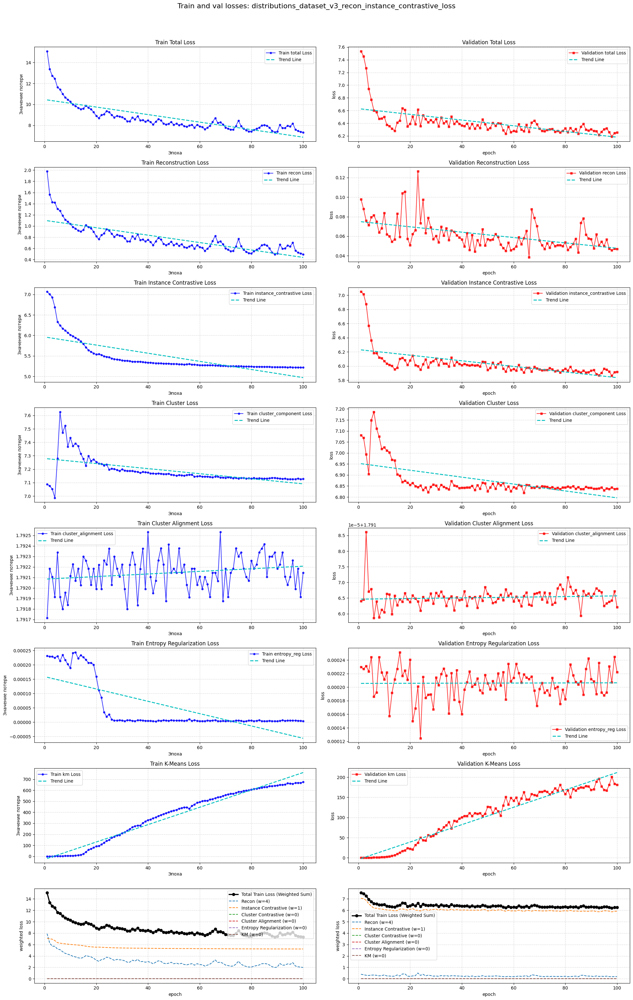

In [42]:
class Config(object):
    batch_size = 600
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = 1 # Input feature dimension
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    hidden_norm_cluster = False # For cluster contrastive loss
    standard_scaler = True
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_recon_instance_contrastive_loss'
    weight_recon = 4
    weight_instance_contrastive = 1
    weight_cluster_component = 0
    weight_km = 0
    weight_entropy_reg = 0
    weight_cluster_alignment = 0
    window_size = 32
    stride = 16
    num_epochs = 100
    train_ratio = 6/8
    
config_stage1 = Config()
model = RNNClusteringModel(config_stage1)
model1, loss_logs1, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(distributions_dataset, labels, config_stage1.config_name, config_stage1, model, None, jitter, sigma=0.03)
plot_loss_histories(loss_logs1, config_stage1)

In [ ]:
#try1
# Best NMI: 0.3794 at epoch 24
# Best RI: 0.8001 at epoch 7
# Best ACC: 0.5529 at epoch 13
# Best ARI: 0.3118 at epoch 14
# Best LOSS: 6.1908 at epoch 98

/tmp/ipykernel_31/560927591.py:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('./BEST_LOSS_model/distributions_dataset_v3_recon_instance_

augmentation...
creating windows...
Each fragment is divided into 8 parts
Each fragment is divided into 8 parts
Each fragment is divided into 8 parts
Each fragment is divided into 8 parts
without signatures...
standard scaler
Using device: cuda
Dataset: distributions_dataset_v3_cluster_contrastive_kmeans_loss
Train windows: 7200, Validation windows: 2400
Batch size: 600 (6 classes * 100 samples/class)
Window length (num_steps): 32, Classes: 6

--- Actual composition of the first training batch ---
  - Class 0: 97
  - Class 1: 113
  - Class 2: 101
  - Class 3: 95
  - Class 4: 101
  - Class 5: 93
-----------------------------------------------------


 Epoch 1/50 | Train Loss: 15.8494 | Recon: 0.5614 | Instance Contrastive: 5.2294 | Cluster Contrastive: 7.1022 | KM: 651.7862 | Entropy Regularization : 0.0000 | Cluster Alignment : 1.7923 

Epoch 1 Train Metrics (avg over batches): NMI: 0.3738, RI: 0.7804, ACC: 0.4947, ARI: 0.2729

--- Actual composition of the first validation batch ---
 

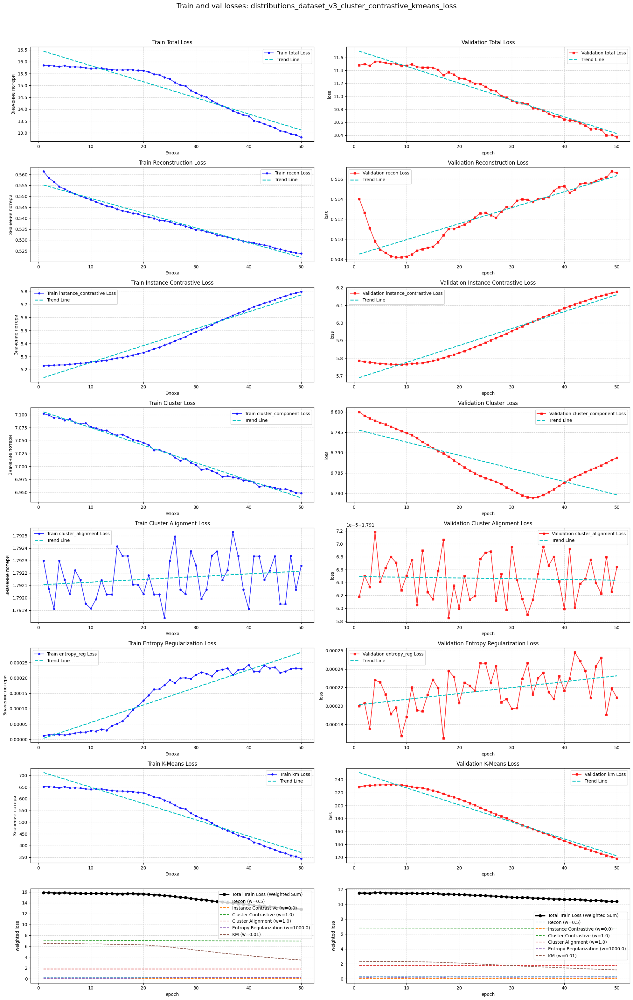

In [43]:
config_stage2 = Config()
config_stage2.config_name = 'distributions_dataset_v3_cluster_contrastive_kmeans_loss'
config_stage2.learning_rate = 1e-5
config_stage2.num_epochs = 50
config_stage2.weight_recon = 0.5
config_stage2.weight_instance_contrastive = 0.0
config_stage2.weight_cluster_component = 1.0
config_stage2.weight_km = 0.01
config_stage2.weight_entropy_reg = 1000.0
config_stage2.weight_cluster_alignment = 1.0
model = model1
# model.load_state_dict(torch.load('./ACC_model/distributions_dataset_v3_recon_instance_contrastive_loss/best_acc_model.pth'))
model.load_state_dict(torch.load('./BEST_LOSS_model/distributions_dataset_v3_recon_instance_contrastive_loss/best_val_loss_model.pth'))


model2, loss_logs2, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(distributions_dataset, labels, config_stage2.config_name, config_stage2, model, None, jitter, sigma=0.03)

plot_loss_histories(loss_logs2, config_stage2)

In [ ]:
# Best NMI: 0.3802 at epoch 14
# Best RI: 0.8001 at epoch 9
# Best ACC: 0.5479 at epoch 36
# Best ARI: 0.3125 at epoch 36
# Best LOSS: 10.3695 at epoch 50

augmentation...
creating windows...
Each fragment is divided into 8 parts
Each fragment is divided into 8 parts
Each fragment is divided into 8 parts
Each fragment is divided into 8 parts
without signatures...
standard scaler
Using device: cuda
Dataset: distributions_dataset_v3_recon_instance_contrastive_cluster_component_loss
Train windows: 7200, Validation windows: 2400
Batch size: 600 (6 classes * 100 samples/class)
Window length (num_steps): 32, Classes: 6

--- Actual composition of the first training batch ---
  - Class 0: 106
  - Class 1: 103
  - Class 2: 102
  - Class 3: 105
  - Class 4: 100
  - Class 5: 84
-----------------------------------------------------


 Epoch 1/100 | Train Loss: 22.0590 | Recon: 1.9744 | Instance Contrastive: 6.9963 | Cluster Contrastive: 7.0619 | KM: 0.4842 | Entropy Regularization : 0.0002 | Cluster Alignment : 1.7918 

Epoch 1 Train Metrics (avg over batches): NMI: 0.3594, RI: 0.7082, ACC: 0.4546, ARI: 0.2311

--- Actual composition of the first val

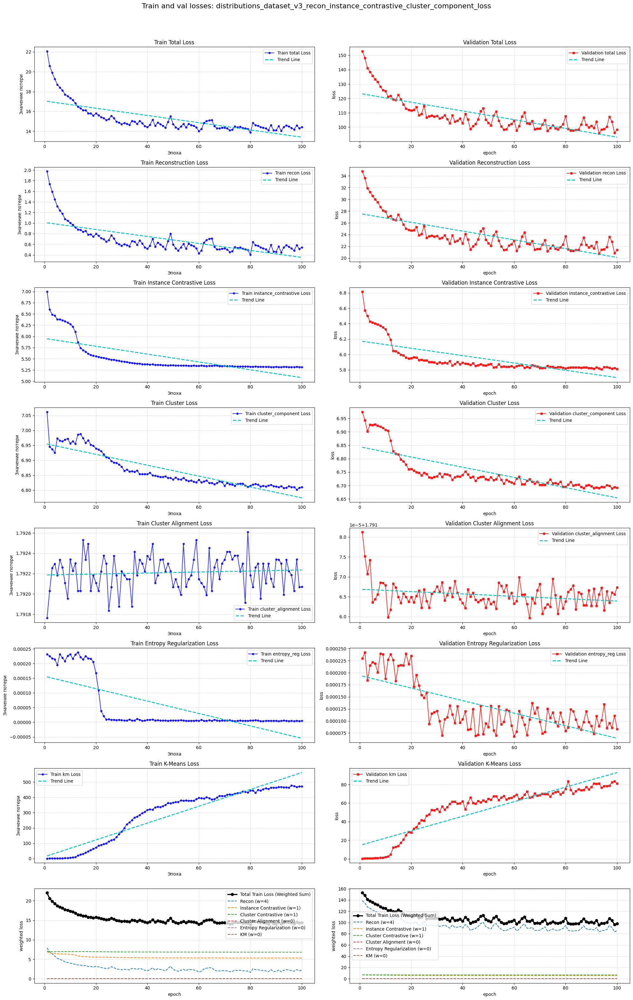

In [45]:
class Config(object):
    batch_size = 600
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = 1 # Input feature dimension
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    standard_scaler = True
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_recon_instance_contrastive_cluster_component_loss'
    weight_recon = 4
    weight_instance_contrastive = 1
    weight_cluster_component = 1
    weight_km = 0
    weight_entropy_reg = 0
    weight_cluster_alignment = 0
    window_size = 32
    stride = 16
    num_epochs = 100
    train_ratio = 6/8
    
config_stage1 = Config()
model = RNNClusteringModel(config_stage1)
model1, loss_logs1, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(distributions_dataset, labels, config_stage1.config_name, config_stage1, model, None, jitter, sigma=0.03)
plot_loss_histories(loss_logs1, config_stage1)

In [ ]:
#try1
# Best NMI: 0.4237 at epoch 22
# Best RI: 0.7845 at epoch 94
# Best ACC: 0.5363 at epoch 91
# Best ARI: 0.3301 at epoch 94
# Best LOSS: 95.7067 at epoch 93

/tmp/ipykernel_31/239200538.py:12: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('./BEST_LOSS_model/distributions_dataset_v3_recon_instance_

augmentation...
creating windows...
Each fragment is divided into 8 parts
Each fragment is divided into 8 parts
Each fragment is divided into 8 parts
Each fragment is divided into 8 parts
without signatures...
standard scaler
Using device: cuda
Dataset: distributions_dataset_v3_kmeans_loss
Train windows: 7200, Validation windows: 2400
Batch size: 600 (6 classes * 100 samples/class)
Window length (num_steps): 32, Classes: 6

--- Actual composition of the first training batch ---
  - Class 0: 103
  - Class 1: 113
  - Class 2: 81
  - Class 3: 99
  - Class 4: 110
  - Class 5: 94
-----------------------------------------------------


 Epoch 1/100 | Train Loss: 22.7233 | Recon: 0.7650 | Instance Contrastive: 5.3262 | Cluster Contrastive: 6.8725 | KM: 481.6877 | Entropy Regularization : 0.0000 | Cluster Alignment : 1.7922 

Epoch 1 Train Metrics (avg over batches): NMI: 0.4237, RI: 0.7640, ACC: 0.5111, ARI: 0.3018

--- Actual composition of the first validation batch ---
  - Class 0: 112
  -

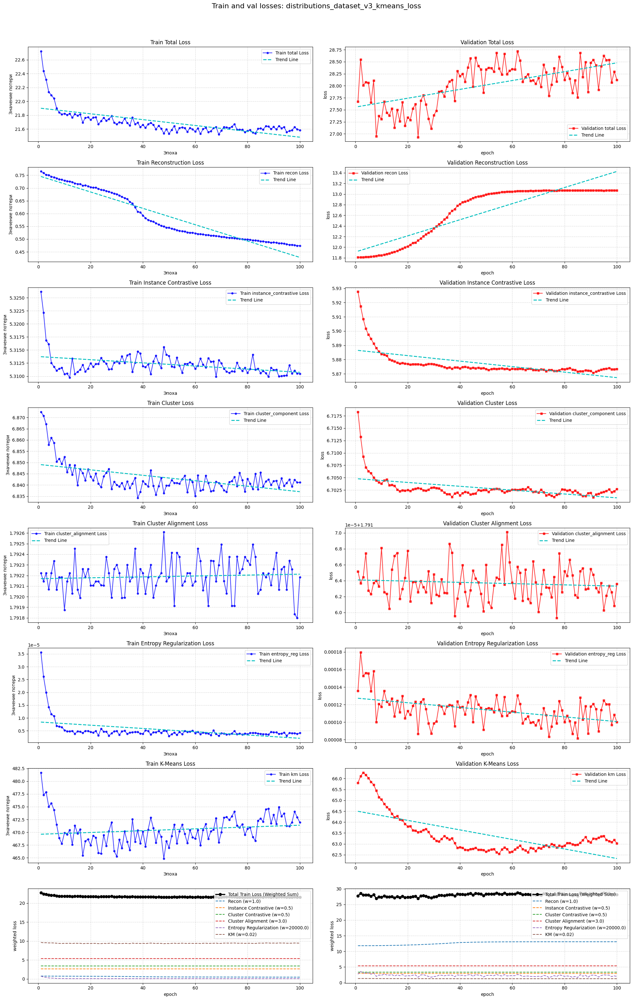

In [48]:
config_stage2 = Config()
config_stage2.config_name = 'distributions_dataset_v3_kmeans_loss'
config_stage2.learning_rate = 1e-5
config_stage2.num_epochs = 100
config_stage2.weight_recon = 1.0
config_stage2.weight_instance_contrastive = 0.5
config_stage2.weight_cluster_component = 0.5
config_stage2.weight_km = 0.02
config_stage2.weight_entropy_reg = 20000.0
config_stage2.weight_cluster_alignment = 3.0
model = model1
model.load_state_dict(torch.load('./BEST_LOSS_model/distributions_dataset_v3_recon_instance_contrastive_cluster_component_loss/best_val_loss_model.pth'))

model2, loss_logs2, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(distributions_dataset, labels, config_stage2.config_name, config_stage2, model, None, jitter, sigma=0.03)

plot_loss_histories(loss_logs2, config_stage2)

/tmp/ipykernel_31/845866512.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model2.load_state_dict(torch.load('./NMI_model/distributions_dataset_v3_kmeans_loss/best_nmi_

Получение эмбеддингов для визуализации...
Извлечено 9600 эмбеддингов размерности 400.

Снижение размерности с помощью UMAP...
Снижение до 4D UMAP компонент...
Построение графика UMAP (Компоненты 1 и 2)...
График сохранен: ./Figure/distributions_dataset_v3_kmeans_loss_emb_c1c2_Components_1_and_2.png


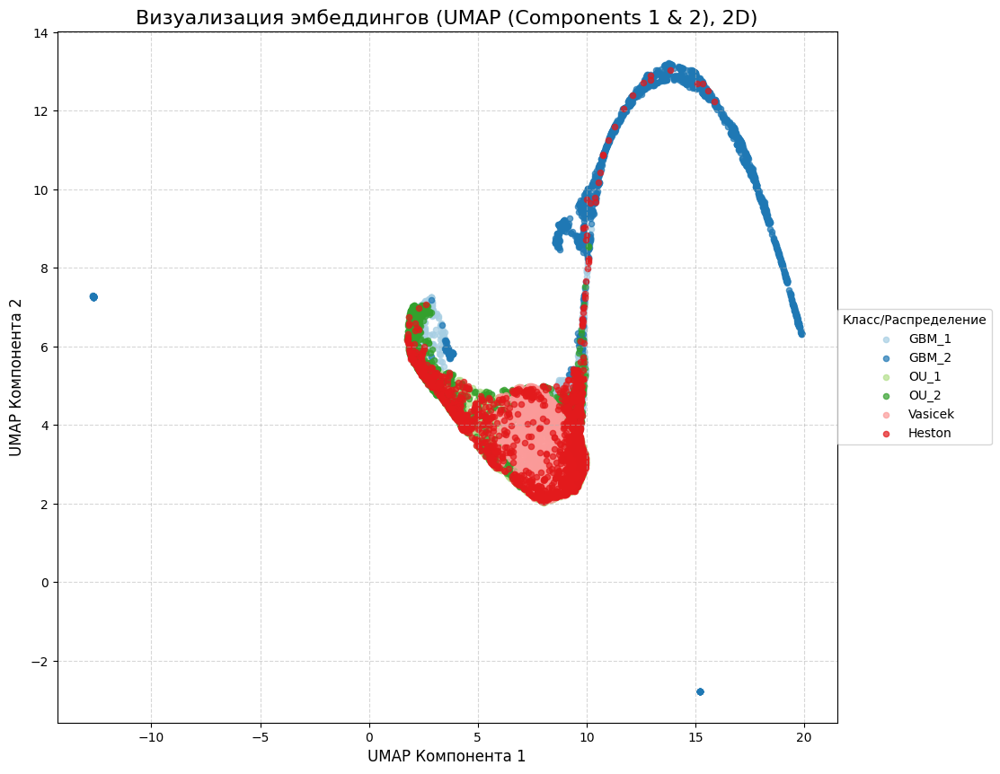

Построение графика UMAP (Компоненты 1 и 3)...
График сохранен: ./Figure/distributions_dataset_v3_kmeans_loss_emb_c1c3_Components_1_and_3.png


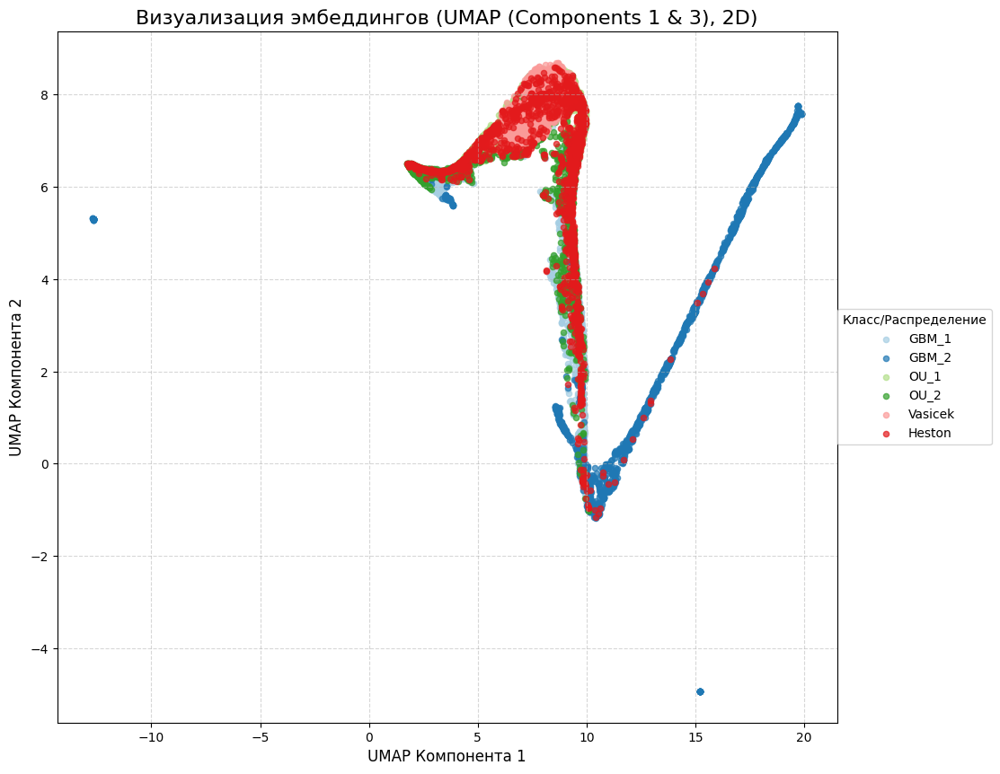

Построение графика UMAP (Компоненты 2 и 4)...
График сохранен: ./Figure/distributions_dataset_v3_kmeans_loss_emb_c2c4_Components_2_and_4.png


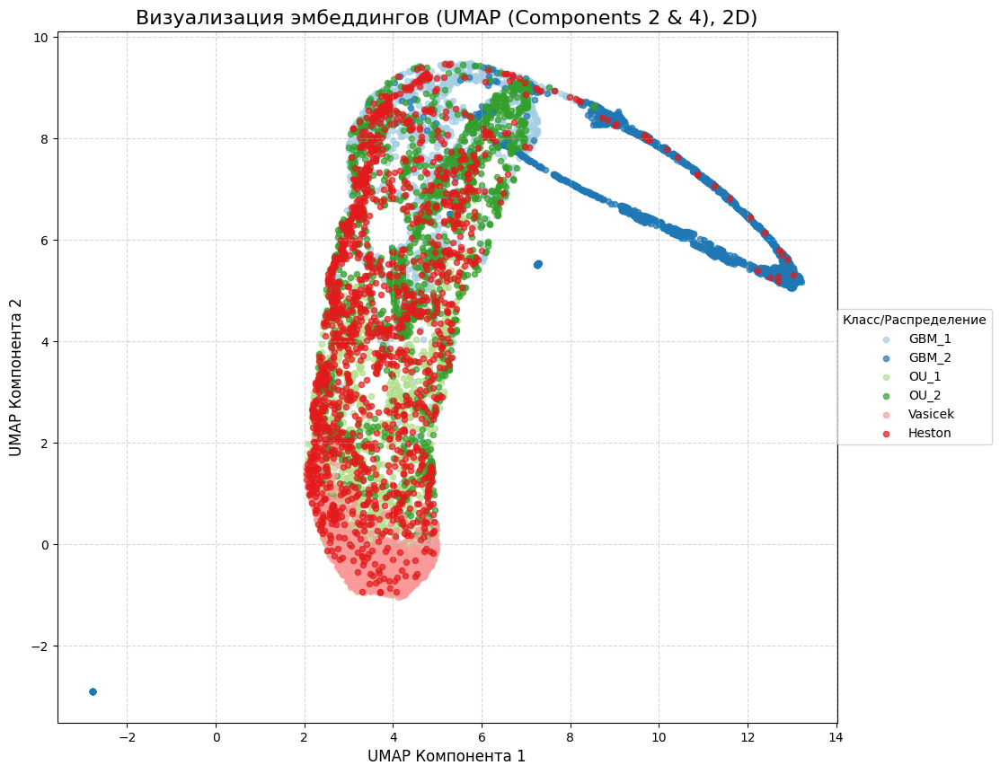

In [51]:
data_np = np.concatenate([train_data_orig_final, test_data_orig_final], axis=0)
label_np = np.concatenate([train_labels_final, test_labels_final], axis=0)
model2.load_state_dict(torch.load('./NMI_model/distributions_dataset_v3_kmeans_loss/best_nmi_model.pth'))
visualize_embeddings_with_umap(
    model2,
    data_np,
    label_np,
    config_stage2,
    'cuda',
    distribution_names=distribution_names
)

augmentation...
creating windows...
Each fragment is divided into 8 parts
Each fragment is divided into 8 parts
Each fragment is divided into 8 parts
Each fragment is divided into 8 parts
Signature's type: sig
Signature's shape: (7200, 254)
Signature's shape: (7200, 254)
Signature's shape: (2400, 254)
Signature's shape: (2400, 254)
standard scaler
Using device: cuda
Dataset: distributions_dataset_v3_sigs_recon_instance_contrastive_cluster_component_loss
Train windows: 7200, Validation windows: 2400
Batch size: 600 (6 classes * 100 samples/class)
Window length (num_steps): 254, Classes: 6

--- Actual composition of the first training batch ---
  - Class 0: 88
  - Class 1: 107
  - Class 2: 86
  - Class 3: 100
  - Class 4: 110
  - Class 5: 109
-----------------------------------------------------


 Epoch 1/100 | Train Loss: 22.0450 | Recon: 1.9458 | Instance Contrastive: 7.0743 | Cluster Contrastive: 7.0906 | KM: 0.6990 | Entropy Regularization : 0.0002 | Cluster Alignment : 1.7920 

Epo

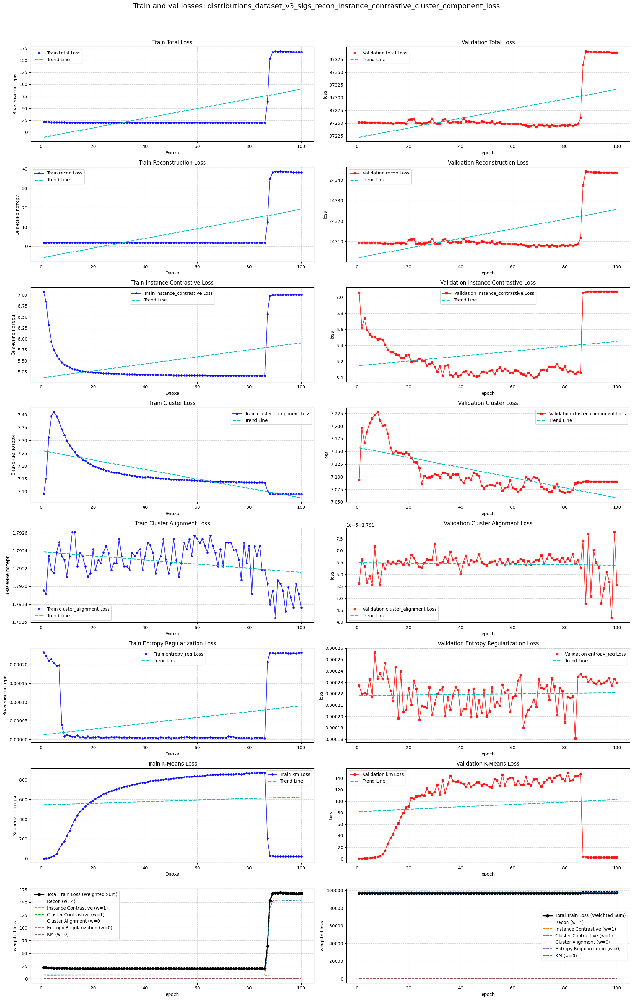

In [52]:
class SigParams(object):
    sig_type = 'sig'
    normalize_timeline = True
    activation = 'tanh'
    seed = 42
    sig_level = 7
    
class Config(object):
    batch_size = 600
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = 1 # Input feature dimension
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    standard_scaler = True
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_sigs_recon_instance_contrastive_cluster_component_loss'
    weight_recon = 4
    weight_instance_contrastive = 1
    weight_cluster_component = 1
    weight_km = 0
    weight_entropy_reg = 0
    weight_cluster_alignment = 0
    window_size = 32
    stride = 16
    num_epochs = 100
    train_ratio = 6/8
    
config_stage1 = Config()
model = RNNClusteringModel(config_stage1)
model1, loss_logs1, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(distributions_dataset, labels, config_stage1.config_name, config_stage1, model, SigParams(), jitter, sigma=0.03)
plot_loss_histories(loss_logs1, config_stage1)

In [ ]:
#try1
# Best NMI: 0.2108 at epoch 85
# Best RI: 0.7544 at epoch 86
# Best ACC: 0.3837 at epoch 86
# Best ARI: 0.1386 at epoch 40
# Best LOSS: 97242.0440 at epoch 69

/tmp/ipykernel_31/3354417959.py:12: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('./NMI_model/distributions_dataset_v3_sigs_recon_instance_

augmentation...
creating windows...
Each fragment is divided into 8 parts
Each fragment is divided into 8 parts
Each fragment is divided into 8 parts
Each fragment is divided into 8 parts
Signature's type: sig
Signature's shape: (7200, 254)
Signature's shape: (7200, 254)
Signature's shape: (2400, 254)
Signature's shape: (2400, 254)
standard scaler
Using device: cuda
Dataset: distributions_dataset_v3_sigs_kmeans_loss
Train windows: 7200, Validation windows: 2400
Batch size: 600 (6 classes * 100 samples/class)
Window length (num_steps): 254, Classes: 6

--- Actual composition of the first training batch ---
  - Class 0: 94
  - Class 1: 107
  - Class 2: 106
  - Class 3: 97
  - Class 4: 108
  - Class 5: 88
-----------------------------------------------------


 Epoch 1/50 | Train Loss: 30.3573 | Recon: 1.9179 | Instance Contrastive: 5.1750 | Cluster Contrastive: 7.1273 | KM: 824.4595 | Entropy Regularization : 0.0000 | Cluster Alignment : 1.7922 

Epoch 1 Train Metrics (avg over batches):

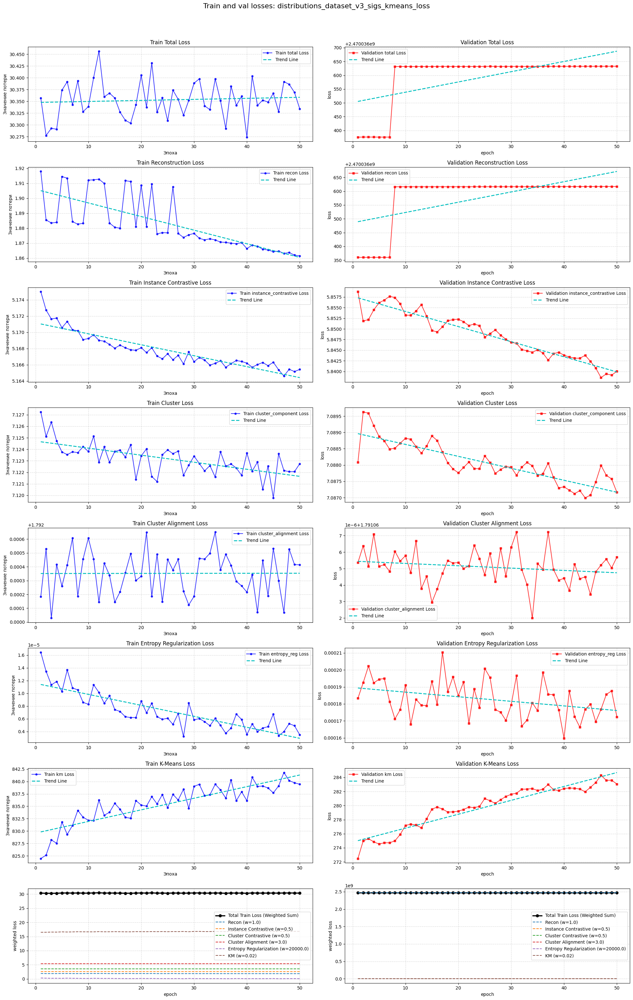

In [53]:
config_stage2 = Config()
config_stage2.config_name = 'distributions_dataset_v3_sigs_kmeans_loss'
config_stage2.learning_rate = 1e-5
config_stage2.num_epochs = 50
config_stage2.weight_recon = 1.0
config_stage2.weight_instance_contrastive = 0.5
config_stage2.weight_cluster_component = 0.5
config_stage2.weight_km = 0.02
config_stage2.weight_entropy_reg = 20000.0
config_stage2.weight_cluster_alignment = 3.0
model = model1
model.load_state_dict(torch.load('./NMI_model/distributions_dataset_v3_sigs_recon_instance_contrastive_cluster_component_loss/best_nmi_model.pth'))

model2, loss_logs2, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(distributions_dataset, labels, config_stage2.config_name, config_stage2, model, SigParams(), jitter, sigma=0.03)

plot_loss_histories(loss_logs2, config_stage2)

/tmp/ipykernel_31/845866512.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model2.load_state_dict(torch.load('./NMI_model/distributions_dataset_v3_kmeans_loss/best_nmi_

Получение эмбеддингов для визуализации...
Извлечено 9600 эмбеддингов размерности 400.

Снижение размерности с помощью UMAP...
Снижение до 4D UMAP компонент...
Построение графика UMAP (Компоненты 1 и 2)...
График сохранен: ./Figure/distributions_dataset_v3_sigs_kmeans_loss_emb_c1c2_Components_1_and_2.png


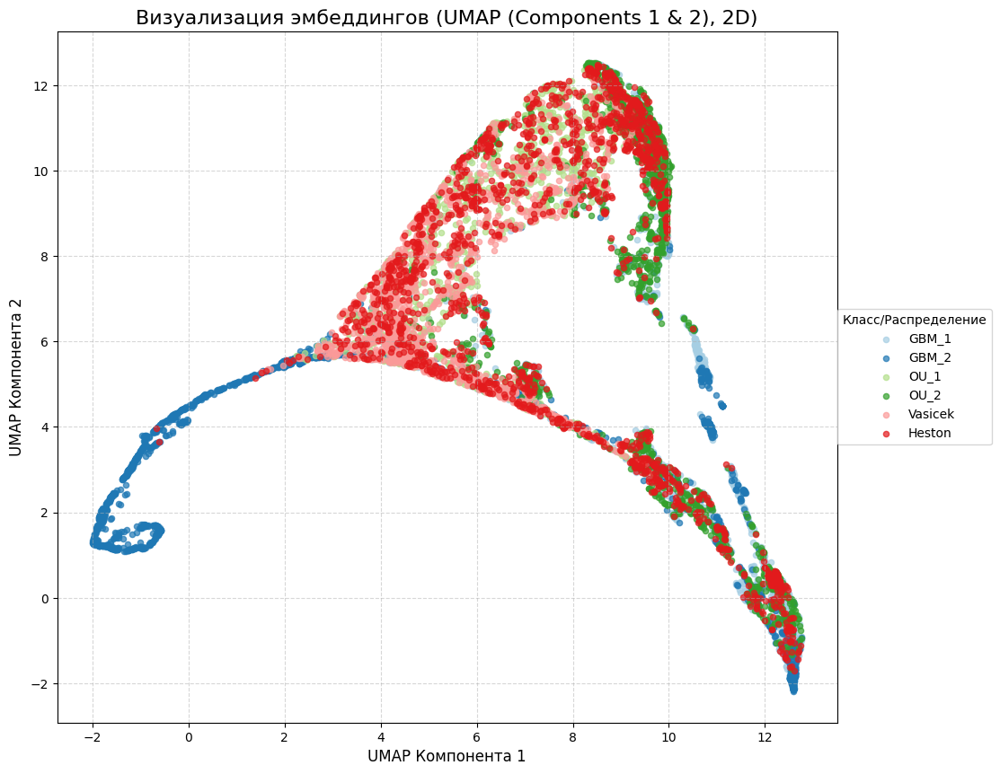

Построение графика UMAP (Компоненты 1 и 3)...
График сохранен: ./Figure/distributions_dataset_v3_sigs_kmeans_loss_emb_c1c3_Components_1_and_3.png


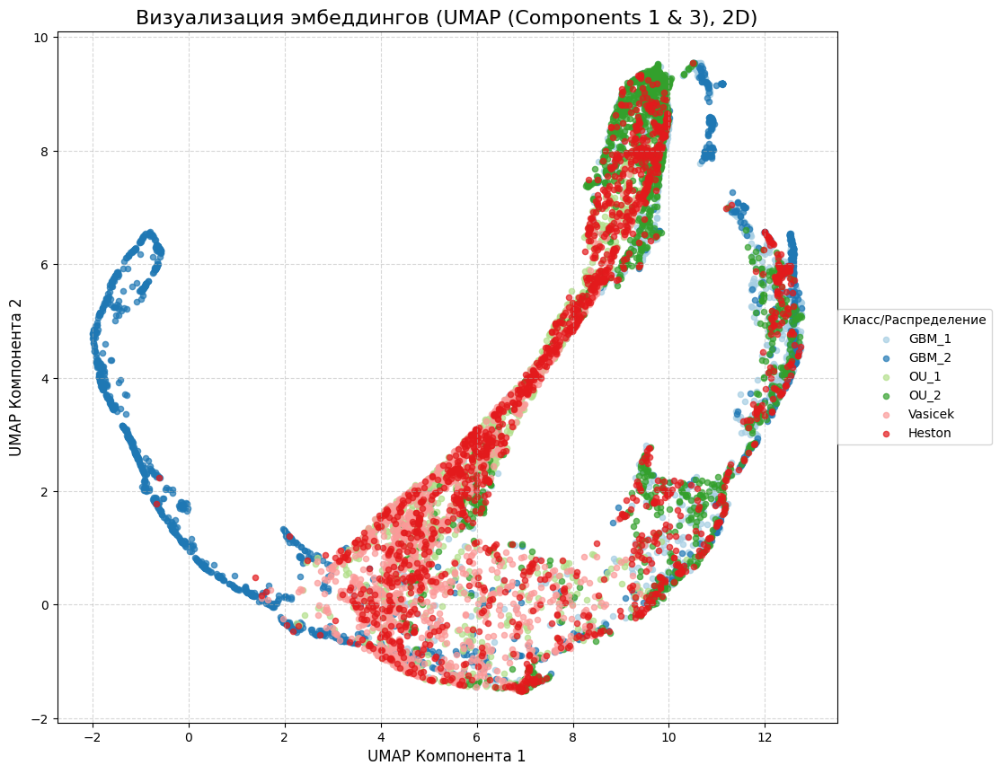

Построение графика UMAP (Компоненты 2 и 4)...
График сохранен: ./Figure/distributions_dataset_v3_sigs_kmeans_loss_emb_c2c4_Components_2_and_4.png


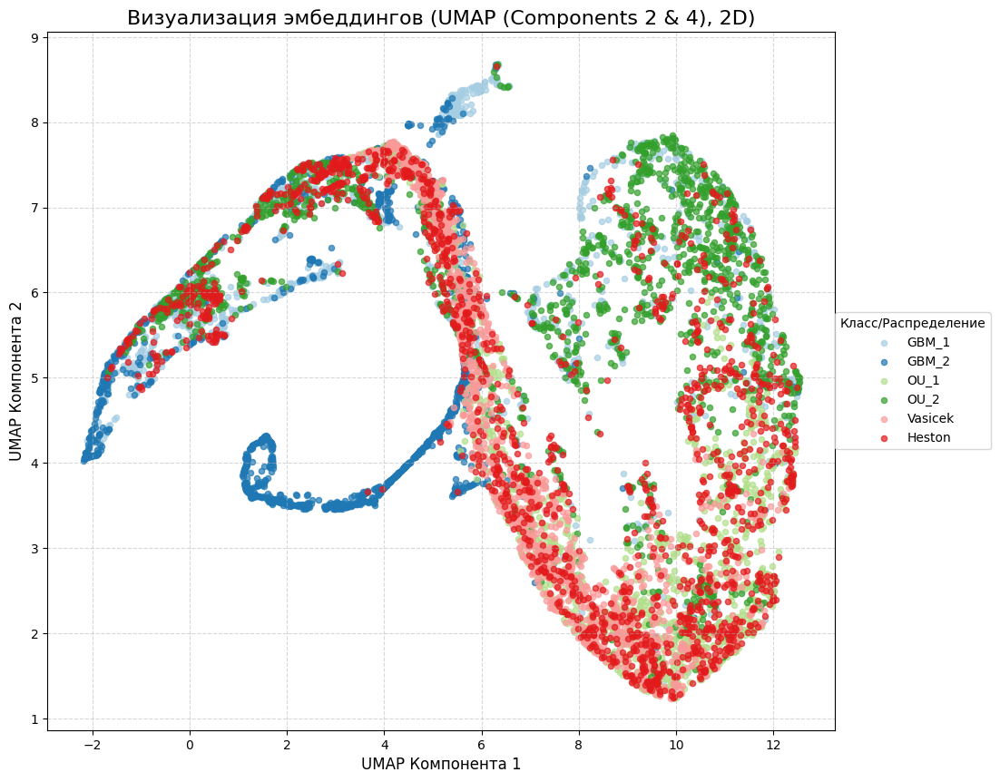

In [54]:
data_np = np.concatenate([train_data_orig_final, test_data_orig_final], axis=0)
label_np = np.concatenate([train_labels_final, test_labels_final], axis=0)
model2.load_state_dict(torch.load('./NMI_model/distributions_dataset_v3_kmeans_loss/best_nmi_model.pth'))
visualize_embeddings_with_umap(
    model2,
    data_np,
    label_np,
    config_stage2,
    'cuda',
    distribution_names=distribution_names
)

# **Signature on full ts derived on windows by formula X_new_t = Sig[0,t]**

In [17]:
def preprocess_signature_stream(windows_np, sig_level, normalize_timeline=False):
    if windows_np.ndim == 2:
        windows_np = np.expand_dims(windows_np, axis=2)
    
    windows_with_time = AddTimeline(windows_np)
    
    if normalize_timeline:
        for i in range(windows_with_time.shape[0]):
            windows_with_time[i, :, 0] = normalize_arr(windows_with_time[i, :, 0])
    
    full_sigs = full_signature(windows_with_time, sig_level)
    
    print(f"Signature's shape: {full_sigs.shape}")
    return full_sigs

def preprocess_log_signature_stream(windows_np, sig_level, normalize_timeline=False):    
    if windows_np.ndim == 2:
        windows_np = np.expand_dims(windows_np, axis=2)
        
    windows_with_time = AddTimeline(windows_np)

    if normalize_timeline:
        for i in range(windows_with_time.shape[0]):
            windows_with_time[i, :, 0] = normalize_arr(windows_with_time[i, :, 0])
    
    full_log_sigs = full_logsignature(windows_with_time, sig_level)
    
    print(f"Log-Signature's shape: {full_log_sigs.shape}")
    return full_log_sigs
    
def preprocess_randomized_signature_stream(windows_np, sig_dim_k, normalize_timeline=False, activation='tanh', seed=42):    
    if windows_np.ndim == 2:
        windows_np = np.expand_dims(windows_np, axis=2)
        
    windows_with_time = AddTimeline(windows_np)

    if normalize_timeline:
        for i in range(windows_with_time.shape[0]):
            windows_with_time[i, :, 0] = normalize_arr(windows_with_time[i, :, 0])
    
    full_r_sigs = RandomizedSignatureBatch(windows_with_time, k=sig_dim_k, activation=activation, seed=seed)
    
    print(f"Rand-Signature's shape: {full_r_sigs.shape}")
    return full_r_sigs

In [18]:
def run_pipeline(
    distributions_dataset_orig,
    labels_orig,
    dataset_name,
    config,
    model=None,
    signature_params=None,      # {'type': 'r-sig', 'k': 200, 'normalize_timeline': False}
    augmentation_func=jitter,
    **aug_params
):

    print("augmentation...")
    # augmentation_func needs (N, T, C), distributions_dataset_orig - (N, T)

    data_to_augment = np.expand_dims(distributions_dataset_orig, axis=-1)
    augmented_dataset_orig = augmentation_func(data_to_augment, **aug_params).squeeze(-1)

    if signature_params:
        sig_type = signature_params.sig_type
        print(f"Signature's type: {sig_type}")
        if sig_type == 'rand-sig':
            k = signature_params.sig_dim_k
            processed_data_orig = preprocess_randomized_signature_stream(distributions_dataset_orig, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)
            processed_data_aug = preprocess_randomized_signature_stream(augmented_dataset_orig, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)
        
        elif sig_type == 'sig':
            processed_data_orig = preprocess_signature_stream(distributions_dataset_orig, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            processed_data_aug = preprocess_signature_stream(augmented_dataset_orig, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)

        elif sig_type == 'log-sig':
            processed_data_orig = preprocess_signature_stream(distributions_dataset_orig, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            processed_data_aug = preprocess_signature_stream(augmented_dataset_orig, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)

        else:
            raise ValueError(f"Unknown signature_type: {sig_type}")

        print(f"processed_data_orig.shape : {processed_data_orig.shape}")
        config.embedding_size = processed_data_orig.shape[2]

    else:
        print("without signatures...")
        processed_data_orig = np.expand_dims(distributions_dataset_orig, axis=-1)
        processed_data_aug = np.expand_dims(augmented_dataset_orig, axis=-1)

        config.embedding_size = processed_data_orig.shape[2] if processed_data_orig.ndim == 3 else 1

    combined_processed_data = np.concatenate((processed_data_orig, processed_data_aug), axis=2)
    
    train_full, test_full, train_labels, test_labels = train_test_split(
        combined_processed_data, labels_orig, stratify=labels_orig, 
        train_size=config.train_ratio, random_state=42
    )

    train_processed_orig = train_full[:, :, :config.embedding_size]
    train_processed_aug = train_full[:, :, config.embedding_size:]
    
    test_processed_orig = test_full[:, :, :config.embedding_size]
    test_processed_aug = test_full[:, :, config.embedding_size:]


    train_windows_orig, train_window_labels = create_sliding_windows(train_processed_orig, train_labels, config.window_size, config.stride)
    train_windows_aug, _ = create_sliding_windows(train_processed_aug, train_labels, config.window_size, config.stride)
    
    test_windows_orig, test_window_labels = create_sliding_windows(test_processed_orig, test_labels, config.window_size, config.stride)
    test_windows_aug, _ = create_sliding_windows(test_processed_aug, test_labels, config.window_size, config.stride)

    config.num_steps = train_windows_orig.shape[1] 
    print(config.num_steps)

    if config.scaler is not None:
        scaler = config.scaler()
        # reshape(N_win*T_win, C)
        print(train_windows_orig.shape)
        train_orig_reshaped = train_windows_orig.reshape(-1, config.embedding_size)
        print(train_orig_reshaped.shape)
        train_aug_reshaped = train_windows_aug.reshape(-1, config.embedding_size)
        
        test_orig_reshaped = test_windows_orig.reshape(-1, config.embedding_size)
        test_aug_reshaped = test_windows_aug.reshape(-1, config.embedding_size)

        scaler.fit(np.concatenate((train_orig_reshaped, train_aug_reshaped, test_orig_reshaped, test_aug_reshaped), axis=0))
        
        train_data_orig_final = scaler.transform(train_orig_reshaped).reshape(train_windows_orig.shape)
        train_data_aug_final = scaler.transform(train_aug_reshaped).reshape(train_windows_aug.shape)
        test_data_orig_final = scaler.transform(test_orig_reshaped).reshape(test_windows_orig.shape)
        test_data_aug_final = scaler.transform(test_aug_reshaped).reshape(test_windows_aug.shape)

    else:
        train_data_orig_final, train_data_aug_final = train_windows_orig, train_windows_aug
        test_data_orig_final, test_data_aug_final = test_windows_orig, test_windows_aug

    train_labels_final, test_labels_final = train_window_labels, test_window_labels

    print(f"num_steps={config.num_steps}, embedding_size={config.embedding_size}")
    print(f"train_data_orig_final.shape {train_data_orig_final.shape}")

    if model is None:
        model = RNNClusteringModel(config)
    model, metrics, loss_logs = run_model(
        dataset_name, 
        train_data_orig_final, 
        train_data_aug_final, 
        train_labels_final,
        test_data_orig_final,
        test_data_aug_final,
        test_labels_final,
        model,
        config
    )
    
    log_dir = 'Logs'
    os.makedirs(log_dir, exist_ok=True)
    log_file = os.path.join(log_dir, f'{dataset_name}_log.txt')
    with open(log_file, 'a') as f:
        f.write(f'Dataset: {dataset_name}\n')
        f.write(f'PyTorch Model Config:\n'
                f'Encoder Hidden: {config.hidden_size}, weight_recon, weight_instance_contrastive , weight_cluster_component , weight_km : {config.weight_recon, config.weight_instance_contrastive , config.weight_cluster_component , config.weight_km}, Batch Size: {config.batch_size}\n'
                f'Learning Rate: {config.learning_rate}, Dilations: {config.dilations}\n')
        f.write(f'Best NMI = {metrics.best_nmi:.4f} at epoch {metrics.best_epoch_nmi}\n'
                f'Best RI  = {metrics.best_ri:.4f} at epoch {metrics.best_epoch_ri}\n\n')
        f.write(f'Best ACC = {metrics.best_acc:.4f} at epoch {metrics.best_epoch_acc}\n'
                f'Best ARI  = {metrics.best_ari:.4f} at epoch {metrics.best_epoch_ari}\n\n')
        f.write(f'Best loss = {metrics.best_loss:.4f} at epoch {metrics.best_epoch_loss}\n\n')
    print(f"Logging complete to {log_file}")

    return model, loss_logs, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final

In [19]:
@torch.no_grad()
def get_embeddings_for_visualization(model, input_data_np, device):
    model.eval()

    if input_data_np.ndim != 3:
        if input_data_np.ndim == 2:
            input_data_np = np.expand_dims(input_data_np, axis=-1)
        else:
            return None

    inputs_orig_torch = torch.from_numpy(input_data_np).float().to(device)

    try:
        h_orig = model.get_hidden_representation(inputs_orig_torch)
        
        embeddings_np = h_orig.detach().cpu().numpy()
        print(f"Извлечено {embeddings_np.shape[0]} эмбеддингов размерности {embeddings_np.shape[1]}.")
        return embeddings_np
    except Exception as e:
        print(f"Ошибка при получении эмбеддингов из модели: {e}")
        import traceback
        traceback.print_exc()
        return None

In [20]:
import numpy as np

def create_sliding_windows(time_series_data, labels, window_size, stride):
    """

    Args:
        time_series_data (numpy.ndarray): (N_series, series_length) or (N_series, series_length, N_features).
        labels (numpy.ndarray): (N_series,).
        window_size (int): 
        stride (int): 

    Returns:
        tuple: (
            numpy.ndarray: (N_total_windows, window_size, N_features).
            numpy.ndarray: (N_total_windows,).
        )
    """
    if not isinstance(time_series_data, np.ndarray):
        time_series_data = np.array(time_series_data)
    if not isinstance(labels, np.ndarray):
        labels = np.array(labels)

    if time_series_data.ndim == 2: # (N, T)
        n_series, series_length = time_series_data.shape
        n_features = 1
        time_series_data = np.expand_dims(time_series_data, axis=2)
    elif time_series_data.ndim == 3: # (N, T, C)
        n_series, series_length, n_features = time_series_data.shape
    else:
        raise ValueError(f"time_series_data.shape: {time_series_data.shape}")
    
    n_windows_per_series = (series_length - window_size) // stride + 1

    print(f"Each fragment is divided into {n_windows_per_series} windows.")
    
    total_windows = n_series * n_windows_per_series
    
    windows = np.zeros((total_windows, window_size, n_features), dtype=time_series_data.dtype)
    window_labels = np.zeros(total_windows, dtype=labels.dtype)
    
    current_window_idx = 0
    for i in range(n_series):
        for j in range(n_windows_per_series):
            start = j * stride
            end = start + window_size
            
            windows[current_window_idx] = time_series_data[i, start:end, :]
            window_labels[current_window_idx] = labels[i]
            
            current_window_idx += 1
            
    return windows, window_labels

In [21]:
class TimeSeriesAugmentedDataset(Dataset):

    def __init__(self, original_data, augmented_data, labels):
        if not isinstance(original_data, torch.Tensor):
            self.original_data = torch.from_numpy(original_data).float()
        else:
            self.original_data = original_data.float()

        if not isinstance(augmented_data, torch.Tensor):
            self.augmented_data = torch.from_numpy(augmented_data).float()
        else:
            self.augmented_data = augmented_data.float()
            
        if not isinstance(labels, torch.Tensor):
            self.labels = torch.from_numpy(labels).long()
        else:
            self.labels = labels.long()

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        return self.original_data[idx], self.augmented_data[idx], self.labels[idx]

In [22]:
def run_model(
    dataset_name, 
    train_data_orig, 
    train_data_aug, 
    train_labels,
    test_data_orig,
    test_data_aug,
    test_labels,
    model,
    config
):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")

    model.to(device)

    train_dataset = TimeSeriesAugmentedDataset(train_data_orig, train_data_aug, train_labels)
    val_dataset = TimeSeriesAugmentedDataset(test_data_orig, test_data_aug, test_labels)
    
    n_classes = len(np.unique(train_labels))
    batch_size = config.batch_size
    n_samples_per_class = batch_size // n_classes

    # train_sampler = StratifiedBatchSampler(train_labels, n_classes, n_samples_per_class)
    # train_loader = DataLoader(train_dataset, batch_sampler=train_sampler, num_workers=2, pin_memory=True)

    train_loader = DataLoader(train_dataset, batch_size=config.batch_size, shuffle=True, num_workers=2, pin_memory=True)
    val_loader = DataLoader(val_dataset, batch_size=config.test_batch_size, shuffle=False, num_workers=2, pin_memory=True)

    # config.num_steps = train_data_orig.shape[1]
    print(f"num_steps={config.num_steps}, embedding_size={config.embedding_size}")

    num_epochs = config.num_epochs

    train_label_np_transf, num_classes_check = transfer_labels(train_labels)
    config.class_num = num_classes_check

    loss_logs = {
        'train_total': [], 'val_total': [],
        'train_recon': [], 'val_recon': [],
        'train_km': [], 'val_km': [],
        'train_instance_contrastive': [], 'val_instance_contrastive': [],
        'train_cluster_component': [], 'val_cluster_component': [],
        'train_entropy_reg': [], 'val_entropy_reg': [],
        'train_cluster_alignment': [], 'val_cluster_alignment': [],
        
        'train_weighted_recon': [], 'val_weighted_recon': [],
        'train_weighted_km': [], 'val_weighted_km': [],
        'train_weighted_instance_contrastive': [], 'val_weighted_instance_contrastive': [],
        'train_weighted_cluster_component': [], 'val_weighted_cluster_component': [],
        'train_weighted_entropy_reg': [], 'val_weighted_entropy_reg': [],
        'train_weighted_cluster_alignment': [], 'val_weighted_cluster_alignment': [],
    }
    
    print(f'Dataset: {dataset_name}')
    print(f'Train windows: {len(train_dataset)}, Validation windows: {len(val_dataset)}')
    print(f'Batch size: {config.batch_size} ({n_classes} classes * {n_samples_per_class} samples/class)')
    print(f'Window length (num_steps): {config.num_steps}, Classes: {config.class_num}')

    optimizer = optim.AdamW(model.parameters(), lr=config.learning_rate)

    best_nmi, best_ri, best_acc, best_ari = 0, 0, 0, 0
    best_epoch_nmi, best_epoch_ri, best_epoch_acc, best_epoch_ari = -1, -1, -1, -1
    best_val_loss = float('inf')
    best_epoch_loss = -1
    
    os.makedirs(f'./NMI_model/{dataset_name}/', exist_ok=True)
    os.makedirs(f'./RI_model/{dataset_name}/', exist_ok=True)
    os.makedirs(f'./ACC_model/{dataset_name}/', exist_ok=True)
    os.makedirs(f'./ARI_model/{dataset_name}/', exist_ok=True)
    os.makedirs(f'./BEST_LOSS_model/{dataset_name}/', exist_ok=True)

    for epoch in range(num_epochs):
        model.train()
        epoch_losses = defaultdict(float)
        for i, (batch_orig, batch_aug, batch_labels) in enumerate(train_loader):
            if epoch == 0 and i == 0:
                print("\n--- Actual composition of the first training batch ---")
                unique_labels, counts = np.unique(batch_labels.numpy(), return_counts=True)
                for label, count in zip(unique_labels, counts):
                    print(f"  - Class {label}: {count}")
                print("-----------------------------------------------------\n")
            
            # augmented_data_np = jitter(inputs_orig_torch.squeeze(2).cpu().numpy(), sigma=0.03)
            # inputs_aug_torch = torch.from_numpy(augmented_data_np).float().unsqueeze(-1).to(device)
            # inputs_orig_torch = batch_orig.permute(0, 2, 1).to(device)
            # inputs_aug_torch = batch_aug.permute(0, 2, 1).to(device)
            
            inputs_orig_torch = batch_orig.to(device)
            inputs_aug_torch = batch_aug.to(device)

            noise_np = np.random.normal(loc=0, scale=0.1, size=inputs_orig_torch.shape)
            noise_torch = torch.from_numpy(noise_np).float().to(device)
            optimizer.zero_grad()
            (h_orig, h_aug,
             recon_orig, recon_aug,
             target_orig, target_aug) = model(inputs_orig_torch, inputs_aug_torch, noise_torch)

            h_orig = F.normalize(h_orig, p=2, dim=1)
            h_aug = F.normalize(h_aug, p=2, dim=1)

            # --- Loss Calculation ---
            # 1. Reconstruction Loss
            loss_recon_orig = F.mse_loss(recon_orig, target_orig)
            loss_recon_aug = F.mse_loss(recon_aug, target_aug)
            total_recon_loss = loss_recon_orig + loss_recon_aug
    
            # 2. K-Means style Loss (Spectral Clustering term)
            # Requires F and F_aug matrices, obtained from SVD of h_orig, h_aug
            # Perform SVD
            
            _, _, Vh_orig = torch.linalg.svd(h_orig.detach()) # Vh is (batch, hidden_features) if hidden_features < batch
            
            U_h_orig, S_h_orig, _ = torch.linalg.svd(h_orig.detach())
            F_orig = U_h_orig[:, :config.class_num] # (batch_size, K)
            
            U_h_aug, S_h_aug, _ = torch.linalg.svd(h_aug.detach())
            F_aug = U_h_aug[:, :config.class_num]   # (batch_size, K)
    
            # K-Means Loss calculation
            h_orig_detach = h_orig.detach() # (batch, features)
            h_aug_detach = h_aug.detach()   # (batch, features)
            
            loss_km_orig = torch.trace(h_orig_detach @ h_orig_detach.T) - \
                           torch.trace(F_orig.T @ h_orig_detach @ h_orig_detach.T @ F_orig)
            loss_km_aug = torch.trace(h_aug_detach @ h_aug_detach.T) - \
                          torch.trace(F_aug.T @ h_aug_detach @ h_aug_detach.T @ F_aug)
            total_km_loss = loss_km_orig + loss_km_aug
    
            # 3. Instance-level Contrastive Loss
            loss_instance_contrastive = contrastive_loss_pytorch(
                h_orig, h_aug, 
                config.temperature_contrastive, config.hidden_norm_contrastive
            )
    
            # 4. Cluster-level Contrastive Loss
            # Here, F_orig and F_aug are already derived.
            # The cluster_contrastive_loss_pytorch expects (K, batch_size_dim)
            
            # Entropy Regularization
            F_orig_softmax = F.softmax(F_orig.detach(), dim=1) # (batch, K)
            p_i_orig = F_orig_softmax.sum(dim=0) / (F_orig_softmax.sum() + 1e-9) # Normalize sum over clusters
            ne_i_orig = torch.log(torch.tensor(config.class_num, device=device).float()) + \
                        (p_i_orig * torch.log(p_i_orig + 1e-9)).sum()
    
            F_aug_softmax = F.softmax(F_aug.detach(), dim=1) # (batch, K)
            p_i_aug = F_aug_softmax.sum(dim=0) / (F_aug_softmax.sum() + 1e-9)
            ne_i_aug = torch.log(torch.tensor(config.class_num, device=device).float()) + \
                       (p_i_aug * torch.log(p_i_aug + 1e-9)).sum()
            total_ne_loss = ne_i_orig + ne_i_aug
            
            # The cosine similarity part of cluster_loss uses transposed F.
            # F_orig.T is (K, batch_size)
            # loss_cluster_contrastive = cluster_contrastive_loss_pytorch(
            #     F_orig.detach().T, F_aug.detach().T,
            #     config.temperature_cluster, config.hidden_norm_cluster
            # )
            
            loss_cluster_contrastive = supervised_contrastive_loss(h_orig, h_aug, batch_labels.to(device), config.temperature_cluster)
            
            loss_cluster_alignment = cluster_alignment_loss(F_orig.detach(), F_aug.detach())
            
            weighted_recon_loss = config.weight_recon * total_recon_loss
            weighted_instance_contrastive_loss = config.weight_instance_contrastive * loss_instance_contrastive
            weighted_cluster_loss = config.weight_cluster_component * loss_cluster_contrastive
            weighted_entropy_reg = config.weight_entropy_reg * total_ne_loss
            weighted_cluster_alignment = config.weight_cluster_alignment * loss_cluster_alignment
            weighted_km_loss = config.weight_km * total_km_loss

            total_loss = (weighted_recon_loss + 
                          weighted_instance_contrastive_loss + 
                          weighted_cluster_loss + 
                          weighted_entropy_reg +
                          weighted_cluster_alignment +
                          weighted_km_loss)
            
            l2_reg = torch.tensor(0., device=device)
            for param in model.parameters():
                l2_reg += torch.norm(param, p=2)**2
            total_loss += config.l2_reg_weight * l2_reg

            total_loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0) 
            optimizer.step()

            epoch_losses['train_total'] += total_loss.item()
            epoch_losses['train_recon'] += total_recon_loss.item()
            epoch_losses['train_instance_contrastive'] += loss_instance_contrastive.item()
            epoch_losses['train_cluster_component'] += loss_cluster_contrastive.item()
            epoch_losses['train_km'] += total_km_loss.item()
            epoch_losses['train_entropy_reg'] += total_ne_loss.item()
            epoch_losses['train_cluster_alignment'] += loss_cluster_alignment.item()
            
            epoch_losses['train_weighted_recon'] += weighted_recon_loss.item()
            epoch_losses['train_weighted_km'] += weighted_km_loss.item()
            epoch_losses['train_weighted_instance_contrastive'] += weighted_instance_contrastive_loss.item()
            epoch_losses['train_weighted_cluster_component'] += weighted_cluster_loss.item()
            epoch_losses['train_weighted_entropy_reg'] += weighted_entropy_reg.item()
            epoch_losses['train_weighted_cluster_alignment'] += weighted_cluster_alignment.item()
            
        print(f"\n Epoch {epoch+1}/{num_epochs} | Train Loss: {epoch_losses['train_total'] / len(train_loader):.4f} | "
              f"Recon: {epoch_losses['train_recon'] / len(train_loader):.4f} | Instance Contrastive: {epoch_losses['train_instance_contrastive'] / len(train_loader):.4f} "
              f"| Cluster Contrastive: {epoch_losses['train_cluster_component'] / len(train_loader):.4f} | KM: {epoch_losses['train_km'] / len(train_loader):.4f} | Entropy Regularization : {epoch_losses['train_entropy_reg'] / len(train_loader):.4f} | Cluster Alignment : {epoch_losses['train_cluster_alignment'] / len(train_loader):.4f} \n")

        loss_logs['train_total'].append(epoch_losses['train_total'] / len(train_loader))
        loss_logs['train_recon'].append(epoch_losses['train_recon'] / len(train_loader))
        loss_logs['train_km'].append(epoch_losses['train_km'] / len(train_loader))
        loss_logs['train_instance_contrastive'].append(epoch_losses['train_instance_contrastive'] / len(train_loader))
        loss_logs['train_cluster_component'].append(epoch_losses['train_cluster_component'] / len(train_loader))
        loss_logs['train_entropy_reg'].append(epoch_losses['train_entropy_reg'] / len(train_loader))
        loss_logs['train_cluster_alignment'].append(epoch_losses['train_cluster_alignment'] / len(train_loader))
        
        loss_logs['train_weighted_recon'].append(epoch_losses['train_weighted_recon'] / len(train_loader))
        loss_logs['train_weighted_km'].append(epoch_losses['train_weighted_km'] / len(train_loader))
        loss_logs['train_weighted_instance_contrastive'].append(epoch_losses['train_weighted_instance_contrastive'] / len(train_loader))
        loss_logs['train_weighted_cluster_component'].append(epoch_losses['train_weighted_cluster_component'] / len(train_loader))
        loss_logs['train_weighted_entropy_reg'].append(epoch_losses['train_weighted_entropy_reg'] / len(train_loader))
        loss_logs['train_weighted_cluster_alignment'].append(epoch_losses['train_weighted_cluster_alignment'] / len(train_loader))

        if (epoch + 1) % config.eval_frequency == 0 or epoch == num_epochs - 1:
            model.eval()
            train_metrics_agg = defaultdict(list)
            with torch.no_grad():
                for batch_orig, batch_aug, batch_labels in train_loader:
                    # inputs_orig_torch = batch_orig.permute(0, 2, 1).to(device)
                    inputs_orig_torch = batch_orig.to(device)
                    h_orig = model.get_hidden_representation(inputs_orig_torch)

                    h_orig = F.normalize(h_orig, p=2, dim=1)

                    km_idx = cluster_using_kmeans(h_orig.cpu().numpy(), config.class_num)
                    ri, nmi, ari, acc = evaluation(km_idx, batch_labels.numpy())
                    
                    train_metrics_agg['ri'].append(ri)
                    train_metrics_agg['nmi'].append(nmi)
                    train_metrics_agg['ari'].append(ari)
                    train_metrics_agg['acc'].append(acc)

            print(f"Epoch {epoch+1} Train Metrics (avg over batches): "
                  f"NMI: {np.mean(train_metrics_agg['nmi']):.4f}, "
                  f"RI: {np.mean(train_metrics_agg['ri']):.4f}, "
                  f"ACC: {np.mean(train_metrics_agg['acc']):.4f}, "
                  f"ARI: {np.mean(train_metrics_agg['ari']):.4f}")

            total_val_loss = 0
            all_val_embeddings = []
            all_val_labels = []
            
            total_epoch_recon_loss = 0
            total_epoch_loss_instance_contrastive = 0
            total_epoch_loss_cluster = 0
            total_epoch_entropy_loss = 0
            total_epoch_final_cluster_loss_component = 0
            total_epoch_total_km_loss = 0

            val_epoch_losses = defaultdict(float)
            with torch.no_grad():
                for i, (batch_orig, batch_aug, batch_labels) in enumerate(val_loader):
                    if epoch == 0 and i == 0:
                        print("\n--- Actual composition of the first validation batch ---")
                        unique_labels, counts = np.unique(batch_labels.numpy(), return_counts=True)
                        for label, count in zip(unique_labels, counts):
                            print(f"  - Class {label}: {count}")
                        print("------------------------------------------------------\n")
                    # inputs_orig_torch = batch_orig.permute(0, 2, 1).to(device)
                    # inputs_aug_torch = batch_aug.permute(0, 2, 1).to(device)
                    
                    inputs_orig_torch = batch_orig.to(device)
                    # inputs_aug_torch = batch_aug.to(device)
                    inputs_aug_torch = inputs_orig_torch.clone()
                    noise_torch = torch.zeros_like(inputs_orig_torch)

                    (h_orig, h_aug,
                     recon_orig, recon_aug,
                     target_orig, target_aug) = model(inputs_orig_torch, inputs_aug_torch, noise_torch)

                    h_orig = F.normalize(h_orig, p=2, dim=1)
                    h_aug = F.normalize(h_aug, p=2, dim=1)
                    
                    # --- Loss Calculation ---
                    # 1. Reconstruction Loss
                    loss_recon_orig = F.mse_loss(recon_orig, target_orig)
                    loss_recon_aug = F.mse_loss(recon_aug, target_aug)
                    total_recon_loss = loss_recon_orig + loss_recon_aug
            
                    # 2. K-Means style Loss (Spectral Clustering term)
                    # Requires F and F_aug matrices, obtained from SVD of h_orig, h_aug
                    # Perform SVD
                    
                    _, _, Vh_orig = torch.linalg.svd(h_orig.detach()) # Vh is (batch, hidden_features) if hidden_features < batch
                    
                    U_h_orig, S_h_orig, _ = torch.linalg.svd(h_orig.detach())
                    F_orig = U_h_orig[:, :config.class_num] # (batch_size, K)
                    
                    U_h_aug, S_h_aug, _ = torch.linalg.svd(h_aug.detach())
                    F_aug = U_h_aug[:, :config.class_num]   # (batch_size, K)
            
                    # K-Means Loss calculation
                    h_orig_detach = h_orig.detach() # (batch, features)
                    h_aug_detach = h_aug.detach()   # (batch, features)
                    
                    loss_km_orig = torch.trace(h_orig_detach @ h_orig_detach.T) - \
                                   torch.trace(F_orig.T @ h_orig_detach @ h_orig_detach.T @ F_orig)
                    loss_km_aug = torch.trace(h_aug_detach @ h_aug_detach.T) - \
                                  torch.trace(F_aug.T @ h_aug_detach @ h_aug_detach.T @ F_aug)
                    total_km_loss = loss_km_orig + loss_km_aug
            
                    # 3. Instance-level Contrastive Loss
                    loss_instance_contrastive = contrastive_loss_pytorch(
                        h_orig, h_aug, 
                        config.temperature_contrastive, config.hidden_norm_contrastive
                    )
            
                    # 4. Cluster-level Contrastive Loss
                    # Here, F_orig and F_aug are already derived.
                    # The cluster_contrastive_loss_pytorch expects (K, batch_size_dim)
                    
                    F_orig_softmax = F.softmax(F_orig.detach(), dim=1) # (batch, K)
                    p_i_orig = F_orig_softmax.sum(dim=0) / (F_orig_softmax.sum() + 1e-9) # Normalize sum over clusters
                    ne_i_orig = torch.log(torch.tensor(config.class_num, device=device).float()) + \
                                (p_i_orig * torch.log(p_i_orig + 1e-9)).sum()
            
                    F_aug_softmax = F.softmax(F_aug.detach(), dim=1) # (batch, K)
                    p_i_aug = F_aug_softmax.sum(dim=0) / (F_aug_softmax.sum() + 1e-9)
                    ne_i_aug = torch.log(torch.tensor(config.class_num, device=device).float()) + \
                               (p_i_aug * torch.log(p_i_aug + 1e-9)).sum()
                    total_ne_loss = ne_i_orig + ne_i_aug
                    
                    # The cosine similarity part of cluster_loss uses transposed F.
                    # F_orig.T is (K, batch_size)
                    # loss_cluster_contrastive = cluster_contrastive_loss_pytorch(
                    #     F_orig.detach().T, F_aug.detach().T,
                    #     config.temperature_cluster, config.hidden_norm_cluster
                    # )
                    # loss_cluster_alignment = cluster_alignment_loss(F_orig.detach(), F_aug.detach())

                    loss_cluster_contrastive = supervised_contrastive_loss(h_orig, h_aug, batch_labels.to(device), config.temperature_cluster)
                    
                    loss_cluster_alignment = cluster_alignment_loss(F_orig.detach(), F_aug.detach())
                    
                    weighted_recon_loss = config.weight_recon * total_recon_loss
                    weighted_instance_contrastive_loss = config.weight_instance_contrastive * loss_instance_contrastive
                    weighted_cluster_loss = config.weight_cluster_component * loss_cluster_contrastive
                    weighted_entropy_reg = config.weight_entropy_reg * total_ne_loss
                    weighted_cluster_alignment = config.weight_cluster_alignment * loss_cluster_alignment
                    weighted_km_loss = config.weight_km * total_km_loss

                    total_loss = (weighted_recon_loss + 
                                  weighted_instance_contrastive_loss + 
                                  weighted_cluster_loss + 
                                  weighted_entropy_reg +
                                  weighted_cluster_alignment +
                                  weighted_km_loss)
                    
                    l2_reg = torch.tensor(0., device=device)
                    for param in model.parameters():
                        l2_reg += torch.norm(param, p=2)**2
                    total_loss += config.l2_reg_weight * l2_reg
            
                    all_val_embeddings.append(h_orig.cpu().numpy())
                    all_val_labels.append(batch_labels.numpy())

                    epoch_losses['val_total'] += total_loss.item()
                    epoch_losses['val_recon'] += total_recon_loss.item()
                    epoch_losses['val_instance_contrastive'] += loss_instance_contrastive.item()
                    epoch_losses['val_cluster_component'] += loss_cluster_contrastive.item()
                    epoch_losses['val_km'] += total_km_loss.item()
                    epoch_losses['val_entropy_reg'] += total_ne_loss.item()
                    epoch_losses['val_cluster_alignment'] += loss_cluster_alignment.item()
                    
                    epoch_losses['val_weighted_recon'] += weighted_recon_loss.item()
                    epoch_losses['val_weighted_km'] += weighted_km_loss.item()
                    epoch_losses['val_weighted_instance_contrastive'] += weighted_instance_contrastive_loss.item()
                    epoch_losses['val_weighted_cluster_component'] += weighted_cluster_loss.item()
                    epoch_losses['val_weighted_entropy_reg'] += weighted_entropy_reg.item()
                    epoch_losses['val_weighted_cluster_alignment'] += weighted_cluster_alignment.item()
            
            print(f"\n Epoch {epoch+1}/{num_epochs} | Validation Loss: {epoch_losses['val_total'] / len(val_loader):.4f} | "
                  f"Recon: {epoch_losses['val_recon'] / len(val_loader):.4f} | Instance Contrastive: {epoch_losses['val_instance_contrastive'] / len(val_loader):.4f} "
                  f"| Cluster Contrastive: {epoch_losses['val_cluster_component'] / len(val_loader):.4f} | KM: {epoch_losses['val_km'] / len(val_loader):.4f} | Entropy Regularization : {epoch_losses['val_entropy_reg'] / len(val_loader):.4f} | Cluster Alignment : {epoch_losses['val_cluster_alignment'] / len(val_loader):.4f} \n")
    
            loss_logs['val_total'].append(epoch_losses['val_total'] / len(val_loader))
            loss_logs['val_recon'].append(epoch_losses['val_recon'] / len(val_loader))
            loss_logs['val_km'].append(epoch_losses['val_km'] / len(val_loader))
            loss_logs['val_instance_contrastive'].append(epoch_losses['val_instance_contrastive'] / len(val_loader))
            loss_logs['val_cluster_component'].append(epoch_losses['val_cluster_component'] / len(val_loader))
            loss_logs['val_entropy_reg'].append(epoch_losses['val_entropy_reg'] / len(val_loader))
            loss_logs['val_cluster_alignment'].append(epoch_losses['val_cluster_alignment'] / len(val_loader))
            
            loss_logs['val_weighted_recon'].append(epoch_losses['val_weighted_recon'] / len(val_loader))
            loss_logs['val_weighted_km'].append(epoch_losses['val_weighted_km'] / len(val_loader))
            loss_logs['val_weighted_instance_contrastive'].append(epoch_losses['val_weighted_instance_contrastive'] / len(val_loader))
            loss_logs['val_weighted_cluster_component'].append(epoch_losses['val_weighted_cluster_component'] / len(val_loader))
            loss_logs['val_weighted_entropy_reg'].append(epoch_losses['val_weighted_entropy_reg'] / len(val_loader))
            loss_logs['val_weighted_cluster_alignment'].append(epoch_losses['val_weighted_cluster_alignment'] / len(val_loader))
        
            final_val_embeddings = np.concatenate(all_val_embeddings, axis=0)
            final_val_labels = np.concatenate(all_val_labels, axis=0)

            km_idx = cluster_using_kmeans(final_val_embeddings, config.class_num)
            ri, nmi, ari, acc = evaluation(km_idx, final_val_labels)
            print(f"Epoch {epoch+1} Validation Metrics: NMI: {nmi:.4f}, RI: {ri:.4f}, ACC: {acc:.4f}, ARI: {ari:.4f}")

            if epoch_losses['val_total'] / len(val_loader) < best_val_loss:
                best_val_loss = epoch_losses['val_total'] / len(val_loader)
                best_epoch_loss = epoch + 1
                torch.save(model.state_dict(), f'./BEST_LOSS_model/{dataset_name}/best_val_loss_model.pth')
                print(f"New best validation loss model saved at epoch {epoch + 1}")
            if nmi > best_nmi:
                best_nmi = nmi
                best_epoch_nmi = epoch + 1
                torch.save(model.state_dict(), f'./NMI_model/{dataset_name}/best_nmi_model.pth')
                print(f"New best NMI model saved at epoch {epoch + 1}")
            if ri > best_ri:
                best_ri = ri
                best_epoch_ri = epoch + 1
                torch.save(model.state_dict(), f'./RI_model/{dataset_name}/best_ri_model.pth')
                print(f"New best RI model saved at epoch {epoch + 1}")
            if acc > best_acc:
                best_acc = acc
                best_epoch_acc = epoch + 1
                torch.save(model.state_dict(), f'./ACC_model/{dataset_name}/best_acc_model.pth')
                print(f"New best ACC model saved at epoch {epoch + 1}")
            if ari > best_ari:
                best_ari = ari
                best_epoch_ari = epoch + 1
                torch.save(model.state_dict(), f'./ARI_model/{dataset_name}/best_ari_model.pth')
                print(f"New best ARI model saved at epoch {epoch + 1}")
            model.train()

    print(f"Best NMI: {best_nmi:.4f} at epoch {best_epoch_nmi}")
    print(f"Best RI: {best_ri:.4f} at epoch {best_epoch_ri}")
    print(f"Best ACC: {best_acc:.4f} at epoch {best_epoch_acc}")
    print(f"Best ARI: {best_ari:.4f} at epoch {best_epoch_ari}")
    print(f"Best LOSS: {best_val_loss:.4f} at epoch {best_epoch_loss}")

    class Metrics():
        def __init__(self, best_nmi, best_epoch_nmi, best_ri, best_epoch_ri, best_acc, best_epoch_acc, best_ari, best_epoch_ari, best_loss, best_epoch_loss):
            self.best_nmi = best_nmi
            self.best_epoch_nmi = best_epoch_nmi
            self.best_ri = best_ri
            self.best_epoch_ri = best_epoch_ri
            self.best_acc = best_acc
            self.best_epoch_acc = best_epoch_acc
            self.best_ari = best_ari
            self.best_epoch_ari = best_epoch_ari
            self.best_loss = best_loss
            self.best_epoch_loss = best_epoch_loss
    
    return model, Metrics(best_nmi, best_epoch_nmi, best_ri, best_epoch_ri, best_acc, best_epoch_acc, best_ari, best_epoch_ari, best_val_loss, best_epoch_loss), loss_logs


In [23]:
from sklearn.preprocessing import StandardScaler, RobustScaler

augmentation...
Signature's type: sig
Signature's shape: (1200, 144, 254)
Signature's shape: (1200, 144, 254)
train_data_orig_final.shape : (1200, 144, 254)
Each fragment is divided into 8 windows.
Each fragment is divided into 8 windows.
Each fragment is divided into 8 windows.
Each fragment is divided into 8 windows.
32
(7200, 32, 254)
(230400, 254)
num_steps=32, embedding_size=254
train_data_orig_final.shape (7200, 32, 254)
Using device: cuda
num_steps=32, embedding_size=254
Dataset: distributions_dataset_v3_sigs_stream_recon_instance_contrastive_cluster_component_loss
Train windows: 7200, Validation windows: 2400
Batch size: 600 (6 classes * 100 samples/class)
Window length (num_steps): 32, Classes: 6

--- Actual composition of the first training batch ---
  - Class 0: 105
  - Class 1: 97
  - Class 2: 98
  - Class 3: 114
  - Class 4: 102
  - Class 5: 84
-----------------------------------------------------


 Epoch 1/100 | Train Loss: 21.9143 | Recon: 2.8389 | Instance Contrastive:

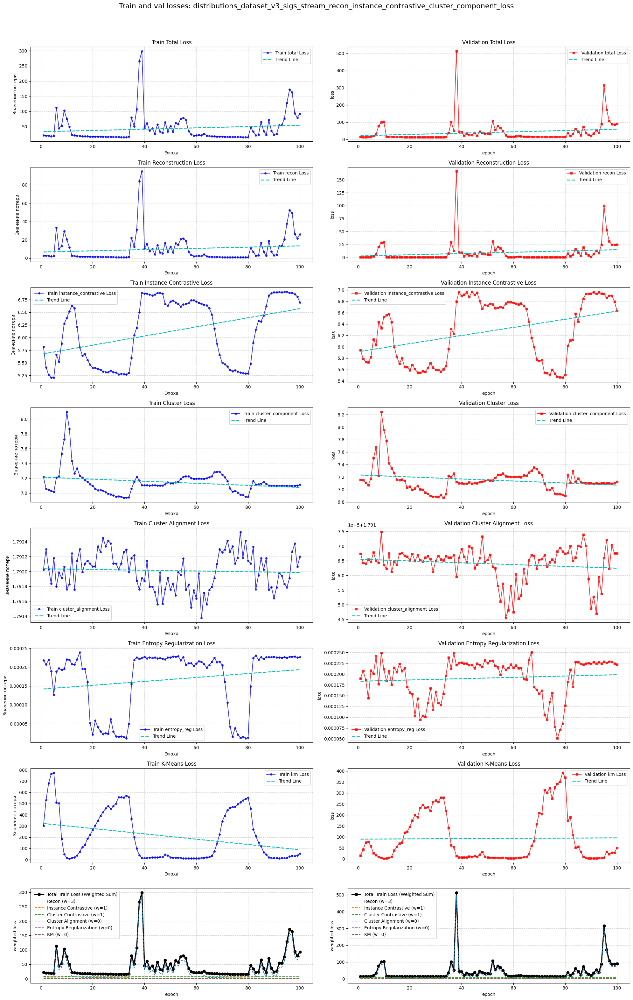

In [33]:
class SigParams(object):
    sig_type = 'sig'
    normalize_timeline = True
    activation = 'tanh'
    seed = 42
    sig_level = 7
    
class Config(object):
    batch_size = 600
    hidden_size = [256, 256, 128]  # Encoder hidden units
    dilations = [1, 1, 1]
    learning_rate = 1e-3
    embedding_size = None
    num_steps = None
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    # standard_scaler = True
    scaler = StandardScaler #StandardScaler #RobustScaler
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_sigs_stream_recon_instance_contrastive_cluster_component_loss'
    weight_recon = 3
    weight_instance_contrastive = 1
    weight_cluster_component = 1
    weight_km = 0
    weight_entropy_reg = 0
    weight_cluster_alignment = 0
    window_size = 32
    stride = 16
    num_epochs = 100
    train_ratio = 6/8
    
config_stage1 = Config()
model1, loss_logs1, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(distributions_dataset, labels, config_stage1.config_name, config_stage1, None, SigParams(), jitter, sigma=0.03)
plot_loss_histories(loss_logs1, config_stage1)

/tmp/ipykernel_31/1396056532.py:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('./NMI_model/distributions_dataset_v3_sigs_stream_recon_in

augmentation...
Signature's type: sig
Signature's shape: (1200, 144, 254)
Signature's shape: (1200, 144, 254)
train_data_orig_final.shape : (1200, 144, 254)
Each fragment is divided into 8 windows.
Each fragment is divided into 8 windows.
Each fragment is divided into 8 windows.
Each fragment is divided into 8 windows.
32
(7200, 32, 254)
(230400, 254)
num_steps=32, embedding_size=254
train_data_orig_final.shape (7200, 32, 254)
Using device: cuda
num_steps=32, embedding_size=254
Dataset: distributions_dataset_v3_sigs_stream_kmeans_loss
Train windows: 7200, Validation windows: 2400
Batch size: 600 (6 classes * 100 samples/class)
Window length (num_steps): 32, Classes: 6

--- Actual composition of the first training batch ---
  - Class 0: 91
  - Class 1: 113
  - Class 2: 96
  - Class 3: 93
  - Class 4: 91
  - Class 5: 116
-----------------------------------------------------


 Epoch 1/50 | Train Loss: 69.4261 | Recon: 0.9503 | Instance Contrastive: 5.2700 | Cluster Contrastive: 6.9328 | 

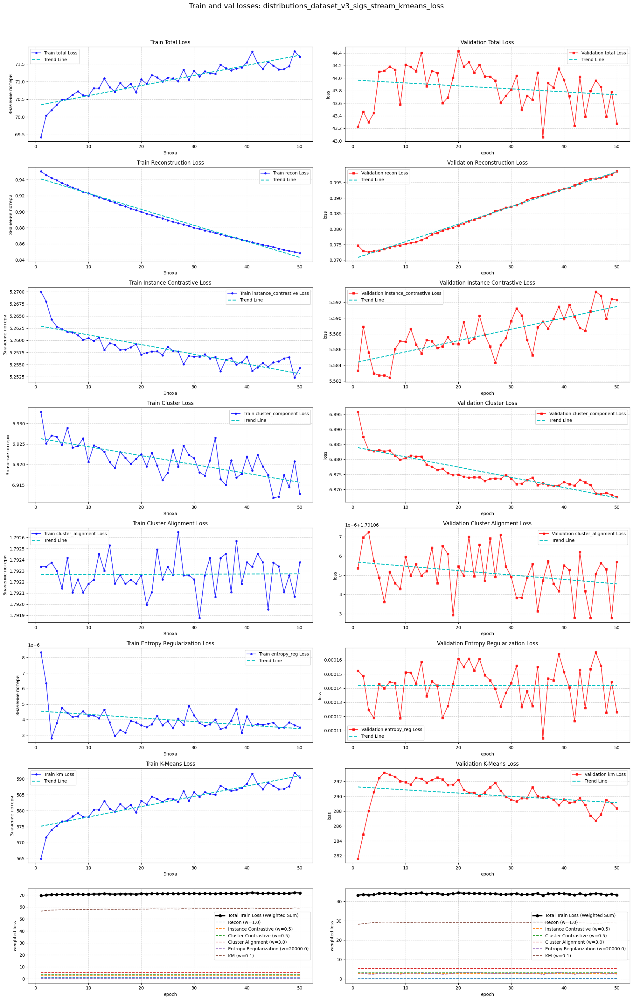

In [35]:
config_stage2 = Config()
config_stage2.config_name = 'distributions_dataset_v3_sigs_stream_kmeans_loss'
config_stage2.learning_rate = 1e-5
config_stage2.num_epochs = 50
config_stage2.weight_recon = 1.0
config_stage2.weight_instance_contrastive = 0.5
config_stage2.weight_cluster_component = 0.5
# config_stage2.weight_km = 0.02 try1
config_stage2.weight_km = 0.1
config_stage2.weight_entropy_reg = 20000.0
config_stage2.weight_cluster_alignment = 3.0
model = model1
model.load_state_dict(torch.load('./NMI_model/distributions_dataset_v3_sigs_stream_recon_instance_contrastive_cluster_component_loss/best_nmi_model.pth'))

model2, loss_logs2, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(distributions_dataset, labels, config_stage2.config_name, config_stage2, model, SigParams(), jitter, sigma=0.03)

plot_loss_histories(loss_logs2, config_stage2)

In [ ]:
# Best NMI: 0.3194 at epoch 3
# Best RI: 0.7774 at epoch 45
# Best ACC: 0.4275 at epoch 1
# Best ARI: 0.2272 at epoch 45
# Best LOSS: 19.8498 at epoch 37

augmentation...
Signature's type: sig
Signature's shape: (1200, 144, 254)
Signature's shape: (1200, 144, 254)
train_data_orig_final.shape : (1200, 144, 254)
Each fragment is divided into 8 windows.
Each fragment is divided into 8 windows.
Each fragment is divided into 8 windows.
Each fragment is divided into 8 windows.
32
(7200, 32, 254)
(230400, 254)
num_steps=32, embedding_size=254
train_data_orig_final.shape (7200, 32, 254)
Using device: cuda
num_steps=32, embedding_size=254
Dataset: distributions_dataset_v3_sigs_stream_recon_instance_contrastive_cluster_component_loss_dim512
Train windows: 7200, Validation windows: 2400
Batch size: 600 (6 classes * 100 samples/class)
Window length (num_steps): 32, Classes: 6

--- Actual composition of the first training batch ---
  - Class 0: 86
  - Class 1: 104
  - Class 2: 94
  - Class 3: 103
  - Class 4: 107
  - Class 5: 106
-----------------------------------------------------


 Epoch 1/100 | Train Loss: 22.1292 | Recon: 2.7792 | Instance Cont

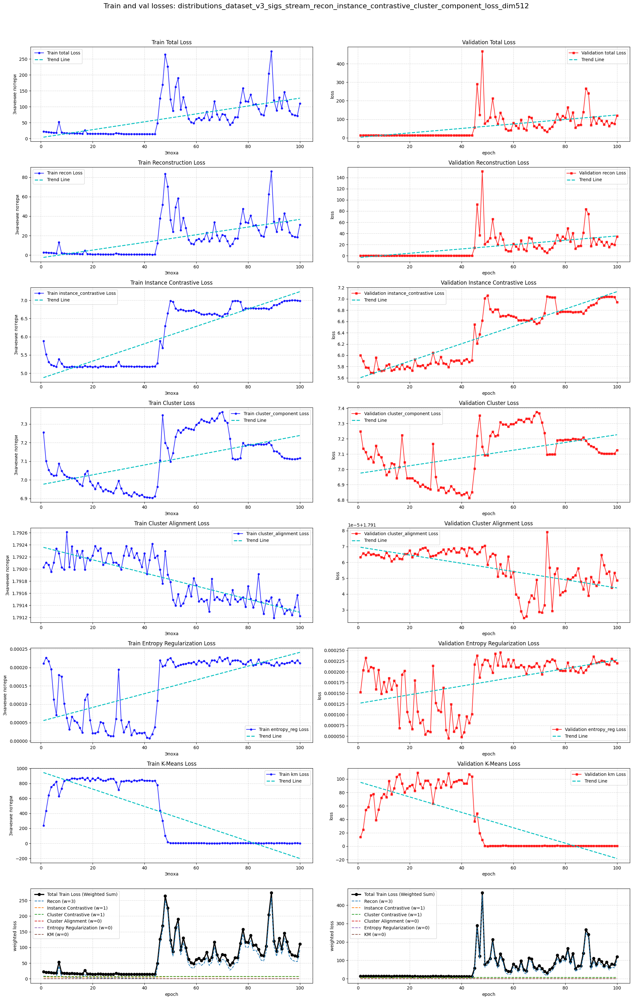

In [36]:
class SigParams(object):
    sig_type = 'sig'
    normalize_timeline = True
    activation = 'tanh'
    seed = 42
    sig_level = 7
    
class Config(object):
    batch_size = 600
    hidden_size = [512, 512, 256]  # Encoder hidden units
    dilations = [1, 1, 1]
    learning_rate = 1e-3
    embedding_size = None
    num_steps = None
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    # standard_scaler = True
    scaler = StandardScaler #StandardScaler #RobustScaler
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_sigs_stream_recon_instance_contrastive_cluster_component_loss_dim512'
    weight_recon = 3
    weight_instance_contrastive = 1
    weight_cluster_component = 1
    weight_km = 0
    weight_entropy_reg = 0
    weight_cluster_alignment = 0
    window_size = 32
    stride = 16
    num_epochs = 100
    train_ratio = 6/8
    
config_stage1 = Config()
model1, loss_logs1, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(distributions_dataset, labels, config_stage1.config_name, config_stage1, None, SigParams(), jitter, sigma=0.03)
plot_loss_histories(loss_logs1, config_stage1)

augmentation...
Signature's type: sig
Signature's shape: (1200, 144, 254)
Signature's shape: (1200, 144, 254)
train_data_orig_final.shape : (1200, 144, 254)
Each fragment is divided into 8 windows.
Each fragment is divided into 8 windows.
Each fragment is divided into 8 windows.
Each fragment is divided into 8 windows.
32
(7200, 32, 254)
(230400, 254)
num_steps=32, embedding_size=254
train_data_orig_final.shape (7200, 32, 254)
Using device: cuda
num_steps=32, embedding_size=254
Dataset: distributions_dataset_normilized_v3_sigs_stream_recon_instance_contrastive_cluster_component_loss
Train windows: 7200, Validation windows: 2400
Batch size: 600 (6 classes * 100 samples/class)
Window length (num_steps): 32, Classes: 6

--- Actual composition of the first training batch ---
  - Class 0: 96
  - Class 1: 108
  - Class 2: 94
  - Class 3: 110
  - Class 4: 101
  - Class 5: 91
-----------------------------------------------------


 Epoch 1/50 | Train Loss: 18.5683 | Recon: 1.9492 | Instance Co

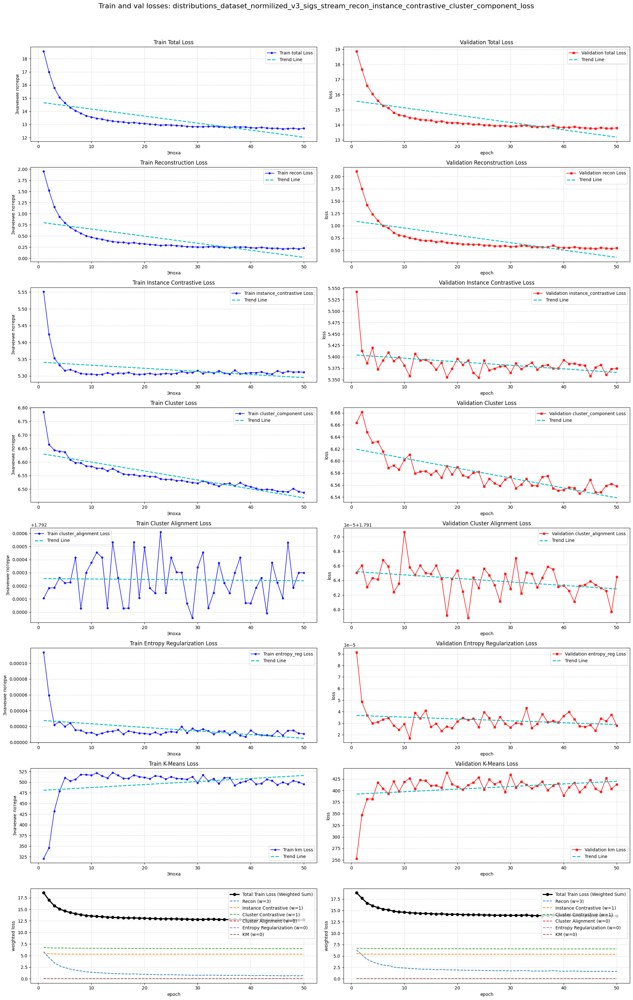

In [38]:
class SigParams(object):
    sig_type = 'sig'
    normalize_timeline = True
    activation = 'tanh'
    seed = 42
    sig_level = 7
    
class Config(object):
    batch_size = 600
    hidden_size = [256, 256, 128]  # Encoder hidden units
    dilations = [1, 1, 1]
    learning_rate = 1e-3
    embedding_size = None
    num_steps = None
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    # standard_scaler = True
    scaler = StandardScaler #StandardScaler #RobustScaler
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_normilized_v3_sigs_stream_recon_instance_contrastive_cluster_component_loss'
    weight_recon = 3
    weight_instance_contrastive = 1
    weight_cluster_component = 1
    weight_km = 0
    weight_entropy_reg = 0
    weight_cluster_alignment = 0
    window_size = 32
    stride = 16
    num_epochs = 50
    train_ratio = 6/8
    
config_stage1 = Config()
model1, loss_logs1, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(np.asarray(distributions_dataset_normilized), labels, config_stage1.config_name, config_stage1, None, SigParams(), jitter, sigma=0.03)
plot_loss_histories(loss_logs1, config_stage1)

/tmp/ipykernel_31/2987264431.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model1.load_state_dict(torch.load('./ACC_model/distributions_dataset_normilized_v3_sigs_stre

Получение эмбеддингов для визуализации...
Извлечено 9600 эмбеддингов размерности 1280.

Снижение размерности с помощью UMAP...
Снижение до 4D UMAP компонент...
Построение графика UMAP (Компоненты 1 и 2)...
График сохранен: ./Figure/distributions_dataset_normilized_v3_sigs_stream_recon_instance_contrastive_cluster_component_loss_emb_c1c2_Components_1_and_2.png


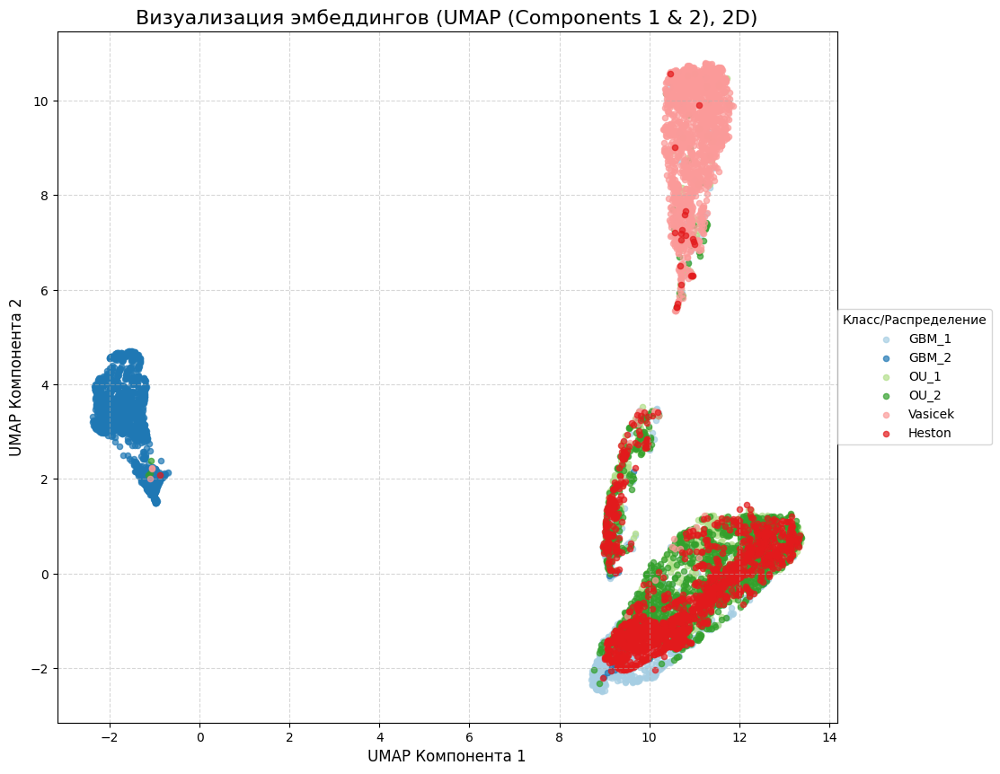

Построение графика UMAP (Компоненты 1 и 3)...
График сохранен: ./Figure/distributions_dataset_normilized_v3_sigs_stream_recon_instance_contrastive_cluster_component_loss_emb_c1c3_Components_1_and_3.png


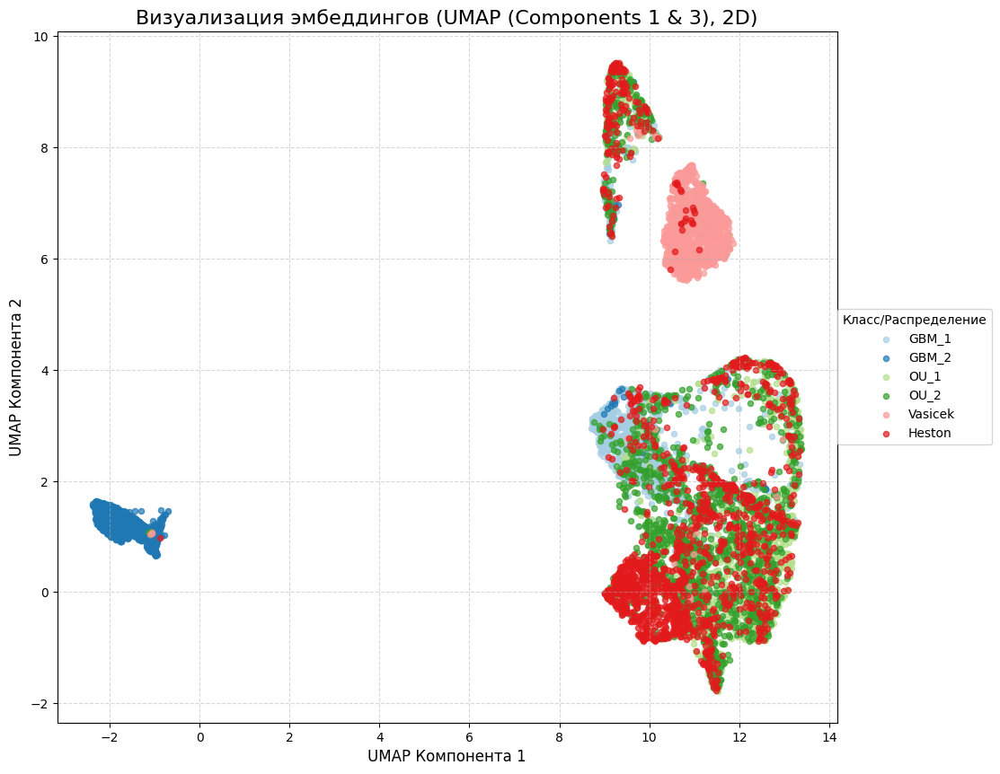

Построение графика UMAP (Компоненты 2 и 4)...
График сохранен: ./Figure/distributions_dataset_normilized_v3_sigs_stream_recon_instance_contrastive_cluster_component_loss_emb_c2c4_Components_2_and_4.png


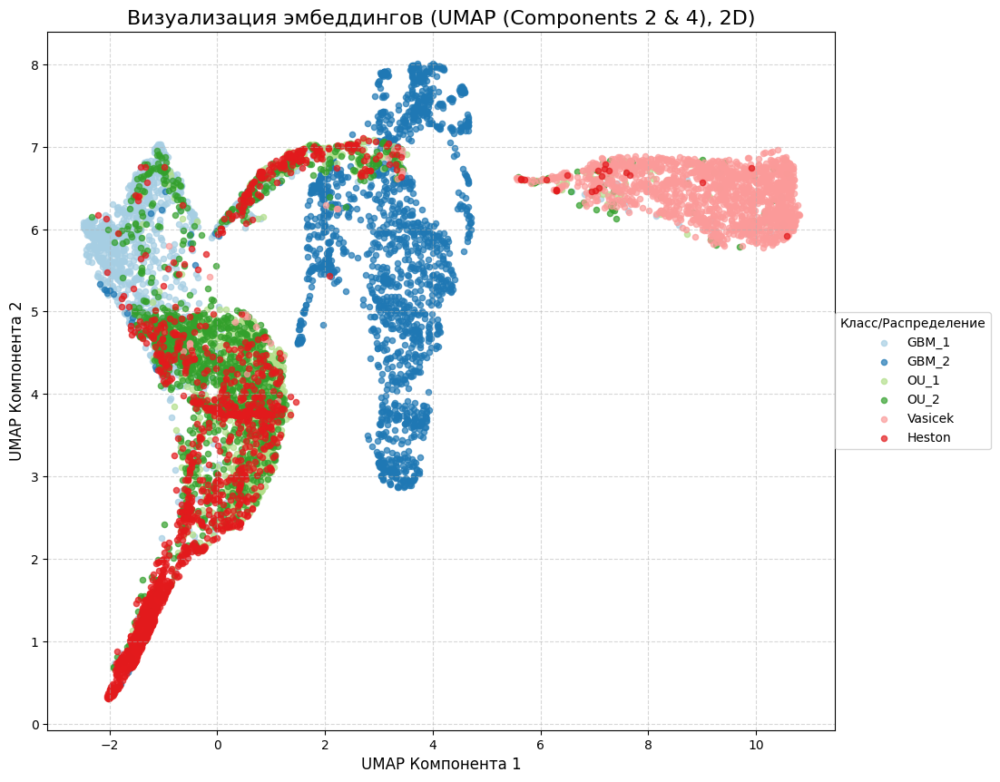

In [47]:
data_np = np.concatenate([train_data_orig_final, test_data_orig_final], axis=0)
label_np = np.concatenate([train_labels_final, test_labels_final], axis=0)
model1.load_state_dict(torch.load('./ACC_model/distributions_dataset_normilized_v3_sigs_stream_recon_instance_contrastive_cluster_component_loss/best_acc_model.pth'))
visualize_embeddings_with_umap(
    model1,
    data_np,
    label_np,
    config_stage1,
    'cuda',
    distribution_names=distribution_names
)

/tmp/ipykernel_31/4156597786.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model1.load_state_dict(torch.load('./NMI_model/distributions_dataset_normilized_v3_sigs_stre

Получение эмбеддингов для визуализации...
Извлечено 9600 эмбеддингов размерности 1280.

Снижение размерности с помощью UMAP...
Снижение до 4D UMAP компонент...
Построение графика UMAP (Компоненты 1 и 2)...
График сохранен: ./Figure/distributions_dataset_normilized_v3_sigs_stream_recon_instance_contrastive_cluster_component_loss_emb_c1c2_Components_1_and_2.png


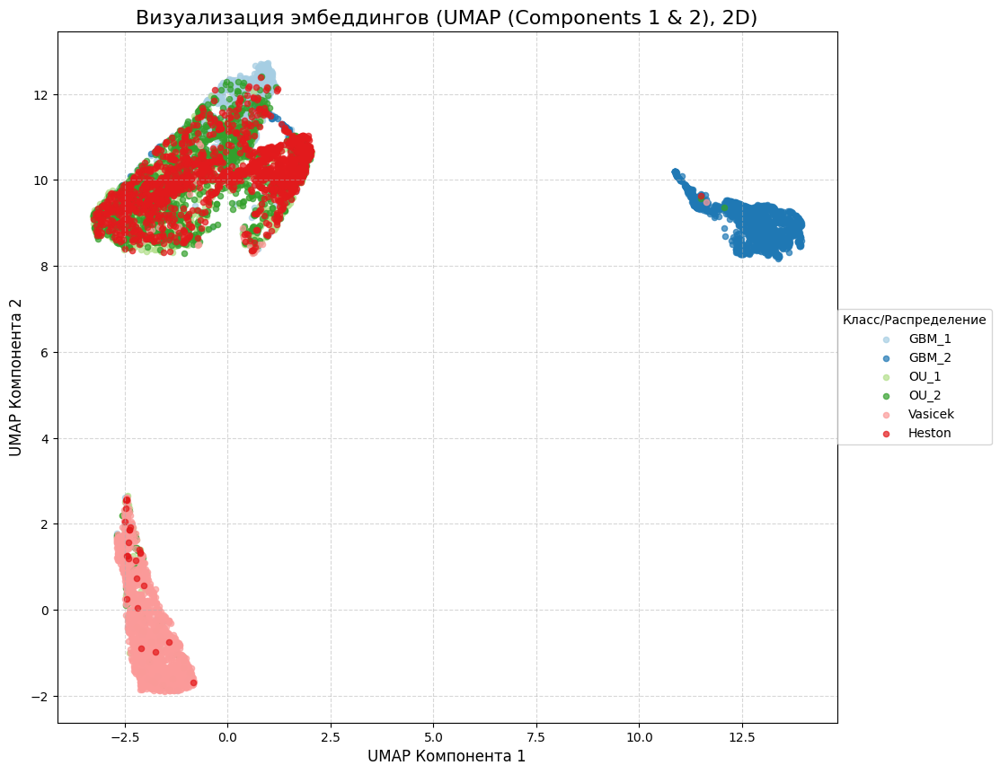

Построение графика UMAP (Компоненты 1 и 3)...
График сохранен: ./Figure/distributions_dataset_normilized_v3_sigs_stream_recon_instance_contrastive_cluster_component_loss_emb_c1c3_Components_1_and_3.png


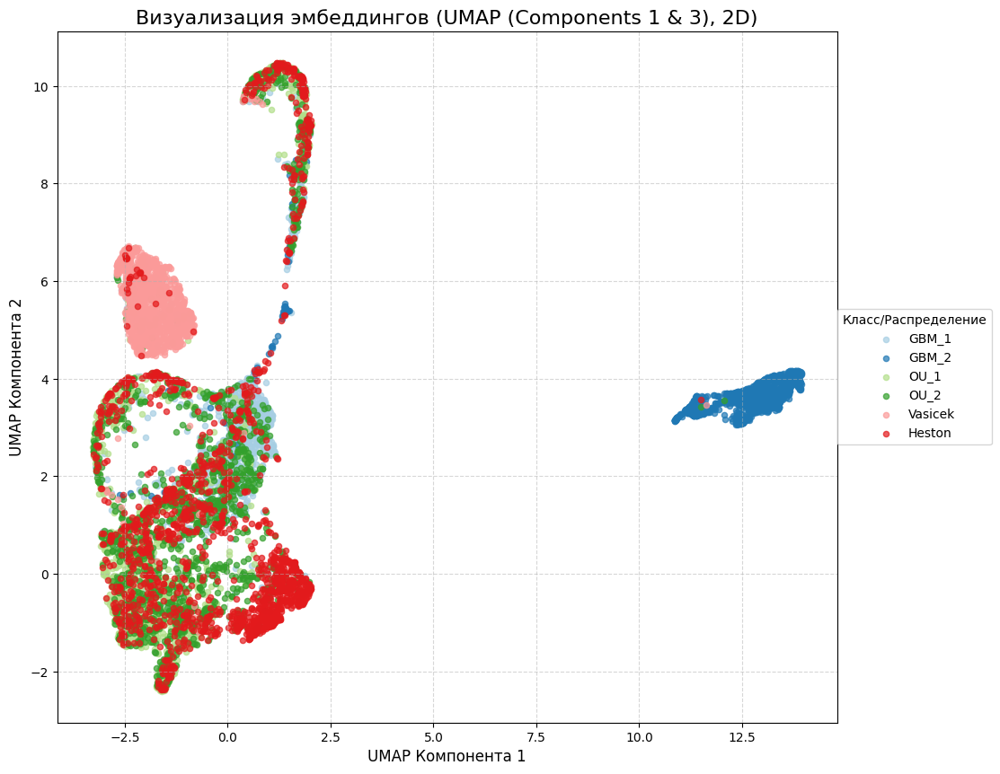

Построение графика UMAP (Компоненты 2 и 4)...
График сохранен: ./Figure/distributions_dataset_normilized_v3_sigs_stream_recon_instance_contrastive_cluster_component_loss_emb_c2c4_Components_2_and_4.png


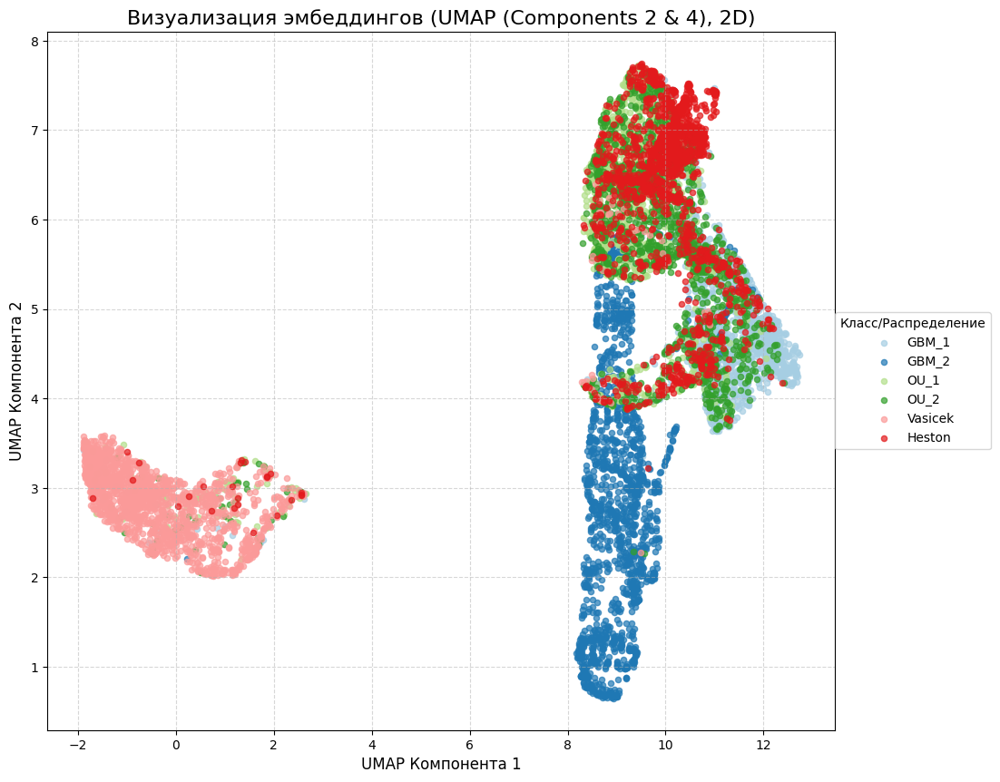

In [43]:
data_np = np.concatenate([train_data_orig_final, test_data_orig_final], axis=0)
label_np = np.concatenate([train_labels_final, test_labels_final], axis=0)
model1.load_state_dict(torch.load('./NMI_model/distributions_dataset_normilized_v3_sigs_stream_recon_instance_contrastive_cluster_component_loss/best_nmi_model.pth'))
visualize_embeddings_with_umap(
    model1,
    data_np,
    label_np,
    config_stage1,
    'cuda',
    distribution_names=distribution_names
)

/tmp/ipykernel_31/3023780881.py:12: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('./NMI_model/distributions_dataset_normilized_v3_sigs_stre

augmentation...
Signature's type: sig
Signature's shape: (1200, 144, 254)
Signature's shape: (1200, 144, 254)
train_data_orig_final.shape : (1200, 144, 254)
Each fragment is divided into 8 windows.
Each fragment is divided into 8 windows.
Each fragment is divided into 8 windows.
Each fragment is divided into 8 windows.
32
(7200, 32, 254)
(230400, 254)
num_steps=32, embedding_size=254
train_data_orig_final.shape (7200, 32, 254)
Using device: cuda
num_steps=32, embedding_size=254
Dataset: distributions_dataset_normilized_v3_sigs_stream_kmeans_loss
Train windows: 7200, Validation windows: 2400
Batch size: 600 (6 classes * 100 samples/class)
Window length (num_steps): 32, Classes: 6

--- Actual composition of the first training batch ---
  - Class 0: 107
  - Class 1: 87
  - Class 2: 92
  - Class 3: 107
  - Class 4: 96
  - Class 5: 111
-----------------------------------------------------


 Epoch 1/50 | Train Loss: 21.9298 | Recon: 0.2501 | Instance Contrastive: 5.3055 | Cluster Contrastiv

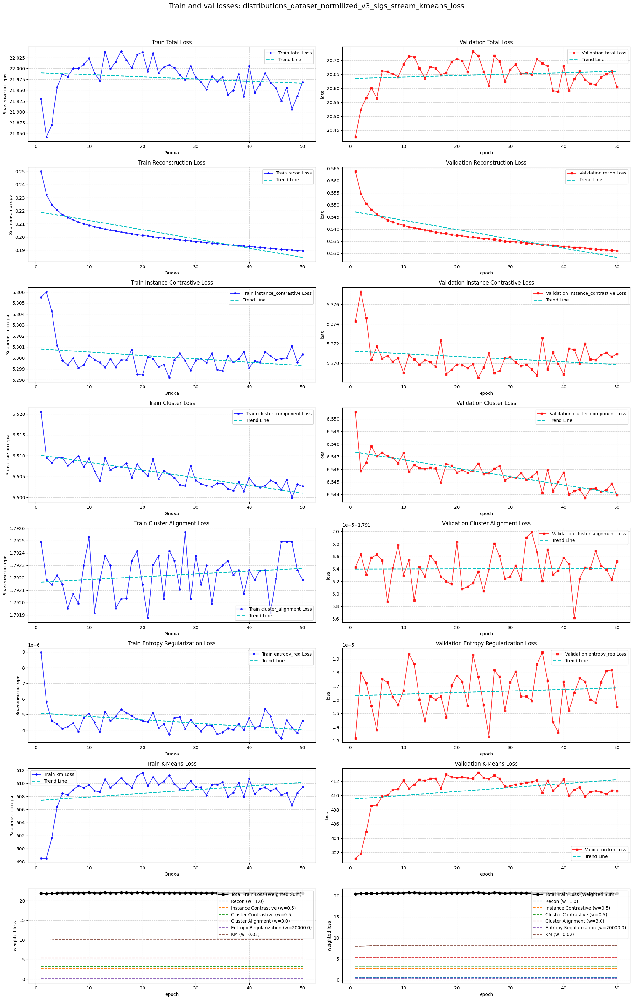

In [50]:
config_stage2 = Config()
config_stage2.config_name = 'distributions_dataset_normilized_v3_sigs_stream_kmeans_loss'
config_stage2.learning_rate = 1e-5
config_stage2.num_epochs = 50
config_stage2.weight_recon = 1.0
config_stage2.weight_instance_contrastive = 0.5
config_stage2.weight_cluster_component = 0.5
config_stage2.weight_km = 0.02
config_stage2.weight_entropy_reg = 20000.0
config_stage2.weight_cluster_alignment = 3.0
model = model1
model.load_state_dict(torch.load('./NMI_model/distributions_dataset_normilized_v3_sigs_stream_recon_instance_contrastive_cluster_component_loss/best_nmi_model.pth'))

model2, loss_logs2, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(np.asarray(distributions_dataset_normilized), labels, config_stage2.config_name, config_stage2, model, SigParams(), jitter, sigma=0.03)

plot_loss_histories(loss_logs2, config_stage2)

/tmp/ipykernel_31/717238792.py:12: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('./NMI_model/distributions_dataset_normilized_v3_sigs_strea

augmentation...
Signature's type: sig
Signature's shape: (1200, 144, 254)
Signature's shape: (1200, 144, 254)
train_data_orig_final.shape : (1200, 144, 254)
Each fragment is divided into 8 windows.
Each fragment is divided into 8 windows.
Each fragment is divided into 8 windows.
Each fragment is divided into 8 windows.
32
(7200, 32, 254)
(230400, 254)
num_steps=32, embedding_size=254
train_data_orig_final.shape (7200, 32, 254)
Using device: cuda
num_steps=32, embedding_size=254
Dataset: distributions_dataset_normilized_v3_sigs_stream_kmeans_loss_try2
Train windows: 7200, Validation windows: 2400
Batch size: 600 (6 classes * 100 samples/class)
Window length (num_steps): 32, Classes: 6

--- Actual composition of the first training batch ---
  - Class 0: 91
  - Class 1: 110
  - Class 2: 109
  - Class 3: 94
  - Class 4: 89
  - Class 5: 107
-----------------------------------------------------


 Epoch 1/50 | Train Loss: 58.0443 | Recon: 0.2609 | Instance Contrastive: 5.3073 | Cluster Contr

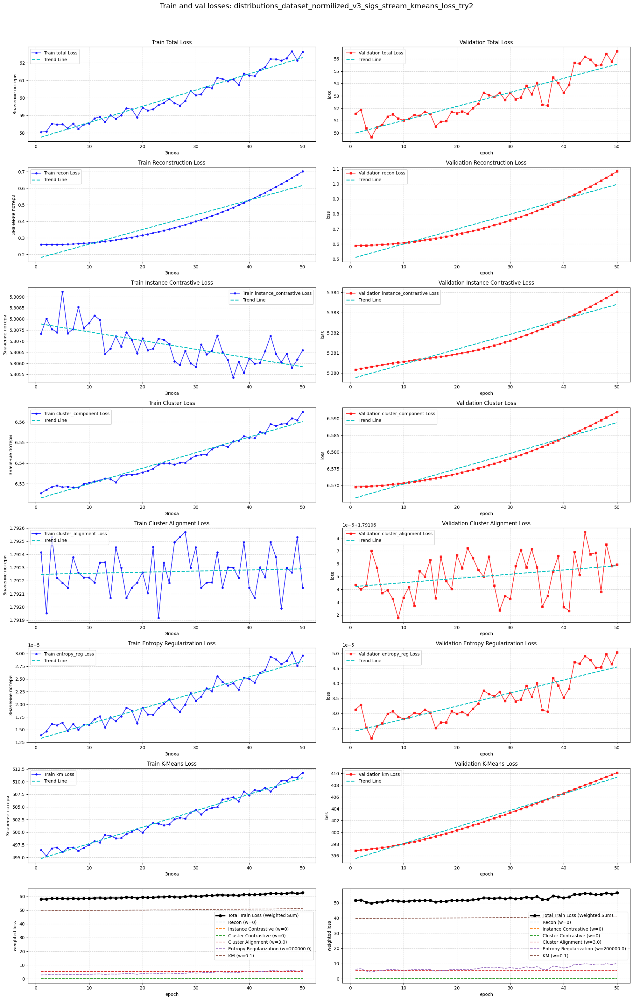

In [53]:
config_stage2 = Config()
config_stage2.config_name = 'distributions_dataset_normilized_v3_sigs_stream_kmeans_loss_try2'
config_stage2.learning_rate = 1e-5
config_stage2.num_epochs = 50
config_stage2.weight_recon = 0
config_stage2.weight_instance_contrastive = 0
config_stage2.weight_cluster_component = 0
config_stage2.weight_km = 0.1
config_stage2.weight_entropy_reg = 2e5
config_stage2.weight_cluster_alignment = 3.0
model = model1
model.load_state_dict(torch.load('./NMI_model/distributions_dataset_normilized_v3_sigs_stream_recon_instance_contrastive_cluster_component_loss/best_nmi_model.pth'))

model2, loss_logs2, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(np.asarray(distributions_dataset_normilized), labels, config_stage2.config_name, config_stage2, model, SigParams(), jitter, sigma=0.03)

plot_loss_histories(loss_logs2, config_stage2)

In [59]:
class SignatureAutoencoder(nn.Module):
    def __init__(self, signature_dim, hidden_dim, latent_dim, dropout=0.2):
        super().__init__()
        
        self.encoder = nn.Sequential(
            nn.Linear(signature_dim, hidden_dim),
            nn.ReLU(),
            nn.Dropout(dropout),
            nn.Linear(hidden_dim, latent_dim)
        )
        
        self.decoder = nn.Sequential(
            nn.Linear(latent_dim, hidden_dim),
            nn.ReLU(),
            nn.Dropout(dropout),
            nn.Linear(hidden_dim, signature_dim)
        )

    def forward(self, x_signature, x_signature_aug, noise):
        latent = self.encoder(x_signature)
        reconstructed_signature = self.decoder(latent)
        return reconstructed_signature, latent

    @torch.no_grad()
    def get_latent_representation(self, x_signature):
        self.eval()
        latent = self.encoder(x_signature)
        return latent


class SignatureAutoencoder(nn.Module):
    def __init__(self, config, input_dim, hidden_layer_sizes, latent_dim, dropout=0.2):
        super().__init__()

        self.config = config

        encoder_layers = []
        current_dim = input_dim

        for hidden_dim in hidden_layer_sizes:
            encoder_layers.append(nn.Linear(current_dim, hidden_dim))
            encoder_layers.append(nn.ReLU())
            encoder_layers.append(nn.Dropout(dropout))
            current_dim = hidden_dim

        encoder_layers.append(nn.Linear(current_dim, latent_dim))
        
        self.encoder = nn.Sequential(*encoder_layers)

        decoder_layers = []
        decoder_layer_sizes = [latent_dim] + hidden_layer_sizes[::-1] + [input_dim]

        for i in range(len(decoder_layer_sizes) - 1):
            in_features = decoder_layer_sizes[i]
            out_features = decoder_layer_sizes[i+1]
            
            decoder_layers.append(nn.Linear(in_features, out_features))
            if i < len(decoder_layer_sizes) - 2:
                decoder_layers.append(nn.ReLU())
                decoder_layers.append(nn.Dropout(dropout))
        
        self.decoder = nn.Sequential(*decoder_layers)

    def forward(self, inputs_orig, inputs_aug, noise_for_inputs):
        if self.config.denoising:
            noisy_inputs_orig = inputs_orig + noise_for_inputs
            noisy_inputs_aug = inputs_aug + noise_for_inputs
        else:
            noisy_inputs_orig = inputs_orig
            noisy_inputs_aug = inputs_aug

        latent_orig = self.encoder(noisy_inputs_orig)
        recon_orig = self.decoder(latent_orig)
        
        latent_aug = self.encoder(noisy_inputs_aug)
        recon_aug = self.decoder(latent_aug)

        target_orig = inputs_orig
        target_aug = inputs_aug
  
        return (latent_orig, latent_aug, 
                recon_orig, recon_aug,
                target_orig, target_aug)

    @torch.no_grad()
    def get_latent_representation(self, x_signature):
        self.eval()
        latent = self.encoder(x_signature)
        return latent
        
class SigParams(object):
    sig_type = 'sig'
    normalize_timeline = True
    activation = 'tanh'
    seed = 42
    sig_level = 7
    
class Config(object):
    batch_size = 600
    hidden_size = [100, 50, 50]  # Encoder hidden units
    dilations = [1, 4, 16]
    num_steps = None # Sequence length
    embedding_size = 254 # Input feature dimension
    learning_rate = 1e-3
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = None # Number of clusters
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    standard_scaler = True
    scaler=StandardScaler
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = 'distributions_dataset_v3_SignatureAutoencoder_recon_instance_contrastive_cluster_component_loss'
    weight_recon = 4
    weight_instance_contrastive = 1
    weight_cluster_component = 1
    weight_km = 0
    weight_entropy_reg = 0
    weight_cluster_alignment = 0
    window_size = 32
    stride = 16
    num_epochs = 100
    train_ratio = 6/8
    
config_stage1 = Config()
config_stage1.train_ratio = 0.8
config_stage1.latent_dim = 128
config_stage1.dropout = 0.2

model = SignatureAutoencoder(
    config=config_stage1,
    input_dim=iisignature.siglength(2, 7),
    hidden_layer_sizes=[256, 256],
    latent_dim=config_stage1.latent_dim,
    dropout=config_stage1.dropout
)
model1, loss_logs1, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = run_pipeline(np.asarray(distributions_dataset_normilized), labels, config_stage1.config_name, config_stage1, model, SigParams(), jitter, sigma=0.03)
plot_loss_histories(loss_logs1, config_stage1)

augmentation...
Signature's type: sig
Signature's shape: (1200, 144, 254)
Signature's shape: (1200, 144, 254)
train_data_orig_final.shape : (1200, 144, 254)
Each fragment is divided into 8 windows.
Each fragment is divided into 8 windows.
Each fragment is divided into 8 windows.
Each fragment is divided into 8 windows.
32
(7680, 32, 254)
(245760, 254)
num_steps=32, embedding_size=254
train_data_orig_final.shape (7680, 32, 254)
Using device: cuda
num_steps=32, embedding_size=254
Dataset: distributions_dataset_v3_SignatureAutoencoder_recon_instance_contrastive_cluster_component_loss
Train windows: 7680, Validation windows: 1920
Batch size: 600 (6 classes * 100 samples/class)
Window length (num_steps): 32, Classes: 6

--- Actual composition of the first training batch ---
  - Class 0: 98
  - Class 1: 95
  - Class 2: 108
  - Class 3: 116
  - Class 4: 95
  - Class 5: 88
-----------------------------------------------------



/tmp/ipykernel_31/1870251053.py:124: UserWarning: The use of `x.T` on tensors of dimension other than 2 to reverse their shape is deprecated and it will throw an error in a future release. Consider `x.mT` to transpose batches of matrices or `x.permute(*torch.arange(x.ndim - 1, -1, -1))` to reverse the dimensions of a tensor. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3683.)
  loss_km_orig = torch.trace(h_orig_detach @ h_orig_detach.T) - \


RuntimeError: The size of tensor a (600) must match the size of tensor b (128) at non-singleton dimension 0

# **NEW DATASETS**

In [20]:
pip install sktime

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [22]:
! curl -L -o ~/Sakharov/ts-classification.zip https://www.kaggle.com/api/v1/datasets/download/danielmiptstudent/ts-classification

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100  481M  100  481M    0     0  26.5M      0  0:00:18  0:00:18 --:--:-- 28.3M


In [21]:
from sktime.datasets import load_from_tsfile_to_dataframe
from sklearn.preprocessing import LabelEncoder

import pandas as pd
import os

def TEST_TS_LENGTH_EQUALITY(X: pd.DataFrame) -> bool:
    lengths = X.map(len)
    all_equal = (lengths == lengths.iloc[0,0]).all().all()
    return all_equal

In [22]:
def sktime_df_to_numpy(X):
    n_samples, n_features = X.shape
    n_timestamps = len(X.iloc[0, 0])

    data = np.zeros((n_samples, n_timestamps, n_features), dtype=np.float32)

    for i in range(n_samples):
        for j in range(n_features):
            data[i, :, j] = X.iat[i, j].values 

    return data

In [23]:
def encode_labels(y_train : pd.Series, y_test : pd.Series):
    le = LabelEncoder()
    le.fit(y_train)

    unknown = set(y_test) - set(le.classes_)
    if unknown:
        raise ValueError(f"Неизвестные классы в y_test: {unknown}")

    y_train_encoded = le.transform(y_train)
    y_test_encoded = le.transform(y_test)
    return np.array(y_train_encoded, dtype=int), np.array(y_test_encoded, dtype=int), le.classes_

In [24]:
pip freeze | grep pandas

pandas==2.2.3
pandas-datareader==0.10.0
pandas-gbq==0.28.0
pandas-profiling==3.2.0
pandas-stubs==2.2.2.240909
pandasql==0.7.3
sklearn-pandas==2.2.0
Note: you may need to restart the kernel to use updated packages.


In [34]:
pip install pandas==2.2.3 pandas-datareader==0.10.0 pandas-gbq==0.28.0 pandas-profiling==3.2.0 pandas-stubs==2.2.2.240909 pandasql==0.7.3 sklearn-pandas==2.2.0

Defaulting to user installation because normal site-packages is not writeable
  Using cached pandas_datareader-0.10.0-py3-none-any.whl.metadata (2.9 kB)
  Using cached pandas_gbq-0.28.0-py2.py3-none-any.whl.metadata (3.3 kB)
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
INFO: pip is looking at multiple versions of scikit-learn to determine which version is compatible with other requirements. This could take a while.
INFO: pip is still looking at multiple versions of scikit-learn to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 23.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.0/6.0 MB 71.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 687.8/687.8 kB 30.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.9/10.9 MB 64.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 65.8 MB/s eta 0:00:0

In [36]:
DATASETS = ['EthanolConcentration', 'FaceDetection', 'Handwriting', 'Heartbeat',  'JapaneseVowels', 'PEMS-SF', 'SelfRegulationSCP1', 'SelfRegulationSCP2', 'SpokenArabicDigits', 'UWaveGestureLibrary']
DATASET_NAME = 'UWaveGestureLibrary'
X_train_df, y_train_df = load_from_tsfile_to_dataframe(os.path.join("./", f'TS_classification/{DATASET_NAME}/{DATASET_NAME}_TRAIN.ts'))
X_test_df, y_test_df = load_from_tsfile_to_dataframe(os.path.join("./", f'TS_classification/{DATASET_NAME}/{DATASET_NAME}_TEST.ts'))
# print(TEST_TS_LENGTH_EQUALITY(X_test_df), TEST_TS_LENGTH_EQUALITY(X_train_df))

X_train_np = sktime_df_to_numpy(X_train_df)
X_test_np = sktime_df_to_numpy(X_test_df)
y_train_np, y_test_np, classes = encode_labels(y_train_df, y_test_df)

In [25]:
import seaborn as sns
import umap

@torch.no_grad()
def get_embeddings_for_visualization(model, input_data_np, device):
    model.eval()

    if input_data_np.ndim != 3:
        if input_data_np.ndim == 2:
            input_data_np = np.expand_dims(input_data_np, axis=-1)
        else:
            return None

    inputs_orig_torch = torch.from_numpy(input_data_np).float().to(device)

    try:
        h_orig = model.get_hidden_representation(inputs_orig_torch)
        
        embeddings_np = h_orig.detach().cpu().numpy()
        print(f"Извлечено {embeddings_np.shape[0]} эмбеддингов размерности {embeddings_np.shape[1]}.")
        return embeddings_np
    except Exception as e:
        print(f"Ошибка при получении эмбеддингов из модели: {e}")
        import traceback
        traceback.print_exc()
        return None
        
class TimeSeriesAugmentedDataset(Dataset):

    def __init__(self, original_data, augmented_data, labels):
        if not isinstance(original_data, torch.Tensor):
            self.original_data = torch.from_numpy(original_data).float()
        else:
            self.original_data = original_data.float()

        if not isinstance(augmented_data, torch.Tensor):
            self.augmented_data = torch.from_numpy(augmented_data).float()
        else:
            self.augmented_data = augmented_data.float()
            
        if not isinstance(labels, torch.Tensor):
            self.labels = torch.from_numpy(labels).long()
        else:
            self.labels = labels.long()

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        return self.original_data[idx], self.augmented_data[idx], self.labels[idx]

def plot_embeddings_2d_umap(embeddings, labels, title_suffix="", distribution_names=None, filename_prefix="umap_viz"):
    """
    Строит 2D scatter plot для эмбеддингов после снижения размерности UMAP.

    Args:
        embeddings (numpy.ndarray): 2D массив эмбеддингов (N_samples, 2).
        labels (numpy.ndarray): Массив меток классов (N_samples,). Метки должны быть целочисленными.
        title_suffix (str): Суффикс для заголовка графика.
        distribution_names (list/dict, optional): Имена классов для легенды.
        filename_prefix (str): Префикс для имени сохраняемого файла.
    """
    unique_labels = np.unique(labels)
    n_classes = len(unique_labels)
    
    if n_classes <= 10:
        palette = sns.color_palette("Paired", n_classes)
    else:
        palette = sns.color_palette("hsv", n_classes)

    plt.figure(figsize=(14, 10))
    ax = plt.subplot(111)

    for i, label_val in enumerate(unique_labels):
        indices = np.where(labels == label_val)[0]
        
        label_name_for_legend = f"Class {label_val}"
        if distribution_names:
            if isinstance(distribution_names, dict):
                label_name_for_legend = distribution_names.get(label_val, f"Class {label_val}")
            elif isinstance(distribution_names, list) and int(label_val) < len(distribution_names):
                 label_name_for_legend = distribution_names[int(label_val)]
        
        ax.scatter(
            embeddings[indices, 0],
            embeddings[indices, 1],
            color=palette[i % len(palette)],
            label=label_name_for_legend,
            alpha=0.7,
            s=20 # Немного увеличим размер точек
        )
    
    plt.title(f"Визуализация эмбеддингов (UMAP {title_suffix}, 2D)", fontsize=16)
    plt.xlabel("UMAP Компонента 1", fontsize=12)
    plt.ylabel("UMAP Компонента 2", fontsize=12)
    
    box = ax.get_position()
    ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])
    ax.legend(title="Класс/Распределение", loc='center left', bbox_to_anchor=(1, 0.5), borderaxespad=0.)
    
    plt.grid(True, linestyle='--', alpha=0.5)
    
    figure_dir = "./Figure/"
    os.makedirs(figure_dir, exist_ok=True)
    filename = os.path.join(figure_dir, f"{filename_prefix}_{title_suffix.replace(' ', '_').replace('(', '').replace(')', '').replace('&', 'and')}.png")
    plt.savefig(filename)
    print(f"График сохранен: {filename}")
    plt.show()
    plt.close()


def visualize_embeddings_with_umap(model, input_data_np, labels_np, config_name, device, distribution_names=None):
    print("Получение эмбеддингов для визуализации...")
    labels_np_int, _ = transfer_labels(labels_np)

    embeddings_np = get_embeddings_for_visualization(model, input_data_np, device)

    if embeddings_np is None or embeddings_np.size == 0:
        print("Не удалось получить эмбеддинги. Визуализация невозможна.")
        return

    print("\nСнижение размерности с помощью UMAP...")
    try:
        n_neighbors = min(15, embeddings_np.shape[0] - 1) # UMAP требует n_neighbors < n_samples
        if n_neighbors < 2:
            print(f"Предупреждение: Слишком мало сэмплов ({embeddings_np.shape[0]}) для UMAP с n_neighbors={15}. Устанавливаю n_neighbors={max(2, embeddings_np.shape[0] - 1)}.")
            n_neighbors = max(2, embeddings_np.shape[0] - 1)
            if embeddings_np.shape[0] <=1:
                 print("Ошибка: Недостаточно данных для UMAP.")
                 return

        min_dist = 0.1
        random_state = 42


        target_n_components_intermediate = min(4, embeddings_np.shape[1]) # Не больше, чем исходная размерность
        if embeddings_np.shape[1] < 2 :
            print(f"Исходная размерность эмбеддингов ({embeddings_np.shape[1]}) слишком мала для снижения до 2D/4D.")
            return

        if target_n_components_intermediate >= 2:
            print(f"Снижение до {target_n_components_intermediate}D UMAP компонент...")
            reducer_umap_intermediate = umap.UMAP(
                n_components=target_n_components_intermediate, 
                random_state=random_state, 
                n_neighbors=n_neighbors, 
                min_dist=min_dist,
                n_jobs=1
            )
            embeddings_umap_intermediate = reducer_umap_intermediate.fit_transform(embeddings_np)

            if target_n_components_intermediate >= 2:
                print("Построение графика UMAP (Компоненты 1 и 2)...")
                plot_embeddings_2d_umap(embeddings_umap_intermediate[:, [0, 1]], labels_np_int, 
                                     title_suffix="(Components 1 & 2)", 
                                     distribution_names=distribution_names,
                                     filename_prefix=f"{config_name}_emb_c1c2")
            
            if target_n_components_intermediate >= 3:
                print("Построение графика UMAP (Компоненты 1 и 3)...")
                plot_embeddings_2d_umap(embeddings_umap_intermediate[:, [0, 2]], labels_np_int, 
                                     title_suffix="(Components 1 & 3)", 
                                     distribution_names=distribution_names,
                                     filename_prefix=f"{config_name}_emb_c1c3")

            if target_n_components_intermediate >= 4:
                print("Построение графика UMAP (Компоненты 2 и 4)...")
                idx_c2 = 1
                idx_c4 = 3 
                if embeddings_umap_intermediate.shape[1] > idx_c4 :
                    plot_embeddings_2d_umap(embeddings_umap_intermediate[:, [idx_c2, idx_c4]], labels_np_int, 
                                        title_suffix="(Components 2 & 4)", 
                                        distribution_names=distribution_names,
                                        filename_prefix=f"{config_name}_emb_c2c4")
                elif embeddings_umap_intermediate.shape[1] > idx_c2+1: # Если есть хотя бы 3 компоненты
                     plot_embeddings_2d_umap(embeddings_umap_intermediate[:, [idx_c2, idx_c2+1]], labels_np_int, 
                                        title_suffix=f"(Components {idx_c2+1} & {idx_c2+1+1})", 
                                        distribution_names=distribution_names,
                                        filename_prefix=f"{config_name}_emb_c{idx_c2+1}c{idx_c2+1+1}")


        elif embeddings_np.shape[1] >= 2:
            print("Снижение до 2D UMAP компонент (исходная размерность мала)...")
            reducer_umap_2d = umap.UMAP(
                n_components=2, 
                random_state=random_state, 
                n_neighbors=n_neighbors, 
                min_dist=min_dist,
                n_jobs=1
            )
            embeddings_umap_2d = reducer_umap_2d.fit_transform(embeddings_np)
            plot_embeddings_2d_umap(embeddings_umap_2d, labels_np_int, 
                                 title_suffix="", 
                                 distribution_names=distribution_names,
                                 filename_prefix=f"{config_name}_emb_2D")
        else:
            print(f"Невозможно снизить размерность до 2D, так как исходная размерность эмбеддингов равна {embeddings_np.shape[1]}.")


    except Exception as e:
        print(f"Ошибка при выполнении UMAP или построении графика: {e}")
        import traceback
        traceback.print_exc()

/usr/local/lib/python3.11/dist-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [26]:
def preprocess_signature_stream(windows_np, sig_level, normalize_timeline=False):
    if windows_np.ndim == 2:
        windows_np = np.expand_dims(windows_np, axis=2)
    
    windows_with_time = AddTimeline(windows_np)
    
    if normalize_timeline:
        for i in range(windows_with_time.shape[0]):
            windows_with_time[i, :, 0] = normalize_arr(windows_with_time[i, :, 0])
    
    full_sigs = full_signature(windows_with_time, sig_level)

    print("Signatures prepared")
    # print(f"Signature's shape: {full_sigs.shape}")
    return full_sigs

def preprocess_log_signature_stream(windows_np, sig_level, normalize_timeline=False):    
    if windows_np.ndim == 2:
        windows_np = np.expand_dims(windows_np, axis=2)
        
    windows_with_time = AddTimeline(windows_np)

    if normalize_timeline:
        for i in range(windows_with_time.shape[0]):
            windows_with_time[i, :, 0] = normalize_arr(windows_with_time[i, :, 0])
    
    full_log_sigs = full_logsignature(windows_with_time, sig_level)

    print("Log-Signatures prepared")
    # print(f"Log-Signature's shape: {full_log_sigs.shape}")
    return full_log_sigs
    
def preprocess_randomized_signature_stream(windows_np, sig_dim_k, normalize_timeline=False, activation='tanh', seed=42):    
    if windows_np.ndim == 2:
        windows_np = np.expand_dims(windows_np, axis=2)
        
    windows_with_time = AddTimeline(windows_np)

    if normalize_timeline:
        for i in range(windows_with_time.shape[0]):
            windows_with_time[i, :, 0] = normalize_arr(windows_with_time[i, :, 0])
    
    full_r_sigs = RandomizedSignatureBatch(windows_with_time, k=sig_dim_k, activation=activation, seed=seed)

    print("Randomized-Signatures prepared")
    # print(f"Rand-Signature's shape: {full_r_sigs.shape}")
    return full_r_sigs

In [27]:
import numpy as np

def create_sliding_windows(time_series_data, labels, window_size, stride):
    """

    Args:
        time_series_data (numpy.ndarray): (N_series, series_length) or (N_series, series_length, N_features).
        labels (numpy.ndarray): (N_series,).
        window_size (int): 
        stride (int): 

    Returns:
        tuple: (
            numpy.ndarray: (N_total_windows, window_size, N_features).
            numpy.ndarray: (N_total_windows,).
        )
    """
    if not isinstance(time_series_data, np.ndarray):
        time_series_data = np.array(time_series_data)
    if not isinstance(labels, np.ndarray):
        labels = np.array(labels)

    if time_series_data.ndim == 2: # (N, T)
        n_series, series_length = time_series_data.shape
        n_features = 1
        time_series_data = np.expand_dims(time_series_data, axis=2)
    elif time_series_data.ndim == 3: # (N, T, C)
        n_series, series_length, n_features = time_series_data.shape
    else:
        raise ValueError(f"time_series_data.shape: {time_series_data.shape}")
    
    n_windows_per_series = (series_length - window_size) // stride + 1

    print(f"Each fragment is divided into {n_windows_per_series} windows.")
    
    total_windows = n_series * n_windows_per_series
    
    windows = np.zeros((total_windows, window_size, n_features), dtype=time_series_data.dtype)
    window_labels = np.zeros(total_windows, dtype=labels.dtype)
    
    current_window_idx = 0
    for i in range(n_series):
        for j in range(n_windows_per_series):
            start = j * stride
            end = start + window_size
            
            windows[current_window_idx] = time_series_data[i, start:end, :]
            window_labels[current_window_idx] = labels[i]
            
            current_window_idx += 1
            
    return windows, window_labels

In [28]:
def plot_loss_histories(loss_logs, config):
    num_epochs = len(loss_logs['train_total'])
    epochs = range(1, num_epochs + 1)

    fig, axes = plt.subplots(8, 2, figsize=(20, 32))
    fig.suptitle(f'Train and val losses: {config.config_name}', fontsize=16)
    
    plot_info = {
        'total': {'title': 'Train Total Loss', 'ax': axes[0, 0]},
        'recon': {'title': 'Train Reconstruction Loss', 'ax': axes[1, 0]},
        'instance_contrastive': {'title': 'Train Instance Contrastive Loss', 'ax': axes[2, 0]},
        'cluster_component': {'title': 'Train Cluster Loss', 'ax': axes[3, 0]},
        'cluster_alignment': {'title': 'Train Cluster Alignment Loss', 'ax': axes[4, 0]},
        'entropy_reg': {'title': 'Train Entropy Regularization Loss', 'ax': axes[5, 0]},
        'km': {'title': 'Train K-Means Loss', 'ax': axes[6, 0]}
    }
    
    for key, info in plot_info.items():
        ax = info['ax']
        ax.plot(epochs, loss_logs[f'train_{key}'], 'b-o', label=f'Train {key} Loss', markersize=4, alpha=0.8)
        m, c = np.polyfit(epochs, loss_logs[f'train_{key}'], 1)
        ax.plot(epochs, m*epochs + c, 'c--', label='Trend Line', linewidth=2)
        ax.set_title(info['title'])
        ax.set_xlabel('Эпоха')
        ax.set_ylabel('Значение потери')
        ax.legend()
        ax.grid(True, linestyle='--', alpha=0.5)
        
    ax6 = axes[7, 0]
    ax6.plot(epochs, loss_logs['train_total'], 'k-o', label='Total Train Loss (Weighted Sum)', linewidth=2.5)
    ax6.plot(epochs, loss_logs['train_weighted_recon'], '--', label=f'Recon (w={config.weight_recon})')
    ax6.plot(epochs, loss_logs['train_weighted_instance_contrastive'], '--', label=f'Instance Contrastive (w={config.weight_instance_contrastive})')
    ax6.plot(epochs, loss_logs['train_weighted_cluster_component'], '--', label=f'Cluster Contrastive (w={config.weight_cluster_component})')
    ax6.plot(epochs, loss_logs['train_weighted_cluster_alignment'], '--', label=f'Cluster Alignment (w={config.weight_cluster_alignment})')
    ax6.plot(epochs, loss_logs['train_weighted_entropy_reg'], '--', label=f'Entropy Regularization (w={config.weight_entropy_reg})')
    ax6.plot(epochs, loss_logs['train_weighted_km'], '--', label=f'KM (w={config.weight_km})')

    ax6.set_xlabel('epoch')
    ax6.set_ylabel('weighted loss')
    ax6.legend()
    ax6.grid(True, linestyle='--', alpha=0.5)
    # ax6.set_yscale('log')

    num_val_epochs = len(loss_logs['val_total'])
    val_epochs = np.arange(1, num_val_epochs + 1) * config.eval_frequency
    plot_info = {
        'total': {'title': 'Validation Total Loss', 'ax': axes[0, 1]},
        'recon': {'title': 'Validation Reconstruction Loss', 'ax': axes[1, 1]},
        'instance_contrastive': {'title': 'Validation Instance Contrastive Loss', 'ax': axes[2, 1]},
        'cluster_component': {'title': 'Validation Cluster Loss', 'ax': axes[3, 1]},
        'cluster_alignment': {'title': 'Validation Cluster Alignment Loss', 'ax': axes[4, 1]},
        'entropy_reg': {'title': 'Validation Entropy Regularization Loss', 'ax': axes[5, 1]},
        'km': {'title': 'Validation K-Means Loss', 'ax': axes[6, 1]}
    }
    
    for key, info in plot_info.items():
        ax = info['ax']
        ax.plot(val_epochs, loss_logs[f'val_{key}'], 'r-s', label=f'Validation {key} Loss', markersize=4, alpha=0.8)
        m, c = np.polyfit(val_epochs, loss_logs[f'val_{key}'], 1)
        ax.plot(val_epochs, m*val_epochs + c, 'c--', label='Trend Line', linewidth=2)
        ax.set_title(info['title'])
        ax.set_xlabel('epoch')
        ax.set_ylabel('loss')
        ax.legend()
        ax.grid(True, linestyle='--', alpha=0.5)
        
    ax6 = axes[7, 1]
    ax6.plot(epochs, loss_logs['val_total'], 'k-o', label='Total Train Loss (Weighted Sum)', linewidth=2.5)
    ax6.plot(epochs, loss_logs['val_weighted_recon'], '--', label=f'Recon (w={config.weight_recon})')
    ax6.plot(epochs, loss_logs['val_weighted_instance_contrastive'], '--', label=f'Instance Contrastive (w={config.weight_instance_contrastive})')
    ax6.plot(epochs, loss_logs['val_weighted_cluster_component'], '--', label=f'Cluster Contrastive (w={config.weight_cluster_component})')
    ax6.plot(epochs, loss_logs['val_weighted_cluster_alignment'], '--', label=f'Cluster Alignment (w={config.weight_cluster_alignment})')
    ax6.plot(epochs, loss_logs['val_weighted_entropy_reg'], '--', label=f'Entropy Regularization (w={config.weight_entropy_reg})')
    ax6.plot(epochs, loss_logs['val_weighted_km'], '--', label=f'KM (w={config.weight_km})')
    
    ax6.set_xlabel('epoch')
    ax6.set_ylabel('weighted loss')
    ax6.legend()
    ax6.grid(True, linestyle='--', alpha=0.5)
    # ax6.set_yscale('log')

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    figure_dir = "./Figure/"
    os.makedirs(figure_dir, exist_ok=True)
    filename = os.path.join(figure_dir, f"loss_dynamics_{config.config_name}.png")
    plt.savefig(filename)
    print(f"plots saved: {filename}")
    plt.show()
    plt.close()

In [29]:
def run_model(
    dataset_name, 
    train_data_orig, 
    train_data_aug, 
    train_labels,
    test_data_orig,
    test_data_aug,
    test_labels,
    model,
    config
):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")

    model.to(device)

    train_dataset = TimeSeriesAugmentedDataset(train_data_orig, train_data_aug, train_labels)
    val_dataset = TimeSeriesAugmentedDataset(test_data_orig, test_data_aug, test_labels)
    
    n_classes = len(np.unique(train_labels))
    batch_size = config.batch_size
    n_samples_per_class = batch_size // n_classes

    # train_sampler = StratifiedBatchSampler(train_labels, n_classes, n_samples_per_class)
    # train_loader = DataLoader(train_dataset, batch_sampler=train_sampler, num_workers=2, pin_memory=True)

    train_loader = DataLoader(train_dataset, batch_size=config.batch_size, shuffle=True, num_workers=2, pin_memory=True)
    val_loader = DataLoader(val_dataset, batch_size=config.test_batch_size, shuffle=True, num_workers=2, pin_memory=True)

    # config.num_steps = train_data_orig.shape[1]
    print(f"num_steps={config.num_steps}, embedding_size={config.embedding_size}")

    num_epochs = config.num_epochs

    train_label_np_transf, num_classes_check = transfer_labels(train_labels)
    config.class_num = num_classes_check

    loss_logs = {
        'train_total': [], 'val_total': [],
        'train_recon': [], 'val_recon': [],
        'train_km': [], 'val_km': [],
        'train_instance_contrastive': [], 'val_instance_contrastive': [],
        'train_cluster_component': [], 'val_cluster_component': [],
        'train_entropy_reg': [], 'val_entropy_reg': [],
        'train_cluster_alignment': [], 'val_cluster_alignment': [],
        
        'train_weighted_recon': [], 'val_weighted_recon': [],
        'train_weighted_km': [], 'val_weighted_km': [],
        'train_weighted_instance_contrastive': [], 'val_weighted_instance_contrastive': [],
        'train_weighted_cluster_component': [], 'val_weighted_cluster_component': [],
        'train_weighted_entropy_reg': [], 'val_weighted_entropy_reg': [],
        'train_weighted_cluster_alignment': [], 'val_weighted_cluster_alignment': [],
    }
    
    print(f'Dataset: {dataset_name}')
    # print(f'Train windows: {len(train_dataset)}, Validation windows: {len(val_dataset)}')
    print(f'Batch size: {config.batch_size} ({n_classes} classes * {n_samples_per_class} samples/class)')
    print(f'Window length (num_steps): {config.num_steps}, Classes: {config.class_num}')

    optimizer = optim.AdamW(model.parameters(), lr=config.learning_rate)

    best_nmi, best_ri, best_acc, best_ari = 0, 0, 0, 0
    best_epoch_nmi, best_epoch_ri, best_epoch_acc, best_epoch_ari = -1, -1, -1, -1
    best_val_loss = float('inf')
    best_epoch_loss = -1
    
    os.makedirs(f'./NMI_model/{dataset_name}/', exist_ok=True)
    os.makedirs(f'./RI_model/{dataset_name}/', exist_ok=True)
    os.makedirs(f'./ACC_model/{dataset_name}/', exist_ok=True)
    os.makedirs(f'./ARI_model/{dataset_name}/', exist_ok=True)
    os.makedirs(f'./BEST_LOSS_model/{dataset_name}/', exist_ok=True)

    for epoch in range(num_epochs):
        model.train()
        epoch_losses = defaultdict(float)
        for i, (batch_orig, batch_aug, batch_labels) in enumerate(train_loader):
            if epoch == 0 and i == 0:
                print("\n--- Actual composition of the first training batch ---")
                unique_labels, counts = np.unique(batch_labels.numpy(), return_counts=True)
                for label, count in zip(unique_labels, counts):
                    print(f"  - Class {label}: {count}")
                print("-----------------------------------------------------\n")
            
            # augmented_data_np = jitter(inputs_orig_torch.squeeze(2).cpu().numpy(), sigma=0.03)
            # inputs_aug_torch = torch.from_numpy(augmented_data_np).float().unsqueeze(-1).to(device)
            # inputs_orig_torch = batch_orig.permute(0, 2, 1).to(device)
            # inputs_aug_torch = batch_aug.permute(0, 2, 1).to(device)
            
            inputs_orig_torch = batch_orig.to(device)
            inputs_aug_torch = batch_aug.to(device)

            noise_np = np.random.normal(loc=0, scale=0.1, size=inputs_orig_torch.shape)
            noise_torch = torch.from_numpy(noise_np).float().to(device)
            optimizer.zero_grad()
            (h_orig, h_aug,
             recon_orig, recon_aug,
             target_orig, target_aug) = model(inputs_orig_torch, inputs_aug_torch, noise_torch)

            h_orig = F.normalize(h_orig, p=2, dim=1)
            h_aug = F.normalize(h_aug, p=2, dim=1)

            # --- Loss Calculation ---
            # 1. Reconstruction Loss
            loss_recon_orig = F.mse_loss(recon_orig, target_orig)
            loss_recon_aug = F.mse_loss(recon_aug, target_aug)
            total_recon_loss = loss_recon_orig + loss_recon_aug
    
            # 2. K-Means style Loss (Spectral Clustering term)
            # Requires F and F_aug matrices, obtained from SVD of h_orig, h_aug
            # Perform SVD
            
            _, _, Vh_orig = torch.linalg.svd(h_orig.detach()) # Vh is (batch, hidden_features) if hidden_features < batch
            
            U_h_orig, S_h_orig, _ = torch.linalg.svd(h_orig.detach())
            F_orig = U_h_orig[:, :config.class_num] # (batch_size, K)
            
            U_h_aug, S_h_aug, _ = torch.linalg.svd(h_aug.detach())
            F_aug = U_h_aug[:, :config.class_num]   # (batch_size, K)
    
            # K-Means Loss calculation
            h_orig_detach = h_orig.detach() # (batch, features)
            h_aug_detach = h_aug.detach()   # (batch, features)
            
            loss_km_orig = torch.trace(h_orig_detach @ h_orig_detach.T) - \
                           torch.trace(F_orig.T @ h_orig_detach @ h_orig_detach.T @ F_orig)
            loss_km_aug = torch.trace(h_aug_detach @ h_aug_detach.T) - \
                          torch.trace(F_aug.T @ h_aug_detach @ h_aug_detach.T @ F_aug)
            total_km_loss = loss_km_orig + loss_km_aug
    
            # 3. Instance-level Contrastive Loss
            loss_instance_contrastive = contrastive_loss_pytorch(
                h_orig, h_aug, 
                config.temperature_contrastive, config.hidden_norm_contrastive
            )
    
            # 4. Cluster-level Contrastive Loss
            # Here, F_orig and F_aug are already derived.
            # The cluster_contrastive_loss_pytorch expects (K, batch_size_dim)
            
            # Entropy Regularization
            F_orig_softmax = F.softmax(F_orig.detach(), dim=1) # (batch, K)
            p_i_orig = F_orig_softmax.sum(dim=0) / (F_orig_softmax.sum() + 1e-9) # Normalize sum over clusters
            ne_i_orig = torch.log(torch.tensor(config.class_num, device=device).float()) + \
                        (p_i_orig * torch.log(p_i_orig + 1e-9)).sum()
    
            F_aug_softmax = F.softmax(F_aug.detach(), dim=1) # (batch, K)
            p_i_aug = F_aug_softmax.sum(dim=0) / (F_aug_softmax.sum() + 1e-9)
            ne_i_aug = torch.log(torch.tensor(config.class_num, device=device).float()) + \
                       (p_i_aug * torch.log(p_i_aug + 1e-9)).sum()
            total_ne_loss = ne_i_orig + ne_i_aug
            
            # The cosine similarity part of cluster_loss uses transposed F.
            # F_orig.T is (K, batch_size)
            # loss_cluster_contrastive = cluster_contrastive_loss_pytorch(
            #     F_orig.detach().T, F_aug.detach().T,
            #     config.temperature_cluster, config.hidden_norm_cluster
            # )
            
            loss_cluster_contrastive = supervised_contrastive_loss(h_orig, h_aug, batch_labels.to(device), config.temperature_cluster)
            
            loss_cluster_alignment = cluster_alignment_loss(F_orig.detach(), F_aug.detach())
            
            weighted_recon_loss = config.weight_recon * total_recon_loss
            weighted_instance_contrastive_loss = config.weight_instance_contrastive * loss_instance_contrastive
            weighted_cluster_loss = config.weight_cluster_component * loss_cluster_contrastive
            weighted_entropy_reg = config.weight_entropy_reg * total_ne_loss
            weighted_cluster_alignment = config.weight_cluster_alignment * loss_cluster_alignment
            weighted_km_loss = config.weight_km * total_km_loss

            total_loss = (weighted_recon_loss + 
                          weighted_instance_contrastive_loss + 
                          weighted_cluster_loss + 
                          weighted_entropy_reg +
                          weighted_cluster_alignment +
                          weighted_km_loss)
            
            l2_reg = torch.tensor(0., device=device)
            for param in model.parameters():
                l2_reg += torch.norm(param, p=2)**2
            total_loss += config.l2_reg_weight * l2_reg

            total_loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0) 
            optimizer.step()

            epoch_losses['train_total'] += total_loss.item()
            epoch_losses['train_recon'] += total_recon_loss.item()
            epoch_losses['train_instance_contrastive'] += loss_instance_contrastive.item()
            epoch_losses['train_cluster_component'] += loss_cluster_contrastive.item()
            epoch_losses['train_km'] += total_km_loss.item()
            epoch_losses['train_entropy_reg'] += total_ne_loss.item()
            epoch_losses['train_cluster_alignment'] += loss_cluster_alignment.item()
            
            epoch_losses['train_weighted_recon'] += weighted_recon_loss.item()
            epoch_losses['train_weighted_km'] += weighted_km_loss.item()
            epoch_losses['train_weighted_instance_contrastive'] += weighted_instance_contrastive_loss.item()
            epoch_losses['train_weighted_cluster_component'] += weighted_cluster_loss.item()
            epoch_losses['train_weighted_entropy_reg'] += weighted_entropy_reg.item()
            epoch_losses['train_weighted_cluster_alignment'] += weighted_cluster_alignment.item()
            
        print(f"\n Epoch {epoch+1}/{num_epochs} | Train Loss: {epoch_losses['train_total'] / len(train_loader):.4f} | "
              f"Recon: {epoch_losses['train_recon'] / len(train_loader):.4f} | Instance Contrastive: {epoch_losses['train_instance_contrastive'] / len(train_loader):.4f} "
              f"| Cluster Contrastive: {epoch_losses['train_cluster_component'] / len(train_loader):.4f} | KM: {epoch_losses['train_km'] / len(train_loader):.4f} | Entropy Regularization : {epoch_losses['train_entropy_reg'] / len(train_loader):.4f} | Cluster Alignment : {epoch_losses['train_cluster_alignment'] / len(train_loader):.4f} \n")

        loss_logs['train_total'].append(epoch_losses['train_total'] / len(train_loader))
        loss_logs['train_recon'].append(epoch_losses['train_recon'] / len(train_loader))
        loss_logs['train_km'].append(epoch_losses['train_km'] / len(train_loader))
        loss_logs['train_instance_contrastive'].append(epoch_losses['train_instance_contrastive'] / len(train_loader))
        loss_logs['train_cluster_component'].append(epoch_losses['train_cluster_component'] / len(train_loader))
        loss_logs['train_entropy_reg'].append(epoch_losses['train_entropy_reg'] / len(train_loader))
        loss_logs['train_cluster_alignment'].append(epoch_losses['train_cluster_alignment'] / len(train_loader))
        
        loss_logs['train_weighted_recon'].append(epoch_losses['train_weighted_recon'] / len(train_loader))
        loss_logs['train_weighted_km'].append(epoch_losses['train_weighted_km'] / len(train_loader))
        loss_logs['train_weighted_instance_contrastive'].append(epoch_losses['train_weighted_instance_contrastive'] / len(train_loader))
        loss_logs['train_weighted_cluster_component'].append(epoch_losses['train_weighted_cluster_component'] / len(train_loader))
        loss_logs['train_weighted_entropy_reg'].append(epoch_losses['train_weighted_entropy_reg'] / len(train_loader))
        loss_logs['train_weighted_cluster_alignment'].append(epoch_losses['train_weighted_cluster_alignment'] / len(train_loader))

        if (epoch + 1) % config.eval_frequency == 0 or epoch == num_epochs - 1:
            model.eval()
            train_metrics_agg = defaultdict(list)
            with torch.no_grad():
                for batch_orig, batch_aug, batch_labels in train_loader:
                    # inputs_orig_torch = batch_orig.permute(0, 2, 1).to(device)
                    inputs_orig_torch = batch_orig.to(device)
                    h_orig = model.get_hidden_representation(inputs_orig_torch)

                    h_orig = F.normalize(h_orig, p=2, dim=1)

                    km_idx = cluster_using_kmeans(h_orig.cpu().numpy(), config.class_num)
                    ri, nmi, ari, acc = evaluation(km_idx, batch_labels.numpy())
                    
                    train_metrics_agg['ri'].append(ri)
                    train_metrics_agg['nmi'].append(nmi)
                    train_metrics_agg['ari'].append(ari)
                    train_metrics_agg['acc'].append(acc)

            print(f"Epoch {epoch+1} Train Metrics (avg over batches): "
                  f"NMI: {np.mean(train_metrics_agg['nmi']):.4f}, "
                  f"RI: {np.mean(train_metrics_agg['ri']):.4f}, "
                  f"ACC: {np.mean(train_metrics_agg['acc']):.4f}, "
                  f"ARI: {np.mean(train_metrics_agg['ari']):.4f}")

            total_val_loss = 0
            all_val_embeddings = []
            all_val_labels = []
            
            total_epoch_recon_loss = 0
            total_epoch_loss_instance_contrastive = 0
            total_epoch_loss_cluster = 0
            total_epoch_entropy_loss = 0
            total_epoch_final_cluster_loss_component = 0
            total_epoch_total_km_loss = 0

            val_epoch_losses = defaultdict(float)
            with torch.no_grad():
                for i, (batch_orig, batch_aug, batch_labels) in enumerate(val_loader):
                    if epoch == 0 and i == 0:
                        print("\n--- Actual composition of the first validation batch ---")
                        unique_labels, counts = np.unique(batch_labels.numpy(), return_counts=True)
                        for label, count in zip(unique_labels, counts):
                            print(f"  - Class {label}: {count}")
                        print("------------------------------------------------------\n")
                    # inputs_orig_torch = batch_orig.permute(0, 2, 1).to(device)
                    # inputs_aug_torch = batch_aug.permute(0, 2, 1).to(device)
                    
                    inputs_orig_torch = batch_orig.to(device)
                    # inputs_aug_torch = batch_aug.to(device)
                    inputs_aug_torch = inputs_orig_torch.clone()
                    noise_torch = torch.zeros_like(inputs_orig_torch)

                    (h_orig, h_aug,
                     recon_orig, recon_aug,
                     target_orig, target_aug) = model(inputs_orig_torch, inputs_aug_torch, noise_torch)

                    h_orig = F.normalize(h_orig, p=2, dim=1)
                    h_aug = F.normalize(h_aug, p=2, dim=1)
                    
                    # --- Loss Calculation ---
                    # 1. Reconstruction Loss
                    loss_recon_orig = F.mse_loss(recon_orig, target_orig)
                    loss_recon_aug = F.mse_loss(recon_aug, target_aug)
                    total_recon_loss = loss_recon_orig + loss_recon_aug
            
                    # 2. K-Means style Loss (Spectral Clustering term)
                    # Requires F and F_aug matrices, obtained from SVD of h_orig, h_aug
                    # Perform SVD
                    
                    _, _, Vh_orig = torch.linalg.svd(h_orig.detach()) # Vh is (batch, hidden_features) if hidden_features < batch
                    
                    U_h_orig, S_h_orig, _ = torch.linalg.svd(h_orig.detach())
                    F_orig = U_h_orig[:, :config.class_num] # (batch_size, K)
                    
                    U_h_aug, S_h_aug, _ = torch.linalg.svd(h_aug.detach())
                    F_aug = U_h_aug[:, :config.class_num]   # (batch_size, K)
            
                    # K-Means Loss calculation
                    h_orig_detach = h_orig.detach() # (batch, features)
                    h_aug_detach = h_aug.detach()   # (batch, features)
                    
                    loss_km_orig = torch.trace(h_orig_detach @ h_orig_detach.T) - \
                                   torch.trace(F_orig.T @ h_orig_detach @ h_orig_detach.T @ F_orig)
                    loss_km_aug = torch.trace(h_aug_detach @ h_aug_detach.T) - \
                                  torch.trace(F_aug.T @ h_aug_detach @ h_aug_detach.T @ F_aug)
                    total_km_loss = loss_km_orig + loss_km_aug
            
                    # 3. Instance-level Contrastive Loss
                    loss_instance_contrastive = contrastive_loss_pytorch(
                        h_orig, h_aug, 
                        config.temperature_contrastive, config.hidden_norm_contrastive
                    )
            
                    # 4. Cluster-level Contrastive Loss
                    # Here, F_orig and F_aug are already derived.
                    # The cluster_contrastive_loss_pytorch expects (K, batch_size_dim)
                    
                    F_orig_softmax = F.softmax(F_orig.detach(), dim=1) # (batch, K)
                    p_i_orig = F_orig_softmax.sum(dim=0) / (F_orig_softmax.sum() + 1e-9) # Normalize sum over clusters
                    ne_i_orig = torch.log(torch.tensor(config.class_num, device=device).float()) + \
                                (p_i_orig * torch.log(p_i_orig + 1e-9)).sum()
            
                    F_aug_softmax = F.softmax(F_aug.detach(), dim=1) # (batch, K)
                    p_i_aug = F_aug_softmax.sum(dim=0) / (F_aug_softmax.sum() + 1e-9)
                    ne_i_aug = torch.log(torch.tensor(config.class_num, device=device).float()) + \
                               (p_i_aug * torch.log(p_i_aug + 1e-9)).sum()
                    total_ne_loss = ne_i_orig + ne_i_aug
                    
                    # The cosine similarity part of cluster_loss uses transposed F.
                    # F_orig.T is (K, batch_size)
                    # loss_cluster_contrastive = cluster_contrastive_loss_pytorch(
                    #     F_orig.detach().T, F_aug.detach().T,
                    #     config.temperature_cluster, config.hidden_norm_cluster
                    # )
                    # loss_cluster_alignment = cluster_alignment_loss(F_orig.detach(), F_aug.detach())

                    loss_cluster_contrastive = supervised_contrastive_loss(h_orig, h_aug, batch_labels.to(device), config.temperature_cluster)
                    
                    loss_cluster_alignment = cluster_alignment_loss(F_orig.detach(), F_aug.detach())
                    
                    weighted_recon_loss = config.weight_recon * total_recon_loss
                    weighted_instance_contrastive_loss = config.weight_instance_contrastive * loss_instance_contrastive
                    weighted_cluster_loss = config.weight_cluster_component * loss_cluster_contrastive
                    weighted_entropy_reg = config.weight_entropy_reg * total_ne_loss
                    weighted_cluster_alignment = config.weight_cluster_alignment * loss_cluster_alignment
                    weighted_km_loss = config.weight_km * total_km_loss

                    total_loss = (weighted_recon_loss + 
                                  weighted_instance_contrastive_loss + 
                                  weighted_cluster_loss + 
                                  weighted_entropy_reg +
                                  weighted_cluster_alignment +
                                  weighted_km_loss)
                    
                    l2_reg = torch.tensor(0., device=device)
                    for param in model.parameters():
                        l2_reg += torch.norm(param, p=2)**2
                    total_loss += config.l2_reg_weight * l2_reg
            
                    all_val_embeddings.append(h_orig.cpu().numpy())
                    all_val_labels.append(batch_labels.numpy())

                    epoch_losses['val_total'] += total_loss.item()
                    epoch_losses['val_recon'] += total_recon_loss.item()
                    epoch_losses['val_instance_contrastive'] += loss_instance_contrastive.item()
                    epoch_losses['val_cluster_component'] += loss_cluster_contrastive.item()
                    epoch_losses['val_km'] += total_km_loss.item()
                    epoch_losses['val_entropy_reg'] += total_ne_loss.item()
                    epoch_losses['val_cluster_alignment'] += loss_cluster_alignment.item()
                    
                    epoch_losses['val_weighted_recon'] += weighted_recon_loss.item()
                    epoch_losses['val_weighted_km'] += weighted_km_loss.item()
                    epoch_losses['val_weighted_instance_contrastive'] += weighted_instance_contrastive_loss.item()
                    epoch_losses['val_weighted_cluster_component'] += weighted_cluster_loss.item()
                    epoch_losses['val_weighted_entropy_reg'] += weighted_entropy_reg.item()
                    epoch_losses['val_weighted_cluster_alignment'] += weighted_cluster_alignment.item()
            
            print(f"\n Epoch {epoch+1}/{num_epochs} | Validation Loss: {epoch_losses['val_total'] / len(val_loader):.4f} | "
                  f"Recon: {epoch_losses['val_recon'] / len(val_loader):.4f} | Instance Contrastive: {epoch_losses['val_instance_contrastive'] / len(val_loader):.4f} "
                  f"| Cluster Contrastive: {epoch_losses['val_cluster_component'] / len(val_loader):.4f} | KM: {epoch_losses['val_km'] / len(val_loader):.4f} | Entropy Regularization : {epoch_losses['val_entropy_reg'] / len(val_loader):.4f} | Cluster Alignment : {epoch_losses['val_cluster_alignment'] / len(val_loader):.4f} \n")
    
            loss_logs['val_total'].append(epoch_losses['val_total'] / len(val_loader))
            loss_logs['val_recon'].append(epoch_losses['val_recon'] / len(val_loader))
            loss_logs['val_km'].append(epoch_losses['val_km'] / len(val_loader))
            loss_logs['val_instance_contrastive'].append(epoch_losses['val_instance_contrastive'] / len(val_loader))
            loss_logs['val_cluster_component'].append(epoch_losses['val_cluster_component'] / len(val_loader))
            loss_logs['val_entropy_reg'].append(epoch_losses['val_entropy_reg'] / len(val_loader))
            loss_logs['val_cluster_alignment'].append(epoch_losses['val_cluster_alignment'] / len(val_loader))
            
            loss_logs['val_weighted_recon'].append(epoch_losses['val_weighted_recon'] / len(val_loader))
            loss_logs['val_weighted_km'].append(epoch_losses['val_weighted_km'] / len(val_loader))
            loss_logs['val_weighted_instance_contrastive'].append(epoch_losses['val_weighted_instance_contrastive'] / len(val_loader))
            loss_logs['val_weighted_cluster_component'].append(epoch_losses['val_weighted_cluster_component'] / len(val_loader))
            loss_logs['val_weighted_entropy_reg'].append(epoch_losses['val_weighted_entropy_reg'] / len(val_loader))
            loss_logs['val_weighted_cluster_alignment'].append(epoch_losses['val_weighted_cluster_alignment'] / len(val_loader))
        
            final_val_embeddings = np.concatenate(all_val_embeddings, axis=0)
            final_val_labels = np.concatenate(all_val_labels, axis=0)

            km_idx = cluster_using_kmeans(final_val_embeddings, config.class_num)
            ri, nmi, ari, acc = evaluation(km_idx, final_val_labels)
            print(f"Epoch {epoch+1} Validation Metrics: NMI: {nmi:.4f}, RI: {ri:.4f}, ACC: {acc:.4f}, ARI: {ari:.4f}")

            if epoch_losses['val_total'] / len(val_loader) < best_val_loss:
                best_val_loss = epoch_losses['val_total'] / len(val_loader)
                best_epoch_loss = epoch + 1
                torch.save(model.state_dict(), f'./BEST_LOSS_model/{dataset_name}/best_val_loss_model.pth')
                print(f"New best validation loss model saved at epoch {epoch + 1}")
            if nmi > best_nmi:
                best_nmi = nmi
                best_epoch_nmi = epoch + 1
                torch.save(model.state_dict(), f'./NMI_model/{dataset_name}/best_nmi_model.pth')
                print(f"New best NMI model saved at epoch {epoch + 1}")
            if ri > best_ri:
                best_ri = ri
                best_epoch_ri = epoch + 1
                torch.save(model.state_dict(), f'./RI_model/{dataset_name}/best_ri_model.pth')
                print(f"New best RI model saved at epoch {epoch + 1}")
            if acc > best_acc:
                best_acc = acc
                best_epoch_acc = epoch + 1
                torch.save(model.state_dict(), f'./ACC_model/{dataset_name}/best_acc_model.pth')
                print(f"New best ACC model saved at epoch {epoch + 1}")
            if ari > best_ari:
                best_ari = ari
                best_epoch_ari = epoch + 1
                torch.save(model.state_dict(), f'./ARI_model/{dataset_name}/best_ari_model.pth')
                print(f"New best ARI model saved at epoch {epoch + 1}")
            model.train()

    print(f"Best NMI: {best_nmi:.4f} at epoch {best_epoch_nmi}")
    print(f"Best RI: {best_ri:.4f} at epoch {best_epoch_ri}")
    print(f"Best ACC: {best_acc:.4f} at epoch {best_epoch_acc}")
    print(f"Best ARI: {best_ari:.4f} at epoch {best_epoch_ari}")
    print(f"Best LOSS: {best_val_loss:.4f} at epoch {best_epoch_loss}")

    class Metrics():
        def __init__(self, best_nmi, best_epoch_nmi, best_ri, best_epoch_ri, best_acc, best_epoch_acc, best_ari, best_epoch_ari, best_loss, best_epoch_loss):
            self.best_nmi = best_nmi
            self.best_epoch_nmi = best_epoch_nmi
            self.best_ri = best_ri
            self.best_epoch_ri = best_epoch_ri
            self.best_acc = best_acc
            self.best_epoch_acc = best_epoch_acc
            self.best_ari = best_ari
            self.best_epoch_ari = best_epoch_ari
            self.best_loss = best_loss
            self.best_epoch_loss = best_epoch_loss
    
    return model, Metrics(best_nmi, best_epoch_nmi, best_ri, best_epoch_ri, best_acc, best_epoch_acc, best_ari, best_epoch_ari, best_val_loss, best_epoch_loss), loss_logs


In [30]:
def make_series_stationary(data_np):
    if data_np.ndim not in [2, 3]:
        raise ValueError("2D (N, T) or 3D (N, T, C)")
    
    # (N, T) -> (N, T-1)
    # (N, T, C) -> (N, T-1, C)
    stationary_data = np.diff(data_np, axis=1)
    
    return stationary_data

In [73]:
def normalize_arr(arr):
    mean = np.mean(arr)
    std = np.std(arr)
    if std < 1e-7:
        return arr - mean
    return (arr - mean) / std

def normalize_series_individually(data_np):
    normalized_data = np.copy(data_np)
    for i in range(normalized_data.shape[0]):
        normalized_data[i, :] = normalize_arr(normalized_data[i, :])
    return normalized_data
    
def run_pipeline(
    dataset_name,
    config,
    X_train_np=None,
    X_test_np=None,
    y_train_np=None,
    y_test_np=None,
    train_data_orig_final=None, 
    train_data_aug_final=None, 
    train_labels_final=None,
    test_data_orig_final=None,
    test_data_aug_final=None,
    test_labels_final=None,
    model=None,
    signature_params=None,      # {'type': 'r-sig', 'k': 200, 'normalize_timeline': False}
    augmentation_func=jitter,
    **aug_params
):
    # if train_data_orig_final is None and train_data_aug_final is None and test_data_orig_final is None and test_data_aug_final is None:
    
    #     if config.normalize_data:
    #         X_train_np = normalize_series_individually(X_train_np)
    #         X_test_np = normalize_series_individually(X_test_np)

    #     if config.make_stationary:
    #         X_train_np = make_series_stationary(X_train_np)
    #         X_test_np = make_series_stationary(X_test_np)
    #         print(f"make_stationary is True")
    
        
    #     print("augmentation...")
    #     # augmentation_func needs (N, T, C), distributions_dataset_orig - (N, T)
    
    #     # data_to_augment = np.expand_dims(distributions_dataset_orig, axis=-1)
    #     # augmented_dataset_orig = augmentation_func(data_to_augment, **aug_params).squeeze(-1)
        
    #     # X_train_np_to_augment = np.expand_dims(X_train_np, axis=-1)
    #     # X_train_np_aug = augmentation_func(X_train_np_to_augment, **aug_params).squeeze(-1)
    #     # X_test_np_to_augment = np.expand_dims(X_test_np, axis=-1)
    #     # X_test_np_aug = augmentation_func(X_test_np_to_augment, **aug_params).squeeze(-1)
    
    #     X_train_np_aug = augmentation_func(X_train_np, **aug_params)
    #     X_test_np_aug = augmentation_func(X_test_np, **aug_params)
    
    #     # print(f"X_train_np_aug.shape: {X_train_np_aug.shape}")
    
    #     if signature_params:
    #         sig_type = signature_params.sig_type
    #         print(f"Signature's type: {sig_type}")
    #         if sig_type == 'rand-sig':
    #             k = signature_params.sig_dim_k
    #             processed_X_train_np_orig = preprocess_randomized_signature_stream(X_train_np, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)
    #             processed_X_train_np_aug = preprocess_randomized_signature_stream(X_train_np_aug, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)
    
    #             processed_X_test_np_orig = preprocess_randomized_signature_stream(X_test_np, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)
    #             processed_X_test_np_aug = preprocess_randomized_signature_stream(X_test_np_aug, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)
           
    #         elif sig_type == 'sig':
    #             processed_X_train_np_orig = preprocess_signature_stream(X_train_np, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
    #             processed_X_train_np_aug = preprocess_signature_stream(X_train_np_aug, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
    
    #             processed_X_test_np_orig = preprocess_signature_stream(X_test_np, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
    #             processed_X_test_np_aug = preprocess_signature_stream(X_test_np_aug, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
    
    #         elif sig_type == 'log-sig':
    #             processed_X_train_np_orig = preprocess_signature_stream(X_train_np, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
    #             processed_X_train_np_aug = preprocess_signature_stream(X_train_np_aug, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
    
    #             processed_X_test_np_orig = preprocess_signature_stream(X_test_np, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
    #             processed_X_test_np_aug = preprocess_signature_stream(X_test_np_aug, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
    
    #             # processed_data_orig = preprocess_signature_stream(distributions_dataset_orig, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
    #             # processed_data_aug = preprocess_signature_stream(augmented_dataset_orig, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
    
    #         else:
    #             raise ValueError(f"Unknown signature_type: {sig_type}")
    
    #         config.embedding_size = processed_X_train_np_orig.shape[2]
    
    #     else:
    #         print("without signatures...")
    #         # processed_data_orig = np.expand_dims(distributions_dataset_orig, axis=-1)
    #         # processed_data_aug = np.expand_dims(augmented_dataset_orig, axis=-1)
    
    #         # config.embedding_size = processed_data_orig.shape[2] if processed_data_orig.ndim == 3 else 1
    
    #         # processed_X_train_np_orig = np.expand_dims(X_train_np, axis=-1)
    #         # processed_X_train_np_aug = np.expand_dims(X_train_np_aug, axis=-1)
    
    #         # processed_X_test_np_orig = np.expand_dims(X_test_np, axis=-1)
    #         # processed_X_test_np_aug = np.expand_dims(X_test_np_aug, axis=-1)
    
    #         processed_X_train_np_orig = X_train_np
    #         processed_X_train_np_aug = X_train_np_aug
    #         processed_X_test_np_orig = X_test_np
    #         processed_X_test_np_aug = X_test_np_aug
    
    #         config.embedding_size = processed_X_train_np_orig.shape[2] if processed_X_train_np_orig.ndim == 3 else 1
    
    #     # train_full = np.concatenate((processed_X_train_np_orig, processed_X_train_np_aug), axis=2)
    #     # test_full = np.concatenate((processed_X_test_np_orig, processed_X_test_np_aug), axis=2)
    
    #     # train_full, test_full, train_labels, test_labels = train_test_split(
    #     #     combined_processed_data, labels_orig, stratify=labels_orig, 
    #     #     train_size=config.train_ratio, random_state=42
    #     # )
    
    #     # train_processed_orig = train_full[:, :, :config.embedding_size]
    #     # train_processed_aug = train_full[:, :, config.embedding_size:]
        
    #     # test_processed_orig = test_full[:, :, :config.embedding_size]
    #     # test_processed_aug = test_full[:, :, config.embedding_size:]
    
    #     # print(f"train_full.shape: {train_full.shape}")
    #     # train_windows_orig, train_window_labels = create_sliding_windows(train_processed_orig, y_train_np, config.window_size, config.stride)
    #     # train_windows_aug, _ = create_sliding_windows(train_processed_aug, y_train_np, config.window_size, config.stride)
        
    #     # test_windows_orig, test_window_labels = create_sliding_windows(test_processed_orig, y_test_np, config.window_size, config.stride)
    #     # test_windows_aug, _ = create_sliding_windows(test_processed_aug, y_test_np, config.window_size, config.stride)
    
    #     print(f"processed_X_test_np_orig.shape : {processed_X_test_np_orig.shape}")
    #     train_windows_orig, train_window_labels = create_sliding_windows(processed_X_train_np_orig, y_train_np, config.window_size, config.stride)
    #     # print(f"np.unique : {np.unique(train_window_labels, return_counts=True)}")
    #     train_windows_aug, train_window_labels_aug = create_sliding_windows(processed_X_train_np_aug, y_train_np, config.window_size, config.stride)
    #     # print(f"np.unique : {np.unique(train_window_labels_aug, return_counts=True)}")
    
    #     test_windows_orig, test_window_labels = create_sliding_windows(processed_X_test_np_orig, y_test_np, config.window_size, config.stride)
    #     # print(f"np.unique : {np.unique(test_window_labels, return_counts=True)}")
    
    #     test_windows_aug, test_window_labels_aug = create_sliding_windows(processed_X_test_np_aug, y_test_np, config.window_size, config.stride)
    #     # print(f"np.unique : {np.unique(test_window_labels_aug, return_counts=True)}")
    
    
    
    #     config.num_steps = train_windows_orig.shape[1] 
    #     print(f"config.num_steps :{config.num_steps}")
    
    #     if config.scaler is not None:
    #         scaler = config.scaler()
    #         # reshape(N_win*T_win, C)
    #         # print(train_windows_orig.shape)
    #         train_orig_reshaped = train_windows_orig.reshape(-1, config.embedding_size)
    #         # print(train_orig_reshaped.shape)
    #         train_aug_reshaped = train_windows_aug.reshape(-1, config.embedding_size)
            
    #         test_orig_reshaped = test_windows_orig.reshape(-1, config.embedding_size)
    #         test_aug_reshaped = test_windows_aug.reshape(-1, config.embedding_size)
    
    #         scaler.fit(np.concatenate((train_orig_reshaped, train_aug_reshaped), axis=0))
            
    #         train_data_orig_final = scaler.transform(train_orig_reshaped).reshape(train_windows_orig.shape)
    #         train_data_aug_final = scaler.transform(train_aug_reshaped).reshape(train_windows_aug.shape)
    #         test_data_orig_final = scaler.transform(test_orig_reshaped).reshape(test_windows_orig.shape)
    #         test_data_aug_final = scaler.transform(test_aug_reshaped).reshape(test_windows_aug.shape)
    
    #     else:
    #         train_data_orig_final, train_data_aug_final = train_windows_orig, train_windows_aug
    #         test_data_orig_final, test_data_aug_final = test_windows_orig, test_windows_aug
    
    #     train_labels_final, test_labels_final = train_window_labels, test_window_labels

    if train_data_orig_final is None and train_data_aug_final is None and test_data_orig_final is None and test_data_aug_final is None:
        train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final = get_prepared_data(
            config,
            X_train_np,
            X_test_np,
            y_train_np,
            y_test_np,
            signature_params,      # {'type': 'r-sig', 'k': 200, 'normalize_timeline': False}
            augmentation_func,
            **aug_params
        )
        
    
    config.num_steps = train_data_orig_final.shape[1]
    
    if config.embedding_size is None:
        config.embedding_size = train_data_orig_final.shape[2]
    
    print(f"num_steps={config.num_steps}, embedding_size={config.embedding_size}")
    print(f"test_data_orig_final.shape: {test_data_orig_final.shape}")
        

    if model is None:
        model = RNNClusteringModel(config)
    model, metrics, loss_logs = run_model(
        dataset_name, 
        train_data_orig_final, 
        train_data_aug_final, 
        train_labels_final,
        test_data_orig_final,
        test_data_aug_final,
        test_labels_final,
        model,
        config
    )
    
    log_dir = 'Logs'
    os.makedirs(log_dir, exist_ok=True)
    log_file = os.path.join(log_dir, f'{dataset_name}_log.txt')
    with open(log_file, 'a') as f:
        f.write(f'Dataset: {dataset_name}\n')
        f.write(f'PyTorch Model Config:\n'
                f'Encoder Hidden: {config.hidden_size}, weight_recon, weight_instance_contrastive , weight_cluster_component , weight_km : {config.weight_recon, config.weight_instance_contrastive , config.weight_cluster_component , config.weight_km}, Batch Size: {config.batch_size}\n'
                f'Learning Rate: {config.learning_rate}, Dilations: {config.dilations}\n')
        f.write(f'Best NMI = {metrics.best_nmi:.4f} at epoch {metrics.best_epoch_nmi}\n'
                f'Best RI  = {metrics.best_ri:.4f} at epoch {metrics.best_epoch_ri}\n\n')
        f.write(f'Best ACC = {metrics.best_acc:.4f} at epoch {metrics.best_epoch_acc}\n'
                f'Best ARI  = {metrics.best_ari:.4f} at epoch {metrics.best_epoch_ari}\n\n')
        f.write(f'Best loss = {metrics.best_loss:.4f} at epoch {metrics.best_epoch_loss}\n\n')
    print(f"Logging complete to {log_file}")

    return model, loss_logs, train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final

In [72]:
def get_prepared_data(
    config,
    X_train_np,
    X_test_np,
    y_train_np,
    y_test_np,
    signature_params=None,      # {'type': 'r-sig', 'k': 200, 'normalize_timeline': False}
    augmentation_func=jitter,
    **aug_params
):

    if config.normalize_data:
        X_train_np = normalize_series_individually(X_train_np)
        X_test_np = normalize_series_individually(X_test_np)

    if config.make_stationary:
        X_train_np = make_series_stationary(X_train_np)
        X_test_np = make_series_stationary(X_test_np)
        print(f"make_stationary is True")
    
    print("augmentation...")
    # augmentation_func needs (N, T, C), distributions_dataset_orig - (N, T)

    # data_to_augment = np.expand_dims(distributions_dataset_orig, axis=-1)
    # augmented_dataset_orig = augmentation_func(data_to_augment, **aug_params).squeeze(-1)
    
    # X_train_np_to_augment = np.expand_dims(X_train_np, axis=-1)
    # X_train_np_aug = augmentation_func(X_train_np_to_augment, **aug_params).squeeze(-1)
    # X_test_np_to_augment = np.expand_dims(X_test_np, axis=-1)
    # X_test_np_aug = augmentation_func(X_test_np_to_augment, **aug_params).squeeze(-1)

    X_train_np_aug = augmentation_func(X_train_np, **aug_params)
    X_test_np_aug = augmentation_func(X_test_np, **aug_params)

    # print(f"X_train_np_aug.shape: {X_train_np_aug.shape}")

    if signature_params:
        sig_type = signature_params.sig_type
        print(f"Signature's type: {sig_type}")
        if sig_type == 'rand-sig':
            k = signature_params.sig_dim_k
            processed_X_train_np_orig = preprocess_randomized_signature_stream(X_train_np, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)
            processed_X_train_np_aug = preprocess_randomized_signature_stream(X_train_np_aug, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)

            processed_X_test_np_orig = preprocess_randomized_signature_stream(X_test_np, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)
            processed_X_test_np_aug = preprocess_randomized_signature_stream(X_test_np_aug, k, signature_params.normalize_timeline, signature_params.activation, signature_params.seed)
       
        elif sig_type == 'sig':
            processed_X_train_np_orig = preprocess_signature_stream(X_train_np, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            processed_X_train_np_aug = preprocess_signature_stream(X_train_np_aug, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)

            processed_X_test_np_orig = preprocess_signature_stream(X_test_np, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            processed_X_test_np_aug = preprocess_signature_stream(X_test_np_aug, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)

        elif sig_type == 'log-sig':
            processed_X_train_np_orig = preprocess_signature_stream(X_train_np, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            processed_X_train_np_aug = preprocess_signature_stream(X_train_np_aug, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)

            processed_X_test_np_orig = preprocess_signature_stream(X_test_np, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            processed_X_test_np_aug = preprocess_signature_stream(X_test_np_aug, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)

            # processed_data_orig = preprocess_signature_stream(distributions_dataset_orig, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)
            # processed_data_aug = preprocess_signature_stream(augmented_dataset_orig, signature_params.sig_level, normalize_timeline=signature_params.normalize_timeline)

        else:
            raise ValueError(f"Unknown signature_type: {sig_type}")

        config.embedding_size = processed_X_train_np_orig.shape[2]

    else:
        print("without signatures...")
        # processed_data_orig = np.expand_dims(distributions_dataset_orig, axis=-1)
        # processed_data_aug = np.expand_dims(augmented_dataset_orig, axis=-1)

        # config.embedding_size = processed_data_orig.shape[2] if processed_data_orig.ndim == 3 else 1

        # processed_X_train_np_orig = np.expand_dims(X_train_np, axis=-1)
        # processed_X_train_np_aug = np.expand_dims(X_train_np_aug, axis=-1)

        # processed_X_test_np_orig = np.expand_dims(X_test_np, axis=-1)
        # processed_X_test_np_aug = np.expand_dims(X_test_np_aug, axis=-1)

        processed_X_train_np_orig = X_train_np
        processed_X_train_np_aug = X_train_np_aug
        processed_X_test_np_orig = X_test_np
        processed_X_test_np_aug = X_test_np_aug

        config.embedding_size = processed_X_train_np_orig.shape[2] if processed_X_train_np_orig.ndim == 3 else 1

    # train_full = np.concatenate((processed_X_train_np_orig, processed_X_train_np_aug), axis=2)
    # test_full = np.concatenate((processed_X_test_np_orig, processed_X_test_np_aug), axis=2)

    # train_full, test_full, train_labels, test_labels = train_test_split(
    #     combined_processed_data, labels_orig, stratify=labels_orig, 
    #     train_size=config.train_ratio, random_state=42
    # )

    # train_processed_orig = train_full[:, :, :config.embedding_size]
    # train_processed_aug = train_full[:, :, config.embedding_size:]
    
    # test_processed_orig = test_full[:, :, :config.embedding_size]
    # test_processed_aug = test_full[:, :, config.embedding_size:]

    # print(f"train_full.shape: {train_full.shape}")
    # train_windows_orig, train_window_labels = create_sliding_windows(train_processed_orig, y_train_np, config.window_size, config.stride)
    # train_windows_aug, _ = create_sliding_windows(train_processed_aug, y_train_np, config.window_size, config.stride)
    
    # test_windows_orig, test_window_labels = create_sliding_windows(test_processed_orig, y_test_np, config.window_size, config.stride)
    # test_windows_aug, _ = create_sliding_windows(test_processed_aug, y_test_np, config.window_size, config.stride)

    print(f"processed_X_test_np_orig.shape : {processed_X_test_np_orig.shape}")
    train_windows_orig, train_window_labels = create_sliding_windows(processed_X_train_np_orig, y_train_np, config.window_size, config.stride)
    # print(f"np.unique : {np.unique(train_window_labels, return_counts=True)}")
    train_windows_aug, train_window_labels_aug = create_sliding_windows(processed_X_train_np_aug, y_train_np, config.window_size, config.stride)
    # print(f"np.unique : {np.unique(train_window_labels_aug, return_counts=True)}")

    test_windows_orig, test_window_labels = create_sliding_windows(processed_X_test_np_orig, y_test_np, config.window_size, config.stride)
    # print(f"np.unique : {np.unique(test_window_labels, return_counts=True)}")

    test_windows_aug, test_window_labels_aug = create_sliding_windows(processed_X_test_np_aug, y_test_np, config.window_size, config.stride)
    # print(f"np.unique : {np.unique(test_window_labels_aug, return_counts=True)}")

    config.num_steps = train_windows_orig.shape[1] 
    print(f"config.num_steps :{config.num_steps}")

    if config.scaler is not None:
        scaler = config.scaler()
        # reshape(N_win*T_win, C)
        # print(train_windows_orig.shape)
        train_orig_reshaped = train_windows_orig.reshape(-1, config.embedding_size)
        # print(train_orig_reshaped.shape)
        train_aug_reshaped = train_windows_aug.reshape(-1, config.embedding_size)
        
        test_orig_reshaped = test_windows_orig.reshape(-1, config.embedding_size)
        test_aug_reshaped = test_windows_aug.reshape(-1, config.embedding_size)

        scaler.fit(np.concatenate((train_orig_reshaped, train_aug_reshaped), axis=0))
        
        train_data_orig_final = scaler.transform(train_orig_reshaped).reshape(train_windows_orig.shape)
        train_data_aug_final = scaler.transform(train_aug_reshaped).reshape(train_windows_aug.shape)
        test_data_orig_final = scaler.transform(test_orig_reshaped).reshape(test_windows_orig.shape)
        test_data_aug_final = scaler.transform(test_aug_reshaped).reshape(test_windows_aug.shape)

    else:
        train_data_orig_final, train_data_aug_final = train_windows_orig, train_windows_aug
        test_data_orig_final, test_data_aug_final = test_windows_orig, test_windows_aug

    train_labels_final, test_labels_final = train_window_labels, test_window_labels

    return train_data_orig_final, train_data_aug_final, test_data_orig_final, test_data_aug_final, train_labels_final, test_labels_final

In [32]:
def evaluate_clustering_with_bootstrap(
    model, 
    X_test_np, 
    y_test_np, 
    class_num, 
    n_bootstrap=100
):
    model.eval()
    accuracies = []
    device = next(model.parameters()).device
    

    full_test_embeddings = get_embeddings_for_visualization(model, X_test_np, device)
    
    km_preds = cluster_using_kmeans(full_test_embeddings, class_num)
    acc_on_original_test = cluster_acc(y_test_np, km_preds)
    
    print(f"Запуск {n_bootstrap} итераций бутстрапа...")
    N = len(X_test_np)
    
    for i in range(n_bootstrap):
        indices = np.random.choice(N, N, replace=True)

        X_sample_embeddings = full_test_embeddings[indices]
        y_sample = y_test_np[indices]
        
        km_preds_sample = cluster_using_kmeans(X_sample_embeddings, class_num)
        
        acc = cluster_acc(y_sample, km_preds_sample)
        accuracies.append(acc)

    mean_acc = np.mean(accuracies)
    var_acc = np.var(accuracies, ddof=1)

    return round(mean_acc * 100, 2), round(var_acc * 100, 2), round(acc_on_original_test * 100, 2)


In [33]:
iisignature.siglength(4, 6)

5460

In [33]:
DATASETS = ['EthanolConcentration', 'FaceDetection', 'Handwriting', 'Heartbeat',  'JapaneseVowels', 'PEMS-SF', 'SelfRegulationSCP1', 'SelfRegulationSCP2', 'SpokenArabicDigits', 'UWaveGestureLibrary']
DATASETS_TO_RUN  = ['UWaveGestureLibrary']

results_summary = {}

for dataset_name in DATASETS_TO_RUN:
    print(f"{dataset_name.upper()}")    
    try:
        X_train_df, y_train_df = load_from_tsfile_to_dataframe(os.path.join("../input/ts-classification/", f'TS_classification/{dataset_name}/{dataset_name}_TRAIN.ts'))
        X_test_df, y_test_df = load_from_tsfile_to_dataframe(os.path.join("../input/ts-classification/", f'TS_classification/{dataset_name}/{dataset_name}_TEST.ts'))
        
        if not (TEST_TS_LENGTH_EQUALITY(X_train_df) and TEST_TS_LENGTH_EQUALITY(X_test_df)):
            print(f"Skipped {dataset_name}: different lengths.")
            continue
        
        X_train_np = sktime_df_to_numpy(X_train_df)
        X_test_np = sktime_df_to_numpy(X_test_df)
        y_train_np, y_test_np, classes = encode_labels(y_train_df, y_test_df)
        
        print(f"Train: {X_train_np.shape}, Test: {X_test_np.shape}, classes: {len(classes)}")

        class SigParams(object):
            sig_type = 'sig'
            normalize_timeline = True
            activation = 'tanh'
            seed = 42
            sig_level = 7
            
        class Config(object):
            batch_size = 600
            test_batch_size = 400
            hidden_size = [512, 512, 256, 256]
            dilations = [1, 1, 1, 1]
            learning_rate = 1e-3
            embedding_size = None
            num_steps = None
            cell_type = 'GRU' # For encoder
            decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
            class_num = len(classes) 
            denoising = True
            hidden_norm_contrastive = True # For contrastive loss on hidden representations
            # standard_scaler = True
            normalize_data = False
            scaler = StandardScaler #StandardScaler #RobustScaler
            temperature_contrastive = 0.5 # For instance-level contrastive loss
            temperature_cluster = 0.5 # For cluster-level contrastive loss
            l2_reg_weight = 1e-4 # L2 regularization weight
            eval_frequency = 1
            config_name = f"{dataset_name}_no_sigs_stage1"
            weight_recon = 3
            weight_instance_contrastive = 1
            weight_cluster_component = 1
            weight_km = 0
            weight_entropy_reg = 0
            weight_cluster_alignment = 0
            window_size = 30
            stride = 15
            num_epochs = 100
            # train_ratio = 6/8
            
        config_stage1 = Config()
        model1, loss_logs1, train_features, _, test_features, _, train_labels, test_labels = run_pipeline(
            X_train_np,
            X_test_np,
            y_train_np,
            y_test_np,
            config_stage1.config_name,
            config_stage1,
            model=None,
            signature_params=None,
            augmentation_func=jitter,
            sigma=0.03
        )
        plot_loss_histories(loss_logs1, config_stage1)
        
        config_stage2 = Config()
        config_stage2.config_name = f"{dataset_name}_no_sigs_stage2"
        config_stage2.learning_rate = 1e-4
        config_stage2.num_epochs = 30
        config_stage2.weight_recon = 1.0
        config_stage2.weight_instance_contrastive = 0.5
        config_stage2.weight_cluster_component = 0.5
        config_stage2.weight_km = 0.02
        config_stage2.weight_entropy_reg = 2e5
        config_stage2.weight_cluster_alignment = 3.0
        model1.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_no_sigs_stage1/best_acc_model.pth"))
        
        model2, loss_logs2, train_features, _, test_features, _, train_labels, test_labels = run_pipeline(
            X_train_np,
            X_test_np,
            y_train_np,
            y_test_np,
            config_stage2.config_name,
            config_stage2,
            model=model1,
            signature_params=None,
            augmentation_func=jitter,
            sigma=0.03
        )
        plot_loss_histories(loss_logs2, config_stage2)

        mean_acc, var_acc, acc_on_original = evaluate_clustering_with_bootstrap(
            model2,
            test_features,
            test_labels,
            len(classes),
            n_bootstrap=100
        )
        
        print(f"\n--- {dataset_name} ---")
        print(f"accuracy on original: {acc_on_original:.2f}%")
        print(f"mean accuracy with_bootstrap: {mean_acc:.2f}%")
        print(f"variance accuracy with_bootstrap: {var_acc:.2f}")
        
        results_summary[dataset_name] = {
            'accuracy_original': acc_on_original,
            'accuracy_bootstrap_mean': mean_acc,
            'accuracy_bootstrap_variance': var_acc
        }
        
        data_np = np.concatenate([train_features, test_features], axis=0)
        label_np = np.concatenate([train_labels, test_labels], axis=0)
        model2.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_no_sigs_stage2/best_nmi_model.pth"))
        visualize_embeddings_with_umap(
            model2,
            data_np,
            label_np,
            f"{dataset_name}_no_sigs",
            'cuda',
            distribution_names=distribution_names
        )

    except Exception as e:
        print(f"{dataset_name}: {e}")
        import traceback
        traceback.print_exc()


results_df = pd.DataFrame.from_dict(results_summary, orient='index')
print(results_df)

UWAVEGESTURELIBRARY
Train: (120, 315, 3), Test: (320, 315, 3), classes: 8
augmentation...
X_train_np_aug.shape: (120, 315, 3)
without signatures...
processed_X_train_np_orig.shape: (120, 315, 3)
Each fragment is divided into 20 windows.
np.unique : (array([0, 1, 2, 3, 4, 5, 6, 7]), array([300, 300, 300, 300, 300, 300, 300, 300]))
Each fragment is divided into 20 windows.
np.unique : (array([0, 1, 2, 3, 4, 5, 6, 7]), array([300, 300, 300, 300, 300, 300, 300, 300]))
Each fragment is divided into 20 windows.
np.unique : (array([0, 1, 2, 3, 4, 5, 6, 7]), array([800, 800, 800, 800, 800, 800, 800, 800]))
Each fragment is divided into 20 windows.
np.unique : (array([0, 1, 2, 3, 4, 5, 6, 7]), array([800, 800, 800, 800, 800, 800, 800, 800]))
30
(2400, 30, 3)
(72000, 3)
num_steps=30, embedding_size=3
train_data_orig_final.shape (2400, 30, 3)
Using device: cuda
num_steps=30, embedding_size=3
Dataset: UWaveGestureLibrary_no_sigs_stage1
Train windows: 2400, Validation windows: 6400
Batch size: 600 

Traceback (most recent call last):
  File "/tmp/ipykernel_31/408062816.py", line 74, in <cell line: 0>
    plot_loss_histories(loss_logs1, config_stage1)
    ^^^^^^^^^^^^^^^^^^^
NameError: name 'plot_loss_histories' is not defined


UWAVEGESTURELIBRARY
Train: (120, 315, 3), Test: (320, 315, 3), classes: 8
augmentation...
Signature's type: sig
Signatures prepared
Signatures prepared
Signatures prepared
Signatures prepared
processed_X_test_np_orig.shape : (320, 315, 1364)
Each fragment is divided into 20 windows.
Each fragment is divided into 20 windows.
Each fragment is divided into 20 windows.
Each fragment is divided into 20 windows.
config.num_steps :30
num_steps=30, embedding_size=1364
test_data_orig_final.shape: (6400, 30, 1364)
Using device: cuda
num_steps=30, embedding_size=1364
Dataset: UWaveGestureLibrary_sigs_stage1
Batch size: 600 (8 classes * 75 samples/class)
Window length (num_steps): 30, Classes: 8

--- Actual composition of the first training batch ---
  - Class 0: 93
  - Class 1: 85
  - Class 2: 87
  - Class 3: 96
  - Class 4: 97
  - Class 5: 87
  - Class 6: 30
  - Class 7: 25
-----------------------------------------------------


 Epoch 1/100 | Train Loss: 21.6315 | Recon: 2.6809 | Instance Contr

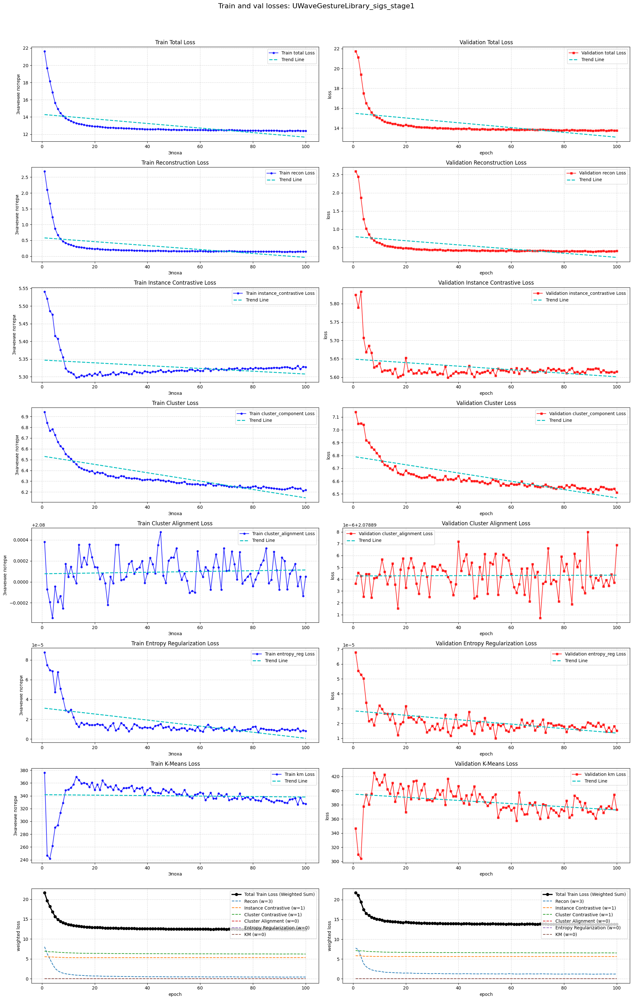

/tmp/ipykernel_31/4010107049.py:96: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model1.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage1/best_acc_model.p

num_steps=30, embedding_size=1364
test_data_orig_final.shape: (6400, 30, 1364)
Using device: cuda
num_steps=30, embedding_size=1364
Dataset: UWaveGestureLibrary_sigs_stage2
Batch size: 600 (8 classes * 75 samples/class)
Window length (num_steps): 30, Classes: 8

--- Actual composition of the first training batch ---
  - Class 0: 76
  - Class 1: 101
  - Class 2: 93
  - Class 3: 94
  - Class 4: 86
  - Class 5: 105
  - Class 6: 16
  - Class 7: 29
-----------------------------------------------------


 Epoch 1/50 | Train Loss: 20.1602 | Recon: 0.1162 | Instance Contrastive: 5.3275 | Cluster Contrastive: 6.1910 | KM: 326.5026 | Entropy Regularization : 0.0000 | Cluster Alignment : 2.0803 

Epoch 1 Train Metrics (avg over batches): NMI: 0.7575, RI: 0.9356, ACC: 0.8228, ARI: 0.7317

--- Actual composition of the first validation batch ---
  - Class 0: 118
  - Class 1: 108
  - Class 2: 106
  - Class 3: 91
  - Class 4: 104
  - Class 5: 80
  - Class 6: 92
  - Class 7: 101
----------------------

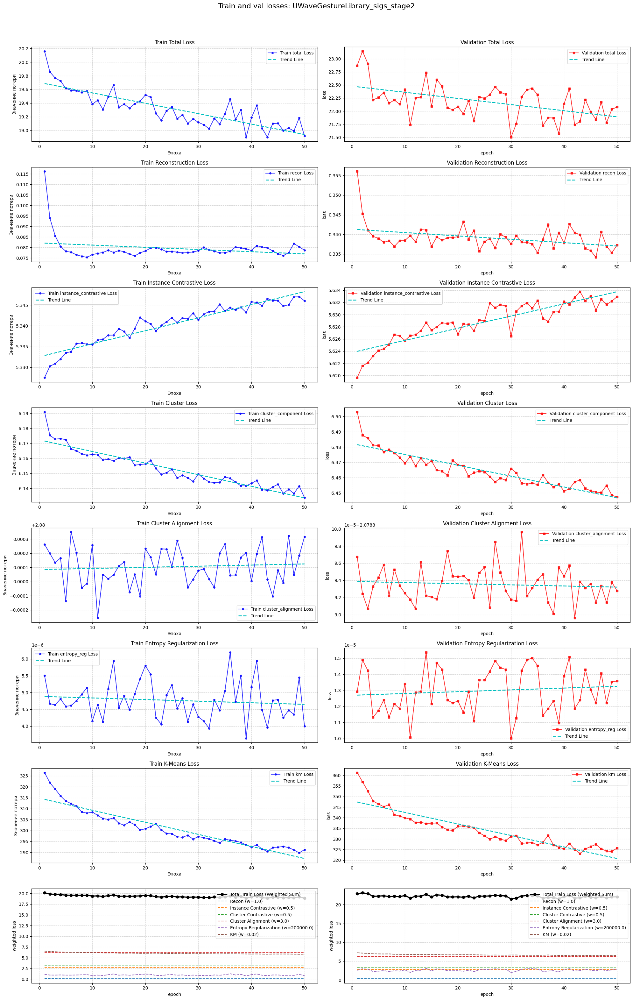

UWaveGestureLibrary: name 'class_num' is not defined
Empty DataFrame
Columns: []
Index: []


Traceback (most recent call last):
  File "/tmp/ipykernel_31/4010107049.py", line 122, in <cell line: 0>
    class_num,
    ^^^^^^^^^
NameError: name 'class_num' is not defined


In [46]:
DATASETS = ['EthanolConcentration', 'FaceDetection', 'Handwriting', 'Heartbeat',  'JapaneseVowels', 'PEMS-SF', 'SelfRegulationSCP1', 'SelfRegulationSCP2', 'SpokenArabicDigits', 'UWaveGestureLibrary']
DATASETS_TO_RUN  = ['UWaveGestureLibrary']

results_summary = {}

for dataset_name in DATASETS_TO_RUN:
    print(f"{dataset_name.upper()}")    
    try:
        X_train_df, y_train_df = load_from_tsfile_to_dataframe(os.path.join("../input/ts-classification/", f'TS_classification/{dataset_name}/{dataset_name}_TRAIN.ts'))
        X_test_df, y_test_df = load_from_tsfile_to_dataframe(os.path.join("../input/ts-classification/", f'TS_classification/{dataset_name}/{dataset_name}_TEST.ts'))

        
        if not (TEST_TS_LENGTH_EQUALITY(X_train_df) and TEST_TS_LENGTH_EQUALITY(X_test_df)):
            print(f"Skipped {dataset_name}: different lengths.")
            continue
        
        X_train_np = sktime_df_to_numpy(X_train_df)
        X_test_np = sktime_df_to_numpy(X_test_df)
        y_train_np, y_test_np, classes = encode_labels(y_train_df, y_test_df)
        
        print(f"Train: {X_train_np.shape}, Test: {X_test_np.shape}, classes: {len(classes)}")

        class SigParams(object):
            sig_type = 'sig'
            normalize_timeline = True
            activation = 'tanh'
            seed = 42
            sig_level = 5
            
        class Config(object):
            batch_size = 600
            test_batch_size = 800
            hidden_size = [512, 512, 256, 256]
            dilations = [1, 1, 1, 1]
            learning_rate = 1e-3
            embedding_size = None
            num_steps = None
            cell_type = 'GRU' # For encoder
            decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
            class_num = len(classes) 
            denoising = True
            hidden_norm_contrastive = True # For contrastive loss on hidden representations
            # standard_scaler = True
            normalize_data = True
            make_stationary = False
            scaler = StandardScaler #StandardScaler #RobustScaler
            temperature_contrastive = 0.5 # For instance-level contrastive loss
            temperature_cluster = 0.5 # For cluster-level contrastive loss
            l2_reg_weight = 1e-4 # L2 regularization weight
            eval_frequency = 1
            config_name = f"{dataset_name}_sigs_stage1"
            weight_recon = 3
            weight_instance_contrastive = 1
            weight_cluster_component = 1
            weight_km = 0
            weight_entropy_reg = 0
            weight_cluster_alignment = 0
            window_size = 30
            stride = 15
            num_epochs = 100
            # train_ratio = 6/8
            
        config_stage1 = Config()
        model1, loss_logs1, train_features, train_features_aug, test_features, test_features_aug, train_labels, test_labels = run_pipeline(
            config_stage1.config_name,
            config_stage1,
            X_train_np,
            X_test_np,
            y_train_np,
            y_test_np,
            train_data_orig_final=None, 
            train_data_aug_final=None, 
            train_labels_final=None,
            test_data_orig_final=None,
            test_data_aug_final=None,
            test_labels_final=None,
            model=None,
            signature_params=SigParams(),
            augmentation_func=jitter,
            sigma=0.03
        )
        plot_loss_histories(loss_logs1, config_stage1)
        
        config_stage2 = Config()
        config_stage2.config_name = f"{dataset_name}_sigs_stage2"
        config_stage2.learning_rate = 1e-4
        config_stage2.num_epochs = 50
        config_stage2.weight_recon = 1.0
        config_stage2.weight_instance_contrastive = 0.5
        config_stage2.weight_cluster_component = 0.5
        config_stage2.weight_km = 0.02
        config_stage2.weight_entropy_reg = 2e5
        config_stage2.weight_cluster_alignment = 3.0
        model1.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage1/best_acc_model.pth"))
        
        model2, loss_logs2, train_features, _, test_features, _, train_labels, test_labels = run_pipeline(
            config_stage2.config_name,
            config_stage2,
            X_train_np=None,
            X_test_np=None,
            y_train_np=None,
            y_test_np=None,
            train_data_orig_final=train_features, 
            train_data_aug_final=train_features_aug, 
            train_labels_final=train_labels,
            test_data_orig_final=test_features,
            test_data_aug_final=test_features_aug,
            test_labels_final=test_labels,
            model=model1,
            signature_params=SigParams(),
            augmentation_func=jitter,
            sigma=0.03
        )
        plot_loss_histories(loss_logs2, config_stage2)

        mean_acc, var_acc, acc_on_original = evaluate_clustering_with_bootstrap(
            model2,
            test_features,
            test_labels,
            len(classes),
            n_bootstrap=100
        )
        
        print(f"\n--- {dataset_name} ---")
        print(f"accuracy on original: {acc_on_original:.2f}%")
        print(f"mean accuracy with_bootstrap: {mean_acc:.2f}%")
        print(f"variance accuracy with_bootstrap: {var_acc:.2f}")
        
        results_summary[dataset_name] = {
            'accuracy_original': acc_on_original,
            'accuracy_bootstrap_mean': mean_acc,
            'accuracy_bootstrap_variance': var_acc
        }
        
        data_np = np.concatenate([train_features, test_features], axis=0)
        label_np = np.concatenate([train_labels, test_labels], axis=0)
        model2.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage2/best_nmi_model.pth"))
        visualize_embeddings_with_umap(
            model2,
            data_np,
            label_np,
            f"{dataset_name}_sigs",
            'cuda',
            distribution_names=distribution_names
        )

    except Exception as e:
        print(f"{dataset_name}: {e}")
        import traceback
        traceback.print_exc()


results_df = pd.DataFrame.from_dict(results_summary, orient='index')
print(results_df)

In [39]:
DATASETS = ['EthanolConcentration', 'FaceDetection', 'Handwriting', 'Heartbeat',  'JapaneseVowels', 'PEMS-SF', 'SelfRegulationSCP1', 'SelfRegulationSCP2', 'SpokenArabicDigits', 'UWaveGestureLibrary']
DATASET_NAME = 'Handwriting'
X_train_df, y_train_df = load_from_tsfile_to_dataframe(os.path.join("./", f'TS_classification/{DATASET_NAME}/{DATASET_NAME}_TRAIN.ts'))
X_test_df, y_test_df = load_from_tsfile_to_dataframe(os.path.join("./", f'TS_classification/{DATASET_NAME}/{DATASET_NAME}_TEST.ts'))
# print(TEST_TS_LENGTH_EQUALITY(X_test_df), TEST_TS_LENGTH_EQUALITY(X_train_df))

X_train_np = sktime_df_to_numpy(X_train_df)
X_test_np = sktime_df_to_numpy(X_test_df)
y_train_np, y_test_np, classes = encode_labels(y_train_df, y_test_df)

In [43]:
X_test_np.shape

(850, 152, 3)

In [54]:
def is_prime(n):  
    if n <= 1:  
        return False  
    if n == 2:  
        return True  
    if n % 2 == 0:  
        return False  
    for i in range(3, int(n**0.5) + 1, 2):  
        if n % i == 0:  
            print(i)
            return False  
    return True  

In [64]:
is_prime(1751)

17


False

Handwriting
Train: (150, 152, 3), Test: (850, 152, 3), classes: 26
augmentation...
Signature's type: sig
Signatures prepared
Signatures prepared
Signatures prepared
Signatures prepared
processed_X_test_np_orig.shape : (850, 152, 1364)
Each fragment is divided into 2 windows.
Each fragment is divided into 2 windows.
Each fragment is divided into 2 windows.
Each fragment is divided into 2 windows.
config.num_steps :150
num_steps=150, embedding_size=1364
test_data_orig_final.shape: (1700, 150, 1364)
Using device: cuda
num_steps=150, embedding_size=1364
Dataset: Handwriting_sigs_stage1
Batch size: 300 (26 classes * 11 samples/class)
Window length (num_steps): 150, Classes: 26

--- Actual composition of the first training batch ---
  - Class 0: 16
  - Class 1: 14
  - Class 2: 4
  - Class 3: 10
  - Class 4: 14
  - Class 5: 8
  - Class 6: 16
  - Class 7: 10
  - Class 8: 12
  - Class 9: 12
  - Class 10: 6
  - Class 11: 12
  - Class 12: 10
  - Class 13: 10
  - Class 14: 20
  - Class 15: 8
  - C

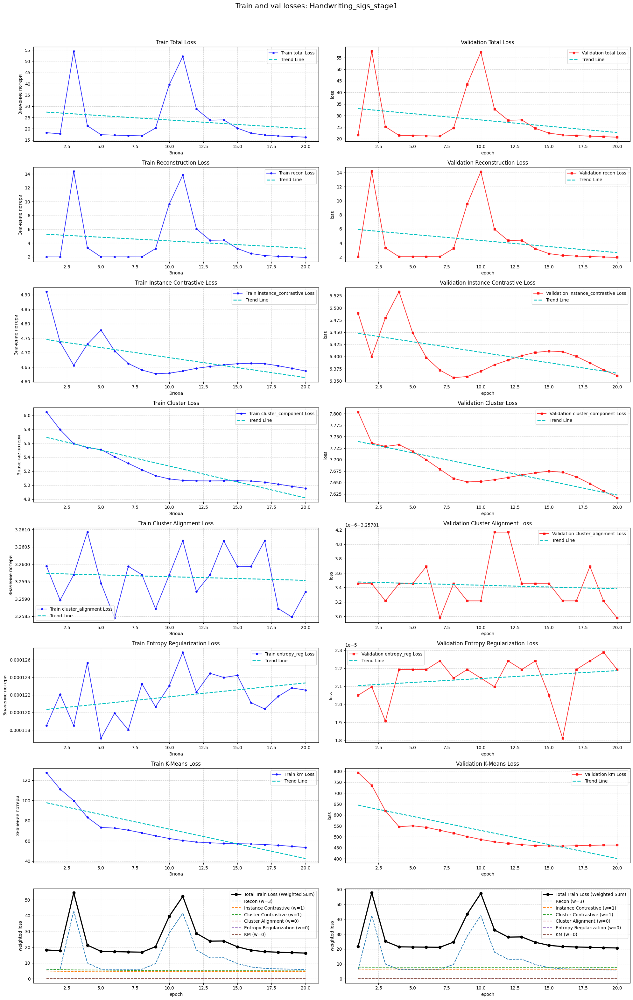

/tmp/ipykernel_8782/2290615722.py:94: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model1.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage1/best_acc_model

num_steps=150, embedding_size=1364
test_data_orig_final.shape: (1700, 150, 1364)
Using device: cuda
num_steps=150, embedding_size=1364
Dataset: Handwriting_sigs_stage2
Batch size: 300 (26 classes * 11 samples/class)
Window length (num_steps): 150, Classes: 26

--- Actual composition of the first training batch ---
  - Class 0: 16
  - Class 1: 14
  - Class 2: 4
  - Class 3: 10
  - Class 4: 14
  - Class 5: 8
  - Class 6: 16
  - Class 7: 10
  - Class 8: 12
  - Class 9: 12
  - Class 10: 6
  - Class 11: 12
  - Class 12: 10
  - Class 13: 10
  - Class 14: 20
  - Class 15: 8
  - Class 16: 8
  - Class 17: 12
  - Class 18: 22
  - Class 19: 18
  - Class 20: 8
  - Class 21: 10
  - Class 22: 18
  - Class 23: 12
  - Class 24: 4
  - Class 25: 6
-----------------------------------------------------


 Epoch 1/20 | Train Loss: 43.1480 | Recon: 1.9279 | Instance Contrastive: 4.6367 | Cluster Contrastive: 4.9548 | KM: 53.4546 | Entropy Regularization : 0.0001 | Cluster Alignment : 3.2597 

Epoch 1 Train 

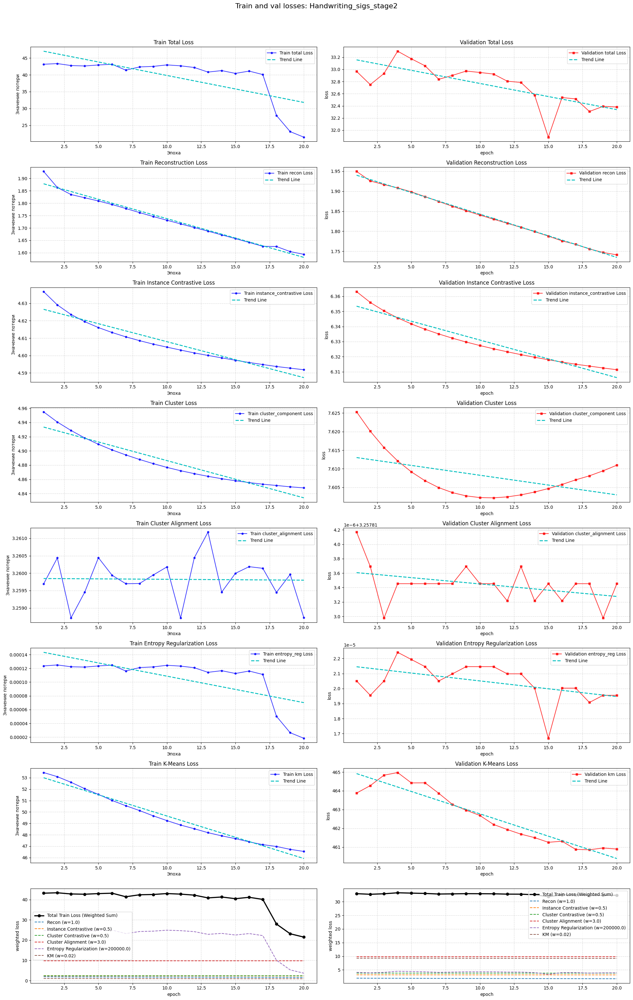

Извлечено 1700 эмбеддингов размерности 3072.
Запуск 100 итераций бутстрапа...

--- Handwriting ---
accuracy on original: 38.35%
mean accuracy with_bootstrap: 37.46%
variance accuracy with_bootstrap: 0.03
Handwriting: [Errno 2] No such file or directory: './ACC_model/Handwriting_sigs_stage2/best_nmi_model.pth'
             accuracy_original  accuracy_bootstrap_mean  \
Handwriting              38.35                    37.46   

             accuracy_bootstrap_variance  
Handwriting                         0.03  


/tmp/ipykernel_8782/2290615722.py:137: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model2.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage2/best_nmi_mode

In [55]:
DATASETS = ['EthanolConcentration', 'FaceDetection', 'Handwriting', 'Heartbeat',  'JapaneseVowels', 'PEMS-SF', 'SelfRegulationSCP1', 'SelfRegulationSCP2', 'SpokenArabicDigits', 'UWaveGestureLibrary']
DATASETS_TO_RUN  = ['Handwriting']

results_summary = {}

for dataset_name in DATASETS_TO_RUN:
    print(f"{dataset_name}")    
    try:
        X_train_df, y_train_df = load_from_tsfile_to_dataframe(os.path.join("./", f'TS_classification/{dataset_name}/{dataset_name}_TRAIN.ts'))
        X_test_df, y_test_df = load_from_tsfile_to_dataframe(os.path.join("./", f'TS_classification/{dataset_name}/{dataset_name}_TEST.ts'))

        
        # if not (TEST_TS_LENGTH_EQUALITY(X_train_df) and TEST_TS_LENGTH_EQUALITY(X_test_df)):
        #     print(f"Skipped {dataset_name}: different lengths.")
        #     continue
        
        X_train_np = sktime_df_to_numpy(X_train_df)
        X_test_np = sktime_df_to_numpy(X_test_df)
        y_train_np, y_test_np, classes = encode_labels(y_train_df, y_test_df)
        
        print(f"Train: {X_train_np.shape}, Test: {X_test_np.shape}, classes: {len(classes)}")

        class SigParams(object):
            sig_type = 'sig'
            normalize_timeline = True
            activation = 'tanh'
            seed = 42
            sig_level = 5
            
        class Config(object):
            batch_size = 300
            test_batch_size = 1700
            hidden_size = [512, 512, 256, 256]
            dilations = [1, 1, 1, 1]
            learning_rate = 1e-3
            embedding_size = None
            num_steps = None
            cell_type = 'GRU' # For encoder
            decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
            class_num = len(classes) 
            denoising = True
            hidden_norm_contrastive = True # For contrastive loss on hidden representations
            # standard_scaler = True
            normalize_data = True
            make_stationary = False
            scaler = StandardScaler #StandardScaler #RobustScaler
            temperature_contrastive = 0.5 # For instance-level contrastive loss
            temperature_cluster = 0.5 # For cluster-level contrastive loss
            l2_reg_weight = 1e-4 # L2 regularization weight
            eval_frequency = 1
            config_name = f"{dataset_name}_sigs_stage1"
            weight_recon = 3
            weight_instance_contrastive = 1
            weight_cluster_component = 1
            weight_km = 0
            weight_entropy_reg = 0
            weight_cluster_alignment = 0
            window_size = 150
            stride = 2
            num_epochs = 20
            # train_ratio = 6/8
            
        config_stage1 = Config()
        model1, loss_logs1, train_features, train_features_aug, test_features, test_features_aug, train_labels, test_labels = run_pipeline(
            config_stage1.config_name,
            config_stage1,
            X_train_np,
            X_test_np,
            y_train_np,
            y_test_np,
            train_data_orig_final=None, 
            train_data_aug_final=None, 
            train_labels_final=None,
            test_data_orig_final=None,
            test_data_aug_final=None,
            test_labels_final=None,
            model=None,
            signature_params=SigParams(),
            augmentation_func=jitter,
            sigma=0.03
        )
        plot_loss_histories(loss_logs1, config_stage1)
        
        config_stage2 = Config()
        config_stage2.config_name = f"{dataset_name}_sigs_stage2"
        config_stage2.learning_rate = 1e-4
        config_stage2.num_epochs = 20
        config_stage2.weight_recon = 1.0
        config_stage2.weight_instance_contrastive = 0.5
        config_stage2.weight_cluster_component = 0.5
        config_stage2.weight_km = 0.02
        config_stage2.weight_entropy_reg = 2e5
        config_stage2.weight_cluster_alignment = 3.0
        model1.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage1/best_acc_model.pth"))
        
        model2, loss_logs2, train_features, _, test_features, _, train_labels, test_labels = run_pipeline(
            config_stage2.config_name,
            config_stage2,
            X_train_np=None,
            X_test_np=None,
            y_train_np=None,
            y_test_np=None,
            train_data_orig_final=train_features, 
            train_data_aug_final=train_features_aug, 
            train_labels_final=train_labels,
            test_data_orig_final=test_features,
            test_data_aug_final=test_features_aug,
            test_labels_final=test_labels,
            model=model1,
            signature_params=SigParams(),
            augmentation_func=jitter,
            sigma=0.03
        )
        plot_loss_histories(loss_logs2, config_stage2)

        mean_acc, var_acc, acc_on_original = evaluate_clustering_with_bootstrap(
            model2,
            test_features,
            test_labels,
            len(classes),
            n_bootstrap=100
        )
        
        print(f"\n--- {dataset_name} ---")
        print(f"accuracy on original: {acc_on_original:.2f}%")
        print(f"mean accuracy with_bootstrap: {mean_acc:.2f}%")
        print(f"variance accuracy with_bootstrap: {var_acc:.2f}")
        
        results_summary[dataset_name] = {
            'accuracy_original': acc_on_original,
            'accuracy_bootstrap_mean': mean_acc,
            'accuracy_bootstrap_variance': var_acc
        }
        
        data_np = np.concatenate([train_features, test_features], axis=0)
        label_np = np.concatenate([train_labels, test_labels], axis=0)
        model2.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage2/best_acc_model.pth"))
        visualize_embeddings_with_umap(
            model2,
            data_np,
            label_np,
            f"{dataset_name}_sigs",
            'cuda',
            distribution_names=classes
        )

    except Exception as e:
        print(f"{dataset_name}: {e}")
        import traceback
        traceback.print_exc()


results_df = pd.DataFrame.from_dict(results_summary, orient='index')
print(results_df)

Handwriting
Train: (150, 152, 3), Test: (850, 152, 3), classes: 26
augmentation...
Signature's type: sig
Signatures prepared
Signatures prepared
Signatures prepared
Signatures prepared
processed_X_test_np_orig.shape : (850, 152, 1364)
Each fragment is divided into 2 windows.
Each fragment is divided into 2 windows.
Each fragment is divided into 2 windows.
Each fragment is divided into 2 windows.
config.num_steps :150
num_steps=150, embedding_size=1364
test_data_orig_final.shape: (1700, 150, 1364)
Using device: cuda
num_steps=150, embedding_size=1364
Dataset: Handwriting_sigs_stage1
Batch size: 300 (26 classes * 11 samples/class)
Window length (num_steps): 150, Classes: 26

--- Actual composition of the first training batch ---
  - Class 0: 16
  - Class 1: 14
  - Class 2: 4
  - Class 3: 10
  - Class 4: 14
  - Class 5: 8
  - Class 6: 16
  - Class 7: 10
  - Class 8: 12
  - Class 9: 12
  - Class 10: 6
  - Class 11: 12
  - Class 12: 10
  - Class 13: 10
  - Class 14: 20
  - Class 15: 8
  - C

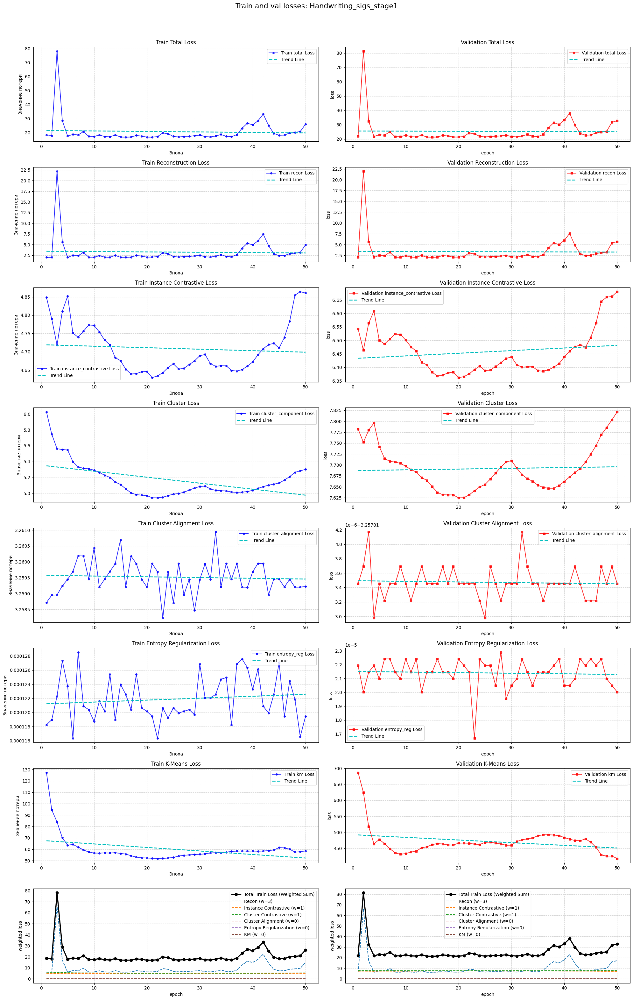

/tmp/ipykernel_477/2610782629.py:94: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model1.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage1/best_acc_model.

num_steps=150, embedding_size=1364
test_data_orig_final.shape: (1700, 150, 1364)
Using device: cuda
num_steps=150, embedding_size=1364
Dataset: Handwriting_sigs_stage2
Batch size: 300 (26 classes * 11 samples/class)
Window length (num_steps): 150, Classes: 26

--- Actual composition of the first training batch ---
  - Class 0: 16
  - Class 1: 14
  - Class 2: 4
  - Class 3: 10
  - Class 4: 14
  - Class 5: 8
  - Class 6: 16
  - Class 7: 10
  - Class 8: 12
  - Class 9: 12
  - Class 10: 6
  - Class 11: 12
  - Class 12: 10
  - Class 13: 10
  - Class 14: 20
  - Class 15: 8
  - Class 16: 8
  - Class 17: 12
  - Class 18: 22
  - Class 19: 18
  - Class 20: 8
  - Class 21: 10
  - Class 22: 18
  - Class 23: 12
  - Class 24: 4
  - Class 25: 6
-----------------------------------------------------


 Epoch 1/25 | Train Loss: 43.9537 | Recon: 2.4483 | Instance Contrastive: 4.6401 | Cluster Contrastive: 4.9826 | KM: 53.1898 | Entropy Regularization : 0.0001 | Cluster Alignment : 3.2595 

Epoch 1 Train 

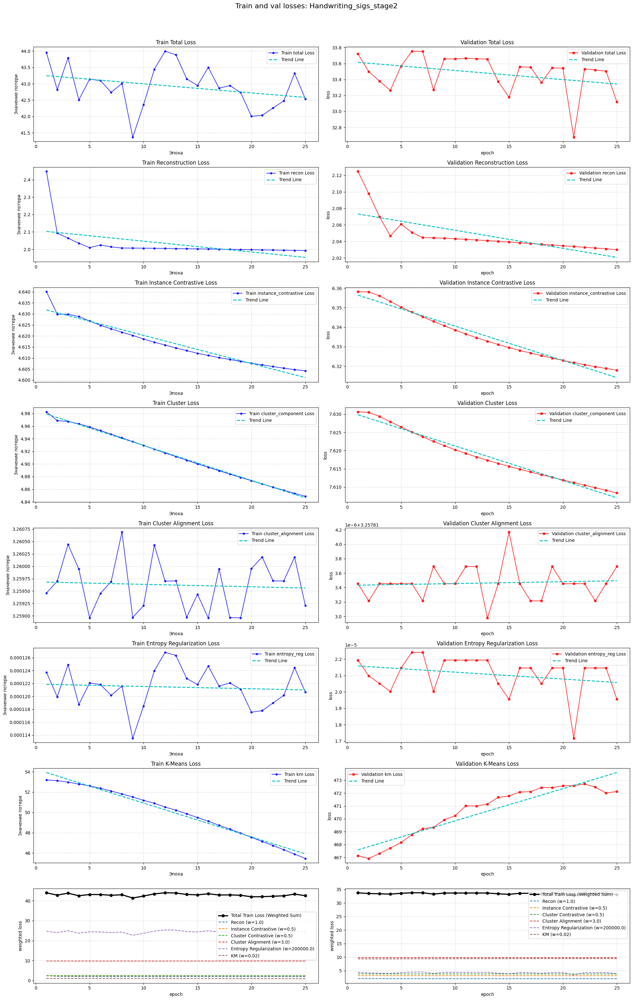

Извлечено 1700 эмбеддингов размерности 4096.
Запуск 100 итераций бутстрапа...

--- Handwriting ---
accuracy on original: 38.59%
mean accuracy with_bootstrap: 37.91%
variance accuracy with_bootstrap: 0.04


/tmp/ipykernel_477/2610782629.py:137: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model2.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage2/best_acc_model

Handwriting: name 'distribution_names' is not defined
             accuracy_original  accuracy_bootstrap_mean  \
Handwriting              38.59                    37.91   

             accuracy_bootstrap_variance  
Handwriting                         0.04  


Traceback (most recent call last):
  File "/tmp/ipykernel_477/2610782629.py", line 144, in <module>
    distribution_names=distribution_names
                       ^^^^^^^^^^^^^^^^^^
NameError: name 'distribution_names' is not defined


In [36]:
DATASETS = ['EthanolConcentration', 'FaceDetection', 'Handwriting', 'Heartbeat',  'JapaneseVowels', 'PEMS-SF', 'SelfRegulationSCP1', 'SelfRegulationSCP2', 'SpokenArabicDigits', 'UWaveGestureLibrary']
DATASETS_TO_RUN  = ['Handwriting']

results_summary = {}

for dataset_name in DATASETS_TO_RUN:
    print(f"{dataset_name}")    
    try:
        X_train_df, y_train_df = load_from_tsfile_to_dataframe(os.path.join("./", f'TS_classification/{dataset_name}/{dataset_name}_TRAIN.ts'))
        X_test_df, y_test_df = load_from_tsfile_to_dataframe(os.path.join("./", f'TS_classification/{dataset_name}/{dataset_name}_TEST.ts'))

        
        # if not (TEST_TS_LENGTH_EQUALITY(X_train_df) and TEST_TS_LENGTH_EQUALITY(X_test_df)):
        #     print(f"Skipped {dataset_name}: different lengths.")
        #     continue
        
        X_train_np = sktime_df_to_numpy(X_train_df)
        X_test_np = sktime_df_to_numpy(X_test_df)
        y_train_np, y_test_np, classes = encode_labels(y_train_df, y_test_df)
        
        print(f"Train: {X_train_np.shape}, Test: {X_test_np.shape}, classes: {len(classes)}")

        class SigParams(object):
            sig_type = 'sig'
            normalize_timeline = True
            activation = 'tanh'
            seed = 42
            sig_level = 5
            
        class Config(object):
            batch_size = 300
            test_batch_size = 1700
            hidden_size = [1024, 512, 256, 256]
            dilations = [1, 1, 1, 1]
            learning_rate = 1e-3
            embedding_size = None
            num_steps = None
            cell_type = 'GRU' # For encoder
            decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
            class_num = len(classes) 
            denoising = True
            hidden_norm_contrastive = True # For contrastive loss on hidden representations
            # standard_scaler = True
            normalize_data = True
            make_stationary = False
            scaler = StandardScaler #StandardScaler #RobustScaler
            temperature_contrastive = 0.5 # For instance-level contrastive loss
            temperature_cluster = 0.5 # For cluster-level contrastive loss
            l2_reg_weight = 1e-4 # L2 regularization weight
            eval_frequency = 1
            config_name = f"{dataset_name}_sigs_stage1"
            weight_recon = 3
            weight_instance_contrastive = 1
            weight_cluster_component = 1
            weight_km = 0
            weight_entropy_reg = 0
            weight_cluster_alignment = 0
            window_size = 150
            stride = 2
            num_epochs = 50
            # train_ratio = 6/8
            
        config_stage1 = Config()
        model1, loss_logs1, train_features, train_features_aug, test_features, test_features_aug, train_labels, test_labels = run_pipeline(
            config_stage1.config_name,
            config_stage1,
            X_train_np,
            X_test_np,
            y_train_np,
            y_test_np,
            train_data_orig_final=None, 
            train_data_aug_final=None, 
            train_labels_final=None,
            test_data_orig_final=None,
            test_data_aug_final=None,
            test_labels_final=None,
            model=None,
            signature_params=SigParams(),
            augmentation_func=jitter,
            sigma=0.03
        )
        plot_loss_histories(loss_logs1, config_stage1)
        
        config_stage2 = Config()
        config_stage2.config_name = f"{dataset_name}_sigs_stage2"
        config_stage2.learning_rate = 1e-4
        config_stage2.num_epochs = 25
        config_stage2.weight_recon = 1.0
        config_stage2.weight_instance_contrastive = 0.5
        config_stage2.weight_cluster_component = 0.5
        config_stage2.weight_km = 0.02
        config_stage2.weight_entropy_reg = 2e5
        config_stage2.weight_cluster_alignment = 3.0
        model1.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage1/best_acc_model.pth"))
        
        model2, loss_logs2, train_features, _, test_features, _, train_labels, test_labels = run_pipeline(
            config_stage2.config_name,
            config_stage2,
            X_train_np=None,
            X_test_np=None,
            y_train_np=None,
            y_test_np=None,
            train_data_orig_final=train_features, 
            train_data_aug_final=train_features_aug, 
            train_labels_final=train_labels,
            test_data_orig_final=test_features,
            test_data_aug_final=test_features_aug,
            test_labels_final=test_labels,
            model=model1,
            signature_params=SigParams(),
            augmentation_func=jitter,
            sigma=0.03
        )
        plot_loss_histories(loss_logs2, config_stage2)

        mean_acc, var_acc, acc_on_original = evaluate_clustering_with_bootstrap(
            model2,
            test_features,
            test_labels,
            len(classes),
            n_bootstrap=100
        )
        
        print(f"\n--- {dataset_name} ---")
        print(f"accuracy on original: {acc_on_original:.2f}%")
        print(f"mean accuracy with_bootstrap: {mean_acc:.2f}%")
        print(f"variance accuracy with_bootstrap: {var_acc:.2f}")
        
        results_summary[dataset_name] = {
            'accuracy_original': acc_on_original,
            'accuracy_bootstrap_mean': mean_acc,
            'accuracy_bootstrap_variance': var_acc
        }
        
        data_np = np.concatenate([train_features, test_features], axis=0)
        label_np = np.concatenate([train_labels, test_labels], axis=0)
        model2.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage2/best_acc_model.pth"))
        visualize_embeddings_with_umap(
            model2,
            data_np,
            label_np,
            f"{dataset_name}_sigs",
            'cuda',
            distribution_names=distribution_names
        )

    except Exception as e:
        print(f"{dataset_name}: {e}")
        import traceback
        traceback.print_exc()


results_df = pd.DataFrame.from_dict(results_summary, orient='index')
print(results_df)

Handwriting
Train: (150, 152, 3), Test: (850, 152, 3), classes: 26
augmentation...
Signature's type: sig
Signatures prepared
Signatures prepared
Signatures prepared
Signatures prepared
processed_X_test_np_orig.shape : (850, 152, 5460)
Each fragment is divided into 2 windows.
Each fragment is divided into 2 windows.
Each fragment is divided into 2 windows.
Each fragment is divided into 2 windows.
config.num_steps :150
num_steps=150, embedding_size=5460
test_data_orig_final.shape: (1700, 150, 5460)
Using device: cuda
num_steps=150, embedding_size=5460
Dataset: Handwriting_sigs_stage1
Batch size: 300 (26 classes * 11 samples/class)
Window length (num_steps): 150, Classes: 26

--- Actual composition of the first training batch ---
  - Class 0: 16
  - Class 1: 14
  - Class 2: 4
  - Class 3: 10
  - Class 4: 14
  - Class 5: 8
  - Class 6: 16
  - Class 7: 10
  - Class 8: 12
  - Class 9: 12
  - Class 10: 6
  - Class 11: 12
  - Class 12: 10
  - Class 13: 10
  - Class 14: 20
  - Class 15: 8
  - C

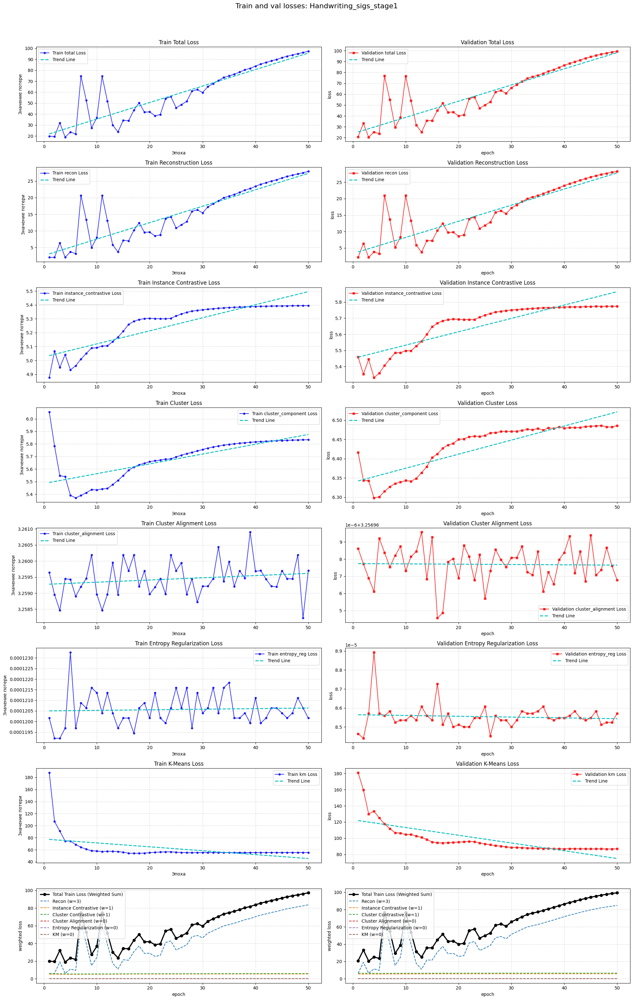

/tmp/ipykernel_477/1456662799.py:94: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model1.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage1/best_acc_model.

num_steps=150, embedding_size=5460
test_data_orig_final.shape: (1700, 150, 5460)
Using device: cuda
num_steps=150, embedding_size=5460
Dataset: Handwriting_sigs_stage2
Batch size: 300 (26 classes * 11 samples/class)
Window length (num_steps): 150, Classes: 26

--- Actual composition of the first training batch ---
  - Class 0: 16
  - Class 1: 14
  - Class 2: 4
  - Class 3: 10
  - Class 4: 14
  - Class 5: 8
  - Class 6: 16
  - Class 7: 10
  - Class 8: 12
  - Class 9: 12
  - Class 10: 6
  - Class 11: 12
  - Class 12: 10
  - Class 13: 10
  - Class 14: 20
  - Class 15: 8
  - Class 16: 8
  - Class 17: 12
  - Class 18: 22
  - Class 19: 18
  - Class 20: 8
  - Class 21: 10
  - Class 22: 18
  - Class 23: 12
  - Class 24: 4
  - Class 25: 6
-----------------------------------------------------


 Epoch 1/25 | Train Loss: 49.6607 | Recon: 7.0105 | Instance Contrastive: 5.2592 | Cluster Contrastive: 5.5906 | KM: 54.2800 | Entropy Regularization : 0.0001 | Cluster Alignment : 3.2585 

Epoch 1 Train 

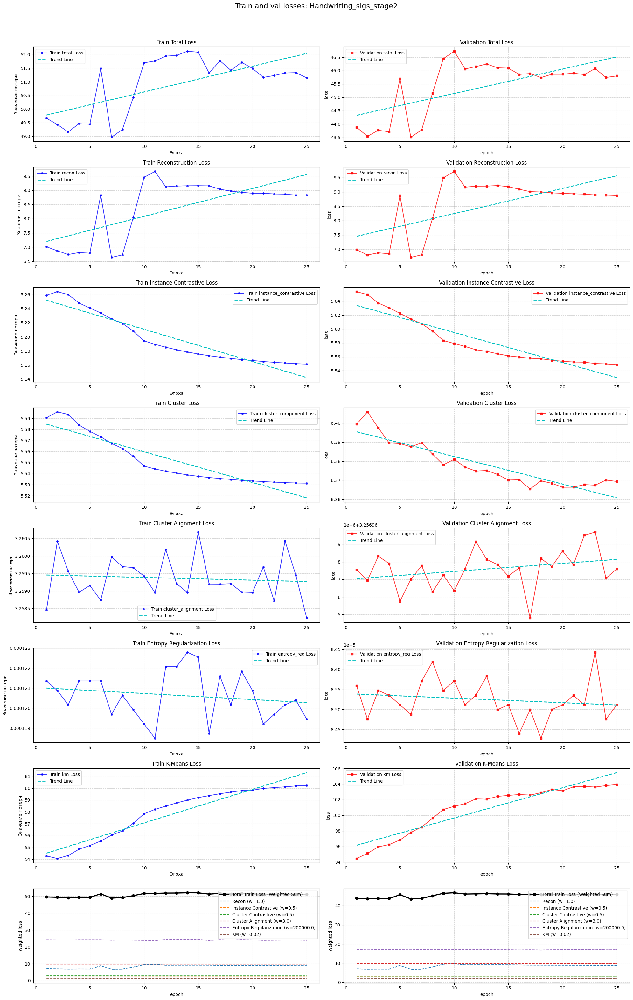

Извлечено 1700 эмбеддингов размерности 4096.
Запуск 100 итераций бутстрапа...

--- Handwriting ---
accuracy on original: 32.59%
mean accuracy with_bootstrap: 32.94%
variance accuracy with_bootstrap: 0.03


/tmp/ipykernel_477/1456662799.py:137: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model2.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage2/best_acc_model

Получение эмбеддингов для визуализации...
Извлечено 2000 эмбеддингов размерности 4096.

Снижение размерности с помощью UMAP...
Снижение до 4D UMAP компонент...
Построение графика UMAP (Компоненты 1 и 2)...
Ошибка при выполнении UMAP или построении графика: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()
             accuracy_original  accuracy_bootstrap_mean  \
Handwriting              32.59                    32.94   

             accuracy_bootstrap_variance  
Handwriting                         0.03  


Traceback (most recent call last):
  File "/tmp/ipykernel_477/1645489974.py", line 154, in visualize_embeddings_with_umap
    plot_embeddings_2d_umap(embeddings_umap_intermediate[:, [0, 1]], labels_np_int,
  File "/tmp/ipykernel_477/1645489974.py", line 78, in plot_embeddings_2d_umap
    if distribution_names:
ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()


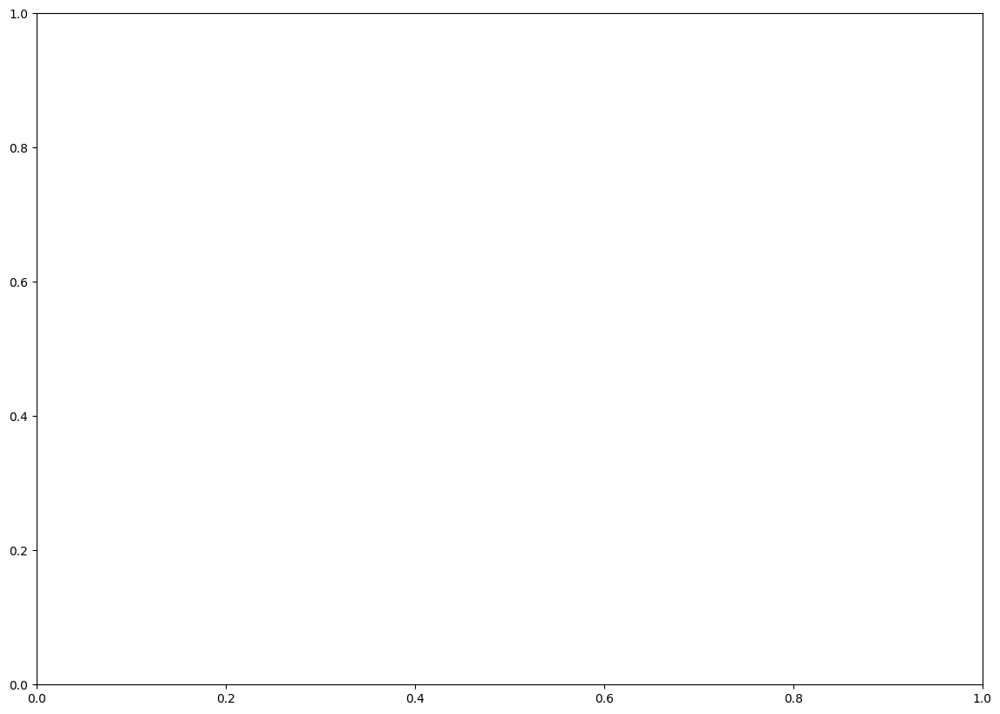

In [39]:
DATASETS = ['EthanolConcentration', 'FaceDetection', 'Handwriting', 'Heartbeat',  'JapaneseVowels', 'PEMS-SF', 'SelfRegulationSCP1', 'SelfRegulationSCP2', 'SpokenArabicDigits', 'UWaveGestureLibrary']
DATASETS_TO_RUN  = ['Handwriting']

results_summary = {}

for dataset_name in DATASETS_TO_RUN:
    print(f"{dataset_name}")    
    try:
        X_train_df, y_train_df = load_from_tsfile_to_dataframe(os.path.join("./", f'TS_classification/{dataset_name}/{dataset_name}_TRAIN.ts'))
        X_test_df, y_test_df = load_from_tsfile_to_dataframe(os.path.join("./", f'TS_classification/{dataset_name}/{dataset_name}_TEST.ts'))

        
        # if not (TEST_TS_LENGTH_EQUALITY(X_train_df) and TEST_TS_LENGTH_EQUALITY(X_test_df)):
        #     print(f"Skipped {dataset_name}: different lengths.")
        #     continue
        
        X_train_np = sktime_df_to_numpy(X_train_df)
        X_test_np = sktime_df_to_numpy(X_test_df)
        y_train_np, y_test_np, classes = encode_labels(y_train_df, y_test_df)
        
        print(f"Train: {X_train_np.shape}, Test: {X_test_np.shape}, classes: {len(classes)}")

        class SigParams(object):
            sig_type = 'sig'
            normalize_timeline = True
            activation = 'tanh'
            seed = 42
            sig_level = 6
            
        class Config(object):
            batch_size = 300
            test_batch_size = 425
            hidden_size = [1024, 512, 256, 256]
            dilations = [1, 1, 1, 1]
            learning_rate = 1e-3
            embedding_size = None
            num_steps = None
            cell_type = 'GRU' # For encoder
            decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
            class_num = len(classes) 
            denoising = True
            hidden_norm_contrastive = True # For contrastive loss on hidden representations
            # standard_scaler = True
            normalize_data = True
            make_stationary = False
            scaler = StandardScaler #StandardScaler #RobustScaler
            temperature_contrastive = 0.5 # For instance-level contrastive loss
            temperature_cluster = 0.5 # For cluster-level contrastive loss
            l2_reg_weight = 1e-4 # L2 regularization weight
            eval_frequency = 1
            config_name = f"{dataset_name}_sigs_stage1"
            weight_recon = 3
            weight_instance_contrastive = 1
            weight_cluster_component = 1
            weight_km = 0
            weight_entropy_reg = 0
            weight_cluster_alignment = 0
            window_size = 150
            stride = 2
            num_epochs = 50
            # train_ratio = 6/8
            
        config_stage1 = Config()
        model1, loss_logs1, train_features, train_features_aug, test_features, test_features_aug, train_labels, test_labels = run_pipeline(
            config_stage1.config_name,
            config_stage1,
            X_train_np,
            X_test_np,
            y_train_np,
            y_test_np,
            train_data_orig_final=None, 
            train_data_aug_final=None, 
            train_labels_final=None,
            test_data_orig_final=None,
            test_data_aug_final=None,
            test_labels_final=None,
            model=None,
            signature_params=SigParams(),
            augmentation_func=jitter,
            sigma=0.03
        )
        plot_loss_histories(loss_logs1, config_stage1)
        
        config_stage2 = Config()
        config_stage2.config_name = f"{dataset_name}_sigs_stage2"
        config_stage2.learning_rate = 1e-4
        config_stage2.num_epochs = 25
        config_stage2.weight_recon = 1.0
        config_stage2.weight_instance_contrastive = 0.5
        config_stage2.weight_cluster_component = 0.5
        config_stage2.weight_km = 0.02
        config_stage2.weight_entropy_reg = 2e5
        config_stage2.weight_cluster_alignment = 3.0
        model1.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage1/best_acc_model.pth"))
        
        model2, loss_logs2, train_features, _, test_features, _, train_labels, test_labels = run_pipeline(
            config_stage2.config_name,
            config_stage2,
            X_train_np=None,
            X_test_np=None,
            y_train_np=None,
            y_test_np=None,
            train_data_orig_final=train_features, 
            train_data_aug_final=train_features_aug, 
            train_labels_final=train_labels,
            test_data_orig_final=test_features,
            test_data_aug_final=test_features_aug,
            test_labels_final=test_labels,
            model=model1,
            signature_params=SigParams(),
            augmentation_func=jitter,
            sigma=0.03
        )
        plot_loss_histories(loss_logs2, config_stage2)

        mean_acc, var_acc, acc_on_original = evaluate_clustering_with_bootstrap(
            model2,
            test_features,
            test_labels,
            len(classes),
            n_bootstrap=100
        )
        
        print(f"\n--- {dataset_name} ---")
        print(f"accuracy on original: {acc_on_original:.2f}%")
        print(f"mean accuracy with_bootstrap: {mean_acc:.2f}%")
        print(f"variance accuracy with_bootstrap: {var_acc:.2f}")
        
        results_summary[dataset_name] = {
            'accuracy_original': acc_on_original,
            'accuracy_bootstrap_mean': mean_acc,
            'accuracy_bootstrap_variance': var_acc
        }
        
        data_np = np.concatenate([train_features, test_features], axis=0)
        label_np = np.concatenate([train_labels, test_labels], axis=0)
        model2.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage2/best_acc_model.pth"))
        visualize_embeddings_with_umap(
            model2,
            data_np,
            label_np,
            f"{dataset_name}_sigs",
            'cuda',
            distribution_names=classes
        )

    except Exception as e:
        print(f"{dataset_name}: {e}")
        import traceback
        traceback.print_exc()


results_df = pd.DataFrame.from_dict(results_summary, orient='index')
print(results_df)

In [40]:
DATASETS = ['EthanolConcentration', 'FaceDetection', 'Handwriting', 'Heartbeat',  'JapaneseVowels', 'PEMS-SF', 'SelfRegulationSCP1', 'SelfRegulationSCP2', 'SpokenArabicDigits', 'UWaveGestureLibrary']
DATASET_NAME = 'EthanolConcentration'
X_train_df, y_train_df = load_from_tsfile_to_dataframe(os.path.join("./", f'TS_classification/{DATASET_NAME}/{DATASET_NAME}_TRAIN.ts'))
X_test_df, y_test_df = load_from_tsfile_to_dataframe(os.path.join("./", f'TS_classification/{DATASET_NAME}/{DATASET_NAME}_TEST.ts'))
# print(TEST_TS_LENGTH_EQUALITY(X_test_df), TEST_TS_LENGTH_EQUALITY(X_train_df))

X_train_np = sktime_df_to_numpy(X_train_df)
X_test_np = sktime_df_to_numpy(X_test_df)
y_train_np, y_test_np, classes = encode_labels(y_train_df, y_test_df)

In [77]:
np.unique(y_train_np, return_counts=True)

(array([0, 1, 2, 3]), array([65, 65, 66, 65]))

In [78]:
np.unique(y_test_np, return_counts=True)

(array([0, 1, 2, 3]), array([66, 66, 66, 65]))

In [42]:
X_train_np.shape, X_test_np.shape

((261, 1751, 3), (263, 1751, 3))

In [63]:
is_prime(517.0)

11


False

In [66]:
3 * 47

141

In [67]:
(1751 - 200) / 141

11.0

In [75]:
DATASETS = ['EthanolConcentration', 'FaceDetection', 'Handwriting', 'Heartbeat',  'JapaneseVowels', 'PEMS-SF', 'SelfRegulationSCP1', 'SelfRegulationSCP2', 'SpokenArabicDigits', 'UWaveGestureLibrary']
dataset_name  = ['EthanolConcentration'
print(f"{dataset_name}")
X_train_df, y_train_df = load_from_tsfile_to_dataframe(os.path.join("./", f'TS_classification/{dataset_name}/{dataset_name}_TRAIN.ts'))
X_test_df, y_test_df = load_from_tsfile_to_dataframe(os.path.join("./", f'TS_classification/{dataset_name}/{dataset_name}_TEST.ts'))


# if not (TEST_TS_LENGTH_EQUALITY(X_train_df) and TEST_TS_LENGTH_EQUALITY(X_test_df)):
#     print(f"Skipped {dataset_name}: different lengths.")
#     continue

X_train_np = sktime_df_to_numpy(X_train_df)
X_test_np = sktime_df_to_numpy(X_test_df)
y_train_np, y_test_np, classes = encode_labels(y_train_df, y_test_df)

print(f"Train: {X_train_np.shape}, Test: {X_test_np.shape}, classes: {len(classes)}")

class SigParams(object):
    sig_type = 'sig'
    normalize_timeline = True
    activation = 'tanh'
    seed = 42
    sig_level = 4
    
class Config(object):
    batch_size = 261
    test_batch_size = 263
    hidden_size = [1024, 512, 256, 256]
    dilations = [1, 1, 1, 1]
    learning_rate = 1e-3
    embedding_size = None
    num_steps = None
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = len(classes) 
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    # standard_scaler = True
    normalize_data = True
    make_stationary = False
    scaler = StandardScaler #StandardScaler #RobustScaler
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = f"{dataset_name}_sigs_stage1"
    weight_recon = 3
    weight_instance_contrastive = 1
    weight_cluster_component = 1
    weight_km = 0
    weight_entropy_reg = 0
    weight_cluster_alignment = 0
    window_size = 200
    stride = 141
    num_epochs = 50
    # train_ratio = 6/8
    
config_stage1 = Config()

train_features_EthanolConcentration, train_features_aug_EthanolConcentration, test_features_EthanolConcentration, test_features_aug_EthanolConcentration, train_labels_EthanolConcentration, test_labels_EthanolConcentration = get_prepared_data(
    config_stage1,
    X_train_np,
    X_test_np,
    y_train_np,
    y_test_np,
    signature_params=SigParams(),
    augmentation_func=jitter,
    sigma=0.03
)

EthanolConcentration
Train: (261, 1751, 3), Test: (263, 1751, 3), classes: 4
augmentation...
Signature's type: sig
Signatures prepared
Signatures prepared
Signatures prepared
Signatures prepared
processed_X_test_np_orig.shape : (263, 1751, 340)
Each fragment is divided into 12 windows.
Each fragment is divided into 12 windows.
Each fragment is divided into 12 windows.
Each fragment is divided into 12 windows.
config.num_steps :200


num_steps=200, embedding_size=340
test_data_orig_final.shape: (3156, 200, 340)
Using device: cuda
num_steps=200, embedding_size=340
Dataset: EthanolConcentration_sigs_stage1
Batch size: 261 (4 classes * 65 samples/class)
Window length (num_steps): 200, Classes: 4

--- Actual composition of the first training batch ---
  - Class 0: 62
  - Class 1: 63
  - Class 2: 67
  - Class 3: 69
-----------------------------------------------------


 Epoch 1/50 | Train Loss: 25.4730 | Recon: 4.2943 | Instance Contrastive: 4.9035 | Cluster Contrastive: 6.6581 | KM: 114.6431 | Entropy Regularization : 0.0002 | Cluster Alignment : 1.3874 

Epoch 1 Train Metrics (avg over batches): NMI: 0.0135, RI: 0.5962, ACC: 0.2989, ARI: -0.0014

--- Actual composition of the first validation batch ---
  - Class 0: 59
  - Class 1: 76
  - Class 2: 80
  - Class 3: 48
------------------------------------------------------


 Epoch 1/50 | Validation Loss: 20.0672 | Recon: 2.5237 | Instance Contrastive: 4.9373 | Cluster C

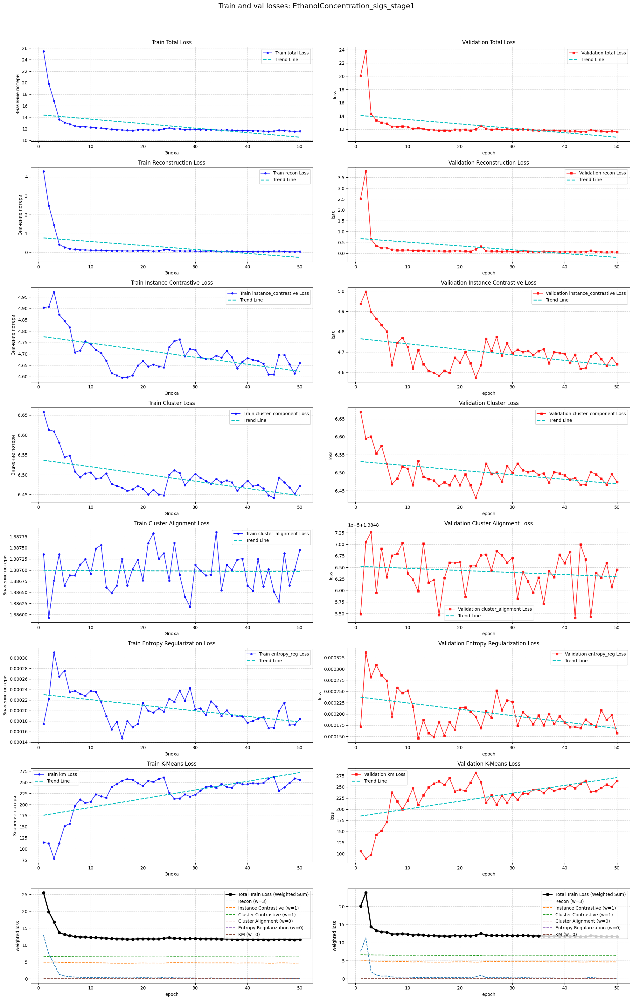

/tmp/ipykernel_477/1690588831.py:31: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model1.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage1/best_acc_model.

num_steps=200, embedding_size=340
test_data_orig_final.shape: (3156, 200, 340)
Using device: cuda
num_steps=200, embedding_size=340
Dataset: EthanolConcentration_sigs_stage2
Batch size: 261 (4 classes * 65 samples/class)
Window length (num_steps): 200, Classes: 4

--- Actual composition of the first training batch ---
  - Class 0: 60
  - Class 1: 72
  - Class 2: 58
  - Class 3: 71
-----------------------------------------------------


 Epoch 1/25 | Train Loss: 55.5640 | Recon: 0.0399 | Instance Contrastive: 4.6838 | Cluster Contrastive: 6.4752 | KM: 243.4436 | Entropy Regularization : 0.0002 | Cluster Alignment : 1.3881 

Epoch 1 Train Metrics (avg over batches): NMI: 0.0156, RI: 0.6147, ACC: 0.3011, ARI: 0.0009

--- Actual composition of the first validation batch ---
  - Class 0: 68
  - Class 1: 61
  - Class 2: 71
  - Class 3: 63
------------------------------------------------------


 Epoch 1/25 | Validation Loss: 54.4865 | Recon: 0.0495 | Instance Contrastive: 4.6446 | Cluster Co

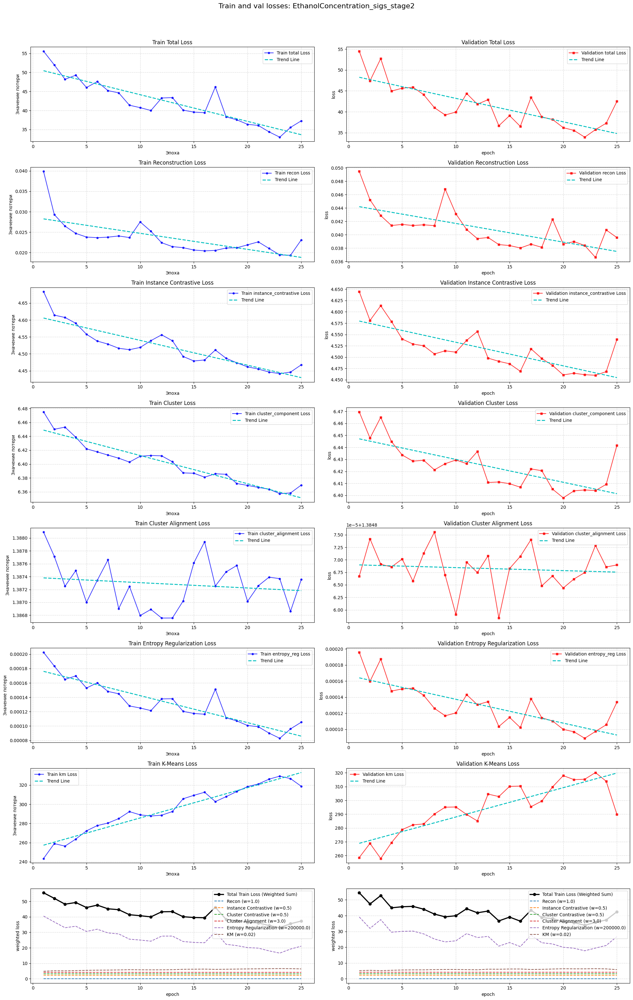

Извлечено 3156 эмбеддингов размерности 4096.
Запуск 100 итераций бутстрапа...

--- EthanolConcentration ---
accuracy on original: 25.70%
mean accuracy with_bootstrap: 26.52%
variance accuracy with_bootstrap: 0.00


/tmp/ipykernel_477/1690588831.py:74: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model2.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage2/best_acc_model.

Получение эмбеддингов для визуализации...
Извлечено 6288 эмбеддингов размерности 4096.

Снижение размерности с помощью UMAP...
Снижение до 4D UMAP компонент...
Построение графика UMAP (Компоненты 1 и 2)...
График сохранен: ./Figure/EthanolConcentration_sigs_emb_c1c2_Components_1_and_2.png


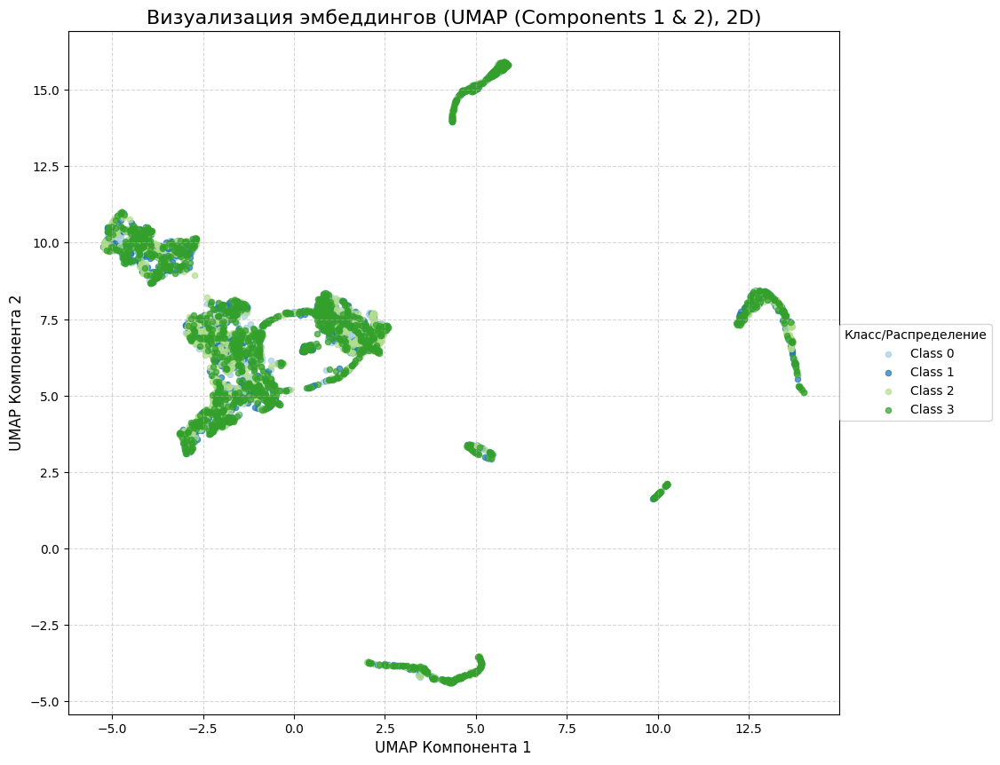

Построение графика UMAP (Компоненты 1 и 3)...
График сохранен: ./Figure/EthanolConcentration_sigs_emb_c1c3_Components_1_and_3.png


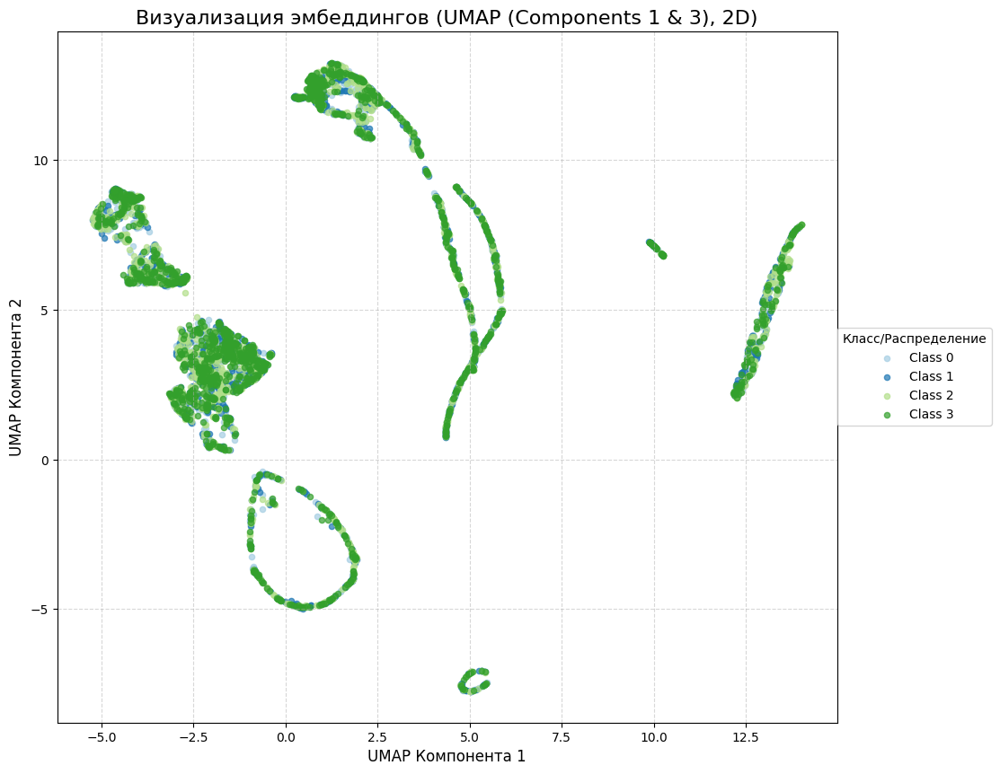

Построение графика UMAP (Компоненты 2 и 4)...
График сохранен: ./Figure/EthanolConcentration_sigs_emb_c2c4_Components_2_and_4.png


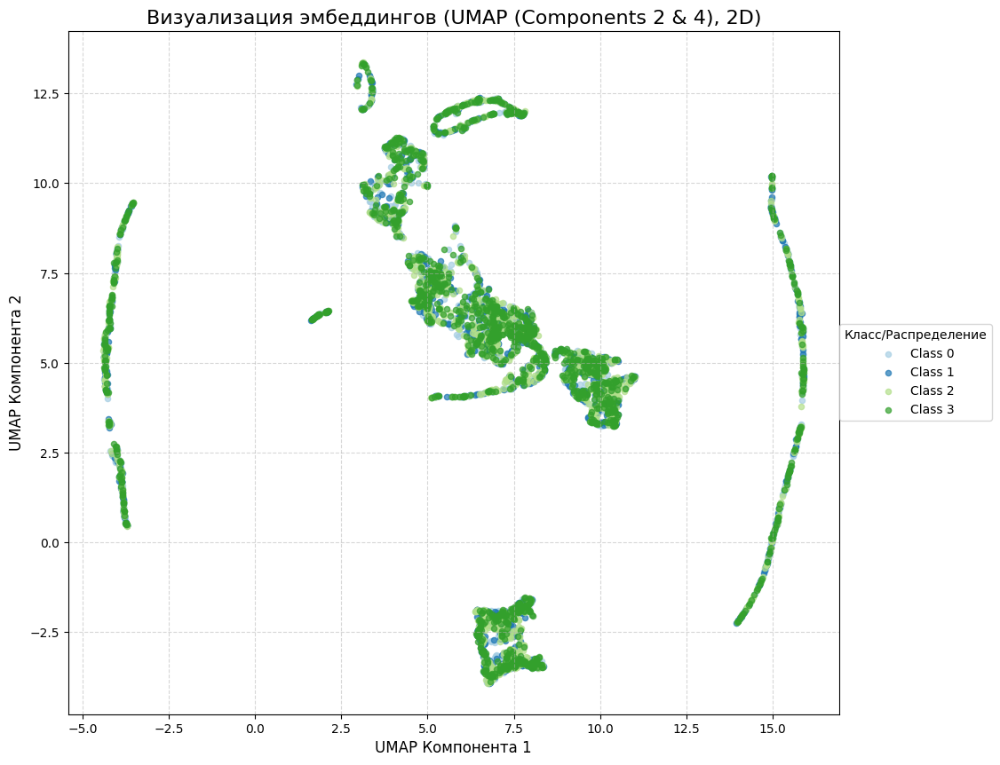

                      accuracy_original  accuracy_bootstrap_mean  \
EthanolConcentration               25.7                    26.52   

                      accuracy_bootstrap_variance  
EthanolConcentration                          0.0  


In [76]:
 model1, loss_logs1, train_features, train_features_aug, test_features, test_features_aug, train_labels, test_labels = run_pipeline(
    config_stage1.config_name,
    config_stage1,
    X_train_np=None,
    X_test_np=None,
    y_train_np=None,
    y_test_np=None,
    train_data_orig_final=train_features_EthanolConcentration, 
    train_data_aug_final=train_features_aug_EthanolConcentration, 
    train_labels_final=train_labels_EthanolConcentration,
    test_data_orig_final=test_features_EthanolConcentration,
    test_data_aug_final=test_features_aug_EthanolConcentration,
    test_labels_final=test_labels_EthanolConcentration,
    model=None,
    signature_params=SigParams(),
    augmentation_func=jitter,
    sigma=0.03
)
plot_loss_histories(loss_logs1, config_stage1)

config_stage2 = Config()
config_stage2.config_name = f"{dataset_name}_sigs_stage2"
config_stage2.learning_rate = 1e-4
config_stage2.num_epochs = 25
config_stage2.weight_recon = 1.0
config_stage2.weight_instance_contrastive = 0.5
config_stage2.weight_cluster_component = 0.5
config_stage2.weight_km = 0.02
config_stage2.weight_entropy_reg = 2e5
config_stage2.weight_cluster_alignment = 3.0
model1.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage1/best_acc_model.pth"))

model2, loss_logs2, train_features, _, test_features, _, train_labels, test_labels = run_pipeline(
    config_stage2.config_name,
    config_stage2,
    X_train_np=None,
    X_test_np=None,
    y_train_np=None,
    y_test_np=None,
    train_data_orig_final=train_features, 
    train_data_aug_final=train_features_aug, 
    train_labels_final=train_labels,
    test_data_orig_final=test_features,
    test_data_aug_final=test_features_aug,
    test_labels_final=test_labels,
    model=model1,
    signature_params=SigParams(),
    augmentation_func=jitter,
    sigma=0.03
)
plot_loss_histories(loss_logs2, config_stage2)

mean_acc, var_acc, acc_on_original = evaluate_clustering_with_bootstrap(
    model2,
    test_features,
    test_labels,
    len(classes),
    n_bootstrap=100
)

print(f"\n--- {dataset_name} ---")
print(f"accuracy on original: {acc_on_original:.2f}%")
print(f"mean accuracy with_bootstrap: {mean_acc:.2f}%")
print(f"variance accuracy with_bootstrap: {var_acc:.2f}")

results_summary[dataset_name] = {
    'accuracy_original': acc_on_original,
    'accuracy_bootstrap_mean': mean_acc,
    'accuracy_bootstrap_variance': var_acc
}

data_np = np.concatenate([train_features, test_features], axis=0)
label_np = np.concatenate([train_labels, test_labels], axis=0)
model2.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage2/best_acc_model.pth"))
visualize_embeddings_with_umap(
    model2,
    data_np,
    label_np,
    f"{dataset_name}_sigs",
    'cuda',
    distribution_names=None
)

results_df = pd.DataFrame.from_dict(results_summary, orient='index')
print(results_df)

In [90]:
DATASETS = ['EthanolConcentration', 'FaceDetection', 'Handwriting', 'Heartbeat',  'JapaneseVowels', 'PEMS-SF', 'SelfRegulationSCP1', 'SelfRegulationSCP2', 'SpokenArabicDigits', 'UWaveGestureLibrary']
DATASET_NAME = 'Heartbeat'
X_train_df, y_train_df = load_from_tsfile_to_dataframe(os.path.join("./", f'TS_classification/{DATASET_NAME}/{DATASET_NAME}_TRAIN.ts'))
X_test_df, y_test_df = load_from_tsfile_to_dataframe(os.path.join("./", f'TS_classification/{DATASET_NAME}/{DATASET_NAME}_TEST.ts'))
# print(TEST_TS_LENGTH_EQUALITY(X_test_df), TEST_TS_LENGTH_EQUALITY(X_train_df))

X_train_np = sktime_df_to_numpy(X_train_df)
X_test_np = sktime_df_to_numpy(X_test_df)
y_train_np, y_test_np, classes = encode_labels(y_train_df, y_test_df)

In [95]:
iisignature.siglength(61, 2)

3782

In [91]:
X_train_np.shape, X_test_np.shape

((204, 405, 61), (205, 405, 61))

In [92]:
np.unique(y_train_np, return_counts=True), np.unique(y_test_np, return_counts=True)

((array([0, 1]), array([147,  57])), (array([0, 1]), array([148,  57])))

In [97]:
(405 - 35) / 10

37.0

In [105]:
DATASETS = ['EthanolConcentration', 'FaceDetection', 'Handwriting', 'Heartbeat',  'JapaneseVowels', 'PEMS-SF', 'SelfRegulationSCP1', 'SelfRegulationSCP2', 'SpokenArabicDigits', 'UWaveGestureLibrary']
dataset_name  = 'Heartbeat'
print(f"{dataset_name}")
X_train_df, y_train_df = load_from_tsfile_to_dataframe(os.path.join("./", f'TS_classification/{dataset_name}/{dataset_name}_TRAIN.ts'))
X_test_df, y_test_df = load_from_tsfile_to_dataframe(os.path.join("./", f'TS_classification/{dataset_name}/{dataset_name}_TEST.ts'))


# if not (TEST_TS_LENGTH_EQUALITY(X_train_df) and TEST_TS_LENGTH_EQUALITY(X_test_df)):
#     print(f"Skipped {dataset_name}: different lengths.")
#     continue

X_train_np = sktime_df_to_numpy(X_train_df)
X_test_np = sktime_df_to_numpy(X_test_df)
y_train_np, y_test_np, classes = encode_labels(y_train_df, y_test_df)

print(f"Train: {X_train_np.shape}, Test: {X_test_np.shape}, classes: {len(classes)}")

class SigParams(object):
    sig_type = 'sig'
    normalize_timeline = True
    activation = 'tanh'
    seed = 42
    sig_level = 2
    
class Config(object):
    batch_size = 204
    test_batch_size = 205
    hidden_size = [1024, 512, 256, 256]
    dilations = [1, 1, 1, 1]
    learning_rate = 1e-3
    embedding_size = None
    num_steps = None
    cell_type = 'GRU' # For encoder
    decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
    class_num = len(classes) 
    denoising = True
    hidden_norm_contrastive = True # For contrastive loss on hidden representations
    # standard_scaler = True
    normalize_data = True
    make_stationary = False
    scaler = StandardScaler #StandardScaler #RobustScaler
    temperature_contrastive = 0.5 # For instance-level contrastive loss
    temperature_cluster = 0.5 # For cluster-level contrastive loss
    l2_reg_weight = 1e-4 # L2 regularization weight
    eval_frequency = 1
    config_name = f"{dataset_name}_sigs_stage1"
    weight_recon = 3
    weight_instance_contrastive = 1
    weight_cluster_component = 1
    weight_km = 0
    weight_entropy_reg = 0
    weight_cluster_alignment = 0
    window_size = 35
    stride = 10
    num_epochs = 50
    # train_ratio = 6/8
    
config_stage1 = Config()

train_features_Heartbeat, train_features_aug_Heartbeat, test_features_Heartbeat, test_features_aug_Heartbeat, train_labels_Heartbeat, test_labels_Heartbeat = get_prepared_data(
    config_stage1,
    X_train_np,
    X_test_np,
    y_train_np,
    y_test_np,
    signature_params=SigParams(),
    augmentation_func=jitter,
    sigma=0.03
)

Heartbeat
Train: (204, 405, 61), Test: (205, 405, 61), classes: 2
augmentation...
Signature's type: sig
Signatures prepared
Signatures prepared
Signatures prepared
Signatures prepared
processed_X_test_np_orig.shape : (205, 405, 3906)
Each fragment is divided into 38 windows.
Each fragment is divided into 38 windows.
Each fragment is divided into 38 windows.
Each fragment is divided into 38 windows.
config.num_steps :35


In [ ]:

model1, loss_logs1, train_features, train_features_aug, test_features, test_features_aug, train_labels, test_labels = run_pipeline(
    config_stage1.config_name,
    config_stage1,
    X_train_np=None,
    X_test_np=None,
    y_train_np=None,
    y_test_np=None,
    train_data_orig_final=train_features_Heartbeat, 
    train_data_aug_final=train_features_aug_Heartbeat, 
    train_labels_final=train_labels_Heartbeat,
    test_data_orig_final=test_features_Heartbeat,
    test_data_aug_final=test_features_aug_Heartbeat,
    test_labels_final=test_labels_Heartbeat,
    model=None,
    signature_params=SigParams(),
    augmentation_func=jitter,
    sigma=0.03
)
plot_loss_histories(loss_logs1, config_stage1)

config_stage2 = Config()
config_stage2.config_name = f"{dataset_name}_sigs_stage2"
config_stage2.learning_rate = 1e-4
config_stage2.num_epochs = 25
config_stage2.weight_recon = 1.0
config_stage2.weight_instance_contrastive = 0.5
config_stage2.weight_cluster_component = 0.5
config_stage2.weight_km = 0.02
config_stage2.weight_entropy_reg = 2e5
config_stage2.weight_cluster_alignment = 3.0
model1.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage1/best_acc_model.pth"))

model2, loss_logs2, train_features, _, test_features, _, train_labels, test_labels = run_pipeline(
    config_stage2.config_name,
    config_stage2,
    X_train_np=None,
    X_test_np=None,
    y_train_np=None,
    y_test_np=None,
    train_data_orig_final=train_features, 
    train_data_aug_final=train_features_aug, 
    train_labels_final=train_labels,
    test_data_orig_final=test_features,
    test_data_aug_final=test_features_aug,
    test_labels_final=test_labels,
    model=model1,
    signature_params=SigParams(),
    augmentation_func=jitter,
    sigma=0.03
)
plot_loss_histories(loss_logs2, config_stage2)

mean_acc, var_acc, acc_on_original = evaluate_clustering_with_bootstrap(
    model2,
    test_features,
    test_labels,
    len(classes),
    n_bootstrap=100
)

print(f"\n--- {dataset_name} ---")
print(f"accuracy on original: {acc_on_original:.2f}%")
print(f"mean accuracy with_bootstrap: {mean_acc:.2f}%")
print(f"variance accuracy with_bootstrap: {var_acc:.2f}")

results_summary[dataset_name] = {
    'accuracy_original': acc_on_original,
    'accuracy_bootstrap_mean': mean_acc,
    'accuracy_bootstrap_variance': var_acc
}

data_np = np.concatenate([train_features, test_features], axis=0)
label_np = np.concatenate([train_labels, test_labels], axis=0)
model2.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage2/best_acc_model.pth"))
visualize_embeddings_with_umap(
    model2,
    data_np,
    label_np,
    f"{dataset_name}_sigs",
    'cuda',
    distribution_names=None
)

results_df = pd.DataFrame.from_dict(results_summary, orient='index')
print(results_df)

num_steps=35, embedding_size=3906
test_data_orig_final.shape: (7790, 35, 3906)
Using device: cuda
num_steps=35, embedding_size=3906
Dataset: Heartbeat_sigs_stage1
Batch size: 254 (2 classes * 127 samples/class)
Window length (num_steps): 35, Classes: 2

--- Actual composition of the first training batch ---
  - Class 0: 152
  - Class 1: 102
-----------------------------------------------------


 Epoch 1/50 | Train Loss: 48.8238 | Recon: 11.6282 | Instance Contrastive: 5.2545 | Cluster Contrastive: 6.5135 | KM: 155.8733 | Entropy Regularization : 0.0005 | Cluster Alignment : 0.6932 

Epoch 1 Train Metrics (avg over batches): NMI: 0.0041, RI: 0.5039, ACC: 0.5451, ARI: 0.0043

--- Actual composition of the first validation batch ---
  - Class 0: 150
  - Class 1: 55
------------------------------------------------------


 Epoch 1/50 | Validation Loss: 56.0247 | Recon: 13.9927 | Instance Contrastive: 5.0384 | Cluster Contrastive: 6.6164 | KM: 70.2433 | Entropy Regularization : 0.0004 | Cl

In [69]:
DATASETS = ['EthanolConcentration', 'FaceDetection', 'Handwriting', 'Heartbeat',  'JapaneseVowels', 'PEMS-SF', 'SelfRegulationSCP1', 'SelfRegulationSCP2', 'SpokenArabicDigits', 'UWaveGestureLibrary']
DATASETS_TO_RUN  = ['EthanolConcentration']

results_summary = {}

for dataset_name in DATASETS_TO_RUN:
    print(f"{dataset_name}")    
    try:
        X_train_df, y_train_df = load_from_tsfile_to_dataframe(os.path.join("./", f'TS_classification/{dataset_name}/{dataset_name}_TRAIN.ts'))
        X_test_df, y_test_df = load_from_tsfile_to_dataframe(os.path.join("./", f'TS_classification/{dataset_name}/{dataset_name}_TEST.ts'))

        
        # if not (TEST_TS_LENGTH_EQUALITY(X_train_df) and TEST_TS_LENGTH_EQUALITY(X_test_df)):
        #     print(f"Skipped {dataset_name}: different lengths.")
        #     continue
        
        X_train_np = sktime_df_to_numpy(X_train_df)
        X_test_np = sktime_df_to_numpy(X_test_df)
        y_train_np, y_test_np, classes = encode_labels(y_train_df, y_test_df)
        
        print(f"Train: {X_train_np.shape}, Test: {X_test_np.shape}, classes: {len(classes)}")

        class SigParams(object):
            sig_type = 'sig'
            normalize_timeline = True
            activation = 'tanh'
            seed = 42
            sig_level = 4
            
        class Config(object):
            batch_size = 261
            test_batch_size = 263
            hidden_size = [1024, 512, 256, 256]
            dilations = [1, 1, 1, 1]
            learning_rate = 1e-3
            embedding_size = None
            num_steps = None
            cell_type = 'GRU' # For encoder
            decoder_cell_type = 'GRU' # Explicitly for decoder for clarity, can be same as encoder
            class_num = len(classes) 
            denoising = True
            hidden_norm_contrastive = True # For contrastive loss on hidden representations
            # standard_scaler = True
            normalize_data = True
            make_stationary = False
            scaler = StandardScaler #StandardScaler #RobustScaler
            temperature_contrastive = 0.5 # For instance-level contrastive loss
            temperature_cluster = 0.5 # For cluster-level contrastive loss
            l2_reg_weight = 1e-4 # L2 regularization weight
            eval_frequency = 1
            config_name = f"{dataset_name}_sigs_stage1"
            weight_recon = 3
            weight_instance_contrastive = 1
            weight_cluster_component = 1
            weight_km = 0
            weight_entropy_reg = 0
            weight_cluster_alignment = 0
            window_size = 200
            stride = 141
            num_epochs = 50
            # train_ratio = 6/8
            
        config_stage1 = Config()
        model1, loss_logs1, train_features, train_features_aug, test_features, test_features_aug, train_labels, test_labels = run_pipeline(
            config_stage1.config_name,
            config_stage1,
            X_train_np,
            X_test_np,
            y_train_np,
            y_test_np,
            train_data_orig_final=None, 
            train_data_aug_final=None, 
            train_labels_final=None,
            test_data_orig_final=None,
            test_data_aug_final=None,
            test_labels_final=None,
            model=None,
            signature_params=SigParams(),
            augmentation_func=jitter,
            sigma=0.03
        )
        plot_loss_histories(loss_logs1, config_stage1)
        
        config_stage2 = Config()
        config_stage2.config_name = f"{dataset_name}_sigs_stage2"
        config_stage2.learning_rate = 1e-4
        config_stage2.num_epochs = 25
        config_stage2.weight_recon = 1.0
        config_stage2.weight_instance_contrastive = 0.5
        config_stage2.weight_cluster_component = 0.5
        config_stage2.weight_km = 0.02
        config_stage2.weight_entropy_reg = 2e5
        config_stage2.weight_cluster_alignment = 3.0
        model1.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage1/best_acc_model.pth"))
        
        model2, loss_logs2, train_features, _, test_features, _, train_labels, test_labels = run_pipeline(
            config_stage2.config_name,
            config_stage2,
            X_train_np=None,
            X_test_np=None,
            y_train_np=None,
            y_test_np=None,
            train_data_orig_final=train_features, 
            train_data_aug_final=train_features_aug, 
            train_labels_final=train_labels,
            test_data_orig_final=test_features,
            test_data_aug_final=test_features_aug,
            test_labels_final=test_labels,
            model=model1,
            signature_params=SigParams(),
            augmentation_func=jitter,
            sigma=0.03
        )
        plot_loss_histories(loss_logs2, config_stage2)

        mean_acc, var_acc, acc_on_original = evaluate_clustering_with_bootstrap(
            model2,
            test_features,
            test_labels,
            len(classes),
            n_bootstrap=100
        )
        
        print(f"\n--- {dataset_name} ---")
        print(f"accuracy on original: {acc_on_original:.2f}%")
        print(f"mean accuracy with_bootstrap: {mean_acc:.2f}%")
        print(f"variance accuracy with_bootstrap: {var_acc:.2f}")
        
        results_summary[dataset_name] = {
            'accuracy_original': acc_on_original,
            'accuracy_bootstrap_mean': mean_acc,
            'accuracy_bootstrap_variance': var_acc
        }
        
        data_np = np.concatenate([train_features, test_features], axis=0)
        label_np = np.concatenate([train_labels, test_labels], axis=0)
        model2.load_state_dict(torch.load(f"./ACC_model/{dataset_name}_sigs_stage2/best_acc_model.pth"))
        visualize_embeddings_with_umap(
            model2,
            data_np,
            label_np,
            f"{dataset_name}_sigs",
            'cuda',
            distribution_names=None
        )

    except Exception as e:
        print(f"{dataset_name}: {e}")
        import traceback
        traceback.print_exc()


results_df = pd.DataFrame.from_dict(results_summary, orient='index')
print(results_df)

EthanolConcentration
Train: (261, 1751, 3), Test: (263, 1751, 3), classes: 4
augmentation...
Signature's type: sig


KeyboardInterrupt: 